# Happiness Analysis based on Economic and Social Factors
## Authors: [Me](https://github.com/KacperChabros) and [faboulousfoxx](https://github.com/fabulousfoxx)
## Dataset: World Happiness Data 2024
### Link to the dataset: https://www.kaggle.com/datasets/abdullah0a/world-happiness-data-2024-explore-life

## Importing necessary libraries

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn import metrics
import pycountry
from pycountry_convert import country_alpha2_to_continent_code, convert_continent_code_to_continent_name

## Reading the dataset

In [2]:
df = pd.read_csv('World Happiness Report 2024.csv')
df.head()

,Country name,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,Afghanistan,2008,3.723590,7.350416,0.450662,50.500000,0.718114,0.164055,0.881686,0.414297,0.258195
1,Afghanistan,2009,4.401778,7.508646,0.552308,50.799999,0.678896,0.187297,0.850035,0.481421,0.237092
2,Afghanistan,2010,4.758381,7.613900,0.539075,51.099998,0.600127,0.117861,0.706766,0.516907,0.275324
3,Afghanistan,2011,3.831719,7.581259,0.521104,51.400002,0.495901,0.160098,0.731109,0.479835,0.267175
4,Afghanistan,2012,3.782938,7.660506,0.520637,51.700001,0.530935,0.234157,0.775620,0.613513,0.267919


## Analysis of Dataset Dimensions and Completion Rate
Firstly, we will analyze the number of rows and columns.

In [3]:
row_number, col_number = df.shape
print(f'Number of rows: {row_number}')
print(f'Number of features: {col_number}')

Number of rows: 2363
Number of features: 11


The dataset contains 2,363 rows and 11 features. By displaying information about the data frame, we can see which features are included in the dataset and their data types.

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2363 entries, 0 to 2362
Data columns (total 11 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   Country name                      2363 non-null   object 
 1   year                              2363 non-null   int64  
 2   Life Ladder                       2363 non-null   float64
 3   Log GDP per capita                2335 non-null   float64
 4   Social support                    2350 non-null   float64
 5   Healthy life expectancy at birth  2300 non-null   float64
 6   Freedom to make life choices      2327 non-null   float64
 7   Generosity                        2282 non-null   float64
 8   Perceptions of corruption         2238 non-null   float64
 9   Positive affect                   2339 non-null   float64
 10  Negative affect                   2347 non-null   float64
dtypes: float64(9), int64(1), object(1)
memory usage: 203.2+ KB


The dataset includes the following features:

* Country name – Name of the country from which the data was collected (string)
* year – Year in which the data was collected (int)
* Life Ladder – A metric representing life satisfaction, the dependent variable (float)
* Log GDP per capita – Logarithm of GDP per capita (float)
* Social support – An index measuring the perceived level of social support (float)
* Healthy life expectancy at birth – Expected healthy life expectancy at birth (in years) (float)
* Freedom to make life choices – A measure of how free people feel in making life decisions (float)
* Generosity – A metric representing the level of generosity/charitable activity in a given country (float)
* Perceptions of corruption – A measure of how corrupt the government is perceived to be (float)
* Positive affect – The level of positive emotions experienced by individuals (float)
* Negative affect – The level of negative emotions experienced by individuals (float)  

We can observe that the dataset contains some missing values. Let's analyze the number of missing values in the dataset.

In [5]:
df.isna().sum()

Country name                          0
year                                  0
Life Ladder                           0
Log GDP per capita                   28
Social support                       13
Healthy life expectancy at birth     63
Freedom to make life choices         36
Generosity                           81
Perceptions of corruption           125
Positive affect                      24
Negative affect                      16
dtype: int64

The columns **Country name**, **year**, and **Life Ladder** have no missing values.  
The remaining columns contain missing values, with **Perceptions of corruption** having the most.  
Now, we will analyze the data completeness rate.

In [6]:
np.round((row_number - df.isna().sum()) / row_number * 100, 2)

Country name                        100.00
year                                100.00
Life Ladder                         100.00
Log GDP per capita                   98.82
Social support                       99.45
Healthy life expectancy at birth     97.33
Freedom to make life choices         98.48
Generosity                           96.57
Perceptions of corruption            94.71
Positive affect                      98.98
Negative affect                      99.32
dtype: float64

Each column has more than 94% completeness.  
Let's check how many records we would lose by removing missing data.

In [7]:
dropped_all_na_rows_df = df.dropna()
row_diff = df.shape[0] - dropped_all_na_rows_df.shape[0]
print(f'Numer of records lost: {row_diff}')
print(f'New number of records: {row_number - row_diff}')
print(f'Percentage of lost records: {np.round(row_diff / row_number * 100, 2)} %')

Numer of records lost: 266
New number of records: 2097
Percentage of lost records: 11.26 %


Losing 11% of the records seems quite significant.  
We will check whether it makes sense to fill in the missing values.  
First, however, let's identify which countries have the most missing data.

In [8]:
drop_summary_df = pd.concat([df.iloc[:,[0,1]].groupby('Country name').count().rename(columns={'year': 'Rows before'}),
                             dropped_all_na_rows_df.iloc[:,[0,1]].groupby('Country name').count().rename(columns={'year': 'Rows after'})
                             ], axis=1)
drop_summary_df['Rows after'] = drop_summary_df['Rows after'].fillna(0)
drop_summary_df = pd.concat([drop_summary_df,
                             (drop_summary_df.iloc[:,0] - drop_summary_df.iloc[:,1])
                            ], axis=1)
drop_summary_df.columns = list(drop_summary_df.columns[:-1]) + ['Difference']
drop_summary_df = pd.concat([drop_summary_df,
                             (np.round(drop_summary_df.iloc[:,2] / drop_summary_df.iloc[:,0] * 100, 2))
                            ], axis=1)
drop_summary_df.columns = list(drop_summary_df.columns[:-1]) + ['Percent of rows with missing values']
drop_summary_df.sort_values(by='Difference', ascending=False)

,Rows before,Rows after,Difference,Percent of rows with missing values
Country name,,,,
China,17,0.0,17.0,100.00
Kosovo,17,0.0,17.0,100.00
Saudi Arabia,18,2.0,16.0,88.89
State of Palestine,16,0.0,16.0,100.00
Jordan,18,4.0,14.0,77.78
...,...,...,...,...
Ukraine,18,18.0,0.0,0.00
Uganda,18,18.0,0.0,0.00
Uruguay,18,18.0,0.0,0.00


We can observe several interesting things:  
* The number of years in which measurements were taken varies by country. For example, Saudi Arabia has data from 18 years, while (as we will see in the next cell) Oman has data from only one year.  
* Removing records with missing values would result in the biggest data loss for China and Kosovo – 17 records each.  
* Some countries, such as Ukraine, Uruguay, and Uganda, have no missing data.  
* Some countries would lose all their records, such as China and Kosovo.  

Let's check how many countries we would lose if we removed all records with missing data.

In [9]:
print(f'Number of lost countries: {drop_summary_df[drop_summary_df['Percent of rows with missing values'] == 100].shape[0]}')
drop_summary_df[drop_summary_df['Percent of rows with missing values'] == 100]

Number of lost countries: 10


,Rows before,Rows after,Difference,Percent of rows with missing values
Country name,,,,
China,17,0.0,17.0,100.0
Cuba,1,0.0,1.0,100.0
Hong Kong S.A.R. of China,13,0.0,13.0,100.0
Kosovo,17,0.0,17.0,100.0
Maldives,1,0.0,1.0,100.0
Oman,1,0.0,1.0,100.0
Somaliland region,4,0.0,4.0,100.0
South Sudan,4,0.0,4.0,100.0
State of Palestine,16,0.0,16.0,100.0


We would lose data from 10 countries.  
The listed countries suggest that most missing values occur in nations facing international recognition issues, armed conflicts, or censorship.  
Limited resources and infrastructure may also play a role.  

Let's map this data to better visualize the patterns.

In [10]:
drop_summary_df.index = drop_summary_df.index.str.replace('Türkiye', 'Turkey')
dropped_all_na_rows_df.loc[:, 'Country name'] = dropped_all_na_rows_df.loc[:, 'Country name'].str.replace('Türkiye', 'Turkey')
df.loc[:, 'Country name'] = df.loc[:, 'Country name'].str.replace('Türkiye', 'Turkey')
fig = px.choropleth(drop_summary_df,
                    locations=drop_summary_df.index,
                    locationmode='country names',
                    color='Percent of rows with missing values',
                    title='Percent of rows with missing values per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

While analyzing the map, we noticed that Turkey was not displayed due to a name format incompatibility with Plotly.  
We decided to adjust it to meet the required format.  

* Most countries with missing data are located on the Arabian Peninsula and in North Africa.  
  South Sudan, China, Oman, Turkmenistan, and Cuba had 100% of their records with missing data.  
* Some countries (e.g., Kosovo) were not marked on the map because they are not included in the ISO 3166 standard used by Plotly.  
* There are also isolated missing values in Europe, with more gaps than in Central African countries.  

Since most missing data comes from the **Perceptions of Corruption** column or from countries where sufficient information could not be obtained,  
we decided to remove records from countries with at least **75% of rows missing**.


In [11]:
print(f'Number of lost countries: {drop_summary_df[drop_summary_df['Percent of rows with missing values'] >= 75].shape[0]}')
df_75_missing = drop_summary_df[drop_summary_df['Percent of rows with missing values'] >= 75].sort_values(by="Percent of rows with missing values", ascending=False)
df_75_missing

Number of lost countries: 17


,Rows before,Rows after,Difference,Percent of rows with missing values
Country name,,,,
China,17,0.0,17.0,100.00
Turkmenistan,10,0.0,10.0,100.00
Cuba,1,0.0,1.0,100.00
Hong Kong S.A.R. of China,13,0.0,13.0,100.00
Kosovo,17,0.0,17.0,100.00
Oman,1,0.0,1.0,100.00
Maldives,1,0.0,1.0,100.00
Somaliland region,4,0.0,4.0,100.00
South Sudan,4,0.0,4.0,100.00


In [12]:
df_dropped_missing = df[~df['Country name'].isin(df_75_missing.index)]
row_diff = df.shape[0] - df_dropped_missing.shape[0]
print(f'Numer of records lost: {row_diff}')
print(f'New number of records: {row_number - row_diff}')
print(f'Percentage of lost records: {np.round(row_diff / row_number * 100, 2)} %')

Numer of records lost: 182
New number of records: 2181
Percentage of lost records: 7.7 %


We removed records from 17 countries whose indicators had a high potential for unreliability.  
This accounted for **7.7%** of the dataset.  

Let's reanalyze the data completeness rate.

In [13]:
row_number_without_some_countries = df_dropped_missing.shape[0]
np.round((row_number_without_some_countries - df_dropped_missing.isna().sum()) / row_number_without_some_countries * 100, 2)

Country name                        100.00
year                                100.00
Life Ladder                         100.00
Log GDP per capita                   99.45
Social support                       99.68
Healthy life expectancy at birth    100.00
Freedom to make life choices         99.17
Generosity                           97.71
Perceptions of corruption            98.35
Positive affect                      99.45
Negative affect                      99.68
dtype: float64

**Healthy life expectancy at birth** has now reached full completeness.  

The column with the lowest completeness is now **Generosity**, at **97.71%**.  
We will attempt to fill in these missing values.  

We have decided to use regression to impute the missing values.  
This approach allows us to fill gaps both at "extreme" years and within the dataset's timeline.  

We use **polynomial regression** to create models based on existing data.  
For each country, we test different polynomial degrees depending on the number of available records.  
The maximum polynomial degree tested is **3**, to capture possible nonlinear relationships.  

To prevent overfitting:  
- For countries with only **4 records**, we limit the model to a **second-degree polynomial**.  
- For countries with **3 records**, we use a **first-degree polynomial**.  

The best model is selected based on the **R2 metric**.  
We then use this model to fill in the missing values.  

In [14]:
def fill_with_regression(group, columns):
    years = group['year'].values
    for column in columns:
        y = group[column].values
        if np.any(np.isnan(y)):
            missing_idx = np.where(np.isnan(y))[0]
            valid_idx = np.where(~np.isnan(y))[0]

            if len(valid_idx) > 1:
                X_valid = years[valid_idx]
                y_valid = y[valid_idx]
                
                r2_scores = {}
                best_fit = None
                best_degree = None  
                
                max_degree = min(3, len(valid_idx) - 2)
                max_degree = max(1, max_degree)

                for degree in range(1, max_degree + 1):
                    if len(valid_idx) >= degree + 1:
                        coeffs = np.polyfit(X_valid, y_valid, degree)
                        y_pred = np.polyval(coeffs, X_valid)
                        r2_scores[degree] = metrics.r2_score(y_valid, y_pred)

                best_degree = max(r2_scores, key=r2_scores.get)
                best_fit = np.polyfit(X_valid, y_valid, best_degree)
                y[missing_idx] = np.polyval(best_fit, years[missing_idx])
                group[column] = y
    return group

columns_to_interpolate = ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']


df_filled = df_dropped_missing.groupby('Country name').apply(fill_with_regression, columns=columns_to_interpolate, include_groups=False)
df_filled = df_filled.reset_index()
df_filled = df_filled.set_index(df_filled.columns[1])
df_filled.index.name = None

In [15]:
row_number_filled = df_filled.shape[0]
np.round((row_number_filled - df_filled.isna().sum()) / row_number_filled * 100, 2)

Country name                        100.0
year                                100.0
Life Ladder                         100.0
Log GDP per capita                  100.0
Social support                      100.0
Healthy life expectancy at birth    100.0
Freedom to make life choices        100.0
Generosity                          100.0
Perceptions of corruption           100.0
Positive affect                     100.0
Negative affect                     100.0
dtype: float64

All features now have complete data.

In [16]:
df_filled

,Country name,year,Life Ladder,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,Afghanistan,2008,3.723590,7.350416,0.450662,50.500000,0.718114,0.164055,0.881686,0.414297,0.258195
1,Afghanistan,2009,4.401778,7.508646,0.552308,50.799999,0.678896,0.187297,0.850035,0.481421,0.237092
2,Afghanistan,2010,4.758381,7.613900,0.539075,51.099998,0.600127,0.117861,0.706766,0.516907,0.275324
3,Afghanistan,2011,3.831719,7.581259,0.521104,51.400002,0.495901,0.160098,0.731109,0.479835,0.267175
4,Afghanistan,2012,3.782938,7.660506,0.520637,51.700001,0.530935,0.234157,0.775620,0.613513,0.267919
...,...,...,...,...,...,...,...,...,...,...,...
2358,Zimbabwe,2019,2.693523,7.697755,0.759162,53.099998,0.631908,-0.050874,0.830652,0.658434,0.235354
2359,Zimbabwe,2020,3.159802,7.596050,0.717243,53.575001,0.643303,0.002848,0.788523,0.660658,0.345736
2360,Zimbabwe,2021,3.154578,7.656878,0.685151,54.049999,0.667636,-0.079007,0.756945,0.609917,0.241682
2361,Zimbabwe,2022,3.296220,7.670073,0.666172,54.525002,0.651987,-0.072935,0.752632,0.640609,0.191350


## Analysis of Value Ranges  

First, we will display the descriptive statistics of the dataset.  
To facilitate visual identification of the target variable, we will rearrange the columns,  
placing it as the last column in the dataframe.

In [17]:
df_filled = df_filled[[col for col in df_filled.columns if col != 'Life Ladder'] + ['Life Ladder']]

In [18]:
df_filled.describe()

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Life Ladder
count,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000,2181.000000
mean,2014.796424,9.330974,0.807581,63.287277,0.750082,0.001426,0.746188,0.652401,0.275135,5.461933
std,5.077907,1.201319,0.124108,6.963473,0.140755,0.163287,0.183307,0.108041,0.085519,1.141798
min,2005.000000,-0.889230,0.228217,6.720000,0.215351,-0.339547,-0.010964,0.178886,0.103494,1.281271
25%,2011.000000,8.447203,0.737993,58.700001,0.659177,-0.109802,0.689583,0.571715,0.211640,4.611607
50%,2015.000000,9.480632,0.834280,65.000000,0.770360,-0.021303,0.799240,0.663038,0.263593,5.420331
75%,2019.000000,10.308986,0.906029,68.699997,0.861472,0.095239,0.867924,0.740164,0.327000,6.294855
max,2023.000000,11.675588,0.987343,74.599998,1.360788,0.699570,0.983276,0.883586,0.704590,8.018934


Descriptive statistics alone make it difficult to draw many conclusions.  
Visualization will provide a much clearer understanding.  

However, from the statistics, we can observe:  
* An outlier in **Healthy life expectancy at birth**, where a value of **6.7 years** is significantly below the first quartile.  

Let's start by verifying the number of records for each country.


In [19]:
country_counts = df_filled['Country name'].value_counts()
fig = px.choropleth(country_counts,
                    locations=country_counts.index,
                    locationmode='country names',
                    color=country_counts.values,
                    title='Number of entries for each country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* Most countries have more than **15 records**.  
* Fewer records are primarily found in **Africa**, where data collection may have been more challenging.  
* The countries with the **fewest records** are **Guyana** and **Suriname**, each with only **one**.  
* Interestingly, **Iceland** has a relatively small number of records as well.  

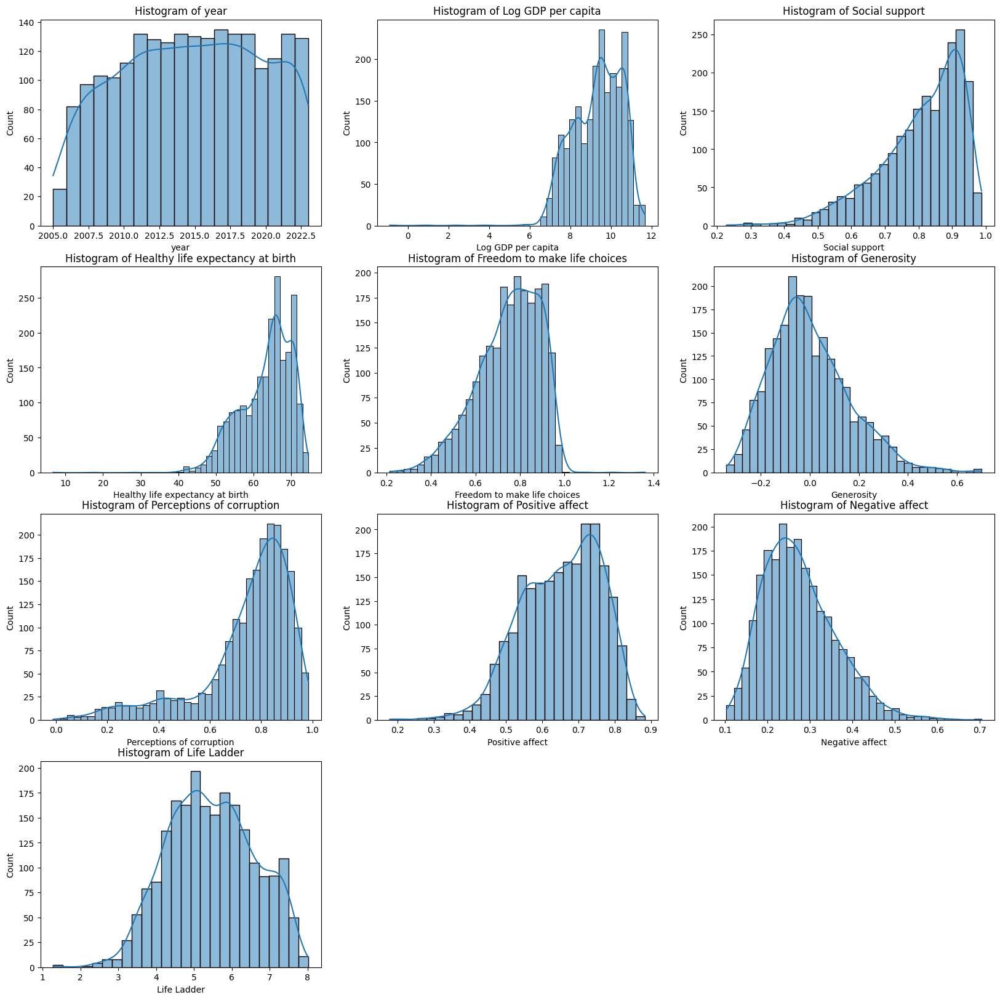

In [20]:
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_filled.columns[1:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_filled['year'].max() - df_filled['year'].min() + 1
    else:
        iqr = np.percentile(df_filled[column], 75) - np.percentile(df_filled[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_filled[column]))
        bins = int(np.ceil((df_filled[column].max() - df_filled[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    sns.histplot(df_filled[column], bins=bins, kde=True)
plt.show()

### Conclusions  

* Data was collected between **2005 and 2023**.  
  - Initially, especially in **2005**, fewer data points were gathered.  
  - After **2011**, data collection stabilized, except for **2019-2020**,  
    which aligns with the early **COVID-19 pandemic**.  

* **Log GDP per capita**  
  - Histogram suggests a **higher concentration** of records in the upper half,  
    indicating a **bias toward wealthier countries**.  
  - This could be due to less frequent data collection in **developing countries**.  
  - The **main variability range** is **6 to 12**, but there are some extreme **outliers**.  
  - A record with a **negative Log GDP per capita** is highly unusual  
    and may need removal during outlier analysis.  

* **Social support**  
  - **Left-skewed** distribution – few countries have **low** support,  
    while most have values around **0.9**.  
  - The range is approximately **0.2 to 1.0**.  
  - Theoretically, it should be **0-1**, but no country has a value of exactly **0**.  
  - Outliers will be identified using standard outlier detection methods.  

* **Healthy life expectancy at birth**  
  - Also **left-skewed**, with more records showing **higher** life expectancy.  
  - **Extreme outliers** with very **low** values are evident.  
  - Variability range is **5 to 80 years**, with most non-outlier values **above 40**.  

* **Freedom to make life choices**  
  - Similar left-skewed trend.  
  - More records where people perceive **greater freedom**.  
  - Range: **0.2 to 1.0**, with a few **outliers** above this.  
  - Suggests an original range of **0-1**, but no country reports absolute **zero freedom**.  

* **Generosity**  
  - Slight **right-tailed** distribution.  
  - Variability range: **-0.3 to 0.7**.  
  - Many values **close to zero or negative**, suggesting that generosity is **low** in many countries.  

* **Perceptions of corruption**  
  - **Left-skewed** distribution.  
  - Variability range: **0 to 1**.  
  - A strong skew toward **high values** suggests that people generally perceive their institutions as **corrupt**.  

* **Positive affect**  
  - **Few values below 0.4**, meaning people tend to experience more **positive emotions**.  
  - Variability range: **0.2 to nearly 0.9**.  
  - Again, the implied **original scale is 0-1**, but no country has a score of **exactly 0 or 1**.  

* **Negative affect**  
  - **Right-tailed** distribution, meaning people generally report **fewer negative emotions**.  
  - Variability range: **0.1 to 0.7**.  
  - Similar to **Positive affect**, the expected range is **0-1**,  
    but no country has a score of exactly **0 or 1**.  

* **Life Ladder (Subjective Well-being)**  
  - **Nearly normal distribution**, except for extreme **outliers** with **very low satisfaction**.  
  - Variability range: **1 to 8**.  
  - Slightly more records indicate **higher** well-being than lower.  

Now, we will generate **box plots** to analyze quartiles and potential outliers.  


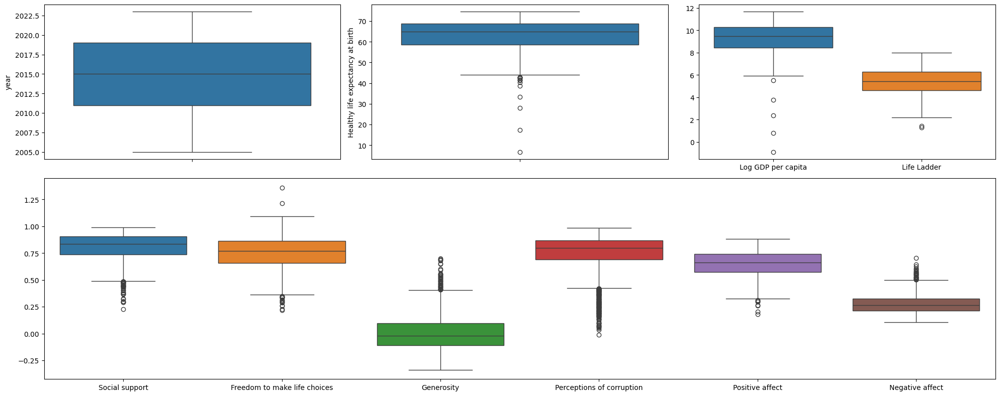

In [21]:
fig = plt.figure(figsize=(20, 8))
gs = fig.add_gridspec(2, 3, height_ratios=[1, 1.3])

ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])

sns.boxplot(df_filled['year'], ax=ax1)
sns.boxplot(df_filled['Healthy life expectancy at birth'], ax=ax2)
sns.boxplot(df_filled[['Log GDP per capita', 'Life Ladder']], ax=ax3)

ax4 = fig.add_subplot(gs[1, :])
sns.boxplot(df_filled[['Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']], ax=ax4)
plt.tight_layout()
plt.show()

### Conclusions  

#### **year**  
- **Q1: 2011**, **Q3: 2019**.  
- **More variability** below **Q1** than above **Q3**.  
- **No outliers** detected.  

#### **Healthy life expectancy at birth**  
- **Q1: ~58**, **Q3: ~68**.  
- **Many outliers**, especially on the lower end.  
- **Greater variability** below the median than above.  
- Outliers **span over half of the scale**, indicating extreme disparities.  

#### **Log GDP per capita**  
- **Fairly even distribution**, but with **slightly more variability below the median**.  
- **Some outliers** — countries with **low GDP per capita**.  
- **One record has a negative Log GDP per capita**, which is highly unusual.  

#### **Life Ladder**  
- **Lower values** than Log GDP per capita.  
- **More symmetrical distribution**, but with **several outliers**.  

---

### Features with a Maximum Value Below 1.5  

#### **Social support, Freedom to make life choices, and Perceptions of corruption**  
- **Similar levels of variability**.  

#### **Social support**  
- More records have **higher values**.  
- **Greater variability below the median**.  
- **Many outliers**, especially on the **lower end**.  

#### **Freedom to make life choices**  
- **More evenly distributed**, but with **greater variability below the median**.  
- **Outliers on both ends**, suggesting **extreme differences** in perceived freedom.  

#### **Generosity**  
- **Values range from negative to positive**.  
- **Lower values have less variability** than higher ones.  
- **Smaller generosity values are more common**.  
- **More outliers on the positive side**, suggesting **sporadic acts of generosity** in some countries.  

#### **Perceptions of corruption**  
- **Lower variability above the median** than below.  
- **Many low-value outliers**, indicating that **most people perceive their governments as corrupt**.  
- **High median (~0.8)** supports this conclusion.  

#### **Positive affect**  
- **Median > 0.6**.  
- **Lower variability above the median**, meaning **positive emotions are generally high**.  
- **Some outliers** — countries where **positive emotions are significantly lower**.  

#### **Negative affect**  
- **Lower values than Positive affect**.  
- **Less variability below the median** than above.  
- **Outliers** exist — countries where **negative emotions were significantly higher** in a given year.  


## **Analysis of Relationships Between Variables**  

To begin analyzing relationships between features, we will use a **pairplot matrix** of scatter plots to visualize **bivariate correlations**.

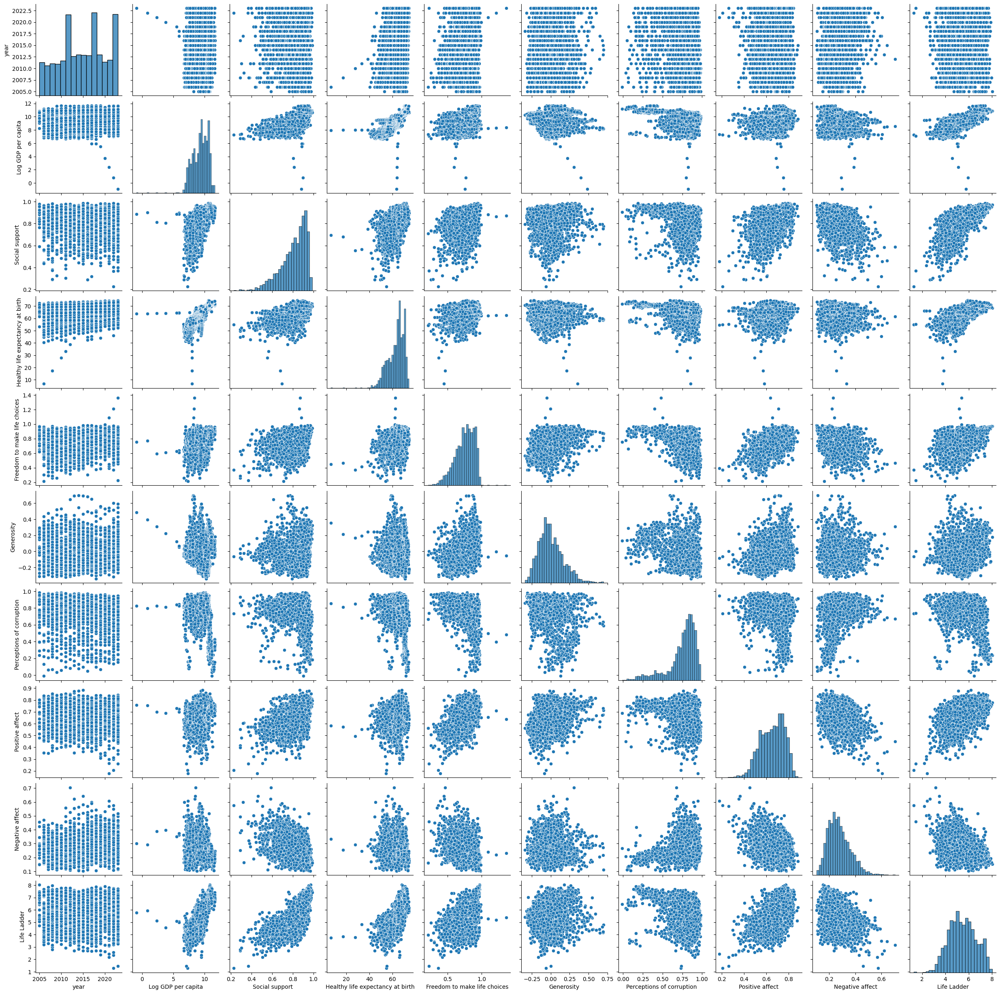

In [22]:
sns.pairplot(df_filled)
plt.show()

### Conclusions  
We have observed the following conclusions:  

* **Year:**  
    * Outliers in **Log GDP per capita** mainly appeared in the last six years.  
    * **Social support, Freedom to make life choices, Generosity,** and **Negative affect** have relatively stable values over time. However, **Freedom to make life choices** has some outliers in the last three years.  
    * **Healthy life expectancy at birth** seems to increase over time. Interestingly, some outliers appear to form a straight-line pattern.  
    * Over time, people perceive their governments as **less corrupt**, with an increasing number of observations showing lower values in this factor.  
    * A greater number of **low positive emotions** were observed during the **pandemic and post-pandemic periods**. However, these could be outliers.  
    * In the last two years, outliers with **very low Life Ladder values** have appeared.  

* **Log GDP per capita:**  
    * In all scatter plots, we observe outliers with **low Log GDP per capita values**.  
    * The relationship with **Social Support** suggests that countries with **high GDP per capita** tend to provide **strong social support**. However, countries with **low GDP per capita** can have either **high or low social support**.  
    * Apart from outliers, we observe a trend where **higher Log GDP per capita** is often linked to **higher Healthy life expectancy at birth**. This is logical, as countries with a high GDP per capita generally provide **better healthcare**, and people tend to be more aware of **preventive healthcare measures**.  
    * Regardless of **GDP per capita**, **freedom to make life choices** can be either **high or low**. However, countries with the **highest GDP per capita** tend to have **the highest values** for this factor. Both variables have noticeable outliers.  
    * Excluding outliers, **Perceptions of corruption** remain fairly stable regardless of **GDP per capita**, except in countries with the **highest GDP per capita**, where the full spectrum of **Perceptions of corruption** values can be observed.  
    * **Positive and Negative affect** do not show strong trends. However, **countries with the highest GDP per capita** tend to have **higher positive emotions** and **lower negative emotions**.  
    * Increasing **Log GDP per capita** often correlates with an increase in **Life Ladder**, meaning people from **wealthier countries** tend to be **more satisfied with life**.  

* **Social support:**  
    * Countries with **low Social Support** generally exhibit **low Generosity**, whereas countries with **high Social Support** show a full range of **Generosity** values.  
    * In countries with **low Social Support**, **Perceptions of corruption** tend to be **high**, whereas in countries with **high Social Support**, the **full spectrum** of corruption perceptions is observed.  
    * As **Social Support** increases, **Life Ladder** tends to reach **higher values**.  

* **Healthy life expectancy at birth:**  
    * No strong relationships are observed between this factor and **Freedom to make life choices, Generosity, Positive affect,** or **Negative affect**.  
    * In countries with **high Healthy life expectancy at birth**, people are more likely to **perceive their government as less corrupt** compared to those in countries with **low life expectancy**. In the **high range**, the full spectrum of corruption perception values is observed.  
    * People in countries with **high Healthy life expectancy at birth** tend to be **more satisfied with life**.  

* **Freedom to make life choices:**  
    * At **high values** of this factor, the **full spectrum** of **Perceptions of corruption** can be observed. However, when **Freedom to make life choices** is **low**, people are **more likely to perceive their government as corrupt**, which makes sense.  
    * The relationships with **Positive affect, Negative affect,** and **Life Ladder** are less obvious. However, there is **a higher chance** of **high Positive affect and Life Ladder values** at **high Freedom to make life choices**. Still, no clear trend is present. **Negative affect** remains relatively stable.  

* **Generosity:**  
    * **Generosity** does not significantly impact **Perceptions of corruption, Positive affect,** or **Life Ladder**.  
    * At **high Generosity values**, **Negative affect** tends to be **lower**.  

* **Perceptions of corruption:**  
    * At **low values** of this factor, people **experience stronger positive emotions**, whereas at **high values**, **Positive affect** spans a wide range.  
    * The opposite pattern is observed with **Negative affect**:  
      - **Low Perceptions of corruption** suggest **low Negative affect**.  
      - **High Perceptions of corruption** show **a full range of Negative affect values**.  
    * The relationship with **Life Ladder** is similar to that with **Positive affect**:  
      - **Low corruption perception** is associated with **higher life satisfaction**.  
      - **High corruption perception** is associated with **a wider range of life satisfaction levels**.  

* **Positive affect:**  
    * Typically, at **higher Positive affect values**, we observe **lower Negative affect** values, but this is not a strong trend.  
    * Higher **Positive affect** is often associated with **higher Life Ladder** values.  

* **Negative affect:**  
    * Higher **Negative affect** generally indicates **lower Life Ladder values**.  

We will introduce a **third dimension**—color—into our scatterplot matrix to **represent Life Ladder values**. This will help identify which **feature combinations** contribute the most to **life satisfaction**.  



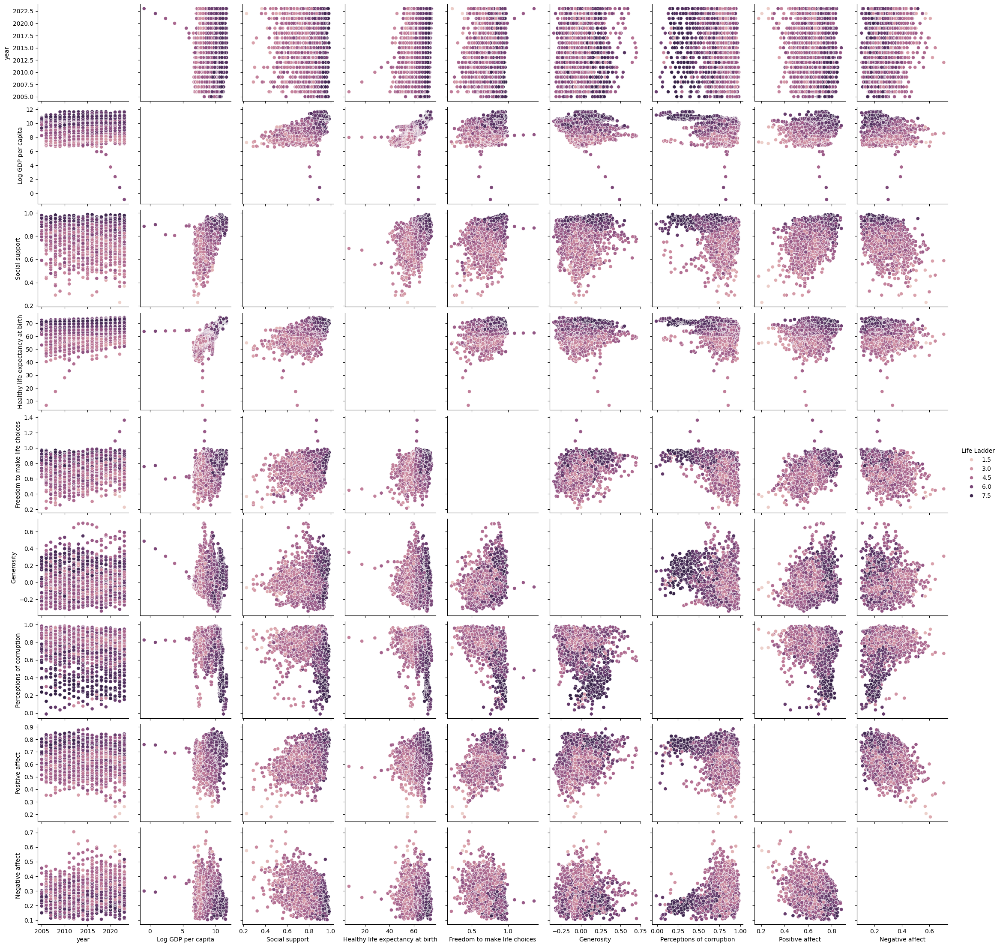

In [23]:
sns.pairplot(df_filled, hue="Life Ladder")
plt.show()

### Conclusions  
* **Year**  
    * No significant relationships were observed between **year** and other features in determining the output variable.  

* **Log GDP per capita**  
    * Combinations of **high Log GDP per capita** with **high Social support, Healthy life expectancy at birth, Freedom to make life choices,** and **Positive affect** result in **high Life Ladder values**. These factors may contribute to **high life satisfaction**. However, some observations show **low Positive affect** despite **high Log GDP per capita**, yet still have **high Life Ladder values**.  
    * **High Log GDP per capita** combined with **low Perceptions of corruption** and **low Negative affect** suggests **high Life Ladder values**, but there are exceptions to this trend.  

* **Social support**  
    * **High Social support**, together with **high Healthy life expectancy at birth, Freedom to make life choices**, and usually **Positive affect**, leads to **higher Life Ladder values**.  
    * The combination of **Social support** with **Generosity, Perceptions of corruption,** and **Negative affect** does not provide additional meaningful insights.  

* **Healthy life expectancy at birth**  
    * **High values** of this feature, combined with **high Freedom to make life choices** and **Positive affect**, typically result in **high Life Ladder values**.  
    * **High Healthy life expectancy at birth**, together with **low Negative affect**, also generally leads to **high Life Ladder values**.  

* **Freedom to make life choices**  
    * **High values** of this feature, combined with **low Perceptions of corruption**, generally lead to **high Life Ladder values**.  

* **Generosity**  
    * **Generosity** does not provide meaningful connections with other features.  

* **Perceptions of corruption**  
    * **Low Perceptions of corruption**, together with **low Negative affect**, generally result in **high Life Ladder values**.  

* **Positive affect**  
    * **High Positive affect**, combined with **low Negative affect**, is more likely to result in **high Life Ladder values**.  

To better visualize the relationships between features, we will create a **heatmap of correlation values**.  


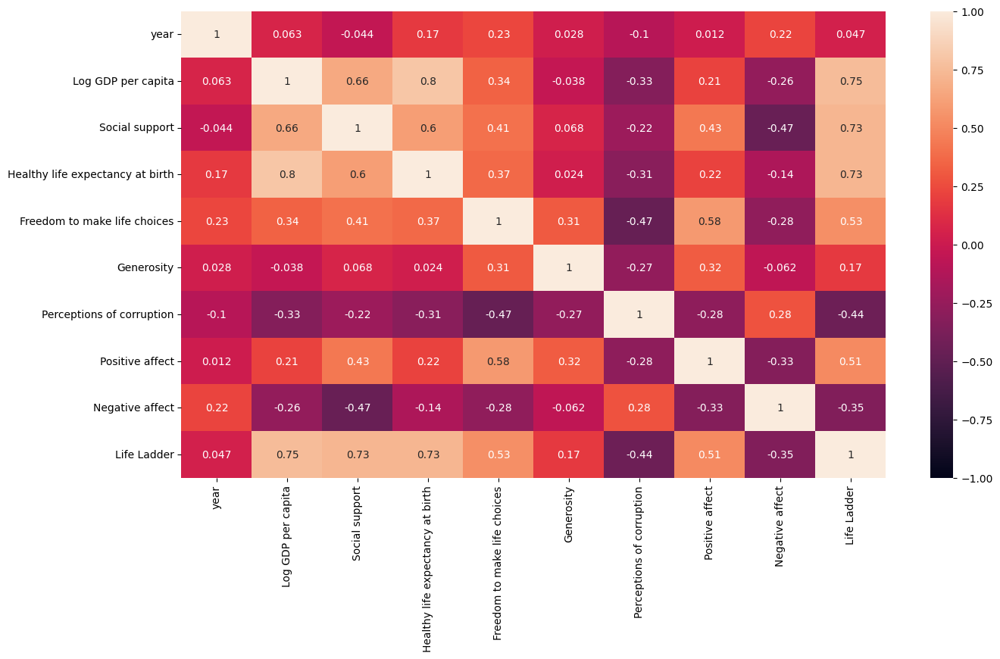

In [24]:
plt.figure(figsize=(15,8))
sns.heatmap(df_filled.iloc[:, 1:].corr(), annot=True, vmin=-1, vmax=1)
plt.show()

### Conclusions  
* The highest correlation (0.8) is observed between **Log GDP per capita** and **Healthy life expectancy at birth**—the wealthier a country, the more it invests in healthcare. In high **GDP per capita** countries, people are also more aware of preventive healthcare, which leads to **earlier disease detection** and **more effective treatment**.  
* A **strong correlation** is also seen between the **target variable** and **Log GDP per capita (0.75), Social support,** and **Healthy life expectancy at birth (0.73)**—people living in **prosperity and good health** tend to be **more satisfied with life**.  
* There is a **clear relationship** between **Social support** and **Log GDP per capita**, as well as between **Social support** and **Healthy life expectancy at birth**.  
* The **strongest negative correlation (-0.47)** is observed between **Negative affect and Social support**, as well as **Perceptions of corruption and Freedom to make life choices**.  
* A few additional correlations exist around **0.5**, but most relationships are weak, with **many uncorrelated features**.  
* The **year feature** has no significant correlation with any other feature.  
* An interesting observation is that **Positive affect and Negative affect** do not strongly depend on **Log GDP per capita**. The **level of experienced emotions** (both positive and negative) is **not directly influenced by GDP per capita**, whereas **overall life satisfaction is**.  
* Another surprising finding is **the lack of correlation between Generosity and Log GDP per capita**. One might expect that:  
  - As GDP per capita increases, **Generosity would also increase**, since wealthier countries could **afford more charitable contributions**.  
  - Conversely, **Generosity might be higher in poorer countries** due to the **presence of external charitable initiatives**.  
  - However, **no such relationship is observed**—GDP per capita **does not influence Generosity**.  
* It might seem intuitive that **higher Positive affect** would lead to **lower Negative affect**, but this is **not necessarily the case**. People can experience **both high positive and high negative emotions simultaneously**, meaning these features **are not strongly correlated**.  
* **Positive emotions have a stronger impact** on the **target variable (Life Ladder)** than **Negative emotions**.  

### Key Takeaways from the Above Graphs:  
* **Life Ladder** is **highly correlated** with **Log GDP per capita, Social support,** and **Healthy life expectancy at birth**.  
* A **strong correlation** exists between **Healthy life expectancy at birth and Log GDP per capita**.  
* **No relationship** is found between **Generosity and Log GDP per capita**.  
* **No strong correlation** exists between **Positive affect and Negative affect**.  
* **Perceptions of corruption** is **not strongly influenced by any single variable**.  


## Removing Outliers  

To prepare for the **modeling phase**, we will remove outliers. Below, we have decided to test **three approaches** to address this issue:  
* **Removing outliers using the interquartile range (IQR) with a standard multiplier**  
* **Removing outliers using the interquartile range with empirically chosen multipliers for individual columns**  
* **Removing outliers using the mean and standard deviation**  

We will start with the **first approach**, analyzing how histograms change after removing records that fall **below the first quartile or above the third quartile by more than 1.5 * IQR**.  


In [25]:
def remove_outliers_with_iqr(frame, columns):
    Q1 = frame.loc[:,columns].quantile(0.25)
    Q3 = frame.loc[:,columns].quantile(0.75)
    IQR = Q3 - Q1
    
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    df_filtered = frame[~((frame.loc[:,columns] < lower_bound) | (frame.loc[:,columns] > upper_bound)).any(axis=1)]
    return df_filtered
df_cleaned_iqr = remove_outliers_with_iqr(df_filled, df_filled.columns[2:])

In [26]:
n_rows_before = df_filled.shape[0]
n_rows_after = df_cleaned_iqr.shape[0]
print("Removing Outliers Using the Interquartile Range (IQR)")
print(f"Number of rows before removing outliers: {n_rows_before}")
print(f"Number of rows after removing outliers: {n_rows_after}")
print(f"Rows removed: {n_rows_before - n_rows_after}")
print(f"Percentage of rows removed: {np.round((n_rows_before - n_rows_after) / n_rows_before * 100, 2)}%")

Removing Outliers Using the Interquartile Range (IQR)
Number of rows before removing outliers: 2181
Number of rows after removing outliers: 1865
Rows removed: 316
Percentage of rows removed: 14.49%


The Interquartile Range (IQR) Method Removed 14.49% of Rows  
This is a relatively high number. Let's examine the histograms to see how the distributions have changed.  


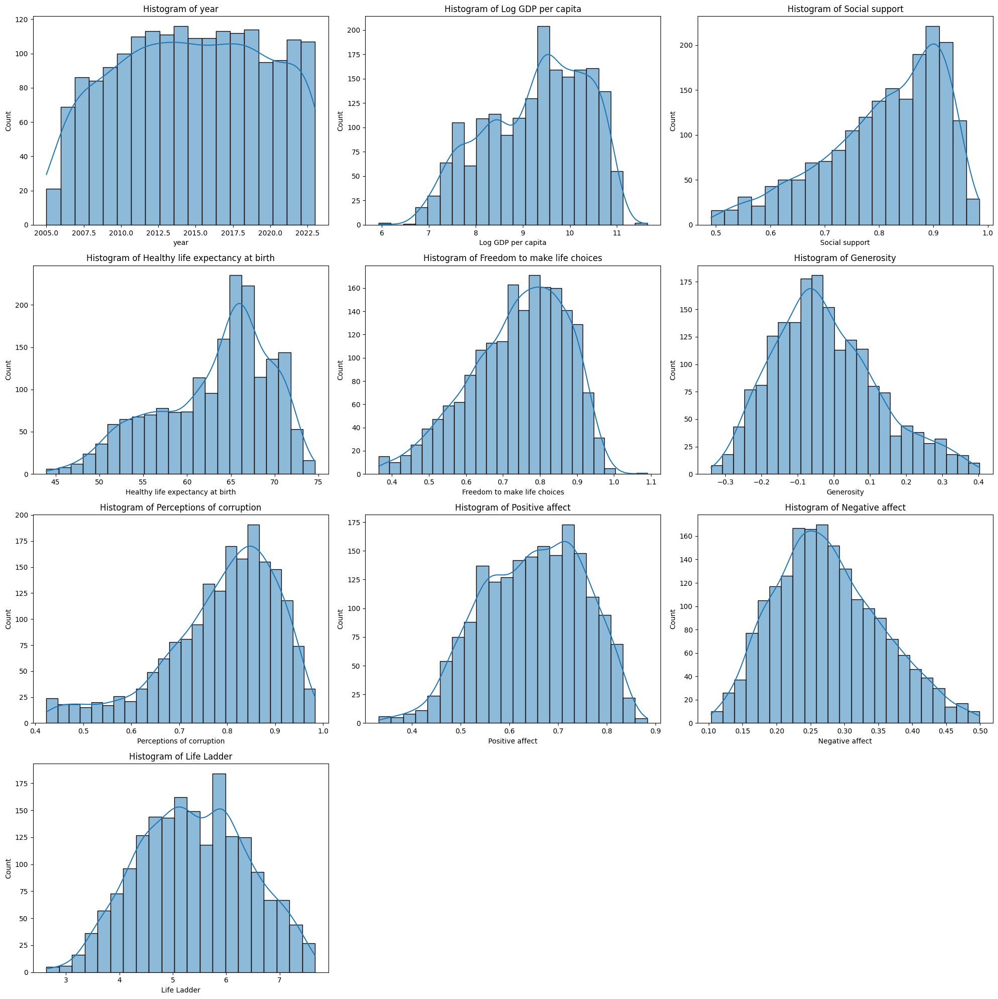

In [27]:
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_cleaned_iqr.columns[1:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_cleaned_iqr['year'].max() - df_cleaned_iqr['year'].min() + 1
    else:
        iqr = np.percentile(df_cleaned_iqr[column], 75) - np.percentile(df_cleaned_iqr[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_cleaned_iqr[column]))
        bins = int(np.ceil((df_cleaned_iqr[column].max() - df_cleaned_iqr[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    sns.histplot(df_cleaned_iqr[column], bins=bins, kde=True)
plt.tight_layout()
plt.show()

## Observations on Outlier Detection Using the Interquartile Range (IQR) Method  

- **Log GDP per capita**: Many high-value outliers were removed, but some low-value outliers remain.  
- **Social Support**: The lower tail was significantly trimmed, particularly between ~0.25 and 0.5.  
- **Healthy Life Expectancy at Birth**: Outliers were effectively removed, and the lower bound now starts around 45 years.  
- **Freedom to Make Life Choices**: The left tail was cut significantly, but some right-side outliers persist.  
- **Generosity**: The upper tail was reduced, eliminating values between 0.4 and ~0.7.  
- **Perceptions of Corruption**: The distribution changed drastically, losing nearly half of its original values—potentially removing valuable insights.  
- **Positive Affect**: Low-value observations were removed.  
- **Negative Affect**: The 0.5-0.7 range was trimmed.  
- **Life Ladder**: Mainly lost extremely low satisfaction values.  

### Conclusion  

The standard IQR method proved to be a very aggressive approach to outlier removal, significantly altering distributions. To counter this, we will experiment with an adjusted IQR method using empirically selected multipliers to better preserve important information while still eliminating true outliers.  

In [28]:
def remove_outliers_with_iqr_multiplied(frame, columns, multipliers):
    Q1 = frame.loc[:,columns].quantile(0.25)
    Q3 = frame.loc[:,columns].quantile(0.75)
    IQR = Q3 - Q1

    lower_bound = Q1 - multipliers * IQR
    upper_bound = Q3 + multipliers * IQR

    df_filtered = frame[~((frame.loc[:,columns] < lower_bound) | (frame.loc[:,columns] > upper_bound)).any(axis=1)]
    return df_filtered
column_multipliers = [1.5, 2, 2, 1.7, 1.9, 3, 1.5, 1.7, 1.5]
df_cleaned_iqr_mult = remove_outliers_with_iqr_multiplied(df_filled, df_filled.columns[2:], column_multipliers)

In [29]:
n_rows_before = df_filled.shape[0]
n_rows_after = df_cleaned_iqr_mult.shape[0]
print("Removing Outliers Using the Interquartile Range (IQR) with adjusted multipliers for each feature")
print(f"Number of rows before removing outliers: {n_rows_before}")
print(f"Number of rows after removing outliers: {n_rows_after}")
print(f"Rows removed: {n_rows_before - n_rows_after}")
print(f"Percentage of rows removed: {np.round((n_rows_before - n_rows_after) / n_rows_before * 100, 2)}%")

Removing Outliers Using the Interquartile Range (IQR) with adjusted multipliers for each feature
Number of rows before removing outliers: 2181
Number of rows after removing outliers: 2087
Rows removed: 94
Percentage of rows removed: 4.31%


After applying different multipliers for individual columns, we can see that the number of removed records has decreased to 4.31%, which is a much more reasonable result. Below, we can see how this affected the distributions.

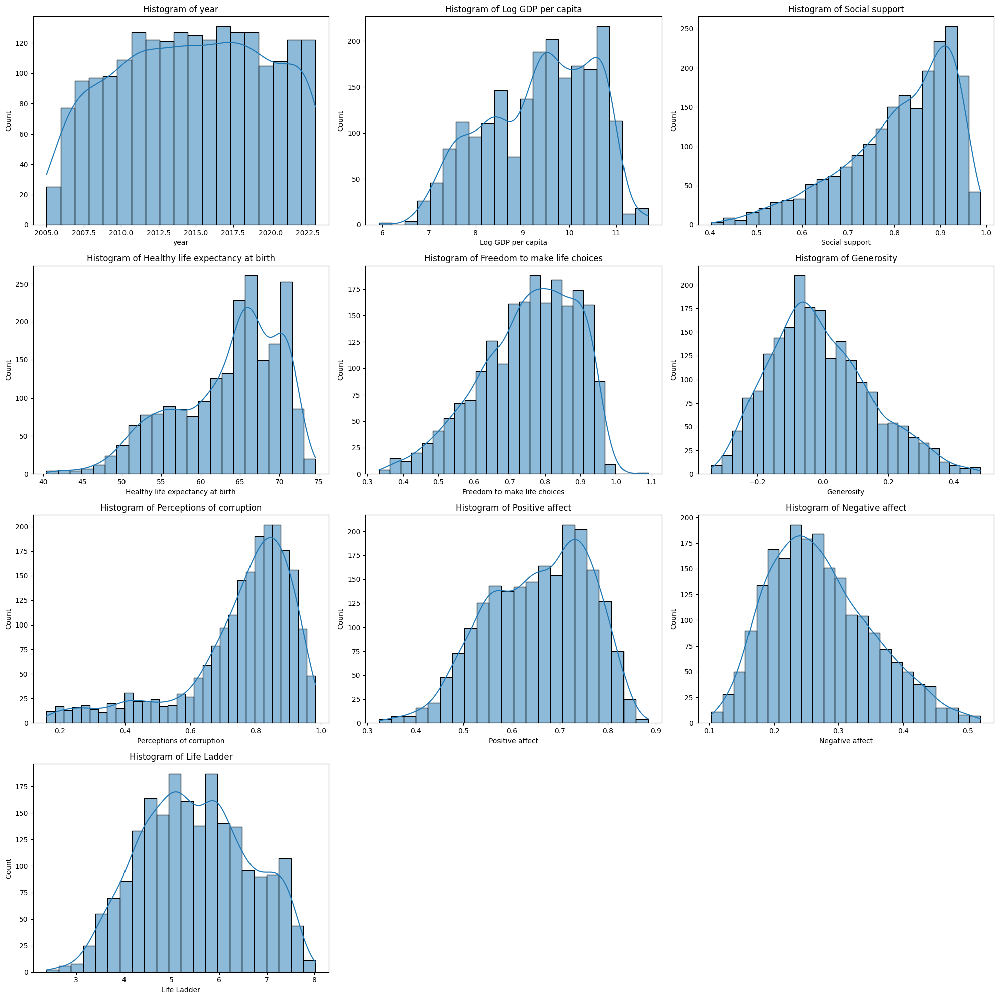

In [30]:
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_cleaned_iqr_mult.columns[1:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_cleaned_iqr_mult['year'].max() - df_cleaned_iqr_mult['year'].min() + 1
    else:
        iqr = np.percentile(df_cleaned_iqr_mult[column], 75) - np.percentile(df_cleaned_iqr_mult[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_cleaned_iqr_mult[column]))
        bins = int(np.ceil((df_cleaned_iqr_mult[column].max() - df_cleaned_iqr_mult[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    sns.histplot(df_cleaned_iqr_mult[column], bins=bins, kde=True)
plt.tight_layout()
plt.show()

* **Log GDP per capita**: Significantly more observations with high values of this indicator have been retained. This seems reasonable, as they do not appear to be outliers. The change occurred despite no modification of the multiplier for this feature. This means that in the previous case, these observations were considered outliers based on other features.
* **Social support**: Several observations with low values of this indicator were also removed, but fewer than with the standard interquartile range method. The distribution now looks more reasonable, with removed observations appearing after a larger "gap" in values from the main part of the distribution.
* **Healthy life expectancy at birth**: The method handled outliers well. More observations between 40 and 45 years of age have been retained. Looking at the distribution, this also seems like a better decision.
* **Freedom to make life choices**: Again, fewer records with low values were removed. The method still did not handle all outliers on the right side.
* **Generosity**: More records have been retained in the high-value range.
* **Perceptions of corruption**: The distribution looks much more reasonable. The roughly uniform tail is no longer cut in half but mostly preserved. We believe that retaining these observations will positively impact the model, as low values of this indicator may contribute positively to perceived happiness levels.
* **Positive affect**: The distribution did not change, as we applied the same multiplier.
* **Negative affect**: Slightly more values above 0.5 have been retained.
* **Life Ladder**: Despite keeping the multiplier at 1.5, we can see slightly more observations with low values. This suggests that their previous removal was not due to being outliers from the perspective of **Life Ladder** but rather from the perspective of other features.

This method appears to perform significantly better than the standard approach of removing outliers using the interquartile range with a multiplier of 1.5. The removal is no longer as strict as in the previous method, which may help retain important information for the model. We will compare this method with removing outliers that are located further than three standard deviations from the mean.


In [31]:
def remove_outliers_with_std(frame, columns):
    df_filtered = frame[(np.abs((frame.loc[:,columns] - frame.loc[:,columns].mean()) / frame.loc[:,columns].std()) <= 3).all(axis=1)]
    return df_filtered
df_cleaned_std = remove_outliers_with_std(df_filled, df_filled.columns[2:])

In [32]:
n_rows_before = df_filled.shape[0]
n_rows_after = df_cleaned_std.shape[0]
print("Removing Outliers Using Mean and Standard Deviation")
print(f"Number of rows before removing outliers: {n_rows_before}")
print(f"Number of rows after removing outliers: {n_rows_after}")
print(f"Rows removed: {n_rows_before - n_rows_after}")
print(f"Percentage of rows removed: {np.round((n_rows_before - n_rows_after) / n_rows_before * 100, 2)}%")

Removing Outliers Using Mean and Standard Deviation
Number of rows before removing outliers: 2181
Number of rows after removing outliers: 2060
Rows removed: 121
Percentage of rows removed: 5.55%


The percentage of removed records is **5.55%**. This is slightly higher than in the previous method but significantly lower than when using the standard interquartile range approach. Let's examine how the distributions appear on the histograms.

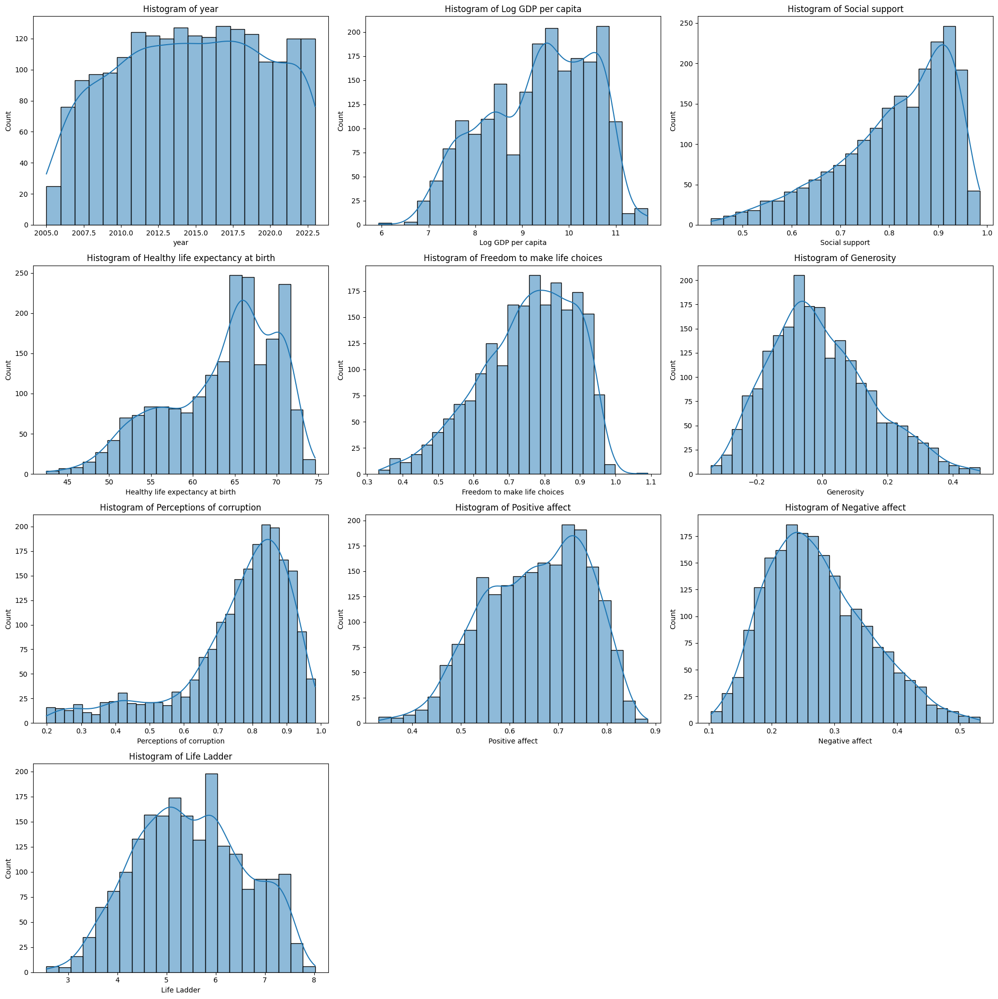

In [33]:
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_cleaned_std.columns[1:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_cleaned_std['year'].max() - df_cleaned_std['year'].min() + 1
    else:
        iqr = np.percentile(df_cleaned_std[column], 75) - np.percentile(df_cleaned_std[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_cleaned_std[column]))
        bins = int(np.ceil((df_cleaned_std[column].max() - df_cleaned_std[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    sns.histplot(df_cleaned_std[column], bins=bins, kde=True)
plt.tight_layout()
plt.show()

* **Log GDP per capita:** The distribution looks identical to the one obtained using the interquartile range method with modified multipliers.
* **Social support:** Slightly more values with very low Social support were removed.
* **Healthy life expectancy at birth:** Slightly more values closer to 40 years were removed.
* **Freedom to make life choices:** The distribution looks identical to the one obtained using the interquartile range method with modified multipliers.
* **Generosity:** The distribution looks identical to the one obtained using the interquartile range method with modified multipliers.
* **Perceptions of corruption:** Some observations below a corruption index of 0.2 were removed.
* **Positive affect:** Slightly more observations were removed from the left side of the distribution.
* **Negative affect:** Slightly more observations were retained on the right side of the distribution.
* **Life Ladder:** Slightly more extreme values were removed from both ends of the distribution.

After analyzing the histograms, we can see that the most reasonable results come from the second and third tested methods. The standard interquartile range approach removes too many potentially important values. The results for outlier removal using the interquartile range with different multipliers per column and using the 3*sigma rule are quite similar, with the latter removing slightly more observations from the tails. We believe that many of these values might carry important information about life satisfaction. For this reason, we will proceed with the dataset where outliers were removed based on the interquartile range method with different multipliers per column.

However, before moving forward, we decided to manually remove a few observations that still appear to be outliers but were not classified as such by any of the methods. Specifically, we will remove values above **1** for **Freedom to make life choices** and values below **6.5** for **Log GDP per capita**.


In [34]:
df_cleaned = df_cleaned_iqr_mult.copy()
df_cleaned = df_cleaned[(df_cleaned['Log GDP per capita'] > 6.5) & (df_cleaned['Freedom to make life choices'] <= 1)]
n_rows_before = df_cleaned_iqr_mult.shape[0]
n_rows_after = df_cleaned.shape[0]
print(f"Number of rows before removing outliers: {n_rows_before}")
print(f"Number of rows after removing outliers: {n_rows_after}")
print(f"Rows removed: {n_rows_before - n_rows_after}")
print(f"Percentage of rows removed: {np.round((n_rows_before - n_rows_after) / n_rows_before * 100, 2)}%")

Number of rows before removing outliers: 2087
Number of rows after removing outliers: 2084
Rows removed: 3
Percentage of rows removed: 0.14%


In this way, we removed an additional 3 records that appeared to be outliers based on visual analysis.

## Re-analysis of Variable Ranges

First, let's check how the descriptive statistics of the dataset have changed.

In [35]:
df_cleaned.describe()

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Life Ladder
count,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000,2084.000000
mean,2014.763436,9.367891,0.812375,63.439947,0.753331,-0.005958,0.751552,0.655280,0.272291,5.497613
std,5.068819,1.130475,0.118199,6.664704,0.134240,0.154012,0.174619,0.104890,0.079915,1.121938
min,2005.000000,6.607256,0.403708,40.400002,0.332436,-0.339547,0.158601,0.324108,0.103494,2.375092
25%,2011.000000,8.491347,0.741309,58.787499,0.663034,-0.115853,0.694682,0.574706,0.211704,4.650702
50%,2015.000000,9.509890,0.838485,65.110001,0.771647,-0.026559,0.800590,0.664664,0.261768,5.453484
75%,2019.000000,10.321952,0.908117,68.742498,0.861066,0.089226,0.868862,0.741009,0.324709,6.314347
max,2023.000000,11.675588,0.987343,74.599998,0.991866,0.482244,0.983276,0.883586,0.519858,8.018934


We observe a decrease in the standard deviations of all features. Let's analyze the final distributions on the histograms.

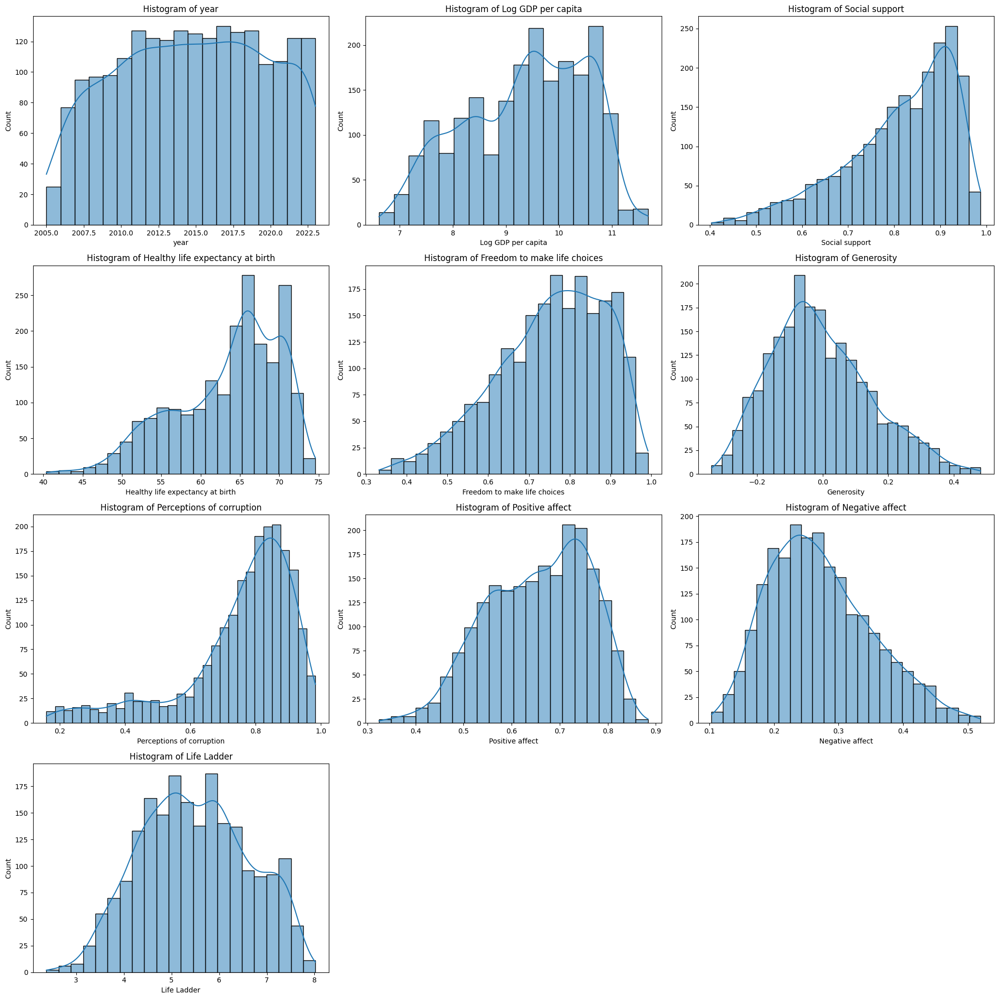

In [36]:
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_cleaned.columns[1:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_cleaned['year'].max() - df_cleaned['year'].min() + 1
    else:
        iqr = np.percentile(df_cleaned[column], 75) - np.percentile(df_cleaned[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_cleaned[column]))
        bins = int(np.ceil((df_cleaned[column].max() - df_cleaned[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    sns.histplot(df_cleaned[column], bins=bins, kde=True)
plt.tight_layout()
plt.show()

* **year**: The distribution has not changed significantly. The range remains from 2005 to 2023.
* **Log GDP per capita**: No more outliers are observed. The variability range is approximately 6.5 to 12. There is a predominance of countries with medium-high Log GDP per capita.
* **Social support**: Left-skewed distribution, with a variability range from around 0.4 to nearly 1. Most records have values around 0.9, indicating a generally high level of social support.
* **Healthy life expectancy at birth**: Distribution with a left tail. The range varies from around 40 to 75. Most records have values above 60, with peaks around 65 and 70. However, few records have values close to 75.
* **Freedom to make life choices**: Left-skewed distribution with a variability range from around 0.3 to 1. A majority of values fall between 0.7 and 0.95.
* **Generosity**: More right-skewed distribution, with a range from around -0.3 to 0.5. Most values are clustered around small negative values.
* **Perceptions of corruption**: Left-skewed distribution with a significant tail. The range varies from about 0.15 to 1. The vast majority of records indicate high perceived corruption, while values below 0.6 are relatively evenly distributed.
* **Positive affect**: The variability range is from around 0.3 to about 0.9. Few records exhibit extremely low or extremely high values.
* **Negative affect**: Right-skewed distribution. The range varies from around 0.1 to 0.5, with fewer individuals experiencing high levels of negative emotions.
* **Life Ladder**: A distribution close to normal but with a steeper decline at lower values. The range varies from around 2.5 to about 8.

We can also visualize these variability ranges using box plots.


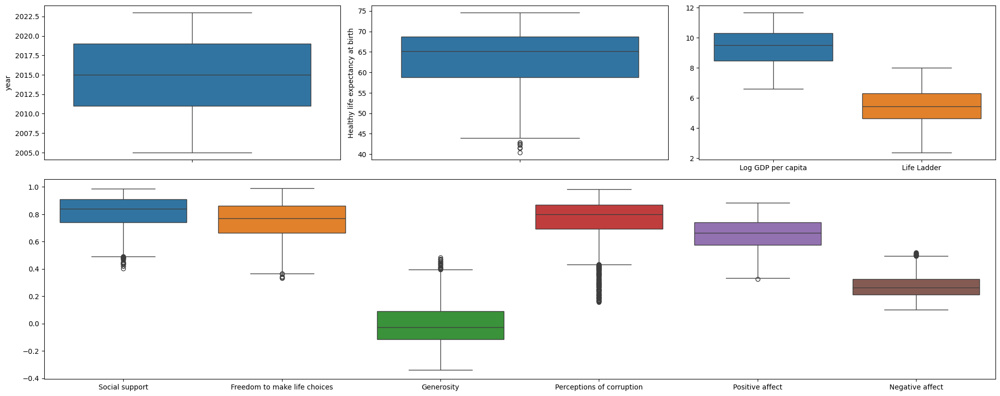

In [37]:
fig = plt.figure(figsize=(20, 8))
gs = fig.add_gridspec(2, 3, height_ratios=[1, 1.3])

ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])

sns.boxplot(df_cleaned['year'], ax=ax1)
sns.boxplot(df_cleaned['Healthy life expectancy at birth'], ax=ax2)
sns.boxplot(df_cleaned[['Log GDP per capita', 'Life Ladder']], ax=ax3)

ax4 = fig.add_subplot(gs[1, :])
sns.boxplot(df_cleaned[['Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']], ax=ax4)
plt.tight_layout()
plt.show()

* **Healthy life expectancy at birth**: The scale has changed dramatically. We now see a few observations classified by seaborn as outliers, but they are very close to the main range. Observations below the median have significantly greater variability than those above. The range is approximately 40-75 years.
* **Log GDP per capita**: All outliers have been removed. The variability range below the median is wider than above. The range is from around 6.5 to just under 12.
* **Life Ladder**: No more outliers, and its distribution is close to normal. The variability range is from about 2.5 to around 8.
* **Social support**: The number of outliers has been significantly reduced, though some remain. This is likely due to the highly left-skewed distribution. The range is from approximately 0.4 to 1, with a narrower variability range above the median.
* **Freedom to make life choices**: The number of outliers on both sides has been reduced, and high-value outliers have been completely removed. The range is about 0.3 to 1, with a narrower variability range above the median.
* **Generosity**: The number of outliers has been reduced, but some observations are still classified as outliers. The range is from around -0.3 to approximately 0.5, with a narrower variability range below the median.
* **Perceptions of corruption**: Records with very low perceived corruption have been removed. The range is from around 0.15 to 1. A large number of values are still classified as outliers by seaborn, which is expected due to the left-skewed nature of the distribution. We chose to retain much of this tail as potentially important. The variability range is narrower above the median.
* **Positive affect**: Almost all outliers have been removed. The new range is approximately 0.3 to 0.9, with a narrower variability range above the median.
* **Negative affect**: Almost all outliers have been removed. The new range is approximately 0.1 to 0.5, with a narrower variability range below the median.

Let's display the exact variability ranges:


In [38]:
for column in df_cleaned.columns[1:]:
    min = df_cleaned.loc[:, column].min()
    max = df_cleaned.loc[:, column].max()
    print(f"Variability range for column {column} is: <{np.round(min, 2)}; {np.round(max, 2)}>")

Variability range for column year is: <2005; 2023>
Variability range for column Log GDP per capita is: <6.61; 11.68>
Variability range for column Social support is: <0.4; 0.99>
Variability range for column Healthy life expectancy at birth is: <40.4; 74.6>
Variability range for column Freedom to make life choices is: <0.33; 0.99>
Variability range for column Generosity is: <-0.34; 0.48>
Variability range for column Perceptions of corruption is: <0.16; 0.98>
Variability range for column Positive affect is: <0.32; 0.88>
Variability range for column Negative affect is: <0.1; 0.52>
Variability range for column Life Ladder is: <2.38; 8.02>


Let's see if we can observe any changes in the **scatter plots**.


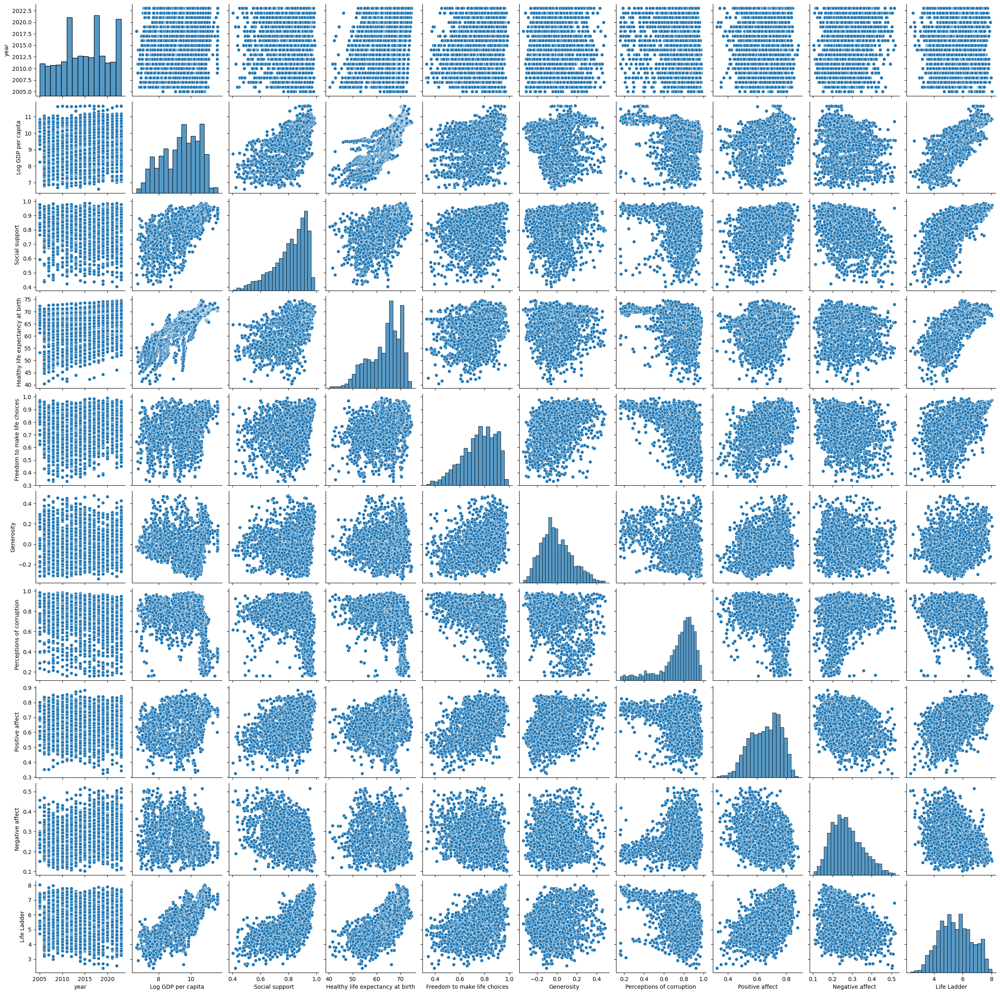

In [39]:
sns.pairplot(df_cleaned)
plt.show()

* In the **Log GDP per capita** plots, the relationship between **Log GDP per capita** and **Life Ladder**, **Healthy life expectancy at birth**, and **Social support** is much clearer.  
* After removing outliers, it becomes evident that some plots are just one large cluster of points without a significant trend.  
* The trend between **Healthy life expectancy at birth** and **Life Ladder** is more noticeable.  
* In countries with the highest **Log GDP per capita**, we observe the full spectrum of **Perceptions of corruption**, along with high levels of **Positive affect** and low levels of **Negative affect**. A similar pattern can be seen in **Social support** plots.  
* **Perceptions of corruption** spans the full range of values at high levels of all variables except **Year**, **Generosity**, and **Negative affect**. Apart from the highest values of these variables, **Perceptions of corruption** remains relatively high. At low values of **Perceptions of corruption**, **Negative affect** tends to be low.


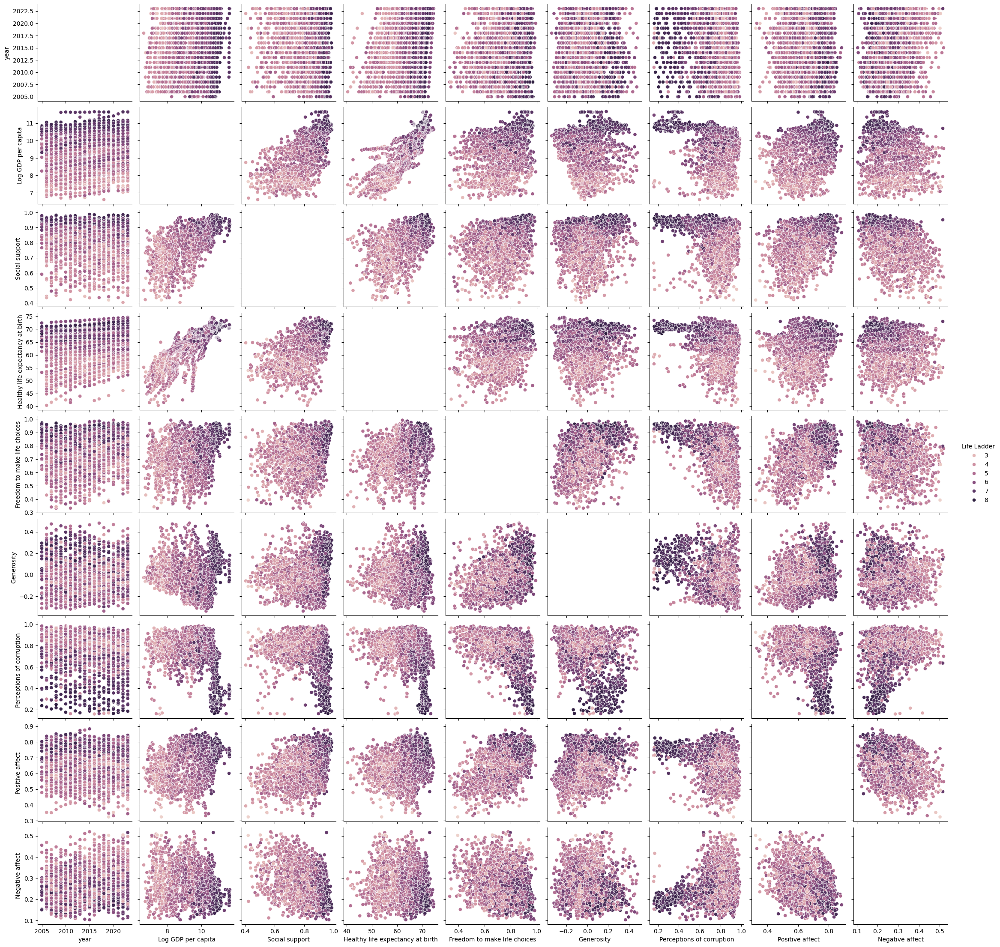

In [40]:
sns.pairplot(df_cleaned, hue="Life Ladder")
plt.show()

* The connection between high **Life Ladder** values and the combination of high **Healthy life expectancy at birth** and **Freedom to make life choices** may now be slightly more visible.  
* Combinations of high feature values leading to high **Life Ladder** values:  
  - **Log GDP per capita** and **Social support**  
  - **Log GDP per capita** and **Healthy life expectancy at birth**  
  - **Log GDP per capita** and **Freedom to make life choices**  
  - **Log GDP per capita** and **Positive affect**  
  - **Social support** and **Healthy life expectancy at birth**  
  - **Social support** and **Freedom to make life choices**  
  - **Healthy life expectancy at birth** and **Freedom to make life choices**  
  - **Healthy life expectancy at birth** and **Positive affect**  
* High **Life Ladder** values also result from the combination of low **Perceptions of corruption** with low **Negative affect**, as well as with high **Positive affect**, **Freedom to make life choices**, **Healthy life expectancy at birth**, and **Log GDP per capita**.  

Let's also analyze changes in correlation:



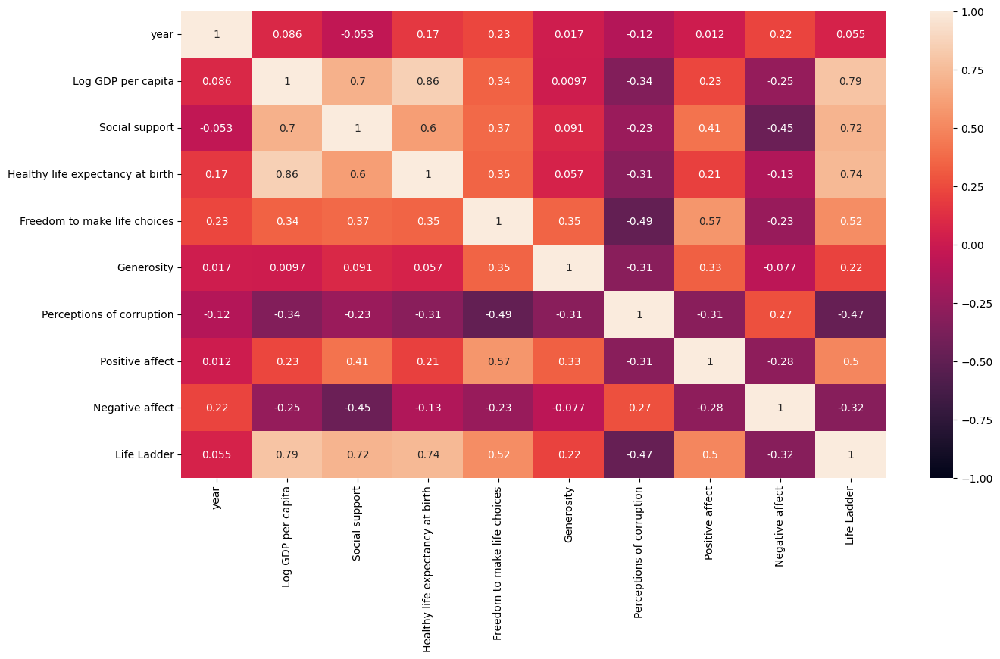

In [41]:
plt.figure(figsize=(15,8))
sns.heatmap(df_cleaned.iloc[:, 1:].corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* The correlation between **Log GDP per capita** and **Healthy life expectancy at birth** increased by 0.06 (now 0.86).  
* The correlation between **Social support** and **Life Ladder** decreased by 0.01 (now 0.72).  
* The correlation between **Log GDP per capita** and **Life Ladder** increased by 0.04 (now 0.79).  
* The correlation between **Life Ladder** and **Healthy life expectancy at birth** increased by 0.01 (now 0.74).  
* The correlation between **Log GDP per capita** and **Social support** increased by 0.04 (now 0.70).  
* The lowest negative correlation increased to -0.49 between **Perceptions of corruption** and **Freedom to make life choices**.  

## Visualization of Features by Geographic Region  
At this stage, we want to examine whether there are any relationships between feature values and geographic location. To do this, we will plot the average feature values for countries on a map.  

In [42]:
df_groupped = df_cleaned.groupby("Country name").mean()

In [43]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Log GDP per capita',
                    title='Log GDP per capita per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The highest values of this indicator are observed in North America, Europe, Australia, New Zealand, as well as Japan and South Korea—i.e., in the most developed countries.  
* Lower values are observed in South Asia and Central and South America, with the lowest values in Africa.  
* Throughout South America, Log GDP per capita values are relatively similar.  
* Countries between Mexico and South America have a relatively low Log GDP per capita.  

In [44]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Social support',
                    title='Social support per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* Very low values of **Social support** are observed only in a few countries, such as the Central African Republic and Afghanistan. In general, lower values are found in most African countries and in Central-Southern Asia.  
* Europe, Australia, and both Americas tend to have relatively high values of this indicator.  
* Iceland has the highest value of this coefficient—up to 0.97.  
* In Africa, the closer to the equator, the lower the **Social support** value (in most cases).  
* In Europe, the lowest values of this indicator are found in the former Yugoslav territories and Romania.  

In [45]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Healthy life expectancy at birth',
                    title='Healthy life expectancy at birth per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The highest value of **Healthy life expectancy at birth** is in Japan, which is not surprising given its long-living society.  
* High values are also observed in Australia, New Zealand, Canada, and Western and Northern Europe.  
* **Healthy life expectancy at birth** in the United States is similar to that in Central-Eastern Europe.  
* The lowest value of this indicator was recorded in the Central African Republic (42 years).  
* The lowest values of this indicator are observed in Africa (excluding North Africa) and in South-Central Asia.  

In [46]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Freedom to make life choices',
                    title='Freedom to make life choices per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The greatest **freedom to make life choices** is observed in Scandinavian countries, Cambodia, Uzbekistan, Canada, Australia, New Zealand, and Somalia. In the cases of Somalia and Cambodia, this is particularly surprising, considering the tense situation between Somalia and Somaliland, as well as child labor in harsh conditions in Cambodia.  
* The lowest values are again observed in Africa and most of Asia, particularly in the Middle East.  
* Low values are also observed in the Balkans and Italy, which is very interesting. This could potentially be explained by inequalities between the north and south of the country or strong family ties that may influence people's decisions.  
* Low index values are also found in Russia, Belarus, and Ukraine.  

In [47]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Generosity',
                    title='Generosity per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* **Generosity** values are not high worldwide.  
* The standout countries are Myanmar, Thailand, Indonesia, and England, which achieve the highest values of this index.  
* Europe mostly exhibits negative **Generosity**, with the lowest value in Greece, which could be a consequence of the financial crisis. However, there are a few European countries with non-negative values, including England, the Netherlands, German-speaking countries, and Scandinavian countries.  
* High values are also observed in Canada and the United States.  


In [48]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Perceptions of corruption',
                    title='Perceptions of corruption per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The lowest **Perceptions of corruption** are observed in Scandinavian countries, Switzerland, New Zealand, and Rwanda. We compared this data with the **Corruption Perceptions Index** available at: https://en.wikipedia.org/wiki/Corruption_Perceptions_Index.  
  While the data for most countries aligns well, Rwanda is ranked in the top quartile but not in the first position. This could be due to a data error or differences in the sample used for these datasets.  
* Apart from these countries, there is a general trend of perceiving governments as more corrupt.  
* The largest concentration of countries with high **Perceptions of corruption** values is found in the Balkans and Eastern Europe.  
* The highest **Perceptions of corruption** value is in Indonesia, which also had one of the highest **Generosity** values.  
* In most South American and African countries, the index values are relatively similar.  


In [49]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Positive affect',
                    title='Positive affect per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* A higher prevalence of **Positive Affect** is observed in the West—across both Americas.  
* The highest **Positive Affect** value is found in Paraguay.  
* High values are also observed in Thailand, Australia and Oceania, Iceland, and the Scandinavian Peninsula.  
* The lowest **Positive Affect** levels are reported in the Middle East and South-Central Asia.  
* Interestingly, people in Poland report experiencing more positive emotions than those in sun-drenched Italy. This might suggest that Poles are not as gloomy as stereotypes often portray.  
* In most of Europe, **Positive Affect** levels are lower than in the Americas.  
* The lowest **Positive Affect** values are recorded in Turkey and Yemen.  

In [50]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Negative affect',
                    title='Negative affect per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The highest **Negative Affect** levels are reported among Iraqis and Iranians, while the lowest are observed among citizens of Kazakhstan.  
* Looking at the Middle East and South-Central Asia, one might conclude that low **Positive Affect** often coincides with high **Negative Affect**. However, this is not always the case—South America generally exhibits relatively high values for both indicators.  
* The lowest **Negative Affect** levels are usually found among citizens of Asian countries located north of Tajikistan.  

In [51]:
fig = px.choropleth(df_groupped,
                    locations=df_groupped.index,
                    locationmode='country names',
                    color='Life Ladder',
                    title='Life Ladder per country',
                    color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(
    width=1500,
    height=800
)
fig.show()

* The countries with the highest **Life Ladder** (life satisfaction) are Denmark and other Scandinavian nations, which aligns with popular rankings. High values are also observed in Switzerland, Iceland, Australia, New Zealand, and Canada.  
* People living in Africa and Asia tend to have the lowest **Life Ladder** values.  

To analyze correlations across different continents, we decided to add a **Continent** column based on the ISO 3166 standard.  

In [52]:
def get_continent(country_name):
    try:
        country_alpha2 = pycountry.countries.lookup(country_name).alpha_2
        continent_code = country_alpha2_to_continent_code(country_alpha2)
        return convert_continent_code_to_continent_name(continent_code)
    except:
        return "Unknown"

df_cleaned_cont = df_cleaned.copy()
df_cleaned_cont['Continent'] = df['Country name'].apply(get_continent)
cols = list(df_cleaned_cont.columns)
cols.insert(1, cols.pop(cols.index('Continent')))
df_cleaned_cont = df_cleaned_cont[cols]
df_cleaned_cont

,Country name,Continent,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Life Ladder
0,Afghanistan,Asia,2008,7.350416,0.450662,50.500000,0.718114,0.164055,0.881686,0.414297,0.258195,3.723590
1,Afghanistan,Asia,2009,7.508646,0.552308,50.799999,0.678896,0.187297,0.850035,0.481421,0.237092,4.401778
2,Afghanistan,Asia,2010,7.613900,0.539075,51.099998,0.600127,0.117861,0.706766,0.516907,0.275324,4.758381
3,Afghanistan,Asia,2011,7.581259,0.521104,51.400002,0.495901,0.160098,0.731109,0.479835,0.267175,3.831719
4,Afghanistan,Asia,2012,7.660506,0.520637,51.700001,0.530935,0.234157,0.775620,0.613513,0.267919,3.782938
...,...,...,...,...,...,...,...,...,...,...,...,...
2358,Zimbabwe,Africa,2019,7.697755,0.759162,53.099998,0.631908,-0.050874,0.830652,0.658434,0.235354,2.693523
2359,Zimbabwe,Africa,2020,7.596050,0.717243,53.575001,0.643303,0.002848,0.788523,0.660658,0.345736,3.159802
2360,Zimbabwe,Africa,2021,7.656878,0.685151,54.049999,0.667636,-0.079007,0.756945,0.609917,0.241682,3.154578
2361,Zimbabwe,Africa,2022,7.670073,0.666172,54.525002,0.651987,-0.072935,0.752632,0.640609,0.191350,3.296220


We will check whether the data for each country has been correctly mapped.  

In [53]:
df_cleaned_cont[df_cleaned_cont['Continent'] == 'Unknown'].groupby('Country name').count()

,Continent,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Life Ladder
Country name,,,,,,,,,,,
Congo (Brazzaville),14,14,14,14,14,14,14,14,14,14,14
Congo (Kinshasa),10,10,10,10,10,10,10,10,10,10,10
Ivory Coast,12,12,12,12,12,12,12,12,12,12,12
Russia,18,18,18,18,18,18,18,18,18,18,18
Turkey,16,16,16,16,16,16,16,16,16,16,16


We can see that the names of a few countries turned out to be problematic. We will manually fill in the continent information for these countries.  

In [54]:
df_cleaned_cont.loc[df_cleaned_cont['Country name'] == 'Congo (Brazzaville)', 'Continent'] = get_continent('Congo')
df_cleaned_cont.loc[df_cleaned_cont['Country name'] == 'Congo (Kinshasa)', 'Continent'] = get_continent('Congo, the Democratic Republic of the')
df_cleaned_cont.loc[df_cleaned_cont['Country name'] == 'Ivory Coast', 'Continent'] = get_continent("Côte d'Ivoire")
df_cleaned_cont.loc[df_cleaned_cont['Country name'] == 'Russia', 'Continent'] = get_continent("Russian Federation")
df_cleaned_cont.loc[df_cleaned_cont['Country name'] == 'Turkey', 'Continent'] = get_continent("Türkiye")

Teraz możemy zobaczyć, że nie ma już żadnego kraju z kontynentem Unknown

In [55]:
df_cleaned_cont[df_cleaned_cont['Continent'] == 'Unknown'].groupby('Country name').count()

,Continent,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Life Ladder
Country name,,,,,,,,,,,


Now we can split the aggregated dataset by continents.  

In [56]:
df_asia = df_cleaned_cont[df_cleaned_cont['Continent'] == 'Asia']
df_africa = df_cleaned_cont[df_cleaned_cont['Continent'] == 'Africa']
df_europe = df_cleaned_cont[df_cleaned_cont['Continent'] == 'Europe']
df_south_america = df_cleaned_cont[df_cleaned_cont['Continent'] == 'South America']
df_north_america = df_cleaned_cont[df_cleaned_cont['Continent'] == 'North America']
df_oceania = df_cleaned_cont[df_cleaned_cont['Continent'] == 'Oceania']

We will check if the sum of records in the new dataframes matches the number of records in the original dataframe and print the number of records in each dataframe.  

In [57]:
sum_of_records = df_asia.shape[0] + df_africa.shape[0] + df_europe.shape[0] + df_south_america.shape[0] + df_north_america.shape[0] + df_oceania.shape[0]
if sum_of_records == df_cleaned.shape[0]:
    print('Number of records is the same')
else:
    print("Number of records differs")
print(f'Number of records in Asia: {df_asia.shape[0]}')
print(f'LNumber of records in Africa: {df_africa.shape[0]}')
print(f'Number of records in Europe: {df_europe.shape[0]}')
print(f'Number of records in North America: {df_north_america.shape[0]}')
print(f'Number of records in South America: {df_south_america.shape[0]}')
print(f'Number of records in Oceania: {df_oceania.shape[0]}')

Number of records is the same
Number of records in Asia: 487
LNumber of records in Africa: 561
Number of records in Europe: 631
Number of records in North America: 197
Number of records in South America: 174
Number of records in Oceania: 34


The highest number of records is in **Europe**, while the lowest is in **Oceania**.  
We can also examine histograms of features overlaid for each continent.

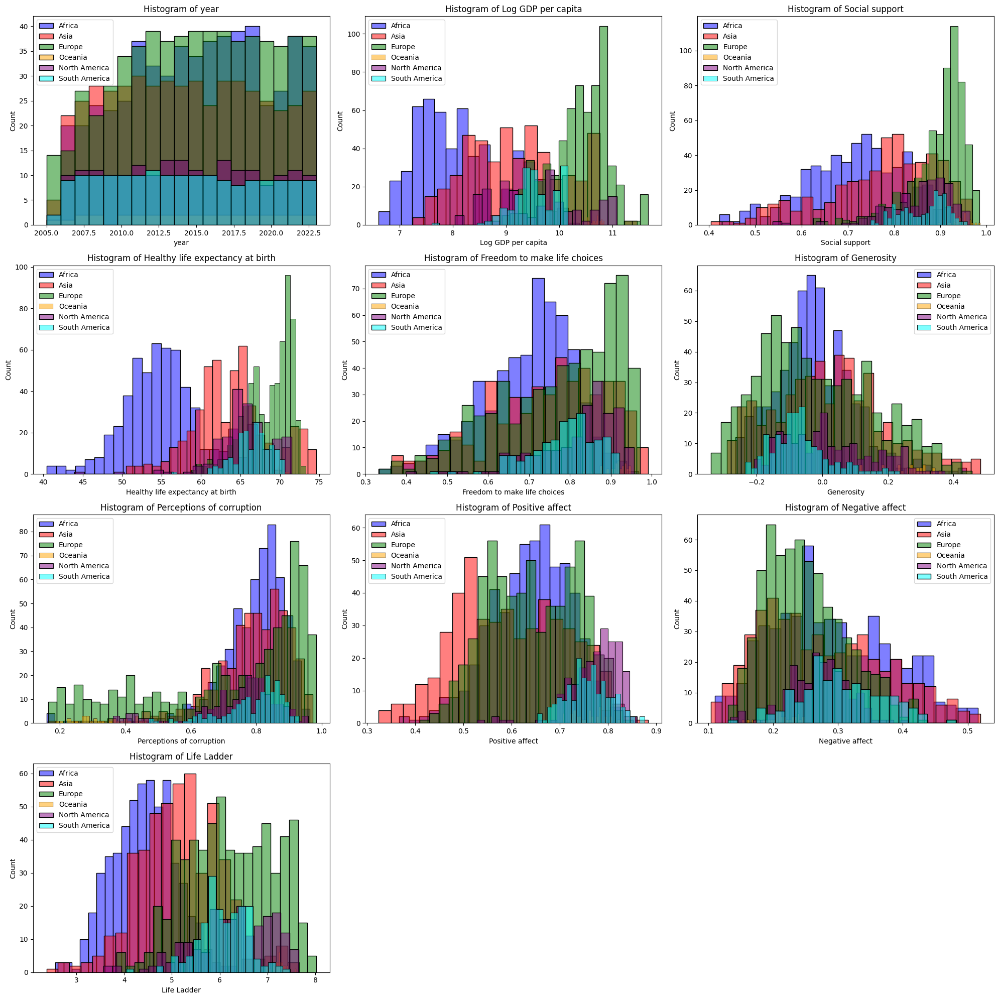

In [58]:
colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
continent_frames = [df_africa, df_asia, df_europe, df_oceania, df_north_america, df_south_america]
frame_names = ['Africa', 'Asia', 'Europe', 'Oceania', 'North America', 'South America']
plt.figure(figsize=(20, 20))
for i, column in enumerate(df_cleaned_cont.columns[2:]):
    plt.subplot(4, 3, i+1)
    bins = 30
    if column == 'year':
        bins = df_cleaned_cont['year'].max() - df_cleaned_cont['year'].min() + 1
    else:
        iqr = np.percentile(df_cleaned_cont[column], 75) - np.percentile(df_cleaned_cont[column], 25)
        bin_width = 2 * iqr / np.cbrt(len(df_cleaned_cont[column]))
        bins = int(np.ceil((df_cleaned_cont[column].max() - df_cleaned_cont[column].min()) / bin_width))
    plt.title(f'Histogram of {column}')
    for j, cont_frame in enumerate(continent_frames):
        sns.histplot(cont_frame[column], bins=bins, kde=False, color=colors[j], label=f'{frame_names[j]}', alpha=0.5)
    plt.legend()
plt.tight_layout()
plt.show()

### Observations from the Above Histograms:

* **Europe** and **Africa** display extreme ranges for **Log GDP per capita**.
* **Asia** tends to have middle-range values, while **South America** leans towards the upper-middle range but not the highest.
* **Social support** is generally high in **Europe** and both **Americas**, whereas **Asia** and **Africa** exhibit a wider range of values.
* Most continents show **high values of Healthy life expectancy at birth**, but Africa's histogram is shifted left. **Asia** has the highest values, while **Europe** dominates in terms of the number of high values.
* **Freedom to make life choices** histograms overlap significantly, with **both Americas** showing a smaller range of variability.
* **Generosity** follows a similar pattern, with overlapping distributions. **South America** mostly exhibits lower values, and both **Americas** have a relatively small range of variability.
* **Low values of Perceptions of corruption** are primarily observed in **Europe** and **Oceania**, whereas most continents have predominantly high values.
* **Citizens of both Americas** tend to experience **higher levels of positive emotions**, whereas **Asians** report the least.
* **Negative affect** histograms overlap, but **Africa** and **Asia** tend to have the lowest values. However, **Europe** contains the highest number of records with **low Negative affect**.
* **Life Ladder** shows a smooth transition across continents, with **Africa** holding the lowest values, **Asia** in the middle, and **Europe** at the highest. **Both Americas** mostly have mid-to-high values, with **North America** also reaching high values.
* Due to the **small sample size of Oceania**, its histograms are harder to distinguish.

To better visualize the range of variability, we will now display **box plots**.


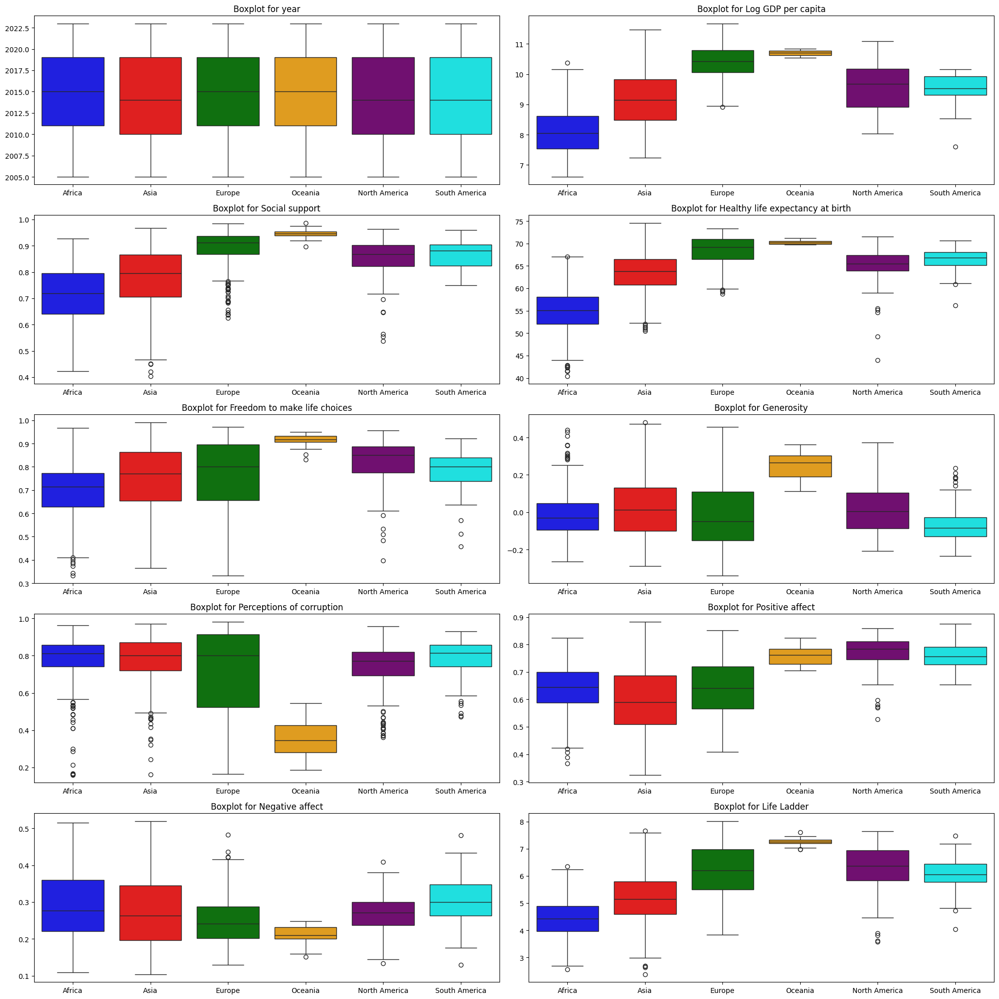

In [59]:
plt.figure(figsize=(20,20))
colors = ['blue', 'red', 'green', 'orange', 'purple', 'cyan']
continent_frames = [df_africa, df_asia, df_europe, df_oceania, df_north_america, df_south_america]
frame_names = ['Africa', 'Asia', 'Europe', 'Oceania', 'North America', 'South America']

for i, column in enumerate(df_cleaned_cont.columns[2:]):
    plt.subplot(5, 2, i+1)

    all_data = []

    for j, cont_frame in enumerate(continent_frames):
        cont_frame_copy = cont_frame[[column]].copy()
        cont_frame_copy.columns = [frame_names[j]]
        all_data.append(cont_frame_copy)
    
    combined_data = pd.concat(all_data, names=frame_names, axis=1)
    
    sns.boxplot(data=combined_data, palette=colors)
    plt.title(f'Boxplot for {column}')

plt.tight_layout()
plt.show()

* **Oceania** consistently exhibits the **lowest variability**, largely due to its **small sample size**.
* **Europe** and **Oceania** have the **highest ranges of Log GDP per capita**, while **Africa** and **Asia** have the lowest.
* **Social support** spans the **full spectrum in Asia and Africa**, whereas it remains relatively **high** on other continents. However, Europe has **many outliers** according to **Seaborn**.
* **Healthy life expectancy at birth** is **lowest in Africa**. Asia has a slightly **narrower range**, while **Europe and the Americas** generally maintain **high values**, except for some **outliers**. **Oceania** has the **smallest variability**, with consistently **very high values**.
* **Freedom to make life choices** shows the **highest variability in Asia, Africa, and Europe**. Oceania and the Americas typically have **high values** but also **some outliers**.
* **Generosity** is **generally low worldwide**, except for **Oceania**.
* **Perceptions of corruption** is **lowest in Oceania**. In **Europe**, it spans the **entire scale**, similar to **Asia and Africa**—but in these regions, **low-corruption observations are considered outliers by Seaborn**. The **Americas** tend to have **higher values**.
* **Oceania and the Americas** experience a **high prevalence of positive emotions**, while other continents display the **full range**.
* **Africa and Asia** have the **widest variability in Negative affect**, whereas **Oceania** has the **smallest** and experiences the **least negative emotions**.
* **Oceania** records the **highest Life Ladder values**, with **minimal variability**. **Europe has a broader range** than the Americas, though overall, **life satisfaction is similar** across both regions. **Africa and Asia** have **lower life satisfaction**.

To compare relationships between variables, we will now display **correlation heatmaps for each continent**.

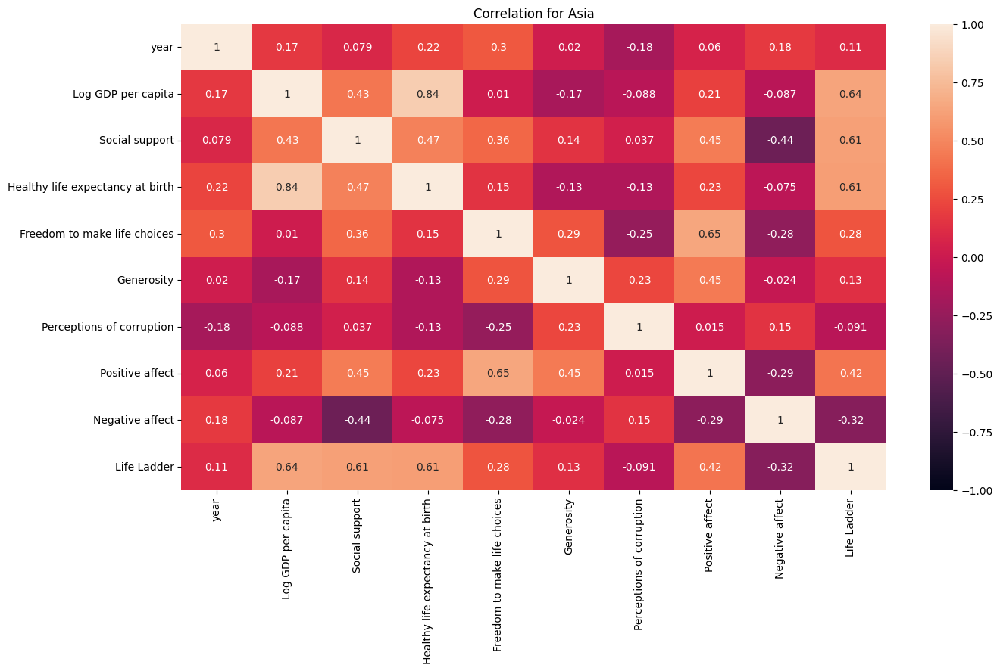

In [60]:
plt.figure(figsize=(15,8))
sns.heatmap(df_asia.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for Asia")
plt.show()

### Correlations in Asia
* The global trend between **Log GDP per capita** and **Healthy life expectancy at birth** has been maintained, with its correlation decreasing by only 0.02 (to 0.84).
* However, the relationship between **Log GDP per capita** and **Social support** dropped significantly (from 0.7 to 0.43).
* The dependencies between the target variable and **Log GDP per capita**, **Social support**, and **Healthy life expectancy at birth** have decreased.
* The correlation between **Freedom to make life choices** and **Positive affect** has increased. For Asians, the ability to make life choices may be an important factor influencing the level of experienced positive emotions.
* The negative correlation between the target variable and **Perceptions of corruption** has also decreased. Corruption does not significantly impact the life satisfaction of Asians. Moreover, corruption does not strongly affect any other variable in Asia.

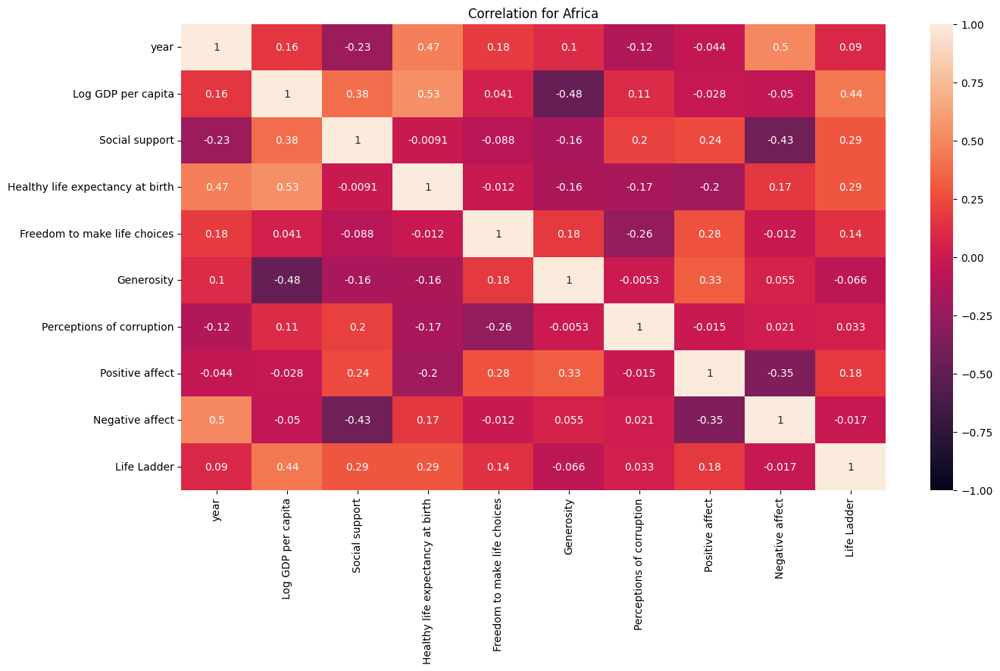

In [61]:
plt.figure(figsize=(15,8))
sns.heatmap(df_africa.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for Africa")
plt.show()

### Correlations in Africa
* In Africa, none of the variables are strongly correlated with the target variable. The highest correlation with the target is **Log GDP per capita**, but it is only at 0.44. Other factors beyond the economic and social variables collected here may influence happiness in Africa.
* The highest correlation (0.53) is between **Log GDP per capita** and **Healthy life expectancy at birth**. More developed African countries are sometimes able to provide longer healthy lives, but this is not a strong correlation. This may be due to social inequalities in this part of the world.
* However, we can see emerging correlations with the **year** variable. Over time, **Healthy life expectancy at birth** and **Negative affect** have increased. However, these two variables are not correlated with each other. While these are not strong correlations, they were quite unexpected compared to the original dataset.

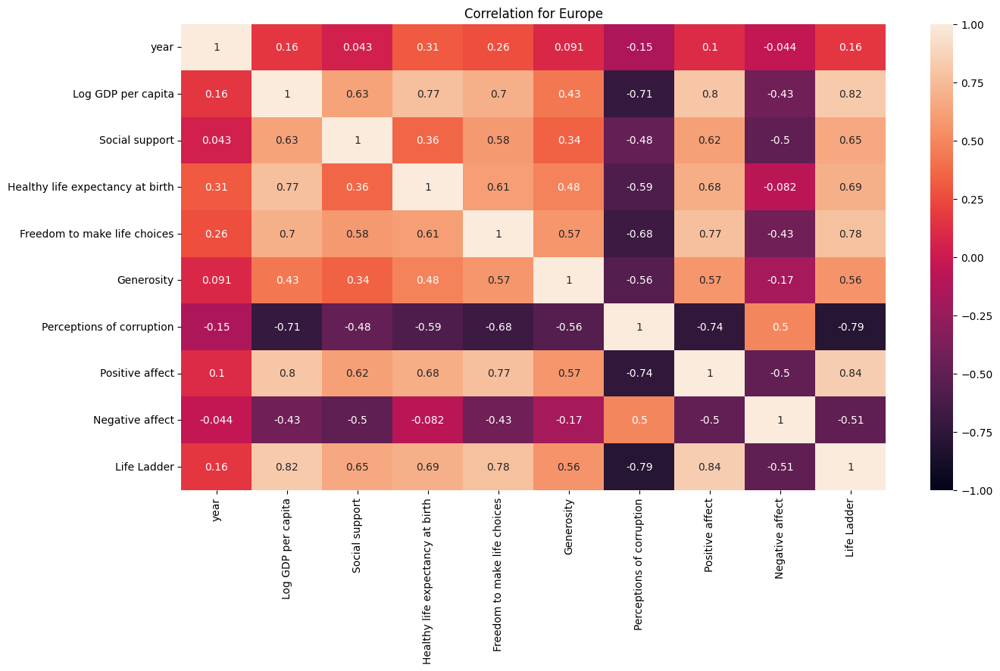

In [62]:
plt.figure(figsize=(15,8))
sns.heatmap(df_europe.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for Europe")
plt.show()

### Correlations in Europe
* Life satisfaction among Europeans seems to be well explained by the included variables. All variables, except **year**, have a higher correlation with the target variable than the highest-correlated variable in Africa.
* The most correlated with the target are **Positive affect** and **Log GDP per capita**.
* Europeans are satisfied with life when they experience a high level of positive emotions and live in prosperity (high GDP per capita). They also value low corruption and high freedom in decision-making.
* **Healthy life expectancy at birth** has a lower correlation with **Log GDP per capita** than in the overall trend.
* **Log GDP per capita** also positively influences the level of experienced positive emotions.
* In countries with higher **GDP per capita**, there is lower **Perceptions of corruption**.
* **Positive affect** is negatively correlated with **Perceptions of corruption**.
* A strong correlation is also observed between **Freedom to make life choices** and **Positive affect**.
* **Negative affect** and **Generosity** are less correlated with the rest of the variables compared to other factors.


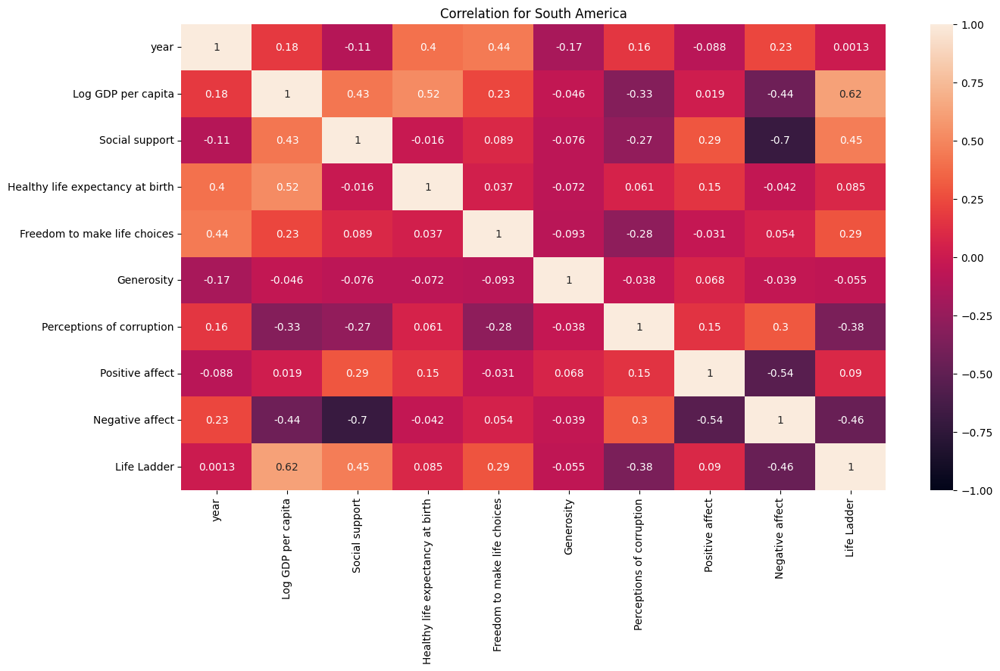

In [63]:
plt.figure(figsize=(15,8))
sns.heatmap(df_south_america.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for South America")
plt.show()

### Correlations in South America
* A small trend related to the **year** variable is observed: over time, **Healthy life expectancy at birth** and **Freedom to make life choices** improve.
* The most correlated variable with the target is **Log GDP per capita**.
* South American citizens derive more happiness from a low level of **Negative affect** than from a high level of **Positive affect**.
* The biggest influence on reducing **Negative affect** in South America comes from **Social support**.
* Few variables are strongly correlated here.
* Although in the overall trend, **Life Ladder** was correlated with **Healthy life expectancy at birth** and, to a lesser extent, with **Positive affect**, in South America, they are not correlated at all.

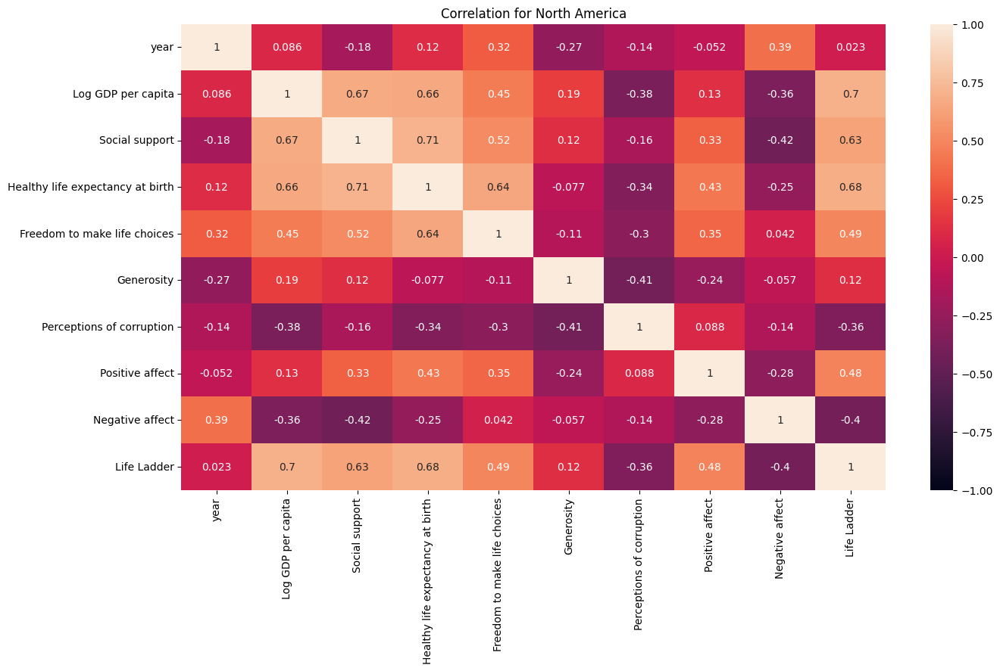

In [64]:
plt.figure(figsize=(15,8))
sns.heatmap(df_north_america.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for North America")
plt.show()

### Correlations in North America
* North American citizens reflect the overall trend – the greatest impact on **Life Ladder** comes from **Log GDP per capita**, **Social support**, and **Healthy life expectancy at birth**.
* A significant increase in the correlation between **Social support** and **Healthy life expectancy at birth** is observed.
* There is a noticeable increase in **Negative affect** over time.
* In North America, a relationship between **Freedom to make life choices** and **Healthy life expectancy at birth** is observed.


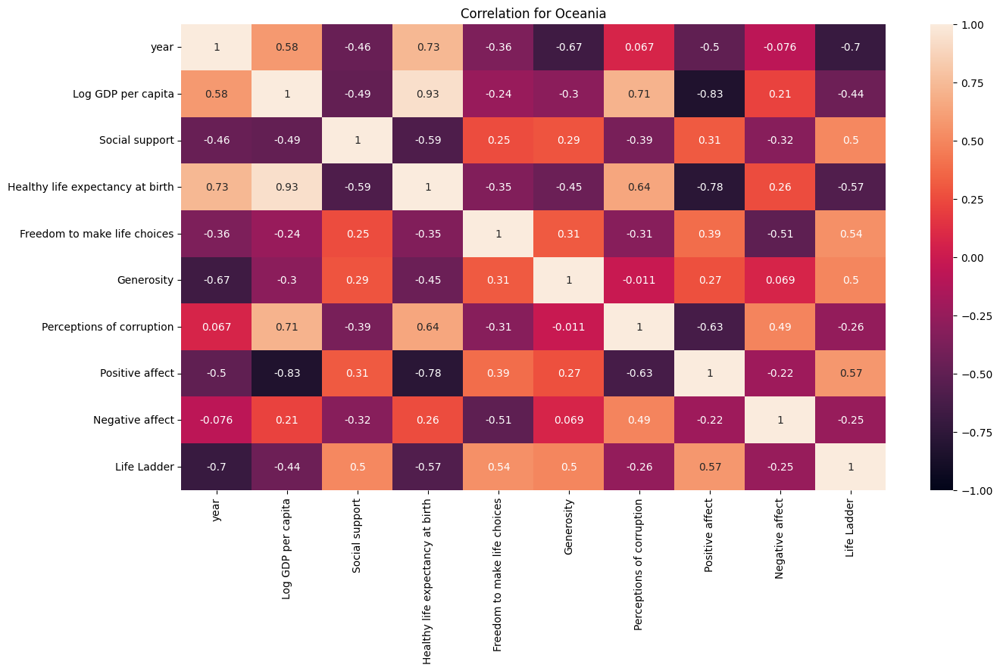

In [65]:
plt.figure(figsize=(15,8))
sns.heatmap(df_oceania.iloc[:, 2:].corr(), annot=True, vmin=-1, vmax=1)
plt.title("Correlation for Oceania")
plt.show()

### Correlations in Oceania
* Oceania contains only 34 records. This sample may not be fully representative.
* Strong negative correlations with **year** are observed. Over time in Oceania, **Life Ladder** and **Generosity** have significantly decreased, while **Healthy life expectancy at birth** has risen sharply, and **Log GDP per capita** has increased considerably.
* This leads to a very interesting observation. According to the heatmap, the longer **Healthy life expectancy at birth**, the lower **Life Ladder**. A similar trend is seen with **Positive affect**, which decreases even more strongly as **Healthy life expectancy at birth** increases. While these findings may seem discouraging, it is important to note that Oceania still maintains some of the highest **Life Ladder** and **Positive affect** values globally.
* A similar trend is observed with **Log GDP per capita**. There is a very high negative correlation (-0.83) between this variable and **Positive affect**, and a weaker but still noticeable negative correlation with **Life Ladder** (-0.44). Based on this small sample, one could argue that money does not bring happiness (at least in Oceania).
* At the same time, these two variables are correlated with **Perceptions of corruption**. Higher **Log GDP per capita** and **Healthy life expectancy at birth** are associated with higher corruption perception in Oceania.
* **Perceptions of corruption** negatively impacts the level of **Positive affect**.
* The strongest correlation (0.93) is between **Log GDP per capita** and **Healthy life expectancy at birth**.
* Interestingly, **Healthy life expectancy at birth** is negatively correlated with **Social support**.


## Research Hypothesis
In the next stage, we will examine the hypothesis that different factors influence the level of perceived life satisfaction depending on the region of the world.

## Milestone 3
First, we will attempt to create a regression model predicting the level of perceived life satisfaction based on data from around the world.

In [66]:
from sklearn.model_selection import train_test_split, GridSearchCV, cross_validate
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from itertools import combinations
from joblib import Parallel, delayed

First, we will evaluate how a model based on all numerical features from the original dataset performs. However, before doing so, we will apply Min-Max normalization to minimize the impact of differences in variability range. This will allow us to obtain more comparable coefficient values in the model and enable us to use L1 regularization in later tests.

In [67]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_all = df_cleaned_cont.loc[:, x_number_columns]
y_all = df_cleaned_cont.loc[:, y_column]
scaler = MinMaxScaler()
df_all = pd.DataFrame(scaler.fit_transform(df_all), columns=x_number_columns, index=df_cleaned_cont.index)

In [68]:
df_all

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect
0,0.166667,0.146628,0.080452,0.295322,0.584866,0.612810,0.876812,0.161202,0.371554
1,0.222222,0.177847,0.254612,0.304094,0.525393,0.641092,0.838433,0.281179,0.320869
2,0.277778,0.198614,0.231939,0.312865,0.405943,0.556598,0.664704,0.344605,0.412691
3,0.333333,0.192174,0.201146,0.321637,0.247889,0.607996,0.694222,0.278343,0.393119
4,0.388889,0.207810,0.200346,0.330409,0.301016,0.698114,0.748196,0.517276,0.394907
...,...,...,...,...,...,...,...,...,...
2358,0.777778,0.215159,0.609035,0.371345,0.454137,0.351273,0.814928,0.597567,0.316695
2359,0.833333,0.195093,0.537210,0.385234,0.471417,0.416645,0.763842,0.601543,0.581804
2360,0.888889,0.207094,0.482223,0.399123,0.508318,0.317039,0.725551,0.510850,0.331892
2361,0.944444,0.209698,0.449706,0.413012,0.484587,0.324428,0.720321,0.565708,0.211009


We will split our dataset into training and testing sets in an 80-20 ratio. To facilitate result visualization, we will create a function that displays the column name alongside its corresponding coefficient.

In [69]:
X_all_train, X_all_test, y_all_train, y_all_test = train_test_split(df_all, y_all, test_size=0.2, random_state=3)

In [70]:
def print_column_and_weight(weights, columns, round=True, sort=True):
    if sort:
        pairs = sorted(zip(weights, columns), key=lambda x: abs(x[0]), reverse=True)
    else:
        pairs = zip(weights, columns)
    for w, column in pairs:
        if round:
            print(f"Column '{column}': {np.round(float(w), 4)}")
        else:
            print(f"Column '{column}': {w}")

We will also train a multiple regression model based on all features from the dataset.

In [71]:
model = LinearRegression()
model.fit(X_all_train, y_all_train)
print_column_and_weight(model.coef_, x_number_columns)

Column 'Log GDP per capita': 1.8608
Column 'Healthy life expectancy at birth': 1.1685
Column 'Positive affect': 1.1648
Column 'Social support': 1.1383
Column 'Perceptions of corruption': -0.7424
Column 'Freedom to make life choices': 0.345
Column 'Generosity': 0.3325
Column 'year': -0.1365
Column 'Negative affect': 0.0384


Considering all features for the global dataset, we can observe the following conclusions:
* The feature **Log GDP per capita** has the greatest impact on the dependent variable **Life Ladder** worldwide.
* Features **Healthy life expectancy at birth**, **Positive affect**, and **Social support** have high and similar impacts.
* **Perceptions of corruption** and **year** have a negative impact on **Life Ladder**; as their values increase, life satisfaction decreases.
* Despite the high correlation between **Log GDP per capita** and **Healthy life expectancy at birth**, both variables have the highest impact on the dependent variable without suppressing each other.
* Even though **Positive affect** had a lower correlation with the dependent variable, its impact is comparable to **Healthy life expectancy at birth** and **Social support**, which had higher correlations with **Life Ladder**.
* An interesting observation is that **Negative affect** has an insignificant impact on life satisfaction—lower than even the **year** variable. There may be an underlying relationship between **Negative affect** and another variable that suppresses its effect, or it may simply have little influence on overall life satisfaction.
* Another intriguing finding is that **Negative affect** has received a positive weight, suggesting that higher levels of negative emotions are associated with greater life satisfaction. However, this might not be significant due to the low coefficient value.

To evaluate the model's performance, we will compare its results on the training and test sets using **MSE** and the $R^{2}$ metric. We will also define a function to facilitate model evaluation without repeating large amounts of code.

In [72]:
def calculate_metrics(y_gt, y_pred):
    mse = mean_squared_error(y_gt, y_pred)
    r2 = r2_score(y_gt, y_pred)
    print(f'MSE: {np.round(mse, 5)}')
    print(f"R2: {np.round(r2, 5)}")

In [73]:
def train_and_evaluate_model(model, X_train, y_train, X_test, y_test, additional_title=':', is_forest_reg=False, is_xgboost=False):
    model.fit(X_train, y_train)
    if is_forest_reg or is_xgboost:
        print("Feature importances:")
        print_column_and_weight(model.feature_importances_, X_train.columns)
        if is_forest_reg:
            depths = [tree.get_depth() for tree in model.estimators_]
            print(f"\nMean depth of trees: {np.mean(depths)}")
    else:
        print("Feature weights:")
        print_column_and_weight(model.coef_, X_train.columns)

    y_pred = model.predict(X_train)
    print(f'\n\nResults on train set{additional_title}')
    calculate_metrics(y_train, y_pred)
    y_pred = model.predict(X_test)
    print(f'\nResults on test set{additional_title}')
    calculate_metrics(y_test, y_pred)


In [74]:
y_pred = model.predict(X_all_train)
print('Results on train set:')
calculate_metrics(y_all_train, y_pred)
y_pred = model.predict(X_all_test)
print('\nResults on test set:')
calculate_metrics(y_all_test, y_pred)

Results on train set:
MSE: 0.2683
R2: 0.79006

Results on test set:
MSE: 0.26841
R2: 0.77216


The results on both datasets are similar: $R^{2}$ on the training set is 0.79, while on the test set, it is 0.77. These values indicate a reasonably good performance. Despite fitting well to the training data, the model retains its ability to generalize to unseen data. **MSE** is also similar for both datasets, being only slightly higher on the test set.

Although the model's coefficients are not particularly high, we will check whether applying regularization methods can improve performance. Below is a function that performs cross-validation for Ridge/Lasso regression models with different values of **alpha**. We use **GridSearchCV** with **cv=5** for this purpose.


In [75]:
def perform_cross_validation_regularization(X_train, y_train, alphas, is_ridge=True, additional_title='', display_plot=True):
    model = None
    title = None
    xlabel = "alpha"
    ylabel = "MSE"
    if is_ridge:
        model = Ridge()
        title = "Error plots for alpha parameters for the model with Ridge Regularization" + additional_title
    else:
        model = Lasso(max_iter=100000)
        title = "Error plots for alpha parameters for the model with Lasso Regularization" + additional_title

    params = {'alpha': alphas}
    model_cv = GridSearchCV(model, params, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=-1)
    model_cv.fit(X_train, y_train)

    cv_results = pd.DataFrame(model_cv.cv_results_)
    mse_results = cv_results[['param_alpha', 'mean_test_score', 'mean_train_score']].copy()
    mse_results.loc[:, 'mean_test_mse'] = -mse_results.loc[:, 'mean_test_score']
    mse_results.loc[:, 'mean_train_mse'] = -mse_results.loc[:, 'mean_train_score']
    
    best_alpha = model_cv.best_params_['alpha']
    print(f"Best value of alpha: {best_alpha}")
    
    if display_plot:
        plt.figure(figsize=(20,5))
        
        plt.plot(mse_results['param_alpha'], mse_results['mean_train_mse'], c='red', label="Train error")
        plt.plot(mse_results['param_alpha'], mse_results['mean_test_mse'], c='blue', label="Test error")

        
        min_mse_index = mse_results['mean_test_mse'].idxmin()
        plt.plot(mse_results.loc[min_mse_index, 'param_alpha'], mse_results.loc[min_mse_index, 'mean_test_mse'], c='blue', marker="o", label="best test alpha")
        plt.xscale("log")

        plt.xlabel(xlabel)
        plt.ylabel(ylabel)
        plt.title(title)

        plt.legend()
        plt.show()
    return best_alpha

First, we will examine the general trend of the **alpha** coefficients over a wide range of values.

Best value of alpha: 0.7847599703514591


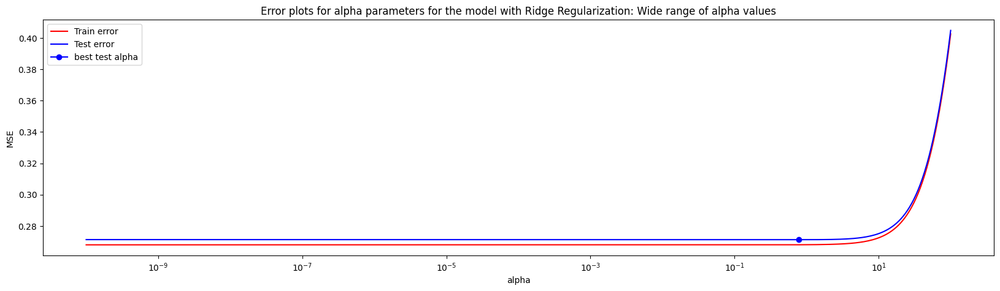

In [76]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values')

We can observe that for very small **alpha** values, the error values remain roughly constant across both datasets. However, for **alpha** values above $10^{1}$, we notice a sharp increase in **MSE**. The optimal **alpha** appears to be around **0.8**, though the reduction in test error is not significant. 

In the following plot, we will fine-tune the **alpha** range to demonstrate that there is indeed a small **valley** in the **Test error** function at the optimal **alpha** value.


Best value of alpha: 0.7494583019278748


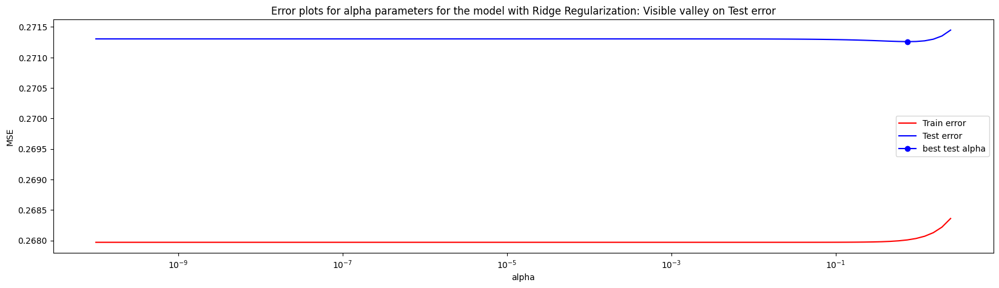

In [77]:
alpha_values = np.logspace(-10, 0.4, 100)
best_alpha_ridge = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=True, additional_title=': Visible valley on Test error')

Indeed, **MSE** values remain relatively stable or decrease slightly at very low **alpha** values. Around $10^{-1}$, we observe a steeper decline, which reaches its lowest point at the **"best test alpha"**, followed by the beginning of a sharp increase. 

The **Train error** remains relatively stable at first but continuously increases, and we do not observe a small valley after crossing $10^{-1}$, which aligns with theoretical expectations. 

Next, we will fine-tune the **alpha** selection by increasing the number of tested **alpha** values within the observed valley range.

In [78]:
alpha_values = np.logspace(-0.3, 0, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=True, display_plot=False)

Best value of alpha: 0.773728489954586


In [79]:
ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_all_train, y_all_train, X_all_test, y_all_test, additional_title=' with Ridge Regularization:')

Feature weights:
Column 'Log GDP per capita': 1.8342
Column 'Healthy life expectancy at birth': 1.1786
Column 'Positive affect': 1.1462
Column 'Social support': 1.1391
Column 'Perceptions of corruption': -0.7385
Column 'Freedom to make life choices': 0.3571
Column 'Generosity': 0.3295
Column 'year': -0.135
Column 'Negative affect': 0.0279


Results on train set with Ridge Regularization:
MSE: 0.26833
R2: 0.79004

Results on test set with Ridge Regularization:
MSE: 0.26814
R2: 0.77239


The results did not change significantly, as suggested by the plots. $R^{2}$ on the test set increased by **0.00023**, while on the training set, it decreased by **0.00002**. This aligns with theoretical expectations, where regularization improves generalization ability, reducing test error at the cost of a slight increase in training error.

Most absolute parameter values also decreased, with the largest reduction observed in the parameter with the highest absolute value—**Log GDP per capita**. 

We will now conduct a similar experiment using **L1 regularization**.


Best value of alpha: 0.001342207152716012


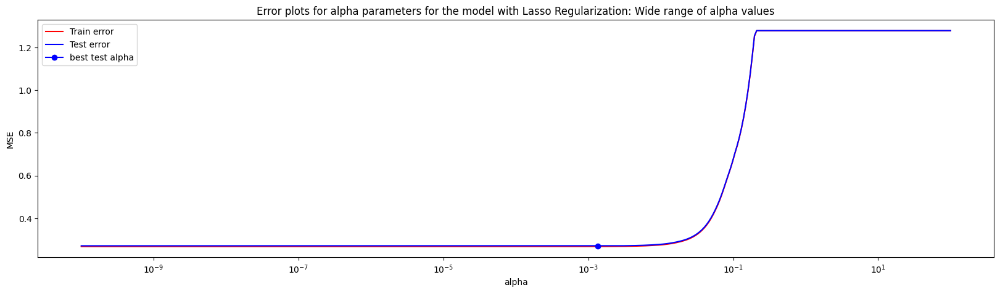

In [80]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values')

We can observe a similar trend for **Lasso regularization**: errors remain relatively stable for low alpha values and increase drastically after exceeding a certain threshold. However, in this case, we also see that the error curve smooths out at high alpha values. This is likely due to **L1 regularization setting most coefficients to zero**, effectively removing them from the model.

MSE values are **higher** than those obtained with Ridge regularization. This is likely because removing relevant parameters causes a significant increase in error. Looking at the plot, this suggests that **most features in this model are important**.

The optimal **alpha** value is lower here compared to **L2 regularization**. Below, we will refine our alpha values further to highlight the exact region where the best parameter value lies.


Best value of alpha: 0.0012915496650148853


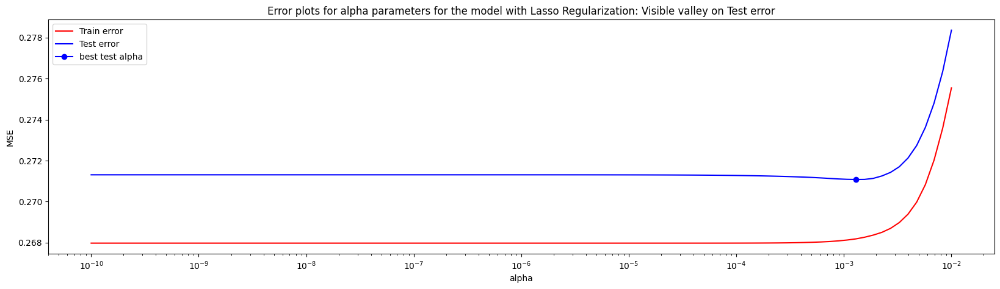

In [81]:
alpha_values = np.logspace(-10, -2, 100)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=False, additional_title=': Visible valley on Test error')

Similar to **Ridge regularization**, we will determine the optimal **alpha** by testing more values within the range where the error valley is located.

In [82]:
alpha_values = np.logspace(-3, -2.8, 1000)

best_alpha_lasso = perform_cross_validation_regularization(X_all_train, y_all_train, alpha_values, is_ridge=False, display_plot=False)

Best value of alpha: 0.001353728373245022


In [83]:
lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)

train_and_evaluate_model(lasso_best, X_all_train, y_all_train, X_all_test, y_all_test, additional_title=' with Lasso Regularization:')

Feature weights:
Column 'Log GDP per capita': 1.8677
Column 'Positive affect': 1.1477
Column 'Healthy life expectancy at birth': 1.1421
Column 'Social support': 1.1175
Column 'Perceptions of corruption': -0.7234
Column 'Freedom to make life choices': 0.3358
Column 'Generosity': 0.3095
Column 'year': -0.1074
Column 'Negative affect': 0.0


Results on train set with Lasso Regularization:
MSE: 0.26849
R2: 0.78991

Results on test set with Lasso Regularization:
MSE: 0.26816
R2: 0.77238


We can observe similar results here, aligning with theoretical expectations. $R^{2}$ for the test set increased by 0.00022, while for the training set, it decreased by 0.00015. This is a slightly smaller increase on the test set and a relatively larger decrease on the training set compared to **Ridge regularization**.

Most parameter values also decreased. **Lasso regularization** eliminated one parameter—**Negative affect**, deeming it insignificant for the model. This suggests that the level of experienced **negative emotions** does not significantly impact overall **life satisfaction**.

The influence of features changed slightly, making **Positive affect** now marginally more important than **Healthy life expectancy at birth**.

Neither **L2** nor **L1 regularization** significantly improved the results. The dataset contains a relatively large number of records compared to the number of features, which may be a contributing factor.

Next, we will use **feature selection methods**. Initially, we will attempt to find the **best subset** by testing all possible combinations. Given that the number of combinations is not excessively large, we can accomplish this. We will create models for each subset of features and perform **cross-validation** on the training set with **cv=5**. By averaging these results, we can identify the **optimal subset**.


In [84]:
def find_best_feature_subset(X_train, y_train):
    min_error_overall = np.inf
    best_model_overall = None
    for i in range(1, len(X_train.columns)+1):
        min_error_for_subset = np.inf
        best_model_for_subset = None
        for j, subset in enumerate(combinations(X_train.columns,i)):
            tmp_features = list(subset)
            model = LinearRegression()
            scores = cross_validate(model, X_train[tmp_features], y_train, cv=5, scoring="neg_mean_squared_error")
            error = np.mean(-scores['test_score'])
            if error < min_error_for_subset:
                min_error_for_subset = error
                best_model_for_subset = tmp_features
            if error < min_error_overall:
                min_error_overall = error
                best_model_overall = tmp_features
        print(f"Best model for {i} features with MSE: {np.round(min_error_for_subset, 4)} is: {best_model_for_subset}.")
    print(f"Best model has been achieved for {len(best_model_overall)} features with MSE: {np.round(min_error_overall, 4)}. Its features are: {best_model_overall}.")
    return best_model_overall

In [85]:
best_feature_subset = find_best_feature_subset(X_all_train, y_all_train)

Best model for 1 features with MSE: 0.4814 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.3446 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE: 0.3192 is: ['Log GDP per capita', 'Perceptions of corruption', 'Positive affect'].
Best model for 4 features with MSE: 0.2929 is: ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect'].
Best model for 5 features with MSE: 0.2778 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect'].
Best model for 6 features with MSE: 0.2735 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 7 features with MSE: 0.2718 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best

According to **cross-validation results**, the **best subset** consists of **8 features**, with **Negative affect** being eliminated. This aligns with the findings from **Lasso regularization**.

Next, we will verify whether we obtain the **same results** using a **greedy Forward Stepwise algorithm**. This algorithm constructs the optimal subset by making the **best possible choice** at each step. We will also perform **cross-validation with cv=5** to validate the selection.

In [86]:
def find_best_subset_forward_stepwise(X_train, y_train, is_forest_reg=False):
    features_to_choose_from = list(X_train.columns)
    selected_features = []
    min_error_overall = np.inf
    best_model_overall = None
    errors = []
    for i in range(1, len(X_train.columns)+1):
        min_error_for_subset = np.inf
        best_model_for_subset = None
        best_new_feature = None
        for feature in features_to_choose_from:
            model = None
            if is_forest_reg:
                model = RandomForestRegressor(n_estimators=50, random_state=3)
            else:
                model = LinearRegression()
            tmp_features = selected_features.copy()
            tmp_features.append(feature)

            scores = cross_validate(model, X_train[tmp_features], y_train, cv=5, scoring="neg_mean_squared_error")
            error = np.mean(-scores['test_score'])
            if error < min_error_for_subset:
                min_error_for_subset = error
                best_model_for_subset = tmp_features
                best_new_feature = feature
        errors.append(min_error_for_subset)
        selected_features.append(best_new_feature)
        features_to_choose_from.remove(best_new_feature)
        if min_error_for_subset < min_error_overall:
            min_error_overall = min_error_for_subset
            best_model_overall = best_model_for_subset
        print(f"Best model for {i} features with MSE:  {np.round(min_error_for_subset, 4)} is: {best_model_for_subset}.")
    print(f"Best model has been achieved for {len(best_model_overall)} features with MSE: {np.round(min_error_overall, 4)}. Its features are: {best_model_overall}.")
    return best_model_overall, errors

In [87]:
best_feature_subset_f_stepwise, errors_fs = find_best_subset_forward_stepwise(X_all_train, y_all_train)

Best model for 1 features with MSE:  0.4814 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3446 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.3192 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption'].
Best model for 4 features with MSE:  0.2929 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support'].
Best model for 5 features with MSE:  0.2778 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Healthy life expectancy at birth'].
Best model for 6 features with MSE:  0.2735 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Healthy life expectancy at birth', 'Generosity'].
Best model for 7 features with MSE:  0.2718 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Freedom to make life choices'

We obtained the **same result** in a **significantly shorter time**. Again, the **best subset** consists of **8 features**, with **Negative affect** being excluded. 

The difference in **execution speed** would be **even more pronounced** if the dataset contained **more features**, as **exhaustive search** would become **prohibitively slow**. 

Next, we will attempt to use **Lasso regularization** as a **feature selection method**. The function below **gradually increases** the **alpha parameter**, setting more coefficients to **zero**. 

The displayed messages will appear in **reverse order of feature importance** (the **least important** feature will be **printed first**).


In [88]:
def lasso_feature_selection(X_train, y_train, alphas=None):
    if alphas is None:
        alphas = np.logspace(-4, 0, 200)

    feature_names = X_train.columns
    selected_features = set(range(X_train.shape[1]))
    
    for alpha in alphas:
        lasso = Lasso(alpha=alpha, max_iter=10000)
        lasso.fit(X_train, y_train)

        coefs = lasso.coef_

        zeroed_features = {i for i, coef in enumerate(coefs) if coef == 0}

        newly_zeroed = selected_features & zeroed_features
        selected_features -= newly_zeroed

        for feature_idx in newly_zeroed:
            print(f"Alpha: {alpha:.4f} - Excluded: {feature_names[feature_idx]}")
        
        if len(selected_features) == 0:
            print("\nAll features have been excluded.")
            break

In [89]:
lasso_feature_selection(X_all_train, y_all_train)

Alpha: 0.0006 - Excluded: Negative affect
Alpha: 0.0078 - Excluded: year
Alpha: 0.0178 - Excluded: Generosity
Alpha: 0.0567 - Excluded: Healthy life expectancy at birth
Alpha: 0.0652 - Excluded: Perceptions of corruption
Alpha: 0.0749 - Excluded: Positive affect
Alpha: 0.0860 - Excluded: Freedom to make life choices
Alpha: 0.1084 - Excluded: Social support
Alpha: 0.2073 - Excluded: Log GDP per capita

All features have been excluded.


As the **alpha** value increases, we are able to eliminate subsequent features. The last feature was set to zero at **alpha = 0.2223**. This confirms the interpretation of the **MSE vs. alpha** plot for **Lasso regularization**, where after all features are removed, **MSE** reaches a stable maximum shortly after exceeding **alpha = $10^{-1}$**.  

* Similar to previous algorithms, this algorithm identified **Negative affect** as the least important feature, followed by **year**.  
* The order of feature elimination is similar but with some exceptions. Other algorithms eliminated **Freedom to make life choices** as the third feature. Here, **Freedom to make life choices** was eliminated even later than **Perceptions of corruption**, which was the third most important feature according to **forward stepwise**.  
* Likewise, this algorithm considered **Social support** as the second most important feature, whereas **forward stepwise** selected **Positive affect** as the second most important.  

To compare the results of the above algorithms with the **best subset**, a **parallelized version** of the algorithm searching through all possible combinations is presented below. We were able to implement this approach because calculating **MSE** for individual subsets is an **independent task**.


In [90]:
def evaluate_subset(X_train, y_train, subset, is_forest_reg=False, is_xgboost=False):
    tmp_features = list(subset)
    model = None
    if is_forest_reg:
        model = RandomForestRegressor(n_estimators=50, random_state=3)
    elif is_xgboost:
        model = XGBRegressor(max_depth=7, learning_rate=0.1, n_estimators=50, random_state=3)
    else:
        model = LinearRegression()
    scores = cross_validate(model, X_train[tmp_features], y_train, cv=5, scoring="neg_mean_squared_error")
    error = np.mean(-scores['test_score'])
    return error, tmp_features

def find_best_feature_subset_parallel(X_train, y_train, n_jobs=-1, is_forest_reg=False, is_xgboost=False):
    min_error_overall = np.inf
    best_model_overall = None
    errors = []
    for i in range(1, len(X_train.columns) + 1):
        subsets = list(combinations(X_train.columns, i))
        
        results = Parallel(n_jobs=n_jobs)(
            delayed(evaluate_subset)(X_train, y_train, subset, is_forest_reg, is_xgboost) for subset in subsets
        )

        min_error_for_subset = np.inf
        best_model_for_subset = None
        for error, tmp_features in results:
            if error < min_error_for_subset:
                min_error_for_subset = error
                best_model_for_subset = tmp_features
            if error < min_error_overall:
                min_error_overall = error
                best_model_overall = tmp_features
        errors.append(min_error_for_subset)
        print(f"Best model for {i} features with MSE:  {np.round(min_error_for_subset, 4)} is: {best_model_for_subset}.")
    
    print(f"Best model has been achieved for {len(best_model_overall)} features with MSE: {np.round(min_error_overall, 4)}. Its features are: {best_model_overall}.")
    return best_model_overall, errors

In [91]:
best_feature_subset_par, errors_par = find_best_feature_subset_parallel(X_all_train, y_all_train)

Best model for 1 features with MSE:  0.4814 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3446 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.3192 is: ['Log GDP per capita', 'Perceptions of corruption', 'Positive affect'].
Best model for 4 features with MSE:  0.2929 is: ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect'].
Best model for 5 features with MSE:  0.2778 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect'].
Best model for 6 features with MSE:  0.2735 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 7 features with MSE:  0.2718 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect'

The results returned by the algorithm are also the same as those obtained using **forward stepwise** and the **sequential search algorithm**—the feature **Negative affect** was eliminated.  

We can observe that after exceeding a certain number of variables, the **mean squared error (MSE)** starts to decrease slightly. Let’s visualize this trend in a plot.

In [92]:
def elbow_plot(errors):
    plt.figure(figsize=(10,5))
    plt.plot(range(1, len(errors)+1), errors, marker="o")
    plt.xlabel("Number of features")
    plt.ylabel('MSE')
    plt.title("MSE vs Number of features in a model")
    plt.grid()
    plt.show()

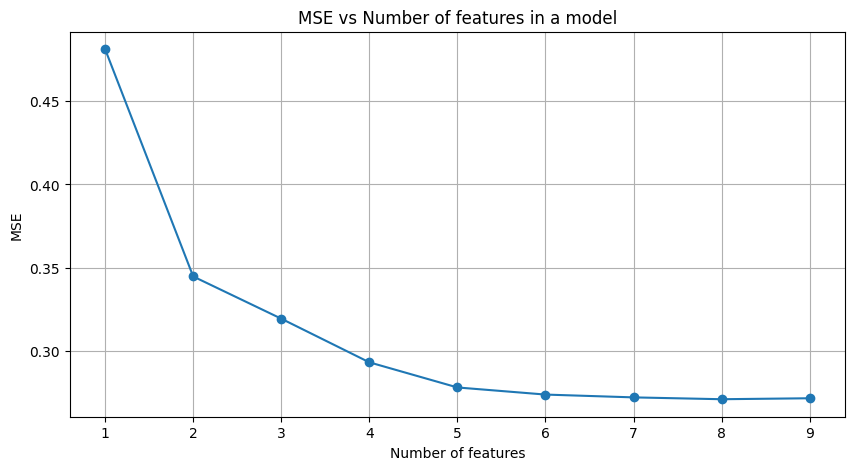

In [93]:
elbow_plot(errors_par)

The plot confirms the numerical data—**mean squared error (MSE)** remains almost unchanged for feature counts between 6 and 9, and there is also little difference between models containing 5 and 6 features.  

This may indicate that, despite the slight reduction in MSE, adding more features unnecessarily complicates the model.  

Below, we will evaluate how the model performs with a smaller number of features than suggested by the feature selection algorithms.  

However, before that, let's test how the model performs on the **test set**, which it has not seen during feature selection, after removing only **Negative affect**.

In [94]:
model = LinearRegression()
train_and_evaluate_model(model, X_all_train.loc[:, best_feature_subset], y_all_train, X_all_test.loc[:, best_feature_subset], y_all_test, additional_title=' bez Negative affect:')

Feature weights:
Column 'Log GDP per capita': 1.8591
Column 'Healthy life expectancy at birth': 1.1782
Column 'Positive affect': 1.1628
Column 'Social support': 1.1203
Column 'Perceptions of corruption': -0.7348
Column 'Freedom to make life choices': 0.3436
Column 'Generosity': 0.3347
Column 'year': -0.1312


Results on train set bez Negative affect:
MSE: 0.26834
R2: 0.79003

Results on test set bez Negative affect:
MSE: 0.26863
R2: 0.77198


Although cross-validation indicated that the given subset should be the best, in this specific **train-test split**, we observe that this selection performs slightly worse than the model using all features.  

However, these differences are minimal, so the specific **train-test split** might have influenced the results.  

Let's check if we can improve these results using **regularization**.

Best value of alpha: 0.7322538337604526


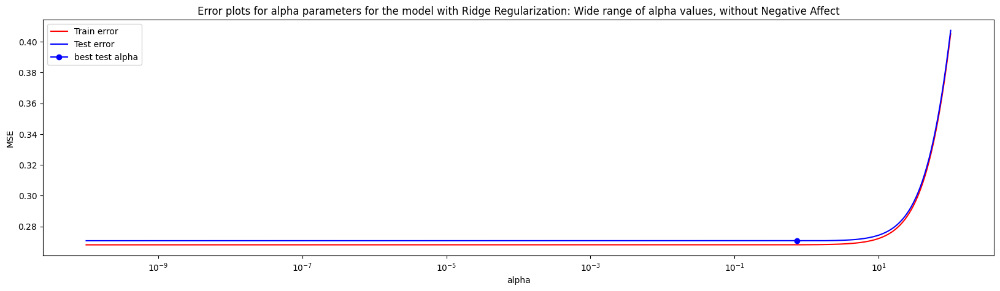

In [95]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge= perform_cross_validation_regularization(X_all_train.loc[:, best_feature_subset], y_all_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, without Negative Affect')

After removing **Negative Affect**, we observe that the optimal **alpha** value might be lower.

In [96]:
alpha_values = np.logspace(-0.3, 0, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_all_train.loc[:, best_feature_subset], y_all_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_all_train.loc[:, best_feature_subset], y_all_train, X_all_test.loc[:, best_feature_subset], y_all_test, additional_title=' without Negative Affect with Ridge Regularization:')

Best value of alpha: 0.7111348330984477
Feature weights:
Column 'Log GDP per capita': 1.835
Column 'Healthy life expectancy at birth': 1.1848
Column 'Positive affect': 1.1461
Column 'Social support': 1.1259
Column 'Perceptions of corruption': -0.7333
Column 'Freedom to make life choices': 0.3551
Column 'Generosity': 0.3313
Column 'year': -0.1311


Results on train set without Negative Affect with Ridge Regularization:
MSE: 0.26836
R2: 0.79002

Results on test set without Negative Affect with Ridge Regularization:
MSE: 0.26834
R2: 0.77223


The results on the test set have improved and are higher than when considering the full set of features without regularization. However, they are still slightly lower than when using the full set of features with **Ridge** regularization. We can also compare the results after applying **Lasso** regularization.

Best value of alpha: 1e-10


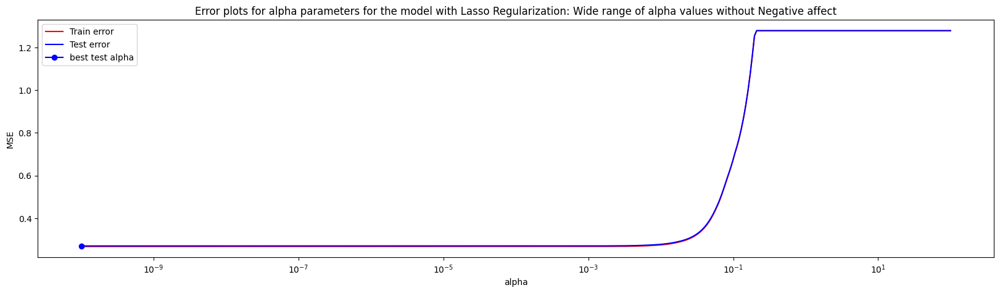

In [97]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train.loc[:, best_feature_subset], y_all_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values without Negative affect')

The selected alpha value is the lowest tested, which may suggest that **Lasso** regularization is not applicable in this case. When testing on the full set of features, we observed that **Lasso** regularization removed the **Negative affect** feature. Since we removed it before applying regularization this time, no significant changes were introduced. 

Additionally, this is supported by the low coefficient values, whereas the main purpose of regularization is to penalize high coefficients. However, the most likely reason for the low effectiveness of regularization is the small number of features relative to observations. 

Just to be thorough, we will also test a wider range of alpha values below.


In [98]:
alpha_values = np.logspace(-10, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train.loc[:, best_feature_subset], y_all_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)

train_and_evaluate_model(lasso_best, X_all_train.loc[:, best_feature_subset], y_all_train, X_all_test.loc[:, best_feature_subset], y_all_test, additional_title=' without Negative Affect with Lasso Regularization:')

Best value of alpha: 1e-10
Feature weights:
Column 'Log GDP per capita': 1.8591
Column 'Healthy life expectancy at birth': 1.1782
Column 'Positive affect': 1.1628
Column 'Social support': 1.1203
Column 'Perceptions of corruption': -0.7348
Column 'Freedom to make life choices': 0.3436
Column 'Generosity': 0.3347
Column 'year': -0.1312


Results on train set without Negative Affect with Lasso Regularization:
MSE: 0.26834
R2: 0.79003

Results on test set without Negative Affect with Lasso Regularization:
MSE: 0.26863
R2: 0.77198


The best alpha value did not change, nor did the coefficient values or metrics. 

Removing **Negative affect** slightly worsened the model’s accuracy, but this difference is minimal, and simplifying the model might be more advantageous than the slight decline in metrics. Below, we will test the behavior of the model with the best subset of 5 features. The number of features was chosen based on the elbow plot, and the best subset was copied from the result of the function searching all combinations.

In [99]:
best_5_features = ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect']
model = LinearRegression()

train_and_evaluate_model(lasso_best, X_all_train.loc[:, best_5_features], y_all_train, X_all_test.loc[:, best_5_features], y_all_test, additional_title=' for 5 best features:')

Feature weights:
Column 'Log GDP per capita': 1.7561
Column 'Positive affect': 1.3918
Column 'Healthy life expectancy at birth': 1.2348
Column 'Social support': 1.2115
Column 'Perceptions of corruption': -0.9101


Results on train set for 5 best features:
MSE: 0.27555
R2: 0.78439

Results on test set for 5 best features:
MSE: 0.28003
R2: 0.7623


The model performs slightly worse, but it is still a good result. Removing 4 features caused a drop in the $R^{2}$ metric by only 0.01. This drop is acceptable considering the significant simplification of the model. We will also check if regularization can improve the results here.

Best value of alpha: 0.8410310505352605


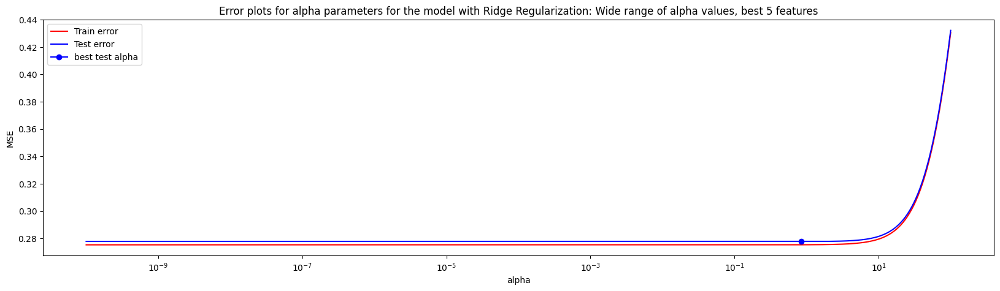

In [100]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge= perform_cross_validation_regularization(X_all_train.loc[:, best_5_features], y_all_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, best 5 features')

In [101]:
alpha_values = np.logspace(-0.3, 0, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_all_train.loc[:, best_5_features], y_all_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_all_train.loc[:, best_5_features], y_all_train, X_all_test.loc[:, best_5_features], y_all_test, additional_title=' 5 best features with Ridge Regularization:')

Best value of alpha: 0.8576958985908941
Feature weights:
Column 'Log GDP per capita': 1.7354
Column 'Positive affect': 1.3746
Column 'Healthy life expectancy at birth': 1.239
Column 'Social support': 1.2164
Column 'Perceptions of corruption': -0.9095


Results on train set 5 best features with Ridge Regularization:
MSE: 0.27557
R2: 0.78437

Results on test set 5 best features with Ridge Regularization:
MSE: 0.27978
R2: 0.76252


L2 regularization slightly improved the $R^{2}$ metric. Let's check how L1 regularization performs.

Best value of alpha: 9.01337038951742e-05


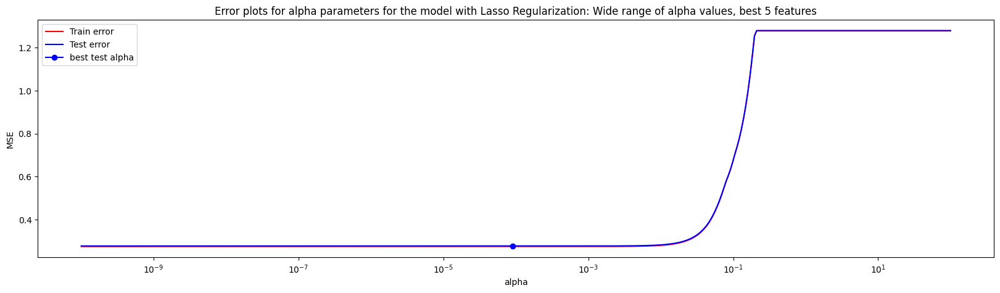

In [102]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train.loc[:, best_5_features], y_all_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, best 5 features')

In [103]:
alpha_values = np.logspace(-5, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_all_train.loc[:, best_5_features], y_all_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_all_train.loc[:, best_5_features], y_all_train, X_all_test.loc[:, best_5_features], y_all_test, additional_title=' 5 best features with Lasso Regularization:')

Best value of alpha: 9.224970052592174e-05
Feature weights:
Column 'Log GDP per capita': 1.7573
Column 'Positive affect': 1.3902
Column 'Healthy life expectancy at birth': 1.2324
Column 'Social support': 1.2107
Column 'Perceptions of corruption': -0.9089


Results on train set 5 best features with Lasso Regularization:
MSE: 0.27555
R2: 0.78439

Results on test set 5 best features with Lasso Regularization:
MSE: 0.27997
R2: 0.76235


The results were also minimally improved, but even less so than with L2 regularization. The model coefficients are not large, and the number of features is small, which may affect the limited effectiveness of regularization. Below, we will test the Bagging method to create a model with higher accuracy. The chosen method is RandomForestRegressor. To improve generalization, we will use 100 estimators. By selecting a random forest-based regressor, we can clearly display the relative importance of individual features in the model. Additionally, through cross-validation, we will determine the best maximum tree depth to achieve the best predictions on the test set.

In [104]:
def perform_cross_validation_forest(X_train, y_train, depths, min_samples_leaf):
    rf_model = RandomForestRegressor(n_estimators=100, random_state=3)
    params = {'max_depth': depths, 'min_samples_leaf': min_samples_leaf}
    model_cv = GridSearchCV(rf_model, params, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=-1)
    model_cv.fit(X_train, y_train)
    best_depth = model_cv.best_params_['max_depth']
    best_min_samples_leaf = model_cv.best_params_['min_samples_leaf']
    print(f"Best value of max_depth: {best_depth}")
    print(f"Best value of min_samples_leaf: {best_min_samples_leaf}")
    return best_depth, best_min_samples_leaf

In [105]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_train, y_all_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_train, y_all_train, X_all_test, y_all_test, additional_title=' Random Forest', is_forest_reg=True)

Best value of max_depth: 24
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.6631
Column 'Positive affect': 0.0949
Column 'Healthy life expectancy at birth': 0.0865
Column 'Social support': 0.0442
Column 'Freedom to make life choices': 0.037
Column 'Perceptions of corruption': 0.0209
Column 'Negative affect': 0.0205
Column 'Generosity': 0.0192
Column 'year': 0.0138

Mean depth of trees: 21.86


Results on train set Random Forest
MSE: 0.02279
R2: 0.98217

Results on test set Random Forest
MSE: 0.15742
R2: 0.86637


Thanks to the application of Random Forest Regressor, the results on the test set improved by nearly 0.1 in terms of the $R^{2}$ metric. Despite a very strong fit to the training data, the model has greater generalization ability compared to models that do not use Bagging.

We can see that the order of feature importance has not changed significantly compared to the multiple regression models. However, it is noticeable that the most important feature is **Log GDP per capita**, a dominance that was not observed before. Interestingly, after applying bagging, we can see that the influence of **Negative affect** is greater than that of **Generosity** and **year**, though all of them have a similar, small impact.

We can also observe how the model performs without **Negative affect**, and with the use of 5 features.

In [106]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_train.loc[:, best_feature_subset], y_all_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_train.loc[:, best_feature_subset], y_all_train, X_all_test.loc[:, best_feature_subset], y_all_test, additional_title=' Random Forest without Negative affect', is_forest_reg=True)

Best value of max_depth: 18
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.666
Column 'Positive affect': 0.0979
Column 'Healthy life expectancy at birth': 0.0891
Column 'Social support': 0.0469
Column 'Freedom to make life choices': 0.0406
Column 'Perceptions of corruption': 0.023
Column 'Generosity': 0.0213
Column 'year': 0.0151

Mean depth of trees: 18.0


Results on train set Random Forest without Negative affect
MSE: 0.02386
R2: 0.98133

Results on test set Random Forest without Negative affect
MSE: 0.15901
R2: 0.86503


As before, the $R^{2}$ metric did not decrease significantly after removing this feature. Let's check how the model performs after removing four of the features.

In [107]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_train.loc[:, best_5_features], y_all_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_train.loc[:, best_5_features], y_all_train, X_all_test.loc[:, best_5_features], y_all_test, additional_title=' Random Forest, best 5 features', is_forest_reg=True)

Best value of max_depth: None
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.6807
Column 'Positive affect': 0.1192
Column 'Healthy life expectancy at birth': 0.1024
Column 'Social support': 0.0604
Column 'Perceptions of corruption': 0.0372

Mean depth of trees: 22.87


Results on train set Random Forest, best 5 features
MSE: 0.02612
R2: 0.97956

Results on test set Random Forest, best 5 features
MSE: 0.18231
R2: 0.84525


The model's performance after removing 4 features decreased slightly more than with the usual multiple regression models, by almost 0.02 in terms of $R^{2}$. This suggests that these features had a somewhat greater impact when using bagging. However, the results are still good, and the decision to exclude these features would need to be based on the final purpose and requirements of the model.

The most significant feature remains **Log GDP per capita** with 68% importance. **Positive affect** and **Healthy life expectancy at birth** both have importance scores above 10% in this model.

The tests above used features selected based on the multiple regression model. For comparison, we can perform feature selection based on the random forest model.

Best model for 1 features with MSE:  0.5629 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3008 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.2158 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 4 features with MSE:  0.1973 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect'].
Best model for 5 features with MSE:  0.189 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.1841 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.179 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best m

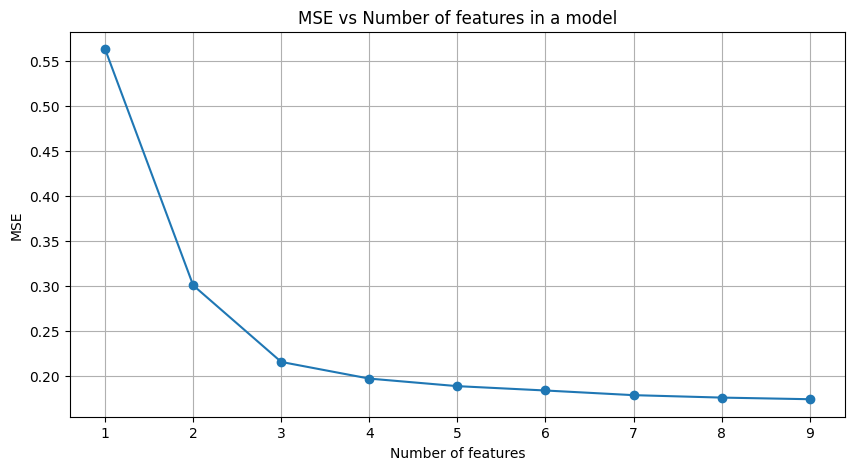

In [108]:
best_feature_subset_forest, errors_forest = find_best_feature_subset_parallel(X_all_train, y_all_train, is_forest_reg=True)
elbow_plot(errors_forest)

Using Bagging, we can see that the model's error on the validation set decreases with the addition of features, so the best subset according to this model is the full model. However, looking at the elbow plot, we notice that the difference when adding additional features is not huge, and most of the problem can be described with 4-5 variables. We observe that feature selection for this model prefers **Healthy life expectancy at birth** over **Perceptions of corruption**. Interestingly, Random Forest also prefers **Negative affect**, adding it as the fourth feature, whereas the multiple regression models excluded it first. It seems that considering bootstrap samples has made the **Negative affect** feature statistically more influential on the target variable than other less significant features. Below, we will check how the model performs with only the 4 features selected by the algorithm. Additionally, we will test this on a 5-feature subset for comparison with the other models.

In [109]:
best_4_features_forest = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect']
best_5_features_forest = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
print('\n 4 FEATURES')
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_train.loc[:, best_4_features_forest], y_all_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_train.loc[:, best_4_features_forest], y_all_train, X_all_test.loc[:, best_4_features_forest], y_all_test, additional_title=' Random Forest, best 4 features selected for RF', is_forest_reg=True)

print('\n\n 5 FEATURES')
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_train.loc[:, best_5_features_forest], y_all_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_train.loc[:, best_5_features_forest], y_all_train, X_all_test.loc[:, best_5_features_forest], y_all_test, additional_title=' Random Forest, best 4 features selected for RF', is_forest_reg=True)


 4 FEATURES
Best value of max_depth: 19
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.6958
Column 'Positive affect': 0.1423
Column 'Healthy life expectancy at birth': 0.1139
Column 'Negative affect': 0.048

Mean depth of trees: 19.0


Results on train set Random Forest, best 4 features selected for RF
MSE: 0.02705
R2: 0.97884

Results on test set Random Forest, best 4 features selected for RF
MSE: 0.18559
R2: 0.84246


 5 FEATURES


d:\1. Studia\5. Semestr\Metody Eksploracji Danych\lab\mexLab\Lib\site-packages\numpy\ma\core.py:2881: RuntimeWarning:

invalid value encountered in cast



Best value of max_depth: 23
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.6862
Column 'Positive affect': 0.1328
Column 'Healthy life expectancy at birth': 0.1045
Column 'Negative affect': 0.0395
Column 'Perceptions of corruption': 0.037

Mean depth of trees: 22.31


Results on train set Random Forest, best 4 features selected for RF
MSE: 0.02527
R2: 0.98023

Results on test set Random Forest, best 4 features selected for RF
MSE: 0.17982
R2: 0.84736


The model with four features may have a slightly lower average depth of trees compared to the previous one. Despite the significant reduction in the number of features, the model still has good generalization ability. The most important feature of the model is **Log GDP per capita**, with nearly 70% influence. Following that, **Positive affect** and **Healthy life expectancy at birth** have over 10% importance. **Negative affect** has a relatively small impact on the model.

Adding the feature **Perceptions of corruption** positively affected the model, increasing its $R^{2}$ by about 0.005. However, this feature has the smallest impact on the model.

Since we used Bagging, let's also test how Boosting performs. For boosting, we have chosen the XGBoost algorithm.


In [110]:
def perform_cross_validation_xgboost(X_train, y_train, depths, learning_rates):

    xgb_model = XGBRegressor(random_state=3, eval_metric='rmse', n_estimators=100)
    params = {
        'max_depth': depths,
        'learning_rate': learning_rates
    }
    model_cv = GridSearchCV(xgb_model, params, cv=5, scoring='neg_mean_squared_error', return_train_score=True, n_jobs=-1)
    model_cv.fit(X_train, y_train)
    
    best_depth = model_cv.best_params_['max_depth']
    best_learning_rate = model_cv.best_params_['learning_rate']
    
    print(f"Best value of max_depth: {best_depth}")
    print(f"Best value of learning_rate: {best_learning_rate}")
    
    return best_depth, best_learning_rate

In [111]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_all_train, y_all_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_all_train, y_all_train, X_all_test, y_all_test, additional_title=' XGBoost', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.5849
Column 'Positive affect': 0.1325
Column 'Healthy life expectancy at birth': 0.1062
Column 'Social support': 0.0461
Column 'Freedom to make life choices': 0.0428
Column 'Perceptions of corruption': 0.0274
Column 'Negative affect': 0.0254
Column 'Generosity': 0.0245
Column 'year': 0.0102


Results on train set XGBoost
MSE: 0.01
R2: 0.99218

Results on test set XGBoost
MSE: 0.15144
R2: 0.87146


We can observe that the boosting results are slightly better than bagging in this case. Importantly, boosting was able to achieve this task with a much lower tree depth. More importantly, we can see that the hierarchy of features is identical to the **RandomForestRegressor** model. Below, we will test XGBoost on a dataset with a limited number of features.

Best model for 1 features with MSE:  0.4421 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2899 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.231 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 4 features with MSE:  0.2125 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 5 features with MSE:  0.1955 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.1866 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.1801 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative

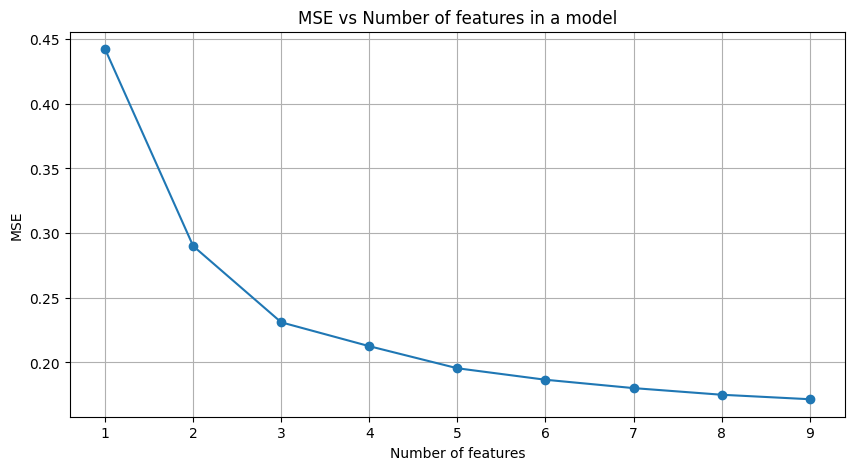

In [112]:
best_feature_subset_xgb, errors_xgb = find_best_feature_subset_parallel(X_all_train, y_all_train, is_xgboost=True)
elbow_plot(errors_xgb)

The feature hierarchy appears similar, but the error reduction is greater as new features are added compared to bagging. The difference lies in the fact that **Social support** is added relatively earlier, at the expense of **Perceptions of corruption**. Let's test how the model performs with 5 features.

In [113]:
best_5_features_xgb = ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_all_train.loc[:, best_5_features_xgb], y_all_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_all_train.loc[:, best_5_features_xgb], y_all_train, X_all_test.loc[:, best_5_features_xgb], y_all_test, additional_title=' XGBoost best 5 features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.6003
Column 'Positive affect': 0.1648
Column 'Healthy life expectancy at birth': 0.1255
Column 'Social support': 0.067
Column 'Negative affect': 0.0425


Results on train set XGBoost best 5 features
MSE: 0.02025
R2: 0.98415

Results on test set XGBoost best 5 features
MSE: 0.17654
R2: 0.85015


Removing 4 features resulted in a decrease of the metric by 0.02. However, it still remains the best result for a model based on 5 features. In the boosting model, the second-to-last most important feature is **Social support**, and the least important is **Negative affect**, whereas with bagging, the second-to-last was **Negative affect**, and the last was **Perceptions of corruption**. However, none of them has a significant impact on the model.

In conclusion, for the global dataset, the best results (both for the full and limited feature sets) are presented by the boosting algorithm **XGBoost**, though the results obtained through bagging are only slightly lower. This confirms that ensemble learning methods can improve regression results. Additionally, the boosting algorithm was able to achieve these results using much shallower trees, which is undoubtedly its advantage.

Due to the superiority of the boosting algorithm, we will define the best feature set based on this algorithm:
* The most important feature was **Log GDP per capita**. The global trend is that the wealthier a country is, the happier people generally are. Wealthier countries can allocate more money to amenities that improve people’s happiness.
* The second most important feature globally turned out to be **Positive affect**. It seems logical that people who experience more positive emotions are happier.
* The third most important feature globally was **Healthy life expectancy at birth**. Generally, countries that don’t have to worry about a short life expectancy are happier. People who are healthy for longer are happier.
* The remaining features have somewhat less significance. However, to build a model balanced between accuracy and simplicity, it is worth including features like **Social support**. There is a relationship between this feature and happiness levels – receiving social support or even simply knowing it is available in times of need positively affects happiness.
* Although **Negative affect** had a smaller impact in the full model, it appeared in the top five for boosting. This feature might contribute more when fewer features are used, whereas **Freedom to make life choices**, which was excluded, could provide better additional information in a full model.
* Overall, for the global dataset, the variables **year** and **Generosity** do not significantly contribute to determining happiness levels.

### The World - Feature Engineering

To test whether we can improve the model's performance, we will try our hand at engineering new features. We will test these to confirm whether they actually describe the data better or unnecessarily increase the complexity of the model.

The added features are:
* **Is Developed Cont** - indicates whether a country is on a developed continent. We assumed the variable takes the value **True** if the country is in Europe, Oceania, or North America.
* **GDP / mean GDP for year** - the ratio of **Log GDP per capita** to the average GDP for that year. This variable could reduce the impact of the global GDP growth trend that might occur between years.
* **Freedom x (1 - corruption)** - A variable capturing the interaction between personal freedom and perceived government corruption.
* **Positive / Negative** - The ratio of positive to negative emotions indicates the general emotional balance in society.
* **Healthy square** - A variable to check if there is a quadratic relationship between **Healthy life expectancy at birth** and the target variable.


In [114]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
columns_to_consider = x_number_columns.copy()
columns_to_consider.append('Continent')
y_column = 'Life Ladder'
df_all_new = df_cleaned_cont.loc[:, columns_to_consider]
y_all_new = df_cleaned_cont.loc[:, y_column]


df_all_new['Is Developed Cont'] = df_all_new['Continent'].apply(lambda x: 1 if x in ['Europe', 'Oceania', 'North America'] else 0)
df_all_new = df_all_new.drop(columns=['Continent'])

mean_gdp_per_year_all = df_all_new.groupby('year')["Log GDP per capita"].transform('mean')
df_all_new["GDP / mean GDP for year"] = df_all_new["Log GDP per capita"] / mean_gdp_per_year_all


df_all_new['Freedom x (1-Corruption)'] = df_all_new['Freedom to make life choices'] * (1 - df_all_new['Perceptions of corruption'])
df_all_new['Positive / Negative'] = df_all_new['Positive affect'] / df_all_new['Negative affect']
df_all_new['Healthy square'] = np.pow(df_all_new['Healthy life expectancy at birth'], 2)


scaler = MinMaxScaler()
df_all_new = pd.DataFrame(scaler.fit_transform(df_all_new), columns=df_all_new.columns, index=df_all_new.index)

df_all_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,Is Developed Cont,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square
0,0.166667,0.146628,0.080452,0.295322,0.584866,0.612810,0.876812,0.161202,0.371554,0.0,0.167764,0.095900,0.139587,0.233432
1,0.222222,0.177847,0.254612,0.304094,0.525393,0.641092,0.838433,0.281179,0.320869,0.0,0.199971,0.117056,0.201548,0.241159
2,0.277778,0.198614,0.231939,0.312865,0.405943,0.556598,0.664704,0.344605,0.412691,0.0,0.200346,0.210191,0.179281,0.248932
3,0.333333,0.192174,0.201146,0.321637,0.247889,0.607996,0.694222,0.278343,0.393119,0.0,0.206255,0.156654,0.167426,0.256751
4,0.388889,0.207810,0.200346,0.330409,0.301016,0.698114,0.748196,0.517276,0.394907,0.0,0.200105,0.138807,0.239282,0.264615
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2358,0.777778,0.215159,0.609035,0.371345,0.454137,0.351273,0.814928,0.597567,0.316695,0.0,0.202360,0.123589,0.313138,0.301920
2359,0.833333,0.195093,0.537210,0.385234,0.471417,0.416645,0.763842,0.601543,0.581804,0.0,0.154906,0.160045,0.184142,0.314803
2360,0.888889,0.207094,0.482223,0.399123,0.508318,0.317039,0.725551,0.510850,0.331892,0.0,0.167951,0.192981,0.273281,0.327801
2361,0.944444,0.209698,0.449706,0.413012,0.484587,0.324428,0.720321,0.565708,0.211009,0.0,0.187270,0.191736,0.393177,0.340914


Below, we will check the correlation between the added features and the remaining ones.

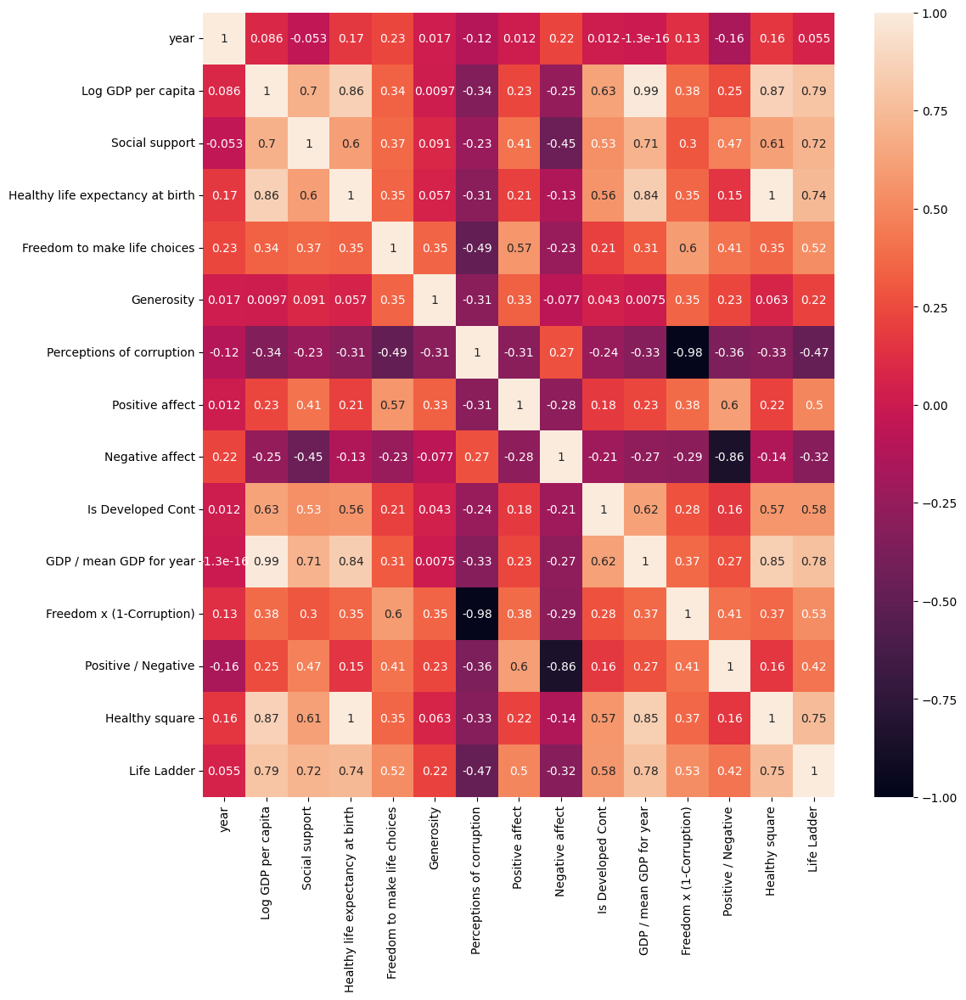

In [115]:
plt.figure(figsize=(12,12))
df_all_new_with_y = pd.concat([df_all_new, y_all_new], axis=1)
sns.heatmap(df_all_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

We can observe that:
* **Healthy square** - A perfect correlation with the **Healthy life expectancy at birth** variable, which is natural because whenever one of these variables increases, the other one does as well. However, they might carry slightly different information.
* **Log GDP per capita** and **GDP / mean GDP for year** have a very high correlation of 0.99. This is also natural because with the global increase in the feature every year, its average also rises as the observations in one year are scaled by the same factor.
* **Freedom x (1 - corruption)** - This feature has a correlation of -0.98 with **Perceptions of corruption** and only 0.6 with **Freedom to make life choices**. It may turn out that the first variable has a greater impact in this interaction.
* **Positive / Negative** - A correlation of 0.6 with **Positive affect** and -0.86 with **Negative affect**. When it comes to emotions, negative emotions seem to be more strongly associated with the outcome of the emotion ratio.
* **Is Developed Continent** does not have a significant correlation with any of the variables.

Below, we will test whether these variables have an impact on the model. Due to the fact that increasing the number of features caused a drastic increase in computation time for some algorithms, such as the algorithm selecting the best feature subset by examining all possible combinations, we will now use only a parallelized **forward stepwise** algorithm for feature selection. This will allow us to maintain reasonable execution times, and because of the greedy nature of this algorithm, it should reach the same solution much faster. Below is the parallelized version.

In [116]:
def evaluate_feature_addition(X_train, y_train, selected_features, new_feature, is_forest_reg=False, is_xgboost=False):
    tmp_features = selected_features + [new_feature]
    model = None
    if is_forest_reg:
        model = RandomForestRegressor(n_estimators=50, random_state=3)
    elif is_xgboost:
        model = XGBRegressor(max_depth=7, learning_rate=0.1, n_estimators=50, random_state=3)
    else:
        model = LinearRegression()
    
    scores = cross_validate(model, X_train[tmp_features], y_train, cv=5, scoring="neg_mean_squared_error")
    error = np.mean(-scores['test_score'])
    return error, new_feature

def find_best_subset_forward_stepwise_parallel(X_train, y_train, n_jobs=-1, is_forest_reg=False, is_xgboost=False):
    features_to_choose_from = list(X_train.columns)
    selected_features = []
    min_error_overall = np.inf
    best_model_overall = None
    errors = []

    for i in range(1, len(X_train.columns) + 1):
        results = Parallel(n_jobs=n_jobs)(
            delayed(evaluate_feature_addition)(X_train, y_train, selected_features, feature, is_forest_reg, is_xgboost)
            for feature in features_to_choose_from
        )

        min_error_for_subset = np.inf
        best_new_feature = None

        for error, feature in results:
            if error < min_error_for_subset:
                min_error_for_subset = error
                best_new_feature = feature

        selected_features.append(best_new_feature)
        features_to_choose_from.remove(best_new_feature)
        errors.append(min_error_for_subset)

        if min_error_for_subset < min_error_overall:
            min_error_overall = min_error_for_subset
            best_model_overall = selected_features.copy()

        print(f"Best model for {i} features with MSE: {np.round(min_error_for_subset, 4)} is: {selected_features}.")

    print(f"Best model has been achieved for {len(best_model_overall)} features with MSE: {np.round(min_error_overall, 4)}. Its features are: {best_model_overall}.")
    return best_model_overall, errors

In [117]:
X_all_new_train, X_all_new_test, y_all_new_train, y_all_new_test = train_test_split(df_all_new, y_all_new, test_size=0.2, random_state=3)

Below are the results of the multiple regression model.

In [118]:
model = LinearRegression()
train_and_evaluate_model(model, X_all_new_train.loc[:, :], y_all_new_train, X_all_new_test.loc[:, :], y_all_new_test, additional_title=', new features')

Feature weights:
Column 'Healthy square': 5.096
Column 'Healthy life expectancy at birth': -4.0975
Column 'Log GDP per capita': 2.5903
Column 'Positive affect': 1.1346
Column 'GDP / mean GDP for year': -1.0819
Column 'Perceptions of corruption': -1.0808
Column 'Social support': 1.0198
Column 'Freedom x (1-Corruption)': -0.5015
Column 'Freedom to make life choices': 0.474
Column 'Generosity': 0.3027
Column 'year': -0.2019
Column 'Is Developed Cont': 0.179
Column 'Positive / Negative': 0.0615
Column 'Negative affect': 0.0475


Results on train set, new features
MSE: 0.25969
R2: 0.7968

Results on test set, new features
MSE: 0.2564
R2: 0.78236


Thanks to the significant increase in the model's complexity, we can see that the $R^{2}$ on the test set has improved slightly. However, the goal is not to create the most complicated model possible. We can observe that by keeping many transformed features that represent the same phenomenon, the model has become difficult to interpret, and the influence of certain variables must compensate for each other. We can see that the highest coefficient is for the square of **Healthy life expectancy at birth**, and the second highest coefficient is for the same variable to the first power. Additionally, it has a negative coefficient, which suggests it needs to balance the excessive impact of the quadratic relationship. A similar situation is observed with **GDP / mean GDP for year**.  
**Freedom x (1 - Corruption)**, **Is Developed Cont**, and **Positive / Negative** contributed significantly less to this model. We will also check the results for both regularizations.


In [119]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_all_new_train.loc[:, :], y_all_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_all_new_train.loc[:, :], y_all_new_train, X_all_new_test.loc[:, :], y_all_new_test, additional_title=' new features with Ridge Regularization:')

Best value of alpha: 0.022927693128656487
Feature weights:
Column 'Healthy square': 4.3102
Column 'Healthy life expectancy at birth': -3.2851
Column 'Log GDP per capita': 2.5301
Column 'Positive affect': 1.1375
Column 'Social support': 1.0245
Column 'Perceptions of corruption': -1.0226
Column 'GDP / mean GDP for year': -1.0031
Column 'Freedom to make life choices': 0.4584
Column 'Freedom x (1-Corruption)': -0.4224
Column 'Generosity': 0.3044
Column 'year': -0.1958
Column 'Is Developed Cont': 0.179
Column 'Positive / Negative': 0.0594
Column 'Negative affect': 0.0476


Results on train set new features with Ridge Regularization:
MSE: 0.25978
R2: 0.79673

Results on test set new features with Ridge Regularization:
MSE: 0.25665
R2: 0.78215


In [120]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_all_new_train.loc[:, :], y_all_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_all_new_train.loc[:, :], y_all_new_train, X_all_new_test.loc[:, :], y_all_new_test, additional_title=' new features with Lasso Regularization:')

Best value of alpha: 2.491130026067786e-05
Feature weights:
Column 'Healthy square': 4.7138
Column 'Healthy life expectancy at birth': -3.6993
Column 'Log GDP per capita': 2.5074
Column 'Positive affect': 1.1411
Column 'Social support': 1.0189
Column 'GDP / mean GDP for year': -0.9894
Column 'Perceptions of corruption': -0.9724
Column 'Freedom to make life choices': 0.4533
Column 'Freedom x (1-Corruption)': -0.3721
Column 'Generosity': 0.3021
Column 'year': -0.1944
Column 'Is Developed Cont': 0.1776
Column 'Positive / Negative': 0.0426
Column 'Negative affect': 0.0356


Results on train set new features with Lasso Regularization:
MSE: 0.25972
R2: 0.79678

Results on test set new features with Lasso Regularization:
MSE: 0.25631
R2: 0.78244


None of the above methods improved the results or influenced the model's interpretation. Below, we will use the parallelized forward stepwise method for feature selection.

Best model for 1 features with MSE: 0.4814 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.3446 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE: 0.3151 is: ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)'].
Best model for 4 features with MSE: 0.2904 is: ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)', 'Social support'].
Best model for 5 features with MSE: 0.2744 is: ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)', 'Social support', 'Healthy square'].
Best model for 6 features with MSE: 0.2707 is: ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)', 'Social support', 'Healthy square', 'Is Developed Cont'].
Best model for 7 features with MSE: 0.2675 is: ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)', 'Social support', 'Healthy square', 'Is Developed Cont', 'Generosity'].
Best model for 8 features with MSE: 0.2667 is: ['Log GDP per capita

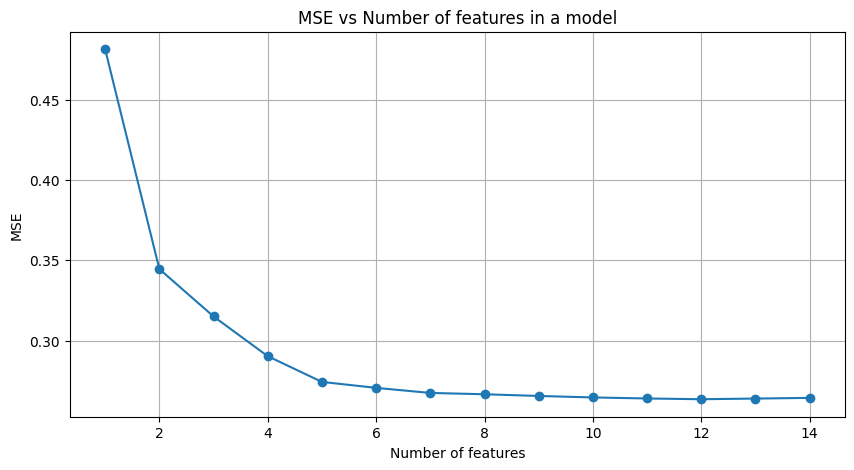

In [121]:
best_feature_subset_f_stepwise_new, errors_fs_new = find_best_subset_forward_stepwise_parallel(X_all_new_train, y_all_new_train)
elbow_plot(errors_fs_new)

Interestingly, some of the **added features** appear quickly in the model. After exceeding 5-6, we can see that MSE does not change significantly. For further analysis, we will select a subset of 6 features.

* It turns out that among the **added features**, quite significant ones may be **'Freedom x (1-Corruption)'**, **'Healthy square'**, and **'Is Developed Cont'**. They were included in the model quite quickly. We can see that the features from which we created the first and second of these variables were among the last to be included in the model.  
* Features that are of **low significance** for the multiple regression model include **'GDP / mean GDP for year'** and **'Positive / Negative'**.


In [122]:
best_6_all_new = ['Log GDP per capita', 'Positive affect', 'Freedom x (1-Corruption)', 'Social support', 'Healthy square', 'Is Developed Cont']
model = LinearRegression()
train_and_evaluate_model(model, X_all_new_train.loc[:, best_6_all_new], y_all_new_train, X_all_new_test.loc[:, best_6_all_new], y_all_new_test, additional_title=', new features, best 5')

Feature weights:
Column 'Log GDP per capita': 1.5204
Column 'Positive affect': 1.3372
Column 'Healthy square': 1.2036
Column 'Social support': 1.0876
Column 'Freedom x (1-Corruption)': 0.9574
Column 'Is Developed Cont': 0.1662


Results on train set, new features, best 5
MSE: 0.26818
R2: 0.79016

Results on test set, new features, best 5
MSE: 0.26681
R2: 0.77353


The model using 6 features performs 0.01 better than the model with 5 features. We can see that the first two features remain the same: Log GDP per capita and Positive affect. In third place is Healthy square, which also occupied the same position as the first power of the same feature in the previous model. Social support also remains in the same position. The relationship between Freedom and Corruption has replaced the place of corruption. The added information about developed continents has a minimal impact on the model. We can compare these results with RandomForest.

In [123]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_new_train.loc[:, :], y_all_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_new_train.loc[:, :], y_all_new_train, X_all_new_test.loc[:, :], y_all_new_test, additional_title=' Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 22
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.5053
Column 'GDP / mean GDP for year': 0.1652
Column 'Positive affect': 0.0889
Column 'Social support': 0.0421
Column 'Healthy square': 0.0419
Column 'Healthy life expectancy at birth': 0.0395
Column 'Freedom to make life choices': 0.0323
Column 'Generosity': 0.0173
Column 'Freedom x (1-Corruption)': 0.0146
Column 'Positive / Negative': 0.0139
Column 'Negative affect': 0.0138
Column 'Perceptions of corruption': 0.0114
Column 'year': 0.0104
Column 'Is Developed Cont': 0.0034

Mean depth of trees: 21.35


Results on train set Random Forest, new features
MSE: 0.02256
R2: 0.98235

Results on test set Random Forest, new features
MSE: 0.15107
R2: 0.87177


The metric has also improved after complicating the model. We can observe a significant influence from both Log GDP per capita and 'GDP / mean GDP for year', as well as a similar impact from the variables in the 'Healthy' group. This also makes the model quite unreadable. Let's try using feature selection methods.

Best model for 1 features with MSE: 0.5629 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.3008 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE: 0.2154 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE: 0.1972 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 5 features with MSE: 0.1882 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect', 'Freedom x (1-Corruption)'].
Best model for 6 features with MSE: 0.1838 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect', 'Freedom x (1-Corruption)', 'GDP / mean GDP for year'].
Best model for 7 features with MSE: 0.1774 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect', 'Freedom x (1-Corruption)', 'GDP / mean GDP for yea

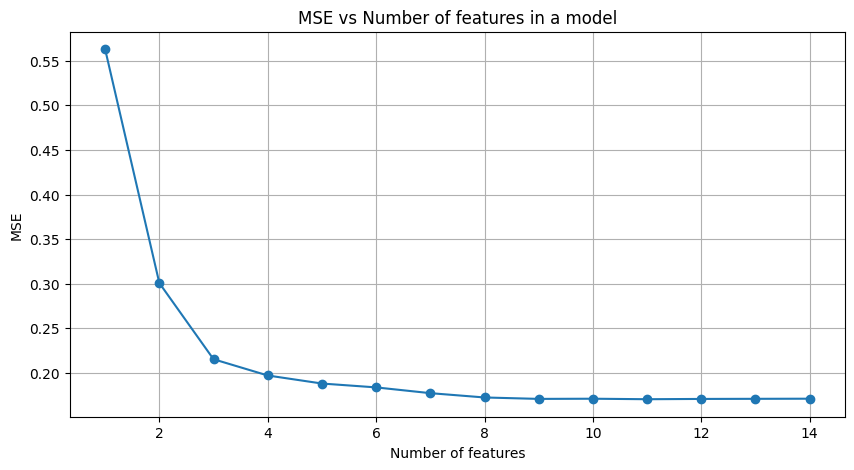

In [124]:
best_feature_subset_fs_new_forest, errors_fs_new_forest = find_best_subset_forward_stepwise_parallel(X_all_new_train, y_all_new_train, is_forest_reg=True)
elbow_plot(errors_fs_new_forest)

The error plot looks comparable to the one for the multiple regression model. Since there is no significant drop between 5 and 6 features, we will proceed with the subset of 5 features for further analysis. A new feature, 'Freedom x (1-Corruption)', has replaced Perceptions of corruption in the 5-feature subset selected by the algorithm previously.

* Despite the fact that in the multiple regression model, the algorithm preferred the transformed features more often, this is not the case here. Healthy life expectancy at birth turned out to be more significant than Healthy square.
* Positive / Negative did not perform well again.

Let's check how the metrics perform.

In [125]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_5_forest_new = ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect', 'Freedom x (1-Corruption)']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_new_train.loc[:, best_5_forest_new], y_all_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_new_train.loc[:, best_5_forest_new], y_all_new_train, X_all_new_test.loc[:, best_5_forest_new], y_all_new_test, additional_title=' Random Forest, new features, best 5 features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.6905
Column 'Positive affect': 0.1307
Column 'Healthy life expectancy at birth': 0.1031
Column 'Freedom x (1-Corruption)': 0.0388
Column 'Negative affect': 0.0369

Mean depth of trees: 13.0


Results on train set Random Forest, new features, best 5 features
MSE: 0.03487
R2: 0.97271

Results on test set Random Forest, new features, best 5 features
MSE: 0.17998
R2: 0.84723


The metric value on the test set dropped slightly by 0.00013. However, we can see a significant difference in the average depth of the tree. The drop from 22.31 to 13 indicates that by using this feature, the model can be smaller, which increases its ability to generalize on future data, even with the currently slightly lower $R^{2}$.

* We can see that 'Freedom x (1-Corruption)' has surpassed Negative affect in terms of influence. In the previous model, Perceptions of corruption was ranked lower than Negative Affect.

We can compare this with the model using 6 features, where we added 'GDP / mean GDP for year'.

In [126]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_6_forest_new = ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Negative affect', 'Freedom x (1-Corruption)', 'GDP / mean GDP for year']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_all_new_train.loc[:, best_6_forest_new], y_all_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_all_new_train.loc[:, best_6_forest_new], y_all_new_train, X_all_new_test.loc[:, best_6_forest_new], y_all_new_test, additional_title=' Random Forest, new features, best 6 features', is_forest_reg=True)

Best value of max_depth: 18
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.5264
Column 'GDP / mean GDP for year': 0.1786
Column 'Positive affect': 0.1291
Column 'Healthy life expectancy at birth': 0.0943
Column 'Freedom x (1-Corruption)': 0.0371
Column 'Negative affect': 0.0345

Mean depth of trees: 18.0


Results on train set Random Forest, new features, best 6 features
MSE: 0.02505
R2: 0.9804

Results on test set Random Forest, new features, best 6 features
MSE: 0.1677
R2: 0.85765


The $R^{2}$ on the test set increased by 0.01. Unfortunately, the tree had to become significantly more complex, being 5 levels deeper. Here, we can see that GDP-related variables are the most important ones. Despite the high correlation, the transformed variable may have provided some important information about GDP after reducing the impact of the global growth trend. However, due to the increased complexity of the model, we prefer the previous model.

Let’s compare these results with boosting.

In [127]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_all_new_train.loc[:, :], y_all_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_all_new_train.loc[:, :], y_all_new_train, X_all_new_test.loc[:, :], y_all_new_test, additional_title=' XGBoost, new features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.2
Feature importances:
Column 'GDP / mean GDP for year': 0.5638
Column 'Log GDP per capita': 0.1261
Column 'Healthy life expectancy at birth': 0.0757
Column 'Positive affect': 0.063
Column 'Is Developed Cont': 0.0516
Column 'Social support': 0.0293
Column 'Freedom to make life choices': 0.0221
Column 'Freedom x (1-Corruption)': 0.0158
Column 'Positive / Negative': 0.0138
Column 'Negative affect': 0.0125
Column 'Generosity': 0.012
Column 'Perceptions of corruption': 0.0101
Column 'year': 0.0044
Column 'Healthy square': 0.0


Results on train set XGBoost, new features
MSE: 0.00162
R2: 0.99873

Results on test set XGBoost, new features
MSE: 0.14074
R2: 0.88054


Here, too, increasing the complexity of the model improved its performance. 
* For the boosting model, 'GDP / mean GDP for year' achieved better importance, and the order of these features changes depending on the model. They are likely interchangeable with similar effectiveness.
* Unlike RandomForest, the features from the 'healthy' group have different importance. The importance of Healthy square was zeroed out, as it did not provide much information in this model.

Let's check which features will be selected by the forward stepwise algorithm.

Best model for 1 features with MSE: 0.4421 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.2899 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE: 0.2331 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE: 0.2124 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support'].
Best model for 5 features with MSE: 0.1962 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect'].
Best model for 6 features with MSE: 0.1878 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect', 'Perceptions of corruption'].
Best model for 7 features with MSE: 0.1812 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect', 'Perceptions of corruption', 'GDP / mean GDP for yea

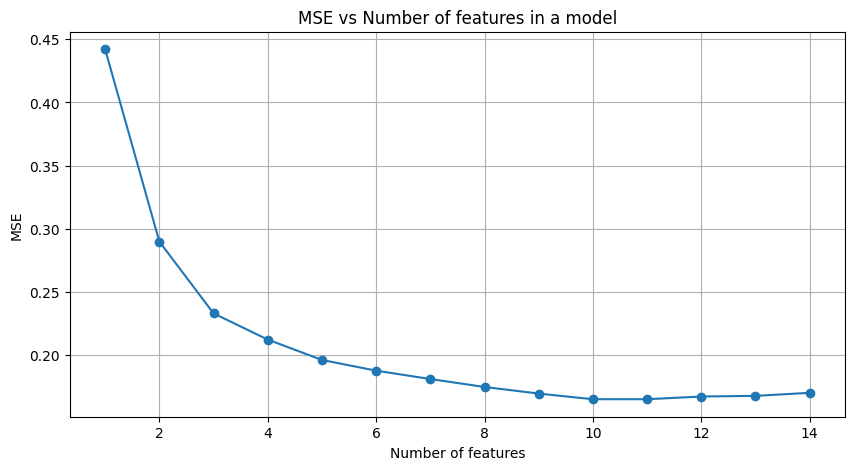

In [128]:
best_feature_subset_fs_xgboost_new, errors_fs_xgboost_new = find_best_subset_forward_stepwise_parallel(X_all_new_train, y_all_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_new)

On the plot, we observe a roughly linear decrease in error between 6 and 10 features.
In search of a good subset, we aim to avoid creating an overly complicated and difficult-to-interpret model. We can see that the first 6 features, which cause the greatest decrease in MSE, are the ones from the original set. Therefore, it makes no sense to test the same subset of features again.

The most sensible conclusions from the feature engineering attempt can be drawn from the Random Forest model.
* Most of the added features did not appear in the reduced model, which strikes a balance between performance and simplicity.
* The most important added feature turned out to be the interaction between freedom of choice and government corruption. It seems that this relationship affects happiness worldwide, and people living in places where Freedom to make life choices is high and Perceptions of corruption are low are happier.
* Additionally, this model is significantly less complex (with a 9-level lower depth of trees).

## Europe
After analyzing the impact of variables on happiness based on global data, we will now investigate which features might be important when considering continental divisions. In this case, we will examine how geographical location affects the components of happiness. We will begin with the analysis of the original features for the Old Continent.

In [129]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_europe_x = df_europe.loc[:, x_number_columns]
y_europe = df_europe.loc[:, y_column]

scaler = MinMaxScaler()
df_europe_x = pd.DataFrame(scaler.fit_transform(df_europe_x), columns=df_europe_x.columns, index=df_europe_x.index)

X_europe_train, X_europe_test, y_europe_train, y_europe_test = train_test_split(df_europe_x, y_europe, test_size=0.2, random_state=3)

model = LinearRegression()
train_and_evaluate_model(model, X_europe_train.loc[:, :], y_europe_train, X_europe_test.loc[:, :], y_europe_test, additional_title=' for Europe')

Feature weights:
Column 'Log GDP per capita': 1.0418
Column 'Positive affect': 0.7407
Column 'Perceptions of corruption': -0.7206
Column 'Social support': 0.6158
Column 'Freedom to make life choices': 0.5978
Column 'Healthy life expectancy at birth': 0.4514
Column 'Negative affect': -0.3327
Column 'Generosity': 0.2833
Column 'year': 0.0258


Results on train set for Europe
MSE: 0.1343
R2: 0.8401

Results on test set for Europe
MSE: 0.16284
R2: 0.79901


Considering all features, we can observe that the happiness of Europeans is more easily described by them, with the $R^{2}$ metric increasing by about 0.028. We also see that the absolute values of the coefficients are smaller compared to the global dataset. This could be due to the combination of the fact that the happiness of Europeans can be more easily explained by the variables in the dataset, but also because there is less data, making the model easier to fit. Regarding the features, we observe the following conclusions in comparison to the global dataset:

* The happiness of Europeans is also most strongly explained by Log GDP per capita, just like the global dataset.
* The happiness of Europeans is much less dependent on Healthy life expectancy at birth. It is possible that this is related to the fact that life expectancy in Europe is generally high. Therefore, happiness on the Old Continent is determined by other factors.
* Perceptions of corruption ranks higher in the hierarchy. Europeans are definitely happier if corruption is perceived to be low in their country.
* For the global dataset, Negative affect was the least explanatory feature for happiness. However, for Europe, it ranks third from the bottom, meaning that Europeans pay slightly more attention to the level of negative emotions when determining their happiness.

Let's check if regularization can improve the results.

Best value of alpha: 2.06913808111479


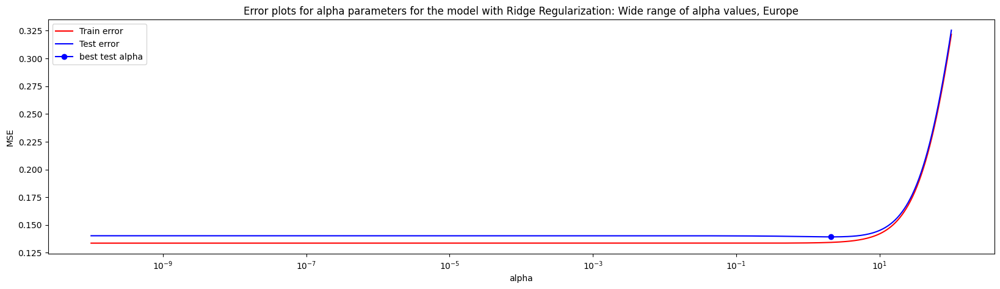

In [130]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_europe_train.loc[:, :], y_europe_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Europe')

In [131]:
alpha_values = np.logspace(0, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_europe_train.loc[:, :], y_europe_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_europe_train, y_europe_train, X_europe_test, y_europe_test, additional_title=' Europe with Ridge Regularization:')

Best value of alpha: 2.086024089248504
Feature weights:
Column 'Log GDP per capita': 0.8945
Column 'Perceptions of corruption': -0.7347
Column 'Positive affect': 0.7154
Column 'Freedom to make life choices': 0.6096
Column 'Social support': 0.6071
Column 'Healthy life expectancy at birth': 0.5082
Column 'Negative affect': -0.3522
Column 'Generosity': 0.2853
Column 'year': 0.0259


Results on train set Europe with Ridge Regularization:
MSE: 0.13472
R2: 0.8396

Results on test set Europe with Ridge Regularization:
MSE: 0.16035
R2: 0.80209


After applying regularization, the $R^{2}$ metric increased by about 0.003 on unseen data, and the coefficients have decreased relatively significantly. Interestingly, this led to an increase in the relative importance of the variables Perceptions of corruption and Freedom to make life choices. Furthermore, the optimal value of the regularization hyperparameter alpha is much higher than for the global dataset. Let's compare this with Lasso regularization.

Best value of alpha: 0.00031350220625651123


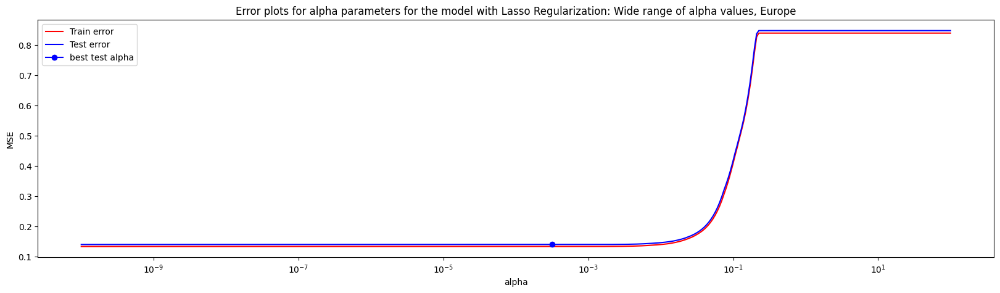

In [132]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_europe_train.loc[:, :], y_europe_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Europe')

In [133]:
alpha_values = np.logspace(-4, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_europe_train.loc[:, :], y_europe_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_europe_train.loc[:, :], y_europe_train, X_europe_test.loc[:, :], y_europe_test, additional_title=' Europe with Lasso Regularization:')

Best value of alpha: 0.000326222200971167
Feature weights:
Column 'Log GDP per capita': 1.0439
Column 'Positive affect': 0.7437
Column 'Perceptions of corruption': -0.7257
Column 'Social support': 0.6095
Column 'Freedom to make life choices': 0.6017
Column 'Healthy life expectancy at birth': 0.4402
Column 'Negative affect': -0.319
Column 'Generosity': 0.2774
Column 'year': 0.0231


Results on train set Europe with Lasso Regularization:
MSE: 0.13431
R2: 0.84009

Results on test set Europe with Lasso Regularization:
MSE: 0.16272
R2: 0.79916


Lasso regularization did not introduce significant changes, only slightly improving the $R^{2}$ metric. Let's now compare the results with the Random Forest Regressor.

In [134]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_europe_train, y_europe_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_europe_train, y_europe_train, X_europe_test, y_europe_test, additional_title=' Random Forest, Europe', is_forest_reg=True)

Best value of max_depth: 14
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.8127
Column 'Freedom to make life choices': 0.0545
Column 'Positive affect': 0.0255
Column 'Perceptions of corruption': 0.0246
Column 'Negative affect': 0.0209
Column 'Social support': 0.0198
Column 'Healthy life expectancy at birth': 0.0174
Column 'Generosity': 0.0139
Column 'year': 0.0106

Mean depth of trees: 14.0


Results on train set Random Forest, Europe
MSE: 0.0106
R2: 0.98738

Results on test set Random Forest, Europe
MSE: 0.0883
R2: 0.89101


The Random Forest Regressor performed significantly better, achieving an $R^{2}$ metric of 0.89 for the test set, with a much smaller average tree depth. Interestingly, based on the feature importance from this regressor, we can see some differences compared to the standard multiple regression results:
* Log GDP per capita is the variable with 81% influence on the outcome. In Europe, GDP is the dominant factor in determining happiness, and a simple linear regression would likely give good results here.
* When using Random Forest Regressor, the second most important feature in Europe seems to be Freedom to make life choices.
* Other features appear to have smaller and similar levels of influence.

Let’s now compare this with the boosting method.

In [135]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_europe_train, y_europe_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_europe_train, y_europe_train, X_europe_test, y_europe_test, additional_title=' XGBoost, Europe', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.7388
Column 'Freedom to make life choices': 0.0805
Column 'Positive affect': 0.0528
Column 'Perceptions of corruption': 0.0341
Column 'Healthy life expectancy at birth': 0.0239
Column 'Negative affect': 0.0223
Column 'Generosity': 0.0185
Column 'Social support': 0.018
Column 'year': 0.0111


Results on train set XGBoost, Europe
MSE: 0.00359
R2: 0.99573

Results on test set XGBoost, Europe
MSE: 0.08736
R2: 0.89217


Boosting reduced bias much more than bagging, but the improvement on the test set is very minimal. However, it did this with a much smaller average tree depth.
* The first 4 most important features are in the same hierarchy as in bagging. The difference is that Log GDP per capita has slightly less importance, around 73%.
* As the fifth feature, the algorithm chose Healthy life expectancy at birth, whereas the previous model chose Negative affect. The differences in the importance of these features are not significant.
* The least useful feature once again is the year.

Let’s apply feature selection algorithms to determine which subset would provide a satisfactory solution.

In [136]:
lasso_feature_selection(X_europe_train, y_europe_train)

Alpha: 0.0032 - Excluded: year
Alpha: 0.0078 - Excluded: Negative affect
Alpha: 0.0163 - Excluded: Healthy life expectancy at birth
Alpha: 0.0187 - Excluded: Generosity
Alpha: 0.0297 - Excluded: Social support
Alpha: 0.0860 - Excluded: Log GDP per capita
Alpha: 0.0901 - Excluded: Positive affect
Alpha: 0.1190 - Excluded: Freedom to make life choices
Alpha: 0.2171 - Excluded: Perceptions of corruption

All features have been excluded.


Lasso regularization first zeroed out the "year" variable, followed by "Negative affect." It did this in the opposite order compared to when considering the full dataset. Interestingly, "Healthy life expectancy at birth" was zeroed out earlier than "Generosity." What is most surprising, however, is the early zeroing out of "Log GDP per capita," which was the most important feature in the multiple regression model. Let’s now compare these results with the forward stepwise method.

In [137]:
best_subset_f_stepwise_europe, errors_fs_europe = find_best_subset_forward_stepwise(X_europe_train, y_europe_train)

Best model for 1 features with MSE:  0.2525 is: ['Positive affect'].
Best model for 2 features with MSE:  0.1917 is: ['Positive affect', 'Log GDP per capita'].
Best model for 3 features with MSE:  0.1623 is: ['Positive affect', 'Log GDP per capita', 'Perceptions of corruption'].
Best model for 4 features with MSE:  0.1488 is: ['Positive affect', 'Log GDP per capita', 'Perceptions of corruption', 'Freedom to make life choices'].
Best model for 5 features with MSE:  0.1437 is: ['Positive affect', 'Log GDP per capita', 'Perceptions of corruption', 'Freedom to make life choices', 'Social support'].
Best model for 6 features with MSE:  0.142 is: ['Positive affect', 'Log GDP per capita', 'Perceptions of corruption', 'Freedom to make life choices', 'Social support', 'Generosity'].
Best model for 7 features with MSE:  0.1416 is: ['Positive affect', 'Log GDP per capita', 'Perceptions of corruption', 'Freedom to make life choices', 'Social support', 'Generosity', 'Healthy life expectancy at birt

The algorithms removed the first five features in the same order. However, the forward stepwise algorithm valued "Log GDP per capita" and "Positive affect" much higher than the Lasso method. On the other hand, Lasso valued "Freedom to make life choices" and "Perceptions of corruption" more highly. Looking at the regression model results, the conclusion is not so clear-cut. The multiple regression model indeed gave more importance to GDP and Positive affect, while Random Forest assigned more weight to "Freedom to make life choices" than to Positive affect. The early zeroing out of "Log GDP per capita" is a surprising result, especially since in Random Forest it had over 80% importance. Let’s now compare the results with the algorithm that searches all possibilities.

Best model for 1 features with MSE:  0.2525 is: ['Positive affect'].
Best model for 2 features with MSE:  0.1917 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.1623 is: ['Log GDP per capita', 'Perceptions of corruption', 'Positive affect'].
Best model for 4 features with MSE:  0.1488 is: ['Log GDP per capita', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect'].
Best model for 5 features with MSE:  0.1437 is: ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect'].
Best model for 6 features with MSE:  0.142 is: ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 7 features with MSE:  0.1416 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect', 'Negative 

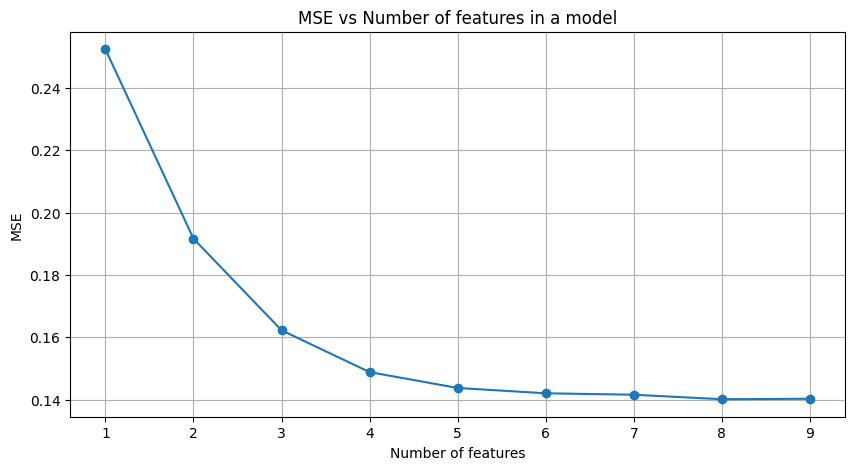

In [138]:
best_subset_par_europe, errors_par_europe = find_best_feature_subset_parallel(X_europe_train, y_europe_train)
elbow_plot(errors_par_europe)

Although "Log GDP per capita" was always the most important feature for Europe, we can see that if we were to apply the simplest linear regression, "Positive affect" was selected as the single feature that minimized the mean squared error the most. Let’s recall that "Positive affect" had the highest correlation with the outcome.

The forward stepwise algorithm and the all-possibilities search algorithm both selected 8 features as those that minimized the mean squared error, and both discarded the "year" variable. Time passing is not the most influential factor when it comes to European happiness.

Depending on the goal, a good number of features balancing model complexity and performance would be 4 or 5.


In [139]:
best_4_europe = ['Log GDP per capita', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect']
best_5_europe = ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect']

print('4 FEATURES')
model = LinearRegression()
train_and_evaluate_model(model, X_europe_train.loc[:, best_4_europe], y_europe_train, X_europe_test.loc[:, best_4_europe], y_europe_test, additional_title=' for Europe, best 4 features')
print('\n5 FEATURES')
model = LinearRegression()
train_and_evaluate_model(model, X_europe_train.loc[:, best_5_europe], y_europe_train, X_europe_test.loc[:, best_5_europe], y_europe_test, additional_title=' for Europe, best 5 features')

4 FEATURES
Feature weights:
Column 'Log GDP per capita': 1.4777
Column 'Positive affect': 1.0852
Column 'Freedom to make life choices': 0.8278
Column 'Perceptions of corruption': -0.7944


Results on train set for Europe, best 4 features
MSE: 0.14504
R2: 0.82732

Results on test set for Europe, best 4 features
MSE: 0.17788
R2: 0.78044

5 FEATURES
Feature weights:
Column 'Log GDP per capita': 1.264
Column 'Positive affect': 0.9766
Column 'Perceptions of corruption': -0.842
Column 'Freedom to make life choices': 0.7321
Column 'Social support': 0.5655


Results on train set for Europe, best 5 features
MSE: 0.1395
R2: 0.83391

Results on test set for Europe, best 5 features
MSE: 0.16798
R2: 0.79266


The models are still performing well, and with a model based on 4 features, the $R^2$ dropped by 0.02 compared to using all features. However, when we included "Social support", the difference between the full model and the reduced one was only 0.007. The variable "Social support" actually improved the metric more than adding the remaining 4 variables. The most important variables for Europe are:
* Log GDP per capita
* Positive affect
* Perceptions of corruption
* Freedom to make life choices
* Social support

When comparing this result to the general trend, it turns out that among the 5 most important features for Europe, "Freedom to make life choices" replaces "Healthy life expectancy at birth". In societies with high life expectancy in good health, the people seem to value the freedom to make life decisions much more.

Let's once again check if regularization can help us achieve better results.

Best value of alpha: 1.1094628943275195


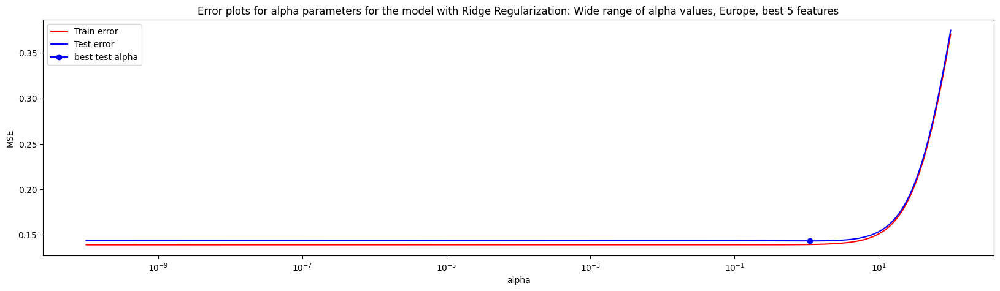

In [140]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_europe_train.loc[:, best_5_europe], y_europe_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Europe, best 5 features')

In [141]:
alpha_values = np.logspace(0, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_europe_train.loc[:, best_5_europe], y_europe_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_europe_train.loc[:, best_5_europe], y_europe_train, X_europe_test.loc[:, best_5_europe], y_europe_test, additional_title=' Europe with Ridge Regularization, 5 best features:')

Best value of alpha: 1.0940547072057427
Feature weights:
Column 'Log GDP per capita': 1.1764
Column 'Positive affect': 0.9546
Column 'Perceptions of corruption': -0.8624
Column 'Freedom to make life choices': 0.7453
Column 'Social support': 0.5785


Results on train set Europe with Ridge Regularization, 5 best features:
MSE: 0.1397
R2: 0.83368

Results on test set Europe with Ridge Regularization, 5 best features:
MSE: 0.16641
R2: 0.7946


L2 regularization slightly improved the $R^2$ metric, but the increase is not significant.

Best value of alpha: 0.0004135626917817706


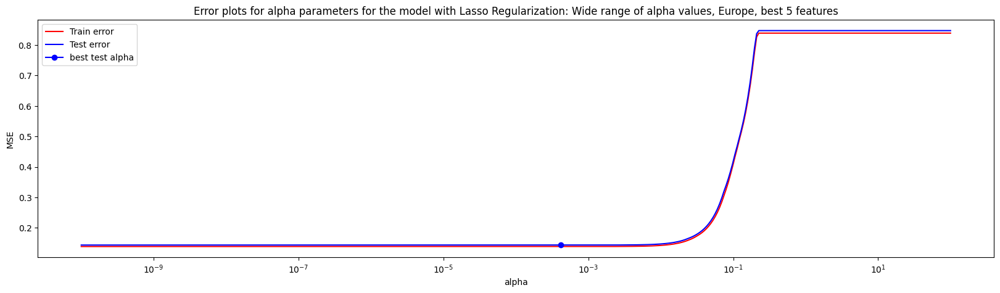

In [142]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_europe_train.loc[:, best_5_europe], y_europe_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Europe, best 5 features')

In [143]:
alpha_values = np.logspace(-4, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_europe_train.loc[:, best_5_europe], y_europe_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_europe_train.loc[:, best_5_europe], y_europe_train, X_europe_test.loc[:, best_5_europe], y_europe_test, additional_title=' Europe with Lasso Regularization for 5 best features:')

Best value of alpha: 0.0004070142453219439
Feature weights:
Column 'Log GDP per capita': 1.2601
Column 'Positive affect': 0.9731
Column 'Perceptions of corruption': -0.8433
Column 'Freedom to make life choices': 0.7318
Column 'Social support': 0.5574


Results on train set Europe with Lasso Regularization for 5 best features:
MSE: 0.13951
R2: 0.8339

Results on test set Europe with Lasso Regularization for 5 best features:
MSE: 0.1678
R2: 0.79289


The situation is similar, L1 regularization slightly increased the $R^{2}$ scores on the test set, but less than L2. Let's compare the obtained results with the random forest regressor for the best features, but first, let's plot the elbow chart, which will help us with feature selection for this model.

Best model for 1 features with MSE:  0.2444 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1278 is: ['Log GDP per capita', 'Freedom to make life choices'].
Best model for 3 features with MSE:  0.1028 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.0941 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 5 features with MSE:  0.0875 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect'].
Best model for 6 features with MSE:  0.086 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.0808 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of

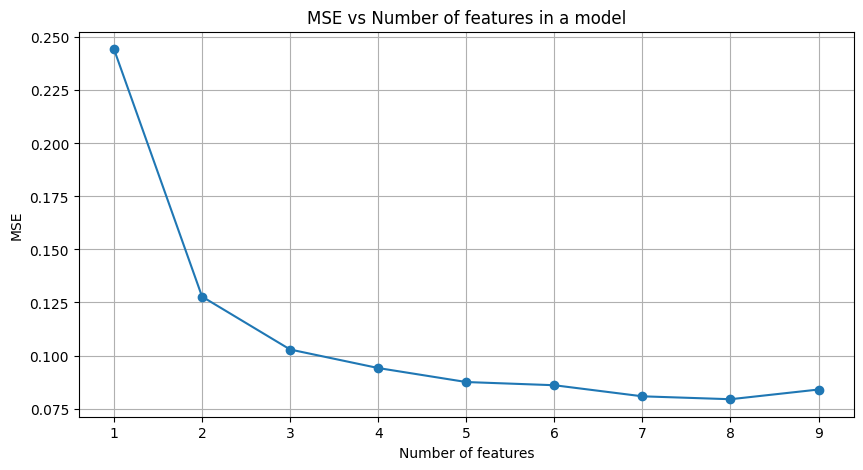

In [144]:
best_subset_par_europe_forest, errors_par_europe_forest = find_best_feature_subset_parallel(X_europe_train, y_europe_train, is_forest_reg=True)
elbow_plot(errors_par_europe_forest)

An interesting fact is that the best subset according to the algorithm does not include **Freedom to make life choices**, while the best subset consisting of 3 features does include it. It is possible that its influence is suppressed by the other features, or it simply provides significantly more information when paired with fewer features. For comparisons, we will use a model consisting of 5 features. What is interesting here is the presence of **Healthy life expectancy at birth**, which theoretically had less impact in the multiple regression model. It is included here at the cost of **positive affect**, which is an even bigger surprise.

In [145]:
best_5_europe_forest =  ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_europe_train.loc[:, best_5_europe_forest], y_europe_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_europe_train.loc[:, best_5_europe_forest], y_europe_train, X_europe_test.loc[:, best_5_europe_forest], y_europe_test, additional_title=' Random Forest, Europe, Best 5 features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.833
Column 'Freedom to make life choices': 0.0702
Column 'Perceptions of corruption': 0.034
Column 'Negative affect': 0.0327
Column 'Healthy life expectancy at birth': 0.0302

Mean depth of trees: 13.0


Results on train set Random Forest, Europe, Best 5 features
MSE: 0.01182
R2: 0.98593

Results on test set Random Forest, Europe, Best 5 features
MSE: 0.09077
R2: 0.88796


Removing 4 features slightly lowered the $R^{2}$ metric. They might unnecessarily increase the complexity of the model. With minimal loss in effectiveness, the model can be significantly simplified.
* According to bagging, **happiness in Europe** is best described by **Log GDP per capita**, just as in the rest of the world.
* According to this model, Europeans highly value **freedom to make life choices** and have a low **perception of corruption**.
* However, the last 3 features have a somewhat smaller impact on the model.

We can compare this with the boosting method.

With the decrease in the number of features, the model's performance on the test set dropped by about 0.025. We can see that the random forest regressor values **Freedom to make life choices** more than the others (apart from **GDP**), compared to regular multiple regression. However, the presented model still describes **European happiness** quite well. We can compare it with the boosting model and check if the feature selection will be similar.

Best model for 1 features with MSE:  0.2155 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1374 is: ['Log GDP per capita', 'Freedom to make life choices'].
Best model for 3 features with MSE:  0.1106 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.0969 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 5 features with MSE:  0.0856 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect'].
Best model for 6 features with MSE:  0.0845 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.0845 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make l

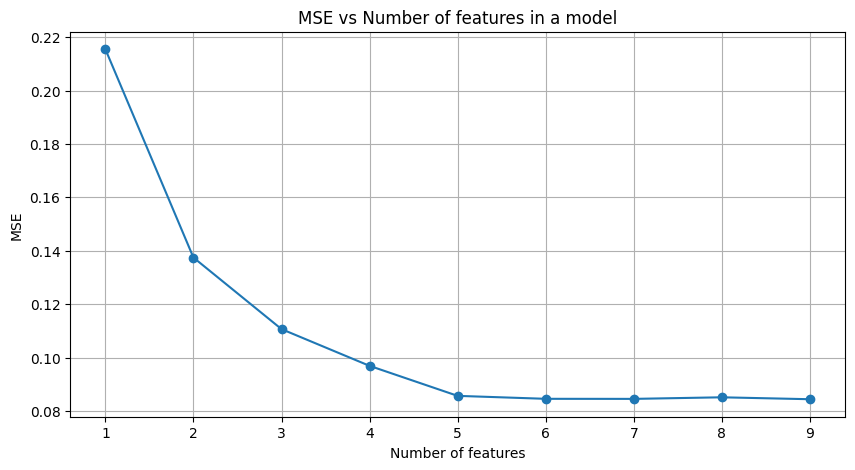

In [146]:
best_subset_par_europe_xgb, errors_par_europe_xgb = find_best_feature_subset_parallel(X_europe_train, y_europe_train, is_xgboost=True)
elbow_plot(errors_par_europe_xgb)

The boosting model selected the full model as the one minimizing the mean squared error. However, we can see that adding the sixth and subsequent features doesn't significantly change the results. Therefore, we can build a model based on 5 features that shouldn't drastically deviate from the best one. Interestingly, the boosting model also does not value the **Positive affect** feature the most, as it was added last, despite having the highest correlation with the target. The boosting algorithm selected the same 5 features as the bagging algorithm. The subset we will use for the next considerations is:

['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect']

In [147]:
best_5_europe_xgb = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_europe_train.loc[:, best_5_europe_xgb], y_europe_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_europe_train.loc[:, best_5_europe_xgb], y_europe_train, X_europe_test.loc[:, best_5_europe_xgb], y_europe_test, additional_title=' XGBoost, Europe best 5 features', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.7762
Column 'Freedom to make life choices': 0.0987
Column 'Perceptions of corruption': 0.045
Column 'Negative affect': 0.0401
Column 'Healthy life expectancy at birth': 0.04


Results on train set XGBoost, Europe best 5 features
MSE: 0.00763
R2: 0.99092

Results on test set XGBoost, Europe best 5 features
MSE: 0.10888
R2: 0.86562


Interestingly, this time boosting performed worse than bagging. Despite a further reduction in bias, its generalization ability is worse than with bagging and about 0.03 worse than the full model. Despite this, the algorithm returned the same feature hierarchy as bagging.

To summarize, **European happiness** is best defined by the following 5 features:
* **Log GDP per capita** - Despite Europe being one of the wealthiest regions, there was still a fairly large range of variability in this variable. The data shows that wealthier regions in Europe are happier, so this feature is the most important for this continent.
* **Freedom to make life choices** - Europeans value the freedom to make life decisions. The freedom to choose one’s life path, travel, or simply the sense of being able to make decisions about one’s own life positively impacts happiness.
* **Perceptions of corruption** - Europe is a region where happiness is also somewhat dictated by the level of corruption. Europeans value a low level of corruption.
* **Negative affect** - Interestingly, at least for bagging and boosting, Europeans value a lower level of negative emotions more than a higher level of positive ones.
* **Healthy life expectancy at birth** - Despite Europeans generally having higher values for this feature, the ability to live a long, healthy life is an important factor for their happiness. This allows them to enjoy life’s blessings for a longer time. This feature may be related to GDP, as wealthier countries can spend more on healthcare and prevention.

Additionally, from previous considerations, we can infer that:
* **Year**, **Social support**, and **Generosity** do not significantly affect happiness levels in Europe.
* Interestingly, **European happiness** depends more on a low level of **Negative affect** than on a high level of **Positive affect**. The first feature was consistently selected by the models. This suggests that Europeans value peace and low levels of negative emotions much more than a high level of positive emotions.

### Europe - Feature Engineering

Similarly to before, we will try to improve prediction results using feature engineering. We will use the same features we used in the global dataset analysis. Naturally, we will not include the **Is Developed Cont** variable, as all observations would have the same value for it. Instead, we added the **Generosity x Social support** feature. We will check if societies that are both generous and have higher levels of social support have a higher sense of happiness. Since the **Generosity** variable takes both positive and negative values, we decided to shift it to a non-negative range by subtracting its minimum value.

In [148]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_europe_new = df_europe.loc[:, x_number_columns]
y_europe_new = df_europe.loc[:, y_column]

mean_gdp_per_year_europe = df_europe_new.groupby('year')["Log GDP per capita"].transform('mean')
df_europe_new["GDP / mean GDP for year"] = df_europe_new["Log GDP per capita"] / mean_gdp_per_year_europe


df_europe_new['Freedom x (1-Corruption)'] = df_europe_new['Freedom to make life choices'] * (1 - df_europe_new['Perceptions of corruption'])
df_europe_new['Positive / Negative'] = df_europe_new['Positive affect'] / df_europe_new['Negative affect']
df_europe_new['Healthy square'] = np.pow(df_europe_new['Healthy life expectancy at birth'], 2)

df_europe_new['Generosity_shifted'] = df_europe_new['Generosity'] - df_europe_new['Generosity'].min()
df_europe_new['Generosity x Social support'] = df_europe_new['Generosity_shifted'] * df_europe_new['Social support']
df_europe_new = df_europe_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_europe_new = pd.DataFrame(scaler.fit_transform(df_europe_new), columns=df_europe_new.columns, index=df_europe_new.index)

df_europe_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
15,0.111111,0.072456,0.544825,0.550824,0.306186,0.410299,0.867532,0.180619,0.330314,0.150140,0.072382,0.198668,0.523542,0.368004
16,0.222222,0.115936,0.577314,0.589286,0.300885,0.223344,0.854069,0.351569,0.423794,0.157013,0.079128,0.206697,0.562597,0.203168
17,0.277778,0.130958,0.299330,0.608516,0.369454,0.205255,0.686430,0.377785,0.482866,0.159043,0.184785,0.184666,0.582247,0.164324
18,0.333333,0.141063,0.372466,0.627747,0.241735,0.164417,0.870341,0.354471,0.359395,0.165310,0.064504,0.246574,0.601979,0.136348
19,0.388889,0.146774,0.442225,0.646978,0.420493,0.209315,0.834561,0.326711,0.401466,0.153269,0.104266,0.210611,0.621793,0.179311
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2220,0.777778,0.667411,0.882403,0.780219,0.816414,0.758389,0.392192,0.745439,0.343601,0.597488,0.541423,0.406830,0.761311,0.780673
2221,0.833333,0.623636,0.845314,0.787088,0.864365,0.672457,0.398429,0.697299,0.268754,0.577859,0.555520,0.461213,0.768608,0.682430
2222,0.888889,0.650527,0.635705,0.793956,0.755327,0.743191,0.346360,0.621380,0.385090,0.574309,0.554679,0.326809,0.775917,0.693084
2223,0.944444,0.665422,0.661891,0.800824,0.821153,0.813259,0.320164,0.709236,0.397971,0.573001,0.606916,0.348668,0.783236,0.766785


We will check the correlation matrix.

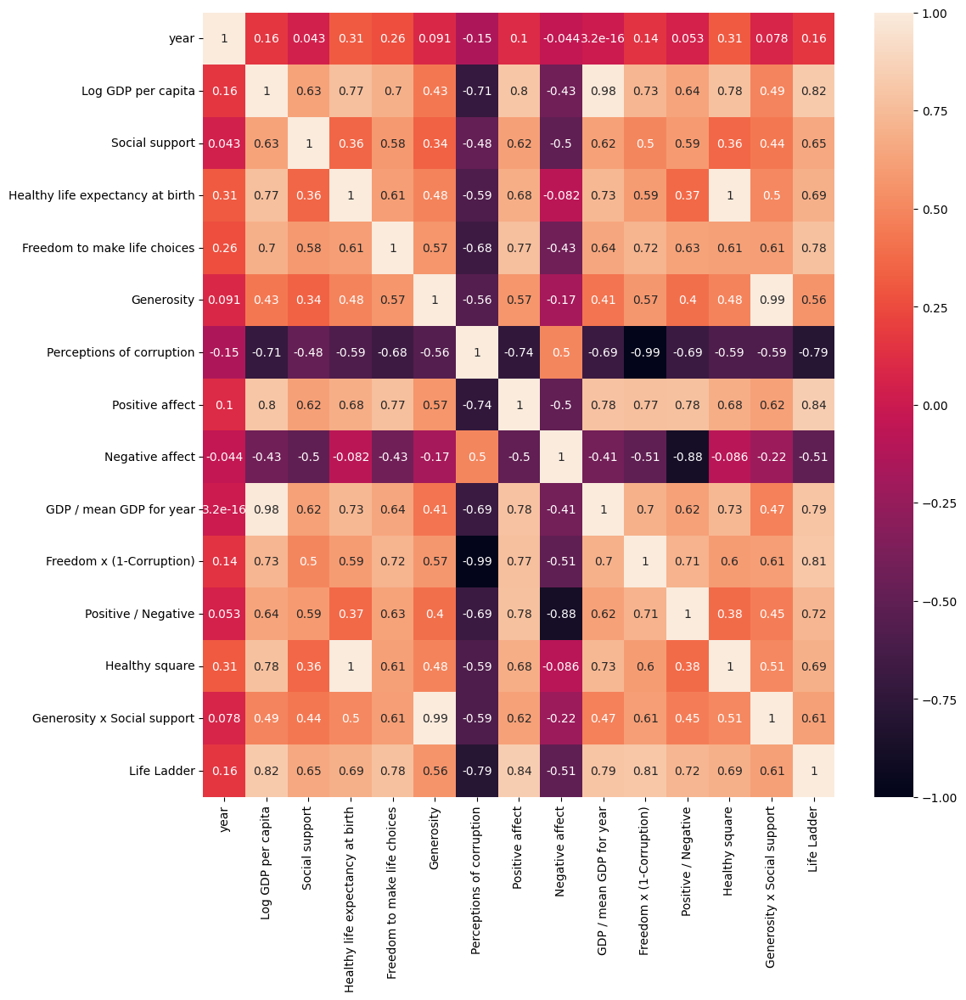

In [149]:
plt.figure(figsize=(12,12))
df_europe_new_y = pd.concat([df_europe_new, y_europe_new], axis=1)
sns.heatmap(df_europe_new_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* **GDP / mean GDP for year** naturally has a high correlation with **Log GDP per capita**, just as **Healthy life expectancy at birth** has with **Healthy squared**.
* **Freedom * (1 - Corruption)** also has a very high negative correlation with **Perceptions of corruption**. A high, but definitely lower correlation occurs with **Freedom to make life choices**.
* The ratio of positive to negative emotions has a high negative correlation with **Negative affect** (-0.88), but also a high positive correlation with **Positive affect** (0.78).
* The new feature **Generosity x Social support** has a very high correlation with **Generosity** (0.99) and much lower with **Social support** (0.44).

We will check how the models perform with the new data.

In [150]:
X_europe_new_train, X_europe_new_test, y_europe_new_train, y_europe_new_test = train_test_split(df_europe_new, y_europe_new, test_size=0.2, random_state=3)

In [151]:
model = LinearRegression()
train_and_evaluate_model(model, X_europe_new_train.loc[:, :], y_europe_new_train, X_europe_new_test.loc[:, :], y_europe_new_test, additional_title=', Europe, new features')

Feature weights:
Column 'Healthy square': 5.9709
Column 'Healthy life expectancy at birth': -5.607
Column 'Generosity x Social support': 2.2156
Column 'Log GDP per capita': 2.1107
Column 'Generosity': -1.8926
Column 'GDP / mean GDP for year': -1.1614
Column 'Freedom x (1-Corruption)': 0.6132
Column 'Positive affect': 0.6046
Column 'Freedom to make life choices': 0.5593
Column 'Social support': 0.3044
Column 'Positive / Negative': 0.2055
Column 'Negative affect': -0.1899
Column 'Perceptions of corruption': -0.0998
Column 'year': -0.0612


Results on train set, Europe, new features
MSE: 0.13121
R2: 0.84379

Results on test set, Europe, new features
MSE: 0.15753
R2: 0.80556


Increasing the model complexity slightly improved the metric value on the test set, but it is much harder to interpret. The **Healthy** features gained the most importance in the model, but they balance each other out.  
The newly added feature also ranks highly, but its effect is balanced by **Generosity**.

The ratio of emotions is once again a less influential feature.  
To be certain, we will apply regularization.

In [152]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_europe_new_train.loc[:, :], y_europe_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_europe_new_train.loc[:, :], y_europe_new_train, X_europe_new_test.loc[:, :], y_europe_new_test, additional_title=' Europe, new features with Ridge Regularization:')

Best value of alpha: 0.021102034285685967
Feature weights:
Column 'Log GDP per capita': 1.9902
Column 'Healthy square': 1.5533
Column 'Generosity x Social support': 1.467
Column 'Generosity': -1.1702
Column 'Healthy life expectancy at birth': -1.1307
Column 'GDP / mean GDP for year': -1.0207
Column 'Positive affect': 0.6133
Column 'Freedom x (1-Corruption)': 0.59
Column 'Freedom to make life choices': 0.5471
Column 'Social support': 0.422
Column 'Positive / Negative': 0.2557
Column 'Perceptions of corruption': -0.1537
Column 'Negative affect': -0.1343
Column 'year': -0.0521


Results on train set Europe, new features with Ridge Regularization:
MSE: 0.1318
R2: 0.84308

Results on test set Europe, new features with Ridge Regularization:
MSE: 0.15921
R2: 0.80349


In [153]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_europe_new_train.loc[:, :], y_europe_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_europe_new_train.loc[:, :], y_europe_new_train, X_europe_new_test.loc[:, :], y_europe_new_test, additional_title=' Europe, new features with Lasso Regularization:')

Best value of alpha: 8.296958520834916e-05
Feature weights:
Column 'Log GDP per capita': 1.9444
Column 'Generosity x Social support': 1.112
Column 'GDP / mean GDP for year': -0.9554
Column 'Generosity': -0.8207
Column 'Freedom x (1-Corruption)': 0.6222
Column 'Positive affect': 0.6102
Column 'Freedom to make life choices': 0.5378
Column 'Social support': 0.4711
Column 'Healthy square': 0.4328
Column 'Positive / Negative': 0.2791
Column 'Perceptions of corruption': -0.1305
Column 'Negative affect': -0.1093
Column 'year': -0.0459
Column 'Healthy life expectancy at birth': -0.0


Results on train set Europe, new features with Lasso Regularization:
MSE: 0.1322
R2: 0.84261

Results on test set Europe, new features with Lasso Regularization:
MSE: 0.16025
R2: 0.80221


Both regularizations significantly reduced the parameter values. Both also increased the importance of **Log GDP per capita** at the expense of the **Healthy** features. However, this did not have a large impact on the metrics. To simplify the model, we will try to select a subset of features.

Best model for 1 features with MSE: 0.2525 is: ['Positive affect'].
Best model for 2 features with MSE: 0.1913 is: ['Positive affect', 'Freedom x (1-Corruption)'].
Best model for 3 features with MSE: 0.1593 is: ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita'].
Best model for 4 features with MSE: 0.1485 is: ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices'].
Best model for 5 features with MSE: 0.1435 is: ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices', 'Social support'].
Best model for 6 features with MSE: 0.1416 is: ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices', 'Social support', 'Generosity x Social support'].
Best model for 7 features with MSE: 0.1401 is: ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices', 'Social support', 'Generosity x Social support', 'GD

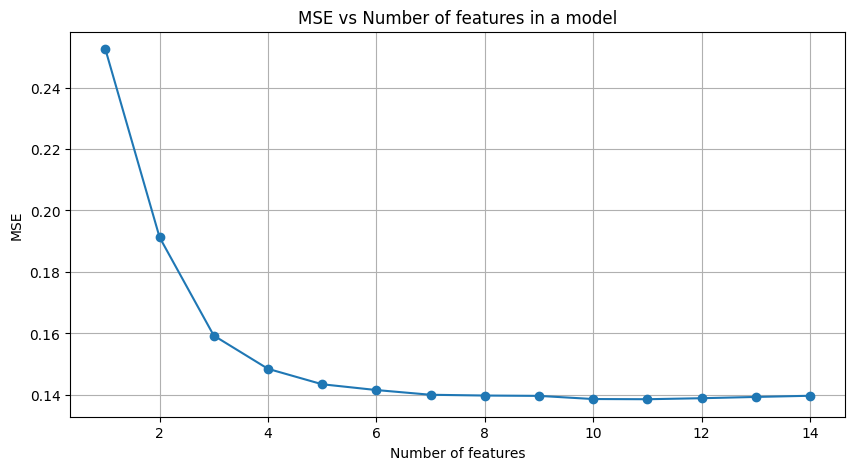

In [154]:
best_feature_subset_fs_europe, errors_fs_europe = find_best_subset_forward_stepwise_parallel(X_europe_new_train, y_europe_new_train)
elbow_plot(errors_fs_europe)

Analyzing the result of the above functions, we can decide on a set of 5-6 features. The 5-feature set includes the added feature '**Freedom x (1-Corruption)**', and the 6-feature set also includes '**Generosity x Social support**'. Therefore, we will test the results of both models.
Interestingly, we can see that the features we added were included in the model earlier than the other features from the original set.

In [155]:
best_5_all_new = ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices', 'Social support']
model = LinearRegression()
train_and_evaluate_model(model, X_europe_new_train.loc[:, best_5_all_new], y_europe_new_train, X_europe_new_test.loc[:, best_5_all_new], y_europe_new_test, additional_title=', Europe, new features, best 5 features')

Feature weights:
Column 'Log GDP per capita': 1.2885
Column 'Positive affect': 0.9378
Column 'Freedom x (1-Corruption)': 0.9088
Column 'Freedom to make life choices': 0.6586
Column 'Social support': 0.5635


Results on train set, Europe, new features, best 5 features
MSE: 0.13946
R2: 0.83397

Results on test set, Europe, new features, best 5 features
MSE: 0.1679
R2: 0.79277


We can see that compared to the model with 5 original features, not much has changed. The new feature '**Freedom x (1-Corruption)**' has replaced **Perceptions of corruption**. Other than that, the hierarchy looks identical.

In [156]:
best_6_all_new = ['Positive affect', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Freedom to make life choices', 'Social support', 'Generosity x Social support']
model = LinearRegression()
train_and_evaluate_model(model, X_europe_new_train.loc[:, best_6_all_new], y_europe_new_train, X_europe_new_test.loc[:, best_6_all_new], y_europe_new_test, additional_title=', Europe, new features, best 6 features')

Feature weights:
Column 'Log GDP per capita': 1.3573
Column 'Freedom x (1-Corruption)': 0.8388
Column 'Positive affect': 0.8333
Column 'Freedom to make life choices': 0.5924
Column 'Social support': 0.5257
Column 'Generosity x Social support': 0.3021


Results on train set, Europe, new features, best 6 features
MSE: 0.13694
R2: 0.83696

Results on test set, Europe, new features, best 6 features
MSE: 0.17247
R2: 0.78713


Adding another feature worsened the predictions on the test set. It is possible that adding it to this model caused a slightly better fit to the training set, which led to a decrease in generalization.  
We will compare the results with the random forest model.

In [157]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_europe_new_train.loc[:, :], y_europe_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_europe_new_train.loc[:, :], y_europe_new_train, X_europe_new_test.loc[:, :], y_europe_new_test, additional_title=' Europe, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 15
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.8024
Column 'Freedom to make life choices': 0.0467
Column 'Positive affect': 0.0212
Column 'Freedom x (1-Corruption)': 0.0206
Column 'Positive / Negative': 0.0191
Column 'Social support': 0.0169
Column 'GDP / mean GDP for year': 0.0136
Column 'Negative affect': 0.0112
Column 'Perceptions of corruption': 0.0099
Column 'Generosity x Social support': 0.0089
Column 'year': 0.0076
Column 'Healthy life expectancy at birth': 0.0074
Column 'Generosity': 0.0074
Column 'Healthy square': 0.0072

Mean depth of trees: 14.97


Results on train set Europe, Random Forest, new features
MSE: 0.01061
R2: 0.98737

Results on test set Europe, Random Forest, new features
MSE: 0.08876
R2: 0.89045


The metrics for Random Forest did not change significantly. We still see the importance of **Log GDP per capita** and **Freedom to make life choices**. The added features are rather in the "middle of the pack," not having a major impact on the model. The most important of the added features was **Freedom x (1-Corruption)**, and the least important was **Healthy square**. Let’s see which features the feature selection algorithm will choose.

Best model for 1 features with MSE: 0.2444 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.1278 is: ['Log GDP per capita', 'Freedom to make life choices'].
Best model for 3 features with MSE: 0.1016 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE: 0.0943 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption'].
Best model for 5 features with MSE: 0.0883 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 6 features with MSE: 0.0863 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect', 'GDP / mean GDP for year'].
Best model for 7 features with MSE: 0.0831 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life ex

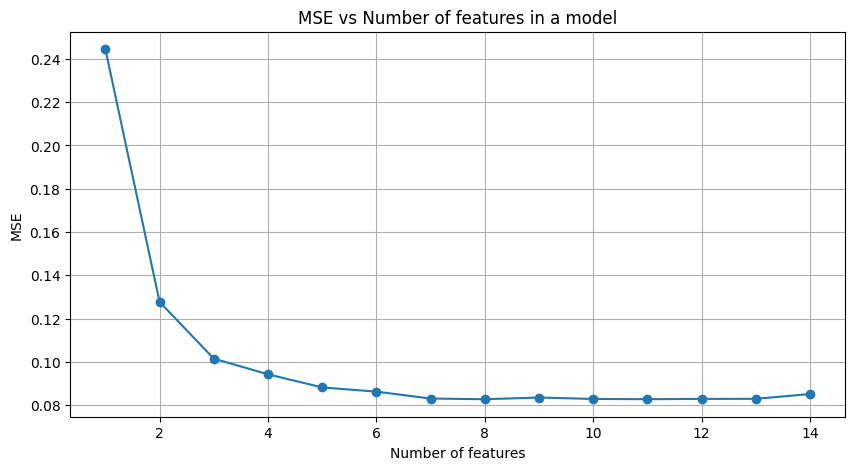

In [158]:
best_feature_subset_fs_europe_forest, errors_fs_europe_new_forest = find_best_subset_forward_stepwise_parallel(X_europe_new_train, y_europe_new_train, is_forest_reg=True)
elbow_plot(errors_fs_europe_new_forest)

Interestingly, despite the importance of the feature '**Freedom x (1-Corruption)**' for the multiple regression model, we can see that it was added last here. We can observe that **Log GDP per capita** has by far the greatest impact on the model in Europe, and the remaining features have mostly comparable, low impact on the model.
* The first 5 selected features turned out to be the same as those for the Random Forest model with the full dataset, so there is no need to reanalyze this subset.
* However, we can see that the sixth added feature was again '**GDP / mean GDP for year**', so we can compare how it affects the model.

In [159]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_5_forest_europe_new = ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect', 'GDP / mean GDP for year']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_europe_new_train.loc[:, best_5_forest_europe_new], y_europe_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_europe_new_train.loc[:, best_5_forest_europe_new], y_europe_new_train, X_europe_new_test.loc[:, best_5_forest_europe_new], y_europe_new_test, additional_title=' Europe, Random Forest, new features, best 6 features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.8235
Column 'Freedom to make life choices': 0.0684
Column 'Perceptions of corruption': 0.0302
Column 'Negative affect': 0.0284
Column 'Healthy life expectancy at birth': 0.0272
Column 'GDP / mean GDP for year': 0.0222

Mean depth of trees: 13.0


Results on train set Europe, Random Forest, new features, best 6 features
MSE: 0.01143
R2: 0.9864

Results on test set Europe, Random Forest, new features, best 6 features
MSE: 0.09049
R2: 0.88831


Adding another feature did not drastically change the $R^{2}$. It also has the smallest impact, so it may turn out that adding it is unnecessary. The remaining feature hierarchy has not changed and is the same as in the model based on the original 5 features.  
We will compare the results with boosting.

In [160]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_europe_new_train.loc[:, :], y_europe_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_europe_new_train.loc[:, :], y_europe_new_train, X_europe_new_test.loc[:, :], y_europe_new_test, additional_title=' Europe, XGBoost, new features', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.2
Feature importances:
Column 'Log GDP per capita': 0.7224
Column 'Freedom x (1-Corruption)': 0.0496
Column 'Freedom to make life choices': 0.0489
Column 'GDP / mean GDP for year': 0.031
Column 'Positive affect': 0.0278
Column 'Positive / Negative': 0.0236
Column 'Healthy life expectancy at birth': 0.023
Column 'Perceptions of corruption': 0.0154
Column 'Generosity': 0.0153
Column 'Social support': 0.0143
Column 'Negative affect': 0.0138
Column 'Generosity x Social support': 0.0097
Column 'year': 0.0054
Column 'Healthy square': 0.0


Results on train set Europe, XGBoost, new features
MSE: 0.00045
R2: 0.99947

Results on test set Europe, XGBoost, new features
MSE: 0.08625
R2: 0.89354


Expanding the model with 5 features slightly increased the $R^{2}$ on the test set. We can also see that the boosting algorithm was reluctant to use the **Healthy square** variable, with an importance of 0. The algorithm paid more attention to '**Freedom x (1-Corruption)**', which has the second-highest importance, similar to **Freedom to make life choices**. We also see that the new variable related to **GDP** is high in the hierarchy. Despite this, the impact of these variables is not large. The remaining variables have even lower impact. Let’s check which features the forward stepwise algorithm will suggest.

Best model for 1 features with MSE: 0.2155 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.1374 is: ['Log GDP per capita', 'Freedom to make life choices'].
Best model for 3 features with MSE: 0.1108 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE: 0.0983 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption'].
Best model for 5 features with MSE: 0.0857 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 6 features with MSE: 0.0835 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect', 'Positive / Negative'].
Best model for 7 features with MSE: 0.0819 is: ['Log GDP per capita', 'Freedom to make life choices', 'Healthy life expect

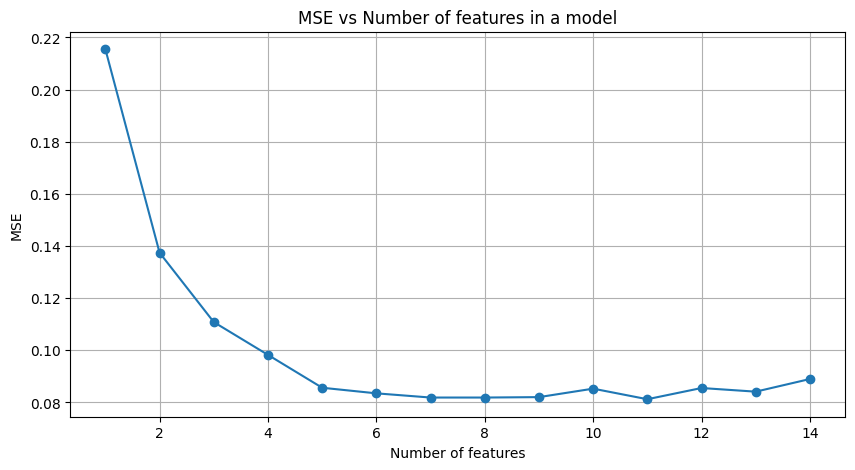

In [161]:
best_feature_subset_fs_xgboost_europe_new, errors_fs_xgboost_europe_new = find_best_subset_forward_stepwise_parallel(X_europe_new_train, y_europe_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_europe_new)

The plot suggests that a good choice would once again be 5 features, but we can see that these are once again the same features as in the original 5-feature model. Therefore, in further analysis, we will use a model consisting of 6 features, adding **Positive / Negative**.  
Additionally, we can observe that, similar to the bagging algorithm, the last feature added was '**Freedom x (1-Corruption)**'. It may turn out that, on this continent, this combination does not provide much information.

In [162]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_6_europe_new = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect', 'Positive / Negative']

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_europe_new_train.loc[:, best_6_europe_new], y_europe_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_europe_new_train.loc[:, best_6_europe_new], y_europe_new_train, X_europe_new_test.loc[:, best_6_europe_new], y_europe_new_test, additional_title=' Europe, XGBoost, new features, 6 best features', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.2
Feature importances:
Column 'Log GDP per capita': 0.7696
Column 'Freedom to make life choices': 0.0762
Column 'Positive / Negative': 0.0486
Column 'Perceptions of corruption': 0.0453
Column 'Healthy life expectancy at birth': 0.0381
Column 'Negative affect': 0.0221


Results on train set Europe, XGBoost, new features, 6 best features
MSE: 0.0012
R2: 0.99857

Results on test set Europe, XGBoost, new features, 6 best features
MSE: 0.09027
R2: 0.88858


We can see a significant improvement in the algorithm’s results, with an increase of 0.02 compared to the model based on 5 features. Additionally, we can observe that the **emotion ratio** has become the third most important feature in this model, reducing the impact of **Negative affect**.

In summary, the interpretation of happiness in Europe did not change significantly after creating the new features. The bagging and boosting algorithms still prioritized the most important original features, with **Log GDP per capita** remaining the dominant feature. The boosting algorithm merely suggested that for Europeans, the ratio of positive to negative emotions is more important than the level of negative emotions.  
The multiple regression model suggested that the feature '**Freedom x (1-Corruption)**' might be highly relevant for Europeans. However, we saw that these assumptions were not confirmed when using more precise models. Happiness in Europe is still very well described by the core features.


## Africa
After considering the situation on the European continent, let’s take a look at how happiness is defined in Africa. Exploratory analysis suggested that it may not be as easily defined as on other continents. Let’s start by normalizing the dataset and splitting the set. Then, we will train a multiple regression model on all the features.


In [163]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_africa_x = df_africa.loc[:, x_number_columns]
y_africa = df_africa.loc[:, y_column]

scaler = MinMaxScaler()
df_africa_x = pd.DataFrame(scaler.fit_transform(df_africa_x), columns=df_africa_x.columns, index=df_africa_x.index)

X_africa_train, X_africa_test, y_africa_train, y_africa_test = train_test_split(df_africa_x, y_africa, test_size=0.2, random_state=3)

model = LinearRegression()
train_and_evaluate_model(model, X_africa_train.loc[:, :], y_africa_train, X_africa_test.loc[:, :], y_africa_test, additional_title=' for Africa')

Feature weights:
Column 'Log GDP per capita': 0.9508
Column 'Positive affect': 0.7484
Column 'Healthy life expectancy at birth': 0.7413
Column 'Social support': 0.618
Column 'Negative affect': 0.4128
Column 'Freedom to make life choices': 0.3799
Column 'Generosity': 0.2312
Column 'Perceptions of corruption': 0.1872
Column 'year': -0.1221


Results on train set for Africa
MSE: 0.3136
R2: 0.30319

Results on test set for Africa
MSE: 0.29012
R2: 0.13288


Analyzing the results, we can observe that happiness in Africa is not well described by the features included in the dataset, with a very low $R^{2}$ on the test set. Analyzing the model weights, we can hypothesize the following:

* Similar to the global model, **Log GDP per capita** has the greatest impact on the model.
* **Positive affect** and **Healthy life expectancy at birth** have a similar impact. This aligns with the trend observed for the entire world. Compared to Europe, we can see that **Healthy life expectancy at birth** is one of the more significant features, while **Perceptions of corruption** is the second least important feature. In Europe, low perceptions of corruption were very important, and healthy life expectancy had slightly less impact. This makes sense, as in Africa, we more often observe lower values for **Healthy life expectancy at birth**, so a high value of this indicator may be an important factor for happiness.
* The lack of representativeness of this model seems to be confirmed by the fact that two negative features (**Negative affect** and **Perceptions of corruption**) have positive coefficients in the weights. This suggests that in Africa, the higher the **Perceptions of corruption** and the level of **Negative affect**, the happier people are. From a European perspective, this seems absurd, and looking at the metric results, it might indeed be the case.

However, we cannot confidently conclude many things about happiness in this part of the world due to the poor predictive ability of this model. Let’s check how the model performs after applying regularization methods.

Best value of alpha: 1.5685151643735447


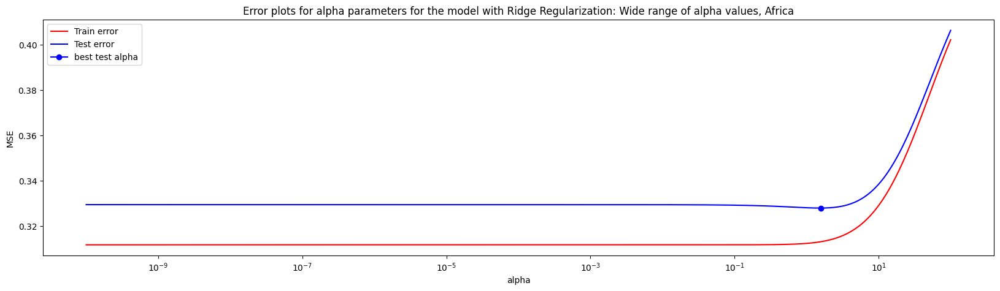

In [164]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_africa_train.loc[:, :], y_africa_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Africa')

For Africa, we are able to observe a slightly deeper valley, where the value of the alpha parameter minimizes the MSE.

In [165]:
alpha_values = np.logspace(0, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_africa_train.loc[:, :], y_africa_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_africa_train, y_africa_train, X_africa_test, y_africa_test, additional_title=' Africa with Ridge Regularization:')

Best value of alpha: 1.5282140360258698
Feature weights:
Column 'Log GDP per capita': 0.9071
Column 'Healthy life expectancy at birth': 0.6471
Column 'Positive affect': 0.6467
Column 'Social support': 0.5768
Column 'Freedom to make life choices': 0.3475
Column 'Negative affect': 0.3076
Column 'Generosity': 0.194
Column 'Perceptions of corruption': 0.1587
Column 'year': -0.0472


Results on train set Africa with Ridge Regularization:
MSE: 0.31445
R2: 0.3013

Results on test set Africa with Ridge Regularization:
MSE: 0.28765
R2: 0.14026


L2 regularization was able to increase the $R^{2}$ metric on the test set by nearly 0.008. However, the model's generalization ability is still unacceptable. There were minor changes in the ranking of the weights sorted in descending order based on their absolute values: **Healthy life expectancy at birth** overtook **Positive affect**, and **Freedom to make life choices** overtook **Negative affect**. Let’s compare these results with L1 regularization.

Best value of alpha: 0.0021794447537529836


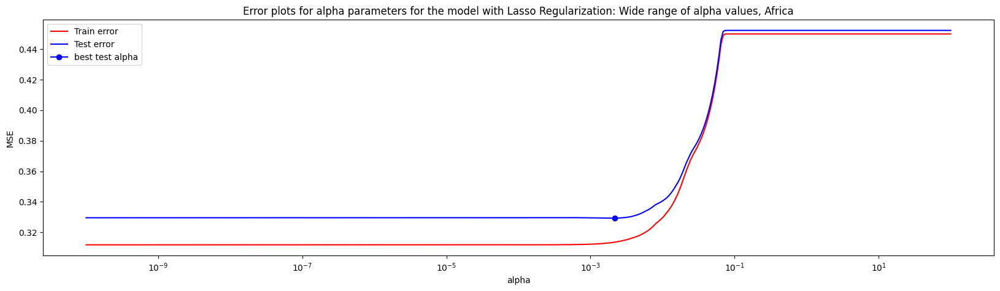

In [166]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_africa_train.loc[:, :], y_africa_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Africa')

In [167]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_africa_train.loc[:, :], y_africa_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_africa_train.loc[:, :], y_africa_train, X_africa_test.loc[:, :], y_africa_test, additional_title=' Africa with Lasso Regularization:')

Best value of alpha: 0.0021544346900318843
Feature weights:
Column 'Log GDP per capita': 0.9488
Column 'Positive affect': 0.6587
Column 'Healthy life expectancy at birth': 0.5806
Column 'Social support': 0.5475
Column 'Freedom to make life choices': 0.276
Column 'Negative affect': 0.2603
Column 'Generosity': 0.1545
Column 'Perceptions of corruption': 0.0476
Column 'year': -0.0


Results on train set Africa with Lasso Regularization:
MSE: 0.31546
R2: 0.29907

Results on test set Africa with Lasso Regularization:
MSE: 0.28962
R2: 0.13435


Once again, Lasso regularization achieved a better result than the model without regularization, but worse than Ridge regularization. In this case, we can observe that the **year** feature was zeroed out, and the Lasso regularized model considered it unnecessary, selecting the remaining 8 features. Let’s compare these results with the random forest regressor.

In [168]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_africa_train, y_africa_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_africa_train, y_africa_train, X_africa_test, y_africa_test, additional_title=' Random Forest, Africa', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.3903
Column 'Healthy life expectancy at birth': 0.0966
Column 'Social support': 0.092
Column 'Negative affect': 0.0908
Column 'Positive affect': 0.0845
Column 'Freedom to make life choices': 0.0808
Column 'Perceptions of corruption': 0.0696
Column 'Generosity': 0.0527
Column 'year': 0.0427

Mean depth of trees: 13.0


Results on train set Random Forest, Africa
MSE: 0.03676
R2: 0.91832

Results on test set Random Forest, Africa
MSE: 0.17639
R2: 0.4728


Using the random forest regressor, we can observe a huge increase in the $R^{2}$ metric. The regressor was able to fit the training data very well, achieving a metric value of nearly 0.92. At the same time, with such a decrease in the model's burden, there was a significant improvement in generalization ability. Although the results still wouldn’t allow for reliable conclusions about happiness, the metric increase of 0.33 is a pleasantly surprising outcome.  

The trees used don't need to be very deep compared to others, with a maximum depth of 13 being sufficient in this case.  

The most important feature, as in the multiple regression model, is **Log GDP per capita**. However, we can notice that its importance in Africa is much smaller than in Europe and worldwide. In this model, its importance is 'only' 39%. The rest of the importance is distributed fairly evenly across all features, with 5 of them achieving an importance above 8%. The least important were **year** and **Generosity**.  

Let’s check how XGBoost performs on this task.


In [169]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_africa_train, y_africa_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_africa_train, y_africa_train, X_africa_test, y_africa_test, additional_title=' XGBoost, Africa', is_xgboost=True)

Best value of max_depth: 6
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.3132
Column 'Healthy life expectancy at birth': 0.1155
Column 'Positive affect': 0.1098
Column 'Negative affect': 0.0973
Column 'Social support': 0.0922
Column 'Freedom to make life choices': 0.0917
Column 'Generosity': 0.0809
Column 'Perceptions of corruption': 0.0623
Column 'year': 0.0371


Results on train set XGBoost, Africa
MSE: 0.00314
R2: 0.99301

Results on test set XGBoost, Africa
MSE: 0.16153
R2: 0.51721


Boosting was able to significantly minimize **bias**. Compared to the multiple regression model, it also greatly improved the **generalization ability**. In relation to the **random forest**, the $R^{2}$ measure increased by 0.04. Once again, it achieved this with smaller tree sizes.  

* The two **most important features** remained the same as in **RandomForest**. The most important one is **Log GDP per capita**, followed by **Healthy life expectancy at birth**.  
* The importance of **Social support** decreased in relation to **Positive affect** and **Negative affect**. However, these features have relatively similar importance.  
* The features **Negative affect**, **Social support**, and **Freedom to make life choices** have very similar importance.  
* The importance of **Perceptions of corruption** decreased in favor of **Generosity**.  

The above features seem to confirm that **happiness in Africa** is more complex and may be described by factors not included in the dataset. Importantly, in this part of the world, many features have a similar impact at around **9%**.  

We can apply **feature selection algorithms** to determine which features can be excluded without significantly degrading the model.

In [170]:
lasso_feature_selection(X_africa_train, y_africa_train)

Alpha: 0.0018 - Excluded: year
Alpha: 0.0029 - Excluded: Perceptions of corruption
Alpha: 0.0062 - Excluded: Generosity
Alpha: 0.0081 - Excluded: Negative affect
Alpha: 0.0129 - Excluded: Freedom to make life choices
Alpha: 0.0205 - Excluded: Healthy life expectancy at birth
Alpha: 0.0235 - Excluded: Positive affect
Alpha: 0.0283 - Excluded: Social support
Alpha: 0.0683 - Excluded: Log GDP per capita

All features have been excluded.


The first three **zeroed-out features** are **year**, **Generosity**, and **Perceptions of corruption**. This aligns with expectations, as in Africa, **perception of corruption** is not a significant factor in describing **happiness**.  

The most important feature is **Log GDP per capita**. Other significant features include **Social support**, **Positive affect**, and **Healthy life expectancy at birth**.  

We will compare this with other algorithms.

In [171]:
best_subset_f_stepwise_africa, errors_fs_africa = find_best_subset_forward_stepwise(X_africa_train, y_africa_train)

Best model for 1 features with MSE:  0.3605 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3427 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.3346 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE:  0.3297 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support'].
Best model for 5 features with MSE:  0.3254 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect'].
Best model for 6 features with MSE:  0.3254 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect', 'Freedom to make life choices'].
Best model for 7 features with MSE:  0.3256 is: ['Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Social support', 'Negative affect', 'Freedom to make life choices', 'Perceptio

The first **five features** were excluded in a similar order as in the previous algorithm, with both recognizing them as the **least important**.  

According to **Forward stepwise**, we can see that **Social support** is less important than **Positive affect** and **Healthy life expectancy at birth**.  

We can compare this with an algorithm that explores **all possible combinations**.


Best model for 1 features with MSE:  0.3605 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3427 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.3346 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 4 features with MSE:  0.3297 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 5 features with MSE:  0.3254 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.3254 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.3256 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect', 

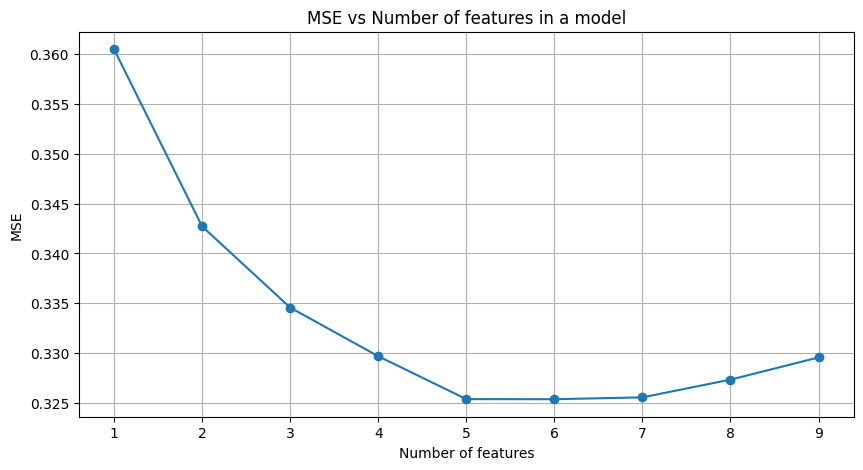

In [172]:
best_subset_par_africa, errors_par_africa = find_best_feature_subset_parallel(X_africa_train, y_africa_train)
elbow_plot(errors_par_africa)

Also in the case of **Africa**, we can observe that this and the previous algorithm arrived at the same conclusion. According to them, the **best feature set** contains **six** features:  
['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect'].  

This feature selection aligns with the **features ranked by importance** in the **multiple regression model** and **random forest**.  

On the **elbow plot**, we can see that after adding the **seventh feature**, **MSE** increases significantly, and for **nine features**, it reaches values similar to those for **four features**. However, it is important to note that the **scale** of the y-axis is much smaller, meaning that the actual differences are not as large.  

Despite a **slightly lower error** for **six features**, the elbow plot indicates that **increasing the model size from five to six features is not worthwhile**, as the difference is negligible.  

We will now test how models perform with the **five best features**. From the above set, we will exclude **Freedom to make life choices**, as it introduces only a minimal difference in **MSE**.


In [173]:
best_5_africa = ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect']

model = LinearRegression()
train_and_evaluate_model(model, X_africa_train.loc[:, best_5_africa], y_africa_train, X_africa_test.loc[:, best_5_africa], y_africa_test, additional_title=' for Africa, best 5 features')

Feature weights:
Column 'Positive affect': 0.9229
Column 'Log GDP per capita': 0.9196
Column 'Healthy life expectancy at birth': 0.6614
Column 'Social support': 0.5799
Column 'Negative affect': 0.3829


Results on train set for Africa, best 5 features
MSE: 0.31876
R2: 0.29173

Results on test set for Africa, best 5 features
MSE: 0.30098
R2: 0.10042


We observe that **removing four features** caused a **drop** in the $R^{2}$ metric, despite cross-validation indicating that for **Africa**, models with a **large number of features** have a **lower generalization ability**.  

This could be due to an **unfortunate train-test split**, which is especially likely given the **small and less representative subset** that Africa constitutes.  

A striking result is that after **reducing the model dimensions**, **Positive affect** and **Log GDP per capita** became **comparably important**, with **Positive affect** even surpassing **Log GDP per capita** in terms of weight value.  

Let's examine how **regularization** will impact these results.


Best value of alpha: 0.7322538337604526


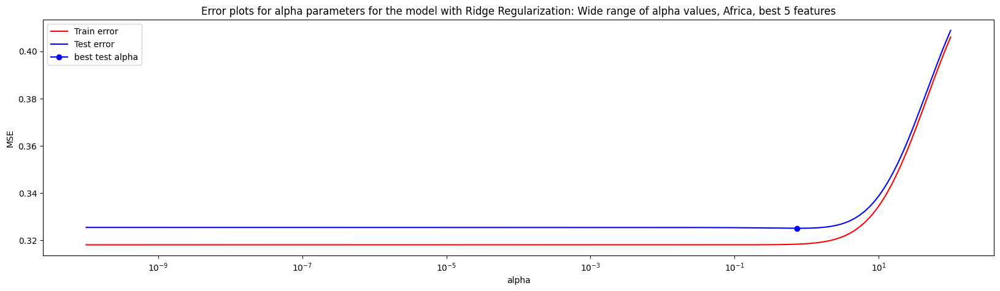

In [174]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_africa_train.loc[:, best_5_africa], y_africa_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Africa, best 5 features')

In [175]:
alpha_values = np.logspace(-1, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_africa_train.loc[:, best_5_africa], y_africa_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_africa_train.loc[:, best_5_africa], y_africa_train, X_africa_test.loc[:, best_5_africa], y_africa_test, additional_title=' Africa with Ridge Regularization, 5 best features:')

Best value of alpha: 0.7566218500481054
Feature weights:
Column 'Log GDP per capita': 0.9015
Column 'Positive affect': 0.8593
Column 'Healthy life expectancy at birth': 0.6367
Column 'Social support': 0.5595
Column 'Negative affect': 0.3456


Results on train set Africa with Ridge Regularization, 5 best features:
MSE: 0.31895
R2: 0.29132

Results on test set Africa with Ridge Regularization, 5 best features:
MSE: 0.29719
R2: 0.11175


Once again, we can see that **L2 regularization** is able to **slightly improve** our results. In this case, the results improved by **0.01**, and **Log GDP per capita** regained its position as the **most important feature**.  

For comparison, we will now test **L1 regularization**.

Best value of alpha: 0.0004749979434661403


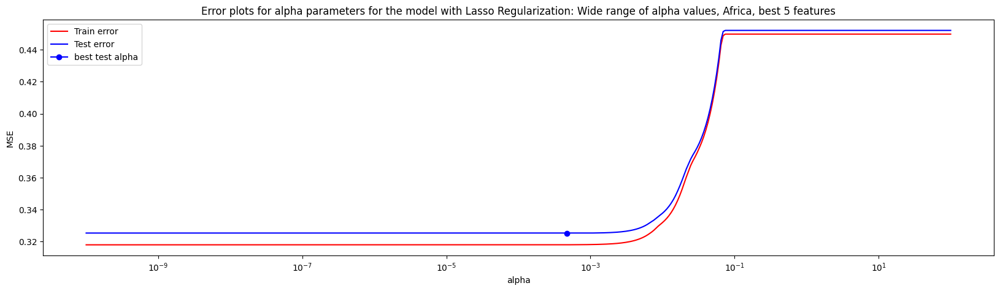

In [176]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_africa_train.loc[:, best_5_africa], y_africa_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Africa, best 5 features')

In [177]:
alpha_values = np.logspace(-4, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_africa_train.loc[:, best_5_africa], y_africa_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_africa_train.loc[:, best_5_africa], y_africa_train, X_africa_test.loc[:, best_5_africa], y_africa_test, additional_title=' Africa with Lasso Regularization for 5 best features:')

Best value of alpha: 0.00047062248498412813
Feature weights:
Column 'Log GDP per capita': 0.9199
Column 'Positive affect': 0.8996
Column 'Healthy life expectancy at birth': 0.6472
Column 'Social support': 0.5629
Column 'Negative affect': 0.3614


Results on train set Africa with Lasso Regularization for 5 best features:
MSE: 0.3188
R2: 0.29165

Results on test set Africa with Lasso Regularization for 5 best features:
MSE: 0.29951
R2: 0.1048


**Lasso regularization** performed similarly to **Ridge regularization**, but it improved the results **slightly less**.  

Here too, we observe that **Log GDP per capita** remains the **most important feature**.  

Next, we will examine which features are selected when using the **RandomForestRegressor** algorithm.


Best model for 1 features with MSE:  0.4587 is: ['year'].
Best model for 2 features with MSE:  0.3264 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.2832 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.2619 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect'].
Best model for 5 features with MSE:  0.2482 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.2453 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.244 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices

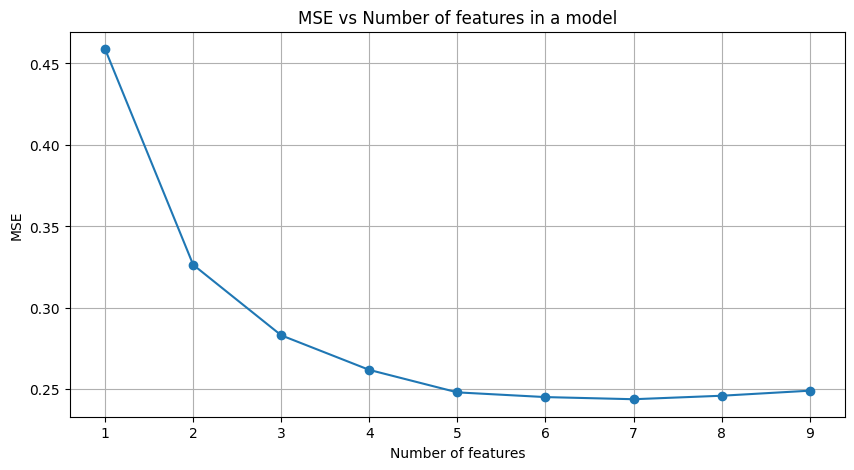

In [178]:
best_subset_par_africa_forest, errors_par_africa_forest = find_best_feature_subset_parallel(X_africa_train, y_africa_train, is_forest_reg=True)
elbow_plot(errors_par_africa_forest)

The algorithm selected **7 features** as the optimal number to minimize **mean squared error (MSE)**. However, similar to previous models, **MSE values do not decrease significantly below 4-5 features**.  

The first features to be **excluded** were **Generosity** and **Perceptions of corruption**. Interestingly, the first feature **included** by the algorithm was **year**, whereas in **multiple regression**, it was one of the last to be added. According to the algorithm, **year** as a **single feature** minimized **MSE** the most. However, it was later **removed** and then **reintroduced** as the **seventh feature**.  

A **good subset** that balances **model size** and **MSE** consists of:  
['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect'].  

We will evaluate **RandomForest metrics** on this subset. Compared to the **full RandomForest model**, **Freedom to make life choices** replaced **Social support**. Since these features had a **similar impact** in the full model, such minor shifts are not unexpected.

In [179]:
best_5_africa_forest = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect', 'Negative affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_africa_train.loc[:, best_5_africa_forest], y_africa_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_africa_train.loc[:, best_5_africa_forest], y_africa_train, X_africa_test.loc[:, best_5_africa_forest], y_africa_test, additional_title=' Random Forest, Africa, Best 5 features', is_forest_reg=True)

Best value of max_depth: 19
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.4367
Column 'Negative affect': 0.15
Column 'Healthy life expectancy at birth': 0.1456
Column 'Positive affect': 0.1404
Column 'Freedom to make life choices': 0.1273

Mean depth of trees: 18.38


Results on train set Random Forest, Africa, Best 5 features
MSE: 0.03303
R2: 0.92661

Results on test set Random Forest, Africa, Best 5 features
MSE: 0.20439
R2: 0.38912


Unfortunately, **removing four features** worsened the **bagging evaluation results** by approximately **0.08** in terms of $R^{2}$.  

* **Log GDP per capita** remains the **most important feature**, with a significance of **43%**.  
* **Negative affect**, **Healthy life expectancy at birth**, and **Positive affect** have similar importance, around **14-15%**. However, we can see that **African residents value a low perception of negative emotions more than a high perception of positive emotions**.  
* **Freedom to make life choices** was the **third feature added**, but it turned out to be **less significant** than the others.  
* **Healthy life expectancy at birth** remains **important** for African residents, which makes sense given its **high variability** across the continent.  

We will now compare these results with **boosting**.

Best model for 1 features with MSE:  0.3939 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3326 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.2917 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.2595 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 5 features with MSE:  0.258 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity'].
Best model for 6 features with MSE:  0.25 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.2502 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Pos

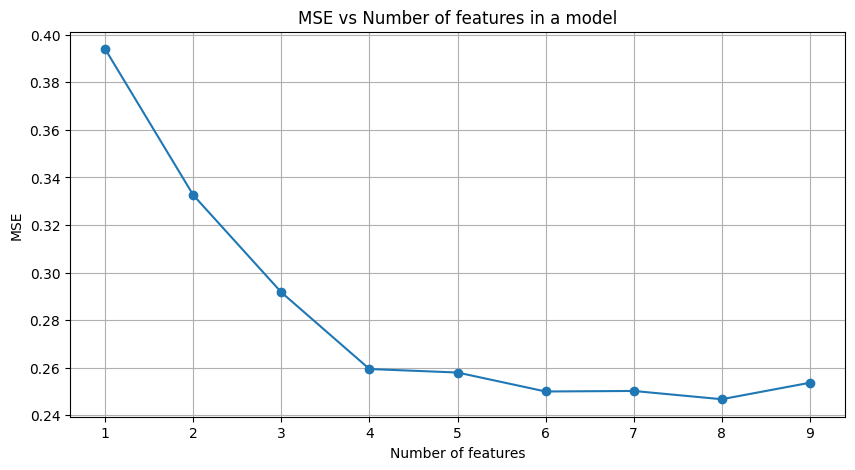

In [180]:
best_subset_par_africa_xgb, errors_par_africa_xgb = find_best_feature_subset_parallel(X_africa_train, y_africa_train, is_xgboost=True)
elbow_plot(errors_par_africa_xgb)

The algorithm determined that **8 features** minimize the **mean squared error (MSE)**. However, we observe that **MSE decreases significantly up to 4 features**, after which adding more information does not meaningfully reduce the error.  

The order in which features are selected seems **inconsistent**. **Perceptions of corruption** is particularly interesting—it is **not included** in the "best" **8-feature set**, yet it appears in the **4-feature set**, where it causes a **significant drop in MSE**.  

One clear observation is that **Log GDP per capita** and **Healthy life expectancy at birth** are **very important** in Africa. However, the inclusion of **Perceptions of corruption** in this selection contradicts some of our **previous conclusions**.

In [181]:
best_4_africa_xgb = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_africa_train.loc[:, best_4_africa_xgb], y_africa_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_africa_train.loc[:, best_4_africa_xgb], y_africa_train, X_africa_test.loc[:, best_4_africa_xgb], y_africa_test, additional_title=' XGBoost, Africa best 4 features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.3651
Column 'Negative affect': 0.245
Column 'Healthy life expectancy at birth': 0.196
Column 'Perceptions of corruption': 0.1939


Results on train set XGBoost, Africa best 4 features
MSE: 0.00561
R2: 0.98753

Results on test set XGBoost, Africa best 4 features
MSE: 0.19392
R2: 0.42039


The **generalization ability** dropped significantly after **removing five features**.  

* **Log GDP per capita** remains the **most important feature**, even in Africa, but its dominance is **less pronounced**, with an importance of **only 36%**.  
* The remaining features are also **very important** in this model, each exceeding **19% importance**.  
* **Negative affect** is the **most important** of the remaining features. A **low perception of negative emotions** may be particularly relevant in Africa.  
* **Healthy life expectancy at birth** remains **significant**.  
* Surprisingly, **Perceptions of corruption** has **high importance**, even though it was previously **negligible** in other models.  

#### Summary of Feature Influence on Life Ladder in Africa  

Based on the gathered insights, we can summarize the influence of different features on **Life Ladder in Africa** as follows:  

* Similar to **global** and **European** trends, **Log GDP per capita** is a **key factor in happiness**. Wealthier countries can **offer better opportunities, living conditions, and conveniences**, all of which contribute to happiness.  
* The most **accurate model** suggests that **Healthy life expectancy at birth** has a **strong impact** on the target variable. Given the **high variability** of this feature in Africa, it is highly valued. Countries where **healthy life expectancy is longer** tend to be **happier**.  
* **Emotional perception levels** also impact the target variable, but it is **unclear which emotions dominate** in influence.  
* Many other features also contribute to the target variable, as shown by the **drop in performance metrics** when they are removed. Apart from the **last boosting model**, **Perceptions of corruption** generally had **a minimal impact**.  
* **Year** continues to be the **least influential** feature.  

The gathered findings suggest that **happiness perception in Africa** is **far more complex** than in **Europe or globally**. While **Log GDP per capita** remains the **most crucial** factor, its **importance is lower** compared to other regions. In this **restricted framework**, **other features** have a **more balanced influence** on the target variable.  

Significant differences between regression algorithms regarding **feature selection using exhaustive search vs. cross-validation** support the idea that **happiness perception in Africa is not a straightforward problem**. Given the evaluation metrics, it is possible that **no single best subset of features** can fully describe the issue—or even that **too few relevant features are available**.  

Furthermore, considering **metric values**, we can see that **happiness in Africa** is likely influenced by **factors not included in the dataset**. For people living in this region, elements such as **access to clean drinking water, absence of regional conflicts**, or other factors that may seem **obvious elsewhere** could be **critical determinants of happiness**.  

### Africa – Feature Engineering  

As before, we will examine whether newly added features **help explain** the **happiness problem** on this continent. The newly added features are:  
**'Freedom x (1-Corruption)', 'GDP / mean GDP for year', 'Positive / Negative', 'Generosity x Social support', and 'Healthy square'.**

In [182]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_africa_new = df_africa.loc[:, x_number_columns]
y_africa_new = df_africa.loc[:, y_column]

mean_gdp_per_year_africa = df_africa_new.groupby('year')["Log GDP per capita"].transform('mean')
df_africa_new["GDP / mean GDP for year"] = df_africa_new["Log GDP per capita"] / mean_gdp_per_year_africa


df_africa_new['Freedom x (1-Corruption)'] = df_africa_new['Freedom to make life choices'] * (1 - df_africa_new['Perceptions of corruption'])
df_africa_new['Positive / Negative'] = df_africa_new['Positive affect'] / df_africa_new['Negative affect']
df_africa_new['Healthy square'] = np.pow(df_africa_new['Healthy life expectancy at birth'], 2)

df_africa_new['Generosity_shifted'] = df_africa_new['Generosity'] - df_africa_new['Generosity'].min()
df_africa_new['Generosity x Social support'] = df_africa_new['Generosity_shifted'] * df_africa_new['Social support']
df_africa_new = df_africa_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_africa_new = pd.DataFrame(scaler.fit_transform(df_africa_new), columns=df_africa_new.columns, index=df_africa_new.index)

df_africa_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
31,0.277778,0.715386,0.894132,0.940075,0.409578,0.073710,0.570555,0.152668,0.331923,0.757066,0.281382,0.156075,0.926083,0.094073
32,0.333333,0.717931,0.767965,0.943820,0.310222,0.108769,0.595322,0.297030,0.358145,0.760969,0.235780,0.191447,0.930651,0.128692
33,0.388889,0.721643,0.825687,0.947565,0.400085,0.120876,0.660066,0.378487,0.296141,0.722881,0.222743,0.263921,0.935225,0.148164
34,0.500000,0.728389,0.783711,0.955056,0.273472,0.132310,0.676232,0.418428,0.166007,0.764662,0.181291,0.418176,0.944395,0.158082
35,0.611111,0.735783,0.645948,0.962547,0.262345,0.162720,0.716423,0.432978,0.659081,0.758651,0.157287,0.100725,0.953593,0.177877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2358,0.777778,0.289033,0.666877,0.475655,0.471287,0.303074,0.834591,0.636843,0.310025,0.283053,0.124395,0.349403,0.413710,0.335985
2359,0.833333,0.262076,0.583905,0.493446,0.489220,0.379407,0.782273,0.641697,0.581823,0.212312,0.162574,0.179687,0.431363,0.397382
2360,0.888889,0.278198,0.520384,0.511236,0.527514,0.263101,0.743058,0.530955,0.325606,0.255283,0.197066,0.296964,0.449174,0.263235
2361,0.944444,0.281696,0.482819,0.529026,0.502887,0.271728,0.737702,0.597941,0.201672,0.276293,0.195762,0.454707,0.467143,0.264337


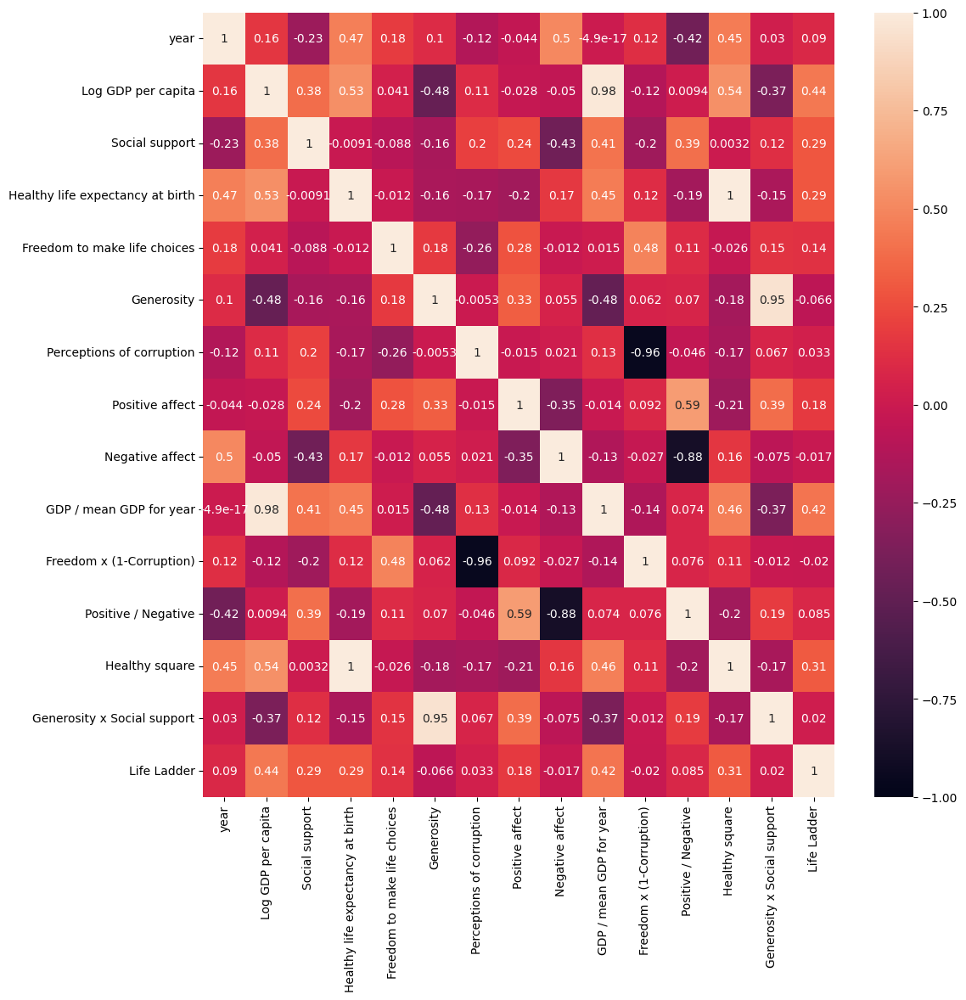

In [183]:
plt.figure(figsize=(12,12))
df_africa_new_with_y = pd.concat([df_africa_new, y_africa_new], axis=1)
sns.heatmap(df_africa_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* None of the **new features** exhibit **high correlation** with the target variable. **GDP / mean GDP for year** has a **similar correlation** to **Log GDP per capita**, but slightly lower. Meanwhile, **Healthy square** shows a **slightly higher correlation** with the target compared to its **first-power counterpart**.  
* The feature **Generosity x Social support** has a **significantly lower correlation** with **Social support** than in **Europe**.  
* The remaining features lead to **similar conclusions** as before.  


In [184]:
X_africa_new_train, X_africa_new_test, y_africa_new_train, y_africa_new_test = train_test_split(df_africa_new, y_africa_new, test_size=0.2, random_state=3)

In [185]:
model = LinearRegression()
train_and_evaluate_model(model, X_africa_new_train.loc[:, :], y_africa_new_train, X_africa_new_test.loc[:, :], y_africa_new_test, additional_title=', Africa, new features')

Feature weights:
Column 'Healthy square': 10.8489
Column 'Healthy life expectancy at birth': -10.6599
Column 'Freedom x (1-Corruption)': -3.789
Column 'Perceptions of corruption': -2.9394
Column 'Log GDP per capita': 2.2882
Column 'Generosity x Social support': 1.8841
Column 'Generosity': -1.6146
Column 'GDP / mean GDP for year': -1.4524
Column 'Freedom to make life choices': 1.0959
Column 'Positive affect': 0.7758
Column 'Negative affect': 0.7576
Column 'Positive / Negative': 0.4928
Column 'year': -0.1959
Column 'Social support': 0.0671


Results on train set, Africa, new features
MSE: 0.29404
R2: 0.34666

Results on test set, Africa, new features
MSE: 0.25928
R2: 0.22504


Additional **model complexity** increased the **multiple regression model's** performance by **approximately 0.09** in terms of **$R^{2}$** on the **test set**.  

* As observed previously, there is a **compensating effect** between **Healthy life expectancy-related features** and **GDP-related features**.  
* Similarly, **Generosity x Social support** and **Generosity** have **opposite-signed coefficients**.  
* Interestingly, the **third most important feature** in the model is **'Freedom x (1-Corruption)'**, but it has a **negative coefficient**.  
* The **coefficients** on this continent are **higher** compared to previous cases, which might indicate that the model is **overfitting** the input data even more.  

We will now examine the effect of **regularization techniques** on these results.  


In [186]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_africa_new_train.loc[:, :], y_africa_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_africa_new_train.loc[:, :], y_africa_new_train, X_africa_new_test.loc[:, :], y_africa_new_test, additional_title=' Africa, new features with Ridge Regularization:')

Best value of alpha: 0.0021995930680300748
Feature weights:
Column 'Healthy square': 10.062
Column 'Healthy life expectancy at birth': -9.8355
Column 'Freedom x (1-Corruption)': -3.5734
Column 'Perceptions of corruption': -2.7622
Column 'Log GDP per capita': 2.2349
Column 'Generosity x Social support': 1.8163
Column 'Generosity': -1.5508
Column 'GDP / mean GDP for year': -1.3903
Column 'Freedom to make life choices': 1.0529
Column 'Positive affect': 0.7646
Column 'Negative affect': 0.7512
Column 'Positive / Negative': 0.4835
Column 'year': -0.1951
Column 'Social support': 0.0905


Results on train set Africa, new features with Ridge Regularization:
MSE: 0.29413
R2: 0.34647

Results on test set Africa, new features with Ridge Regularization:
MSE: 0.25947
R2: 0.22448


In [187]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_africa_new_train.loc[:, :], y_africa_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_africa_new_train.loc[:, :], y_africa_new_train, X_africa_new_test.loc[:, :], y_africa_new_test, additional_title=' Africa, new features with Lasso Regularization:')

Best value of alpha: 6.468607661546321e-06
Feature weights:
Column 'Healthy square': 10.7279
Column 'Healthy life expectancy at birth': -10.5314
Column 'Freedom x (1-Corruption)': -3.7288
Column 'Perceptions of corruption': -2.8886
Column 'Log GDP per capita': 2.2648
Column 'Generosity x Social support': 1.8517
Column 'Generosity': -1.5822
Column 'GDP / mean GDP for year': -1.4283
Column 'Freedom to make life choices': 1.0848
Column 'Positive affect': 0.7743
Column 'Negative affect': 0.7545
Column 'Positive / Negative': 0.4894
Column 'year': -0.1939
Column 'Social support': 0.076


Results on train set Africa, new features with Lasso Regularization:
MSE: 0.29404
R2: 0.34665

Results on test set Africa, new features with Lasso Regularization:
MSE: 0.25929
R2: 0.22502


None of the **regularization methods** were able to **improve the results** or **change the feature hierarchy**.  

We will now attempt to find a **satisfactory subset of features** for this model.  


Best model for 1 features with MSE: 0.3605 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.3427 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE: 0.3331 is: ['Log GDP per capita', 'Positive affect', 'Healthy square'].
Best model for 4 features with MSE: 0.3263 is: ['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth'].
Best model for 5 features with MSE: 0.3226 is: ['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth', 'Generosity x Social support'].
Best model for 6 features with MSE: 0.3217 is: ['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth', 'Generosity x Social support', 'Negative affect'].
Best model for 7 features with MSE: 0.3187 is: ['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth', 'Generosity x Social support', 'Negative affect', 'Generosity'].
Best model

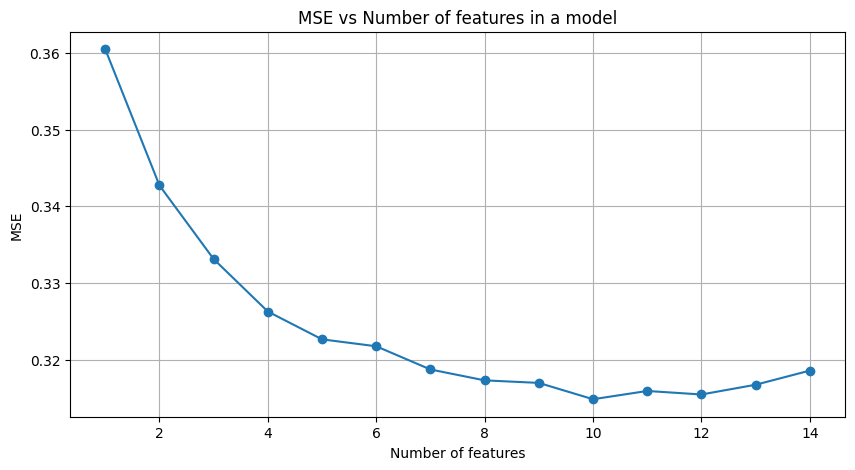

In [188]:
best_feature_subset_fs_africa_new, errors_fs_africa_new = find_best_subset_forward_stepwise_parallel(X_africa_new_train, y_africa_new_train)
elbow_plot(errors_fs_africa_new)

From the **scale of the plot**, we observe that **MSE does not change significantly**. Without considering the scale, one might assume that errors decrease considerably, but reviewing the results above, we can see that the **differences are minor**.  

For further analysis, we will select a **subset of 5 features**:  
**['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth', 'Generosity x Social support']**.  

Key observations:  
* The **newly added feature** capturing the **relationship between Generosity and Social support** is included.  
* **Both features from the Healthy group** were selected, likely indicating that in the **multiple regression model**, after including **Healthy square**, a **compensation effect** was needed.  
* The **other newly added features** did not have a significant impact.  


In [189]:
best_5_africa_new = ['Log GDP per capita', 'Positive affect', 'Healthy square', 'Healthy life expectancy at birth', 'Generosity x Social support']
model = LinearRegression()
train_and_evaluate_model(model, X_africa_new_train.loc[:, best_5_africa_new], y_africa_new_train, X_africa_new_test.loc[:, best_5_africa_new], y_africa_new_test, additional_title=', Africa new features, best 5')

Feature weights:
Column 'Healthy square': 8.4891
Column 'Healthy life expectancy at birth': -8.1903
Column 'Log GDP per capita': 1.1415
Column 'Positive affect': 0.8489
Column 'Generosity x Social support': 0.548


Results on train set, Africa new features, best 5
MSE: 0.31325
R2: 0.30397

Results on test set, Africa new features, best 5
MSE: 0.28236
R2: 0.15606


The **metric value has decreased**, but it **remains higher** than that of the model consisting of **five original features**.  

Key observations:  
* **Healthy-related features** are the most important, but **they compensate for each other’s high values**.  
* Because of this compensation effect, they **surpassed Log GDP per capita and Positive affect** in importance.  
* This suggests a **nonlinear relationship between health and happiness** in Africa.  
* The **new feature Generosity x Social support** replaced **Social support**, which was part of the original model.  
* Unlike the original model, **Negative affect was not included** in the selected feature set.  

Next, we will compare these results with the **Random Forest Regressor**.  

In [190]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_africa_new_train.loc[:, :], y_africa_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_africa_new_train.loc[:, :], y_africa_new_train, X_africa_new_test.loc[:, :], y_africa_new_test, additional_title=' Africa, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 22
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.3124
Column 'GDP / mean GDP for year': 0.1108
Column 'Social support': 0.0708
Column 'Freedom to make life choices': 0.0639
Column 'Positive affect': 0.0622
Column 'Negative affect': 0.0577
Column 'Healthy life expectancy at birth': 0.0486
Column 'Perceptions of corruption': 0.0475
Column 'Positive / Negative': 0.0472
Column 'Healthy square': 0.0411
Column 'Generosity x Social support': 0.0385
Column 'Freedom x (1-Corruption)': 0.0344
Column 'Generosity': 0.0338
Column 'year': 0.0313

Mean depth of trees: 19.23


Results on train set Africa, Random Forest, new features
MSE: 0.03253
R2: 0.92773

Results on test set Africa, Random Forest, new features
MSE: 0.17441
R2: 0.4787


The **test set metric value did not change significantly** after adding new features.  

Key observations:  
* **Average tree depth increased by 6 levels**, indicating **potential overfitting** to the training data.  
* **4 out of 5 new features ranked in the lower half** of feature importance, surpassing only **year and Generosity** with an impact of **3-5%**.  
* Interestingly, while **Log GDP per capita remains the most important feature**, **GDP / mean GDP for year** ranked **second**, suggesting it adds useful information.  
* **Freedom to make life choices gained influence**, surpassing **emotional perception levels** in the ranking.  

Next, we will select a **satisfactory subset of features** for further analysis.  


Best model for 1 features with MSE: 0.425 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.3327 is: ['GDP / mean GDP for year', 'Healthy square'].
Best model for 3 features with MSE: 0.2821 is: ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices'].
Best model for 4 features with MSE: 0.2632 is: ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support'].
Best model for 5 features with MSE: 0.2505 is: ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support', 'Positive / Negative'].
Best model for 6 features with MSE: 0.251 is: ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support', 'Positive / Negative', 'Freedom x (1-Corruption)'].
Best model for 7 features with MSE: 0.2512 is: ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support', 'Posi

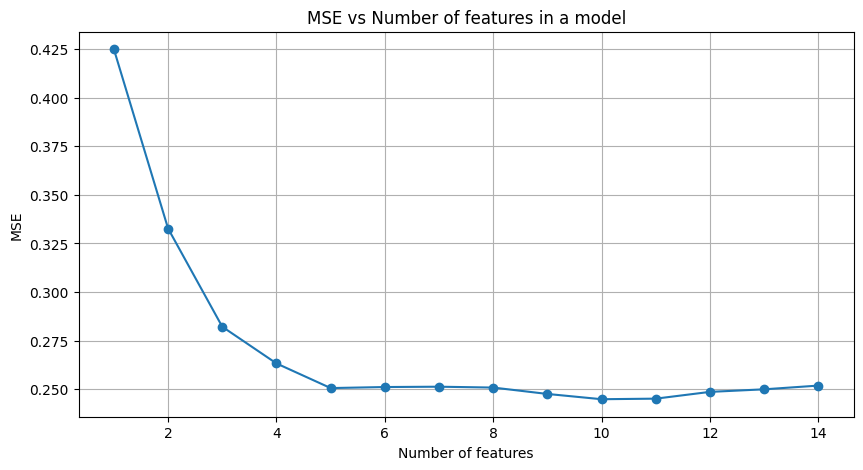

In [191]:
best_feature_subset_fs_africa_new_forest, errors_fs_africa_new_forest = find_best_subset_forward_stepwise_parallel(X_africa_new_train, y_africa_new_train, is_forest_reg=True)
elbow_plot(errors_fs_africa_new_forest)

Based on the plot, we can determine that MSE decreases until reaching 5 features, and with the addition of more features, it starts to fluctuate. The selected subset of 5 features is **['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support', 'Positive / Negative']**.  

Surprisingly, **4 out of these 5 features are newly added**. The only feature that did not make it into this selection was **'Freedom x (1-Corruption)'**, which was replaced by **Freedom to make life choices**. However, we can see that the algorithm selected it as the sixth feature.  

Next, we will evaluate how the model performs with these 5 features.  

In [192]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_5_forest_africa_new = ['GDP / mean GDP for year', 'Healthy square', 'Freedom to make life choices', 'Generosity x Social support', 'Positive / Negative']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_africa_new_train.loc[:, best_5_forest_africa_new], y_africa_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_africa_new_train.loc[:, best_5_forest_africa_new], y_africa_new_train, X_africa_new_test.loc[:, best_5_forest_africa_new], y_africa_new_test, additional_title=' Africa, Random Forest, new features, best 5 features', is_forest_reg=True)

Best value of max_depth: 20
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.3862
Column 'Healthy square': 0.1992
Column 'Positive / Negative': 0.1508
Column 'Generosity x Social support': 0.1355
Column 'Freedom to make life choices': 0.1283

Mean depth of trees: 19.1


Results on train set Africa, Random Forest, new features, best 5 features
MSE: 0.03326
R2: 0.9261

Results on test set Africa, Random Forest, new features, best 5 features
MSE: 0.20259
R2: 0.39448


The model achieved **an increase of 0.005 in $R^{2}$ on the test set**, raising the average tree depth by less than one level.  

* Compared to the random forest based on the original features, **Freedom to make life choices** ranked **5th in importance**, reaching an influence of over **12%**.  
* The most important feature remains **'GDP / mean GDP for year'**, though it has a slightly lower impact than **Log GDP per capita**. Since it was chosen instead of the latter, it may describe the dataset slightly better.  
* The **importance of healthy life expectancy increased significantly** when this relationship was squared. This further supports the conclusion that this feature is very important on the African continent.  
* **Positive / Negative** achieved a score of around **15%**, similar to the individual impact of both features in the previous model. However, by combining them, we were able to add information about the interaction between generosity and social support while still using only five features. Unfortunately, this only had a minimal impact on the model.  

Next, we will compare the results with boosting.  

In [193]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_africa_new_train.loc[:, :], y_africa_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_africa_new_train.loc[:, :], y_africa_new_train, X_africa_new_test.loc[:, :], y_africa_new_test, additional_title=' Africa, XGBoost, new features', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.2396
Column 'GDP / mean GDP for year': 0.143
Column 'Positive / Negative': 0.0887
Column 'Healthy life expectancy at birth': 0.0762
Column 'Negative affect': 0.0761
Column 'Positive affect': 0.0738
Column 'Generosity x Social support': 0.0567
Column 'Perceptions of corruption': 0.0517
Column 'Freedom to make life choices': 0.0487
Column 'Social support': 0.0476
Column 'Generosity': 0.0473
Column 'Freedom x (1-Corruption)': 0.0315
Column 'year': 0.019
Column 'Healthy square': 0.0


Results on train set Africa, XGBoost, new features
MSE: 0.014
R2: 0.96889

Results on test set Africa, XGBoost, new features
MSE: 0.19117
R2: 0.42861


For the boosting algorithm, we observe **significantly different results**. However, they are **notably worse** than those of the model containing only the original features.  

* In this model, **GDP / mean GDP for year** and **Positive / Negative** had a higher impact.  
* The remaining newly added features have lower importance, and **Healthy square** has **virtually no impact**.  

Next, we will attempt **feature selection using forward stepwise selection**.  


Best model for 1 features with MSE: 0.3758 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.338 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE: 0.3049 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Positive / Negative'].
Best model for 4 features with MSE: 0.2844 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Positive / Negative', 'Freedom to make life choices'].
Best model for 5 features with MSE: 0.2673 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Positive / Negative', 'Freedom to make life choices', 'Log GDP per capita'].
Best model for 6 features with MSE: 0.2532 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Positive / Negative', 'Freedom to make life choices', 'Log GDP per capita', 'Generosity x Social support'].
Best model for 7 features with MSE: 0.2532 is: ['GDP / mean GDP for year', 'Healthy life expectancy at

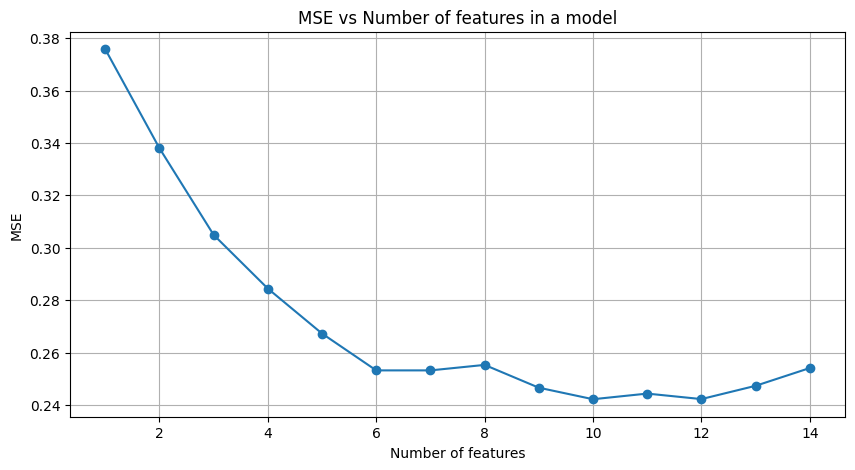

In [194]:
best_feature_subset_fs_xgboost_africa_new, errors_fs_xgboost_africa_new = find_best_subset_forward_stepwise_parallel(X_africa_new_train, y_africa_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_africa_new)

The plot shows a **significant decrease in error up to 6 features**. After that, the error slightly increases, decreases again, and then fluctuates around a certain value.  

For further analysis, we will use a model consisting of **6 features**:  
['**GDP / mean GDP for year**', '**Healthy life expectancy at birth**', '**Positive / Negative**', '**Freedom to make life choices**', '**Log GDP per capita**', '**Generosity x Social support**'].  

Looking closely, we can see that **each of the original features contributed to forming this subset**, except for **Perceptions of corruption**, which may indicate its **low significance in Africa**.  

Next, we will evaluate the performance of this model.  


In [195]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_6_africa_new_xgboost = ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Positive / Negative', 'Freedom to make life choices', 'Log GDP per capita', 'Generosity x Social support']

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_africa_new_train.loc[:, best_6_africa_new_xgboost], y_africa_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_africa_new_train.loc[:, best_6_africa_new_xgboost], y_africa_new_train, X_africa_new_test.loc[:, best_6_africa_new_xgboost], y_africa_new_test, additional_title=' Africa, XGBoost, new features, best 6', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.05
Feature importances:
Column 'Log GDP per capita': 0.4865
Column 'Freedom to make life choices': 0.1313
Column 'Positive / Negative': 0.1107
Column 'Generosity x Social support': 0.1015
Column 'Healthy life expectancy at birth': 0.0936
Column 'GDP / mean GDP for year': 0.0764


Results on train set Africa, XGBoost, new features, best 6
MSE: 0.0164
R2: 0.96356

Results on test set Africa, XGBoost, new features, best 6
MSE: 0.21608
R2: 0.35418


Although the **boosting model** performed better than **bagging** on the original (and reduced) feature set, the **opposite trend** is observed with the **newly added features**.  
Unfortunately, this is not because bagging improved significantly due to the new features but rather because **boosting performed noticeably worse**.  
It achieved an **$R^{2}$ score approximately 0.06 lower** on the test set compared to the **best XGBoost model with a reduced set of original features**.  

* Even though **GDP / mean GDP for year** was added first, **Log GDP per capita** had a **higher influence** in the final model.  
* **Freedom to make life choices** turned out to be the **second most important** feature in this model.  
* The **ratio of positive to negative emotions** and the **interaction between generosity and social support** also had an **impact above 10%**.  
* **Healthy life expectancy at birth** ranked **fifth in importance**, despite being the **second most important** feature in the full model with original features.  

### Summary  
The **newly added features appeared in models more frequently than in Europe**, yet they **did not significantly improve predictive performance**.  

* **GDP remained the most important factor in Africa**, whether represented as **Log GDP per capita** or **GDP / mean GDP per year**. Regardless of which version was used, **one of these features consistently topped the importance ranking**.  
* Based on **bagging results**, we might suggest a **nonlinear relationship** between **Healthy life expectancy at birth** and the target variable. However, due to the **still unsatisfactory performance of the regressors**, we cannot confirm this with certainty.  
* Introducing the **ratio of positive to negative emotions** in Africa allowed the **reduced model** to capture additional information, such as **the interaction between generosity and social support**.  

This experiment further confirms that the **happiness problem in Africa is much more complex**, and to explain it properly, **more region-specific features** would likely need to be added.  


## Asia  
The next continent we will analyze is **Asia**. We will **normalize the dataset, split it into training and test sets,** and evaluate the performance of a **multiple regression model**.  


In [196]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_asia_x = df_asia.loc[:, x_number_columns]
y_asia = df_asia.loc[:, y_column]

scaler = MinMaxScaler()
df_asia_x = pd.DataFrame(scaler.fit_transform(df_asia_x), columns=df_asia_x.columns, index=df_asia_x.index)

X_asia_train, X_asia_test, y_asia_train, y_asia_test = train_test_split(df_asia_x, y_asia, test_size=0.2, random_state=3)

model = LinearRegression()
train_and_evaluate_model(model, X_asia_train.loc[:, :], y_asia_train, X_asia_test.loc[:, :], y_asia_test, additional_title=' for Asia')

Feature weights:
Column 'Log GDP per capita': 1.7416
Column 'Social support': 1.0879
Column 'Generosity': 0.5755
Column 'Healthy life expectancy at birth': 0.5225
Column 'Negative affect': -0.3804
Column 'Perceptions of corruption': -0.3406
Column 'Positive affect': 0.2781
Column 'Freedom to make life choices': 0.1096
Column 'year': -0.0794


Results on train set for Asia
MSE: 0.30458
R2: 0.60212

Results on test set for Asia
MSE: 0.25419
R2: 0.58585



In **Asia**, the multiple regression model **performs significantly better than in Africa** but **worse than in Europe and globally**, which was expected.  

* **Log GDP per capita** remains the **strongest predictor** of happiness in Asia, just as in other regions.  
* Interestingly, in **Asia**, the **second and third most important features** are related to **generosity and social support**—**Social support** and **Generosity**. While **Social support** was an important factor worldwide, the **high significance of Generosity** distinguishes Asia from other continents. This could be due to **deeply rooted cultural values of generosity and philanthropy** in the region.  
* Unlike in **Africa**, **Negative affect** and **Perceptions of corruption** hold **meaningful values**, suggesting that their **increase leads to lower happiness levels**.  
* **Positive affect** has dropped significantly in importance compared to other regions. In **Asia**, many other factors influence happiness more than the level of positive emotions. **Asians seem to value lower levels of negative emotions more than higher levels of positive emotions.**  
* **Freedom to make life choices** and **Perceptions of corruption** are **not perceived as highly important** in Asia.  

Next, we will examine whether **similar conclusions regarding regularization** can be drawn in **Asia** as in other regions.  

Best value of alpha: 0.6832607387157406


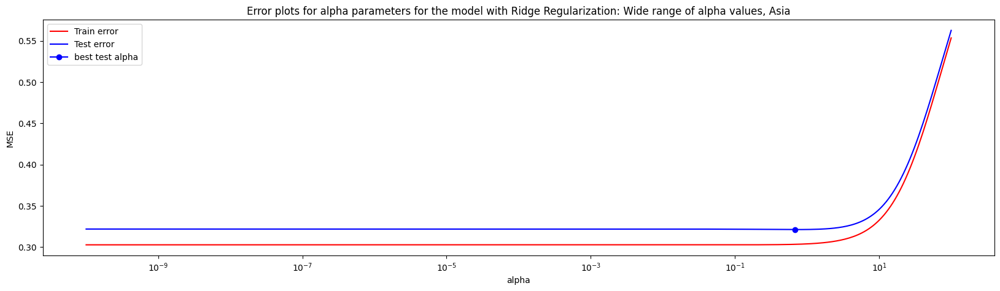

In [197]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_asia_train.loc[:, :], y_asia_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Asia')

In [198]:
alpha_values = np.logspace(-1, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_asia_train.loc[:, :], y_asia_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_asia_train, y_asia_train, X_asia_test, y_asia_test, additional_title=' Asia with Ridge Regularization:')

Best value of alpha: 0.6931717276155406
Feature weights:
Column 'Log GDP per capita': 1.5923
Column 'Social support': 1.0503
Column 'Healthy life expectancy at birth': 0.6297
Column 'Generosity': 0.5338
Column 'Negative affect': -0.3875
Column 'Positive affect': 0.316
Column 'Perceptions of corruption': -0.3018
Column 'Freedom to make life choices': 0.099
Column 'year': -0.0679


Results on train set Asia with Ridge Regularization:
MSE: 0.30499
R2: 0.60158

Results on test set Asia with Ridge Regularization:
MSE: 0.25608
R2: 0.58277


Regularization did not lead to an improvement in metrics; in fact, it caused a slight decline, though the differences are not highly significant. However, applying regularization slightly altered the **feature hierarchy**:  

* **Log GDP per capita** and **Social support** remained the **most important features**.  
* **Healthy life expectancy at birth** moved ahead of **Generosity** in the hierarchy and is now the **third most influential feature**.  
* **Positive affect** became slightly more significant than **Perceptions of corruption**, but its overall impact remains low.  

Next, we will compare these results with **L1 regularization**.  


Best value of alpha: 0.0007196856730011514


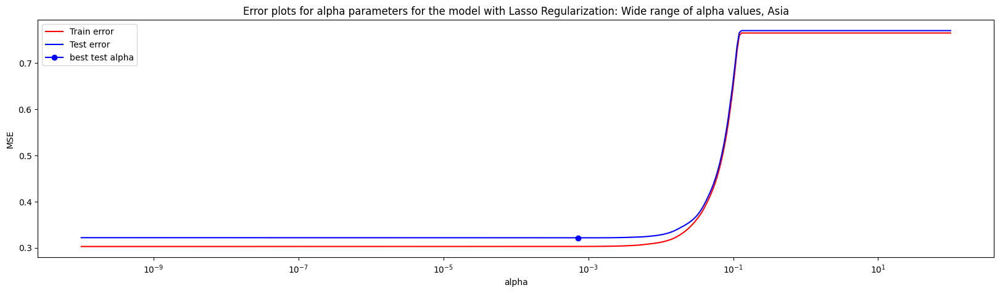

In [199]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_asia_train.loc[:, :], y_asia_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Asia')

In [200]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_asia_train.loc[:, :], y_asia_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_asia_train.loc[:, :], y_asia_train, X_asia_test.loc[:, :], y_asia_test, additional_title=' Asia with Lasso Regularization:')

Best value of alpha: 0.001
Feature weights:
Column 'Log GDP per capita': 1.7241
Column 'Social support': 1.0809
Column 'Generosity': 0.5454
Column 'Healthy life expectancy at birth': 0.5122
Column 'Negative affect': -0.3772
Column 'Positive affect': 0.2841
Column 'Perceptions of corruption': -0.284
Column 'Freedom to make life choices': 0.1022
Column 'year': -0.0543


Results on train set Asia with Lasso Regularization:
MSE: 0.30473
R2: 0.60192

Results on test set Asia with Lasso Regularization:
MSE: 0.25453
R2: 0.58529


L1 regularization also slightly reduced the metric value. There were no significant changes in the **feature hierarchy**.  

The only change was **Positive affect** surpassing **Perceptions of corruption**, but this shift was not very substantial.  

In [201]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_asia_train, y_asia_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_asia_train, y_asia_train, X_asia_test, y_asia_test, additional_title=' Random Forest, Asia', is_forest_reg=True)

Best value of max_depth: 12
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.4251
Column 'Social support': 0.1624
Column 'Positive affect': 0.1344
Column 'Healthy life expectancy at birth': 0.1112
Column 'Freedom to make life choices': 0.0466
Column 'Generosity': 0.0382
Column 'Negative affect': 0.0335
Column 'Perceptions of corruption': 0.0245
Column 'year': 0.0241

Mean depth of trees: 12.0


Results on train set Random Forest, Asia
MSE: 0.02224
R2: 0.97094

Results on test set Random Forest, Asia
MSE: 0.11518
R2: 0.81234


Again, we can see that the **Random Forest Regressor** significantly improves the results. With a relatively shallow tree depth, it achieved very low bias and high generalization ability. The test set performance increased by **0.23** compared to previous models.  

On the other hand, we observe **a reshuffling in feature importance** for this model:  
* **Log GDP per capita** remains the most important feature, with approximately **40% importance**.  
* **Social support** is still the second most important feature for Asia, with **16% importance**.  
* Compared to multiple regression models, the **importance of Generosity has significantly decreased**.  
* The **third most important feature is now Positive affect**, which had low importance in multiple regression. This contradicts the previous conclusion that **happiness in Asia is more influenced by low negative emotions rather than high positive ones**.  
* **Freedom to make life choices** moved up in the hierarchy, but its overall importance remains low.  

Next, we will compare these results with the **boosting method**.  


In [202]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_asia_train, y_asia_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_asia_train, y_asia_train, X_asia_test, y_asia_test, additional_title=' XGBoost, Asia', is_xgboost=True)

Best value of max_depth: 3
Best value of learning_rate: 0.3
Feature importances:
Column 'Log GDP per capita': 0.4338
Column 'Social support': 0.192
Column 'Positive affect': 0.1202
Column 'Healthy life expectancy at birth': 0.0833
Column 'Freedom to make life choices': 0.0499
Column 'Generosity': 0.039
Column 'Negative affect': 0.0348
Column 'year': 0.0268
Column 'Perceptions of corruption': 0.0201


Results on train set XGBoost, Asia
MSE: 0.00833
R2: 0.98912

Results on test set XGBoost, Asia
MSE: 0.13543
R2: 0.77935


Despite better fitting on the training set, the **boosting method** performed slightly worse than bagging, with results **0.04 lower**. However, it achieved this with an exceptionally **low tree depth of 3**.  

The **feature hierarchy is similar to that of bagging**, with one notable difference:  
* In Asia, the **passage of time** has a greater impact on happiness than **perceptions of corruption**. However, the differences in importance between these features are minor.  
* **Boosting assigns greater importance to Social support than bagging**, while **placing less emphasis on Healthy life expectancy at birth**.  

Next, we will analyze what we can deduce from **feature selection algorithms**.  


In [203]:
lasso_feature_selection(X_asia_train, y_asia_train)

Alpha: 0.0032 - Excluded: year
Alpha: 0.0064 - Excluded: Perceptions of corruption
Alpha: 0.0178 - Excluded: Freedom to make life choices
Alpha: 0.0235 - Excluded: Generosity
Alpha: 0.0270 - Excluded: Negative affect
Alpha: 0.0450 - Excluded: Positive affect
Alpha: 0.0594 - Excluded: Healthy life expectancy at birth
Alpha: 0.1136 - Excluded: Social support
Alpha: 0.1246 - Excluded: Log GDP per capita

All features have been excluded.


Once again, the **year variable was excluded**. Similarly, **Perceptions of corruption** and **Freedom to make life choices** were deemed relatively unimportant.  

Interestingly, **Generosity was eliminated quite early**, despite its high ranking in the **multiple regression model's feature importance hierarchy**.  

The most important features remain **Log GDP per capita** and **Social support**, which were also the most significant in the regression model.  


In [204]:
best_subset_f_stepwise_asia, errors_fs_asia = find_best_subset_forward_stepwise(X_asia_train, y_asia_train)

Best model for 1 features with MSE:  0.4487 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3474 is: ['Log GDP per capita', 'Social support'].
Best model for 3 features with MSE:  0.3301 is: ['Log GDP per capita', 'Social support', 'Positive affect'].
Best model for 4 features with MSE:  0.3251 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity'].
Best model for 5 features with MSE:  0.3202 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect'].
Best model for 6 features with MSE:  0.3185 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect', 'Perceptions of corruption'].
Best model for 7 features with MSE:  0.3186 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect', 'Perceptions of corruption', 'Healthy life expectancy at birth'].
Best model for 8 features with MSE:  0.3198 is: ['Log GDP per capita', 'Social support

Interestingly, **Freedom to make life choices was eliminated even earlier than year**.  

Additionally, **Healthy life expectancy at birth** was removed relatively quickly, despite being in the top half of the feature importance hierarchy.  

The most important features turned out to be **GDP, Social support, Positive affect, and Generosity**.  


Best model for 1 features with MSE:  0.4487 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.3474 is: ['Log GDP per capita', 'Social support'].
Best model for 3 features with MSE:  0.3301 is: ['Log GDP per capita', 'Social support', 'Positive affect'].
Best model for 4 features with MSE:  0.3233 is: ['Log GDP per capita', 'Social support', 'Generosity', 'Negative affect'].
Best model for 5 features with MSE:  0.3202 is: ['Log GDP per capita', 'Social support', 'Generosity', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.3185 is: ['Log GDP per capita', 'Social support', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.3186 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 8 features with MSE:  0.3198 is: ['year', 'Log GDP per capita', 'Social

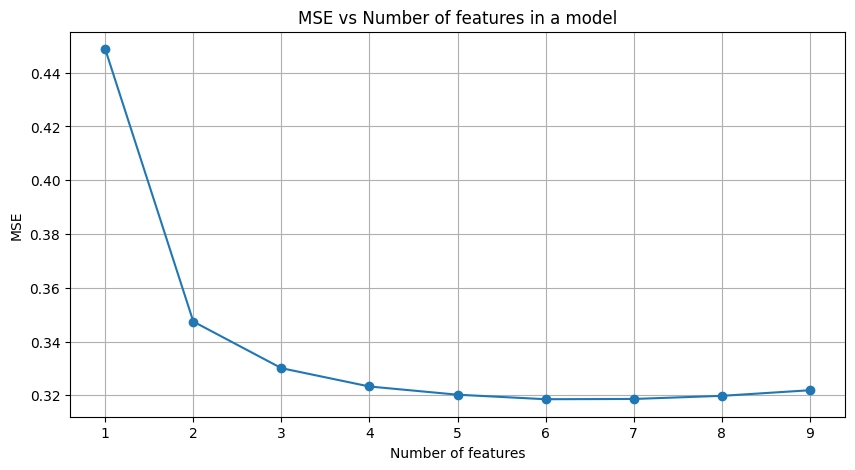

In [205]:
best_subset_par_asia, errors_par_asia = find_best_feature_subset_parallel(X_asia_train, y_asia_train)
elbow_plot(errors_par_asia)

Both of the above algorithms reached the same conclusion: the set of features that minimizes the mean squared error consists of the following six features:  
**['Log GDP per capita', 'Social support', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']**.  

Here, we can see the presence of **Generosity** and **Negative affect**, which did not have a significant impact in the **Random Forest model**.  
Another interesting observation is the inclusion of **Perceptions of corruption**. However, this feature was added as the sixth one and does not significantly reduce the mean squared error, which means it could be redundant.  

Additionally, **there is not much difference in error between the model with 4 features and the one with 5, where Positive affect was added**. This aligns with the results from the **multiple regression model**.  

Let's now evaluate how models perform with only the **4 and 5 most relevant features**.  


In [206]:
best_4_asia = ['Log GDP per capita', 'Social support', 'Generosity', 'Negative affect']
best_5_asia = ['Log GDP per capita', 'Social support', 'Generosity', 'Positive affect', 'Negative affect']

print('4 FEATURES')
model = LinearRegression()
train_and_evaluate_model(model, X_asia_train.loc[:, best_4_asia], y_asia_train, X_asia_test.loc[:, best_4_asia], y_asia_test, additional_title=' for Asia, best 4 features')

print('\n\n5 FEATURES')
model = LinearRegression()
train_and_evaluate_model(model, X_asia_train.loc[:, best_5_asia], y_asia_train, X_asia_test.loc[:, best_5_asia], y_asia_test, additional_title=' for Asia, best 5 features')

4 FEATURES
Feature weights:
Column 'Log GDP per capita': 2.1845
Column 'Social support': 1.2383
Column 'Generosity': 0.6701
Column 'Negative affect': -0.4684


Results on train set for Asia, best 4 features
MSE: 0.31562
R2: 0.5877

Results on test set for Asia, best 4 features
MSE: 0.26124
R2: 0.57436


5 FEATURES
Feature weights:
Column 'Log GDP per capita': 2.119
Column 'Social support': 1.1386
Column 'Generosity': 0.5125
Column 'Negative affect': -0.4116
Column 'Positive affect': 0.401


Results on train set for Asia, best 5 features
MSE: 0.31161
R2: 0.59294

Results on test set for Asia, best 5 features
MSE: 0.25617
R2: 0.58262


We observe that for the model consisting of **4 features**, the **$R^{2}$** score is only **0.01 lower** than that of the full model. This is a good result, considering that **5 features were removed**.  
Adding **Positive affect** further improves the score by **0.005**.  

* In both cases, the feature hierarchy remains the same and is as follows:  
  1. **Log GDP per capita** is the most important.  
  2. **Social support** comes next.  
  3. **Generosity** follows.  
  4. **Negative affect** ranks fourth.  
  5. **Positive affect** has the smallest impact.  
* The feature weights of the model differ significantly between the first, second, and third most important features.  

Let's now apply **regularization** to the model with **4 features**.  


Best value of alpha: 0.17103410003378378


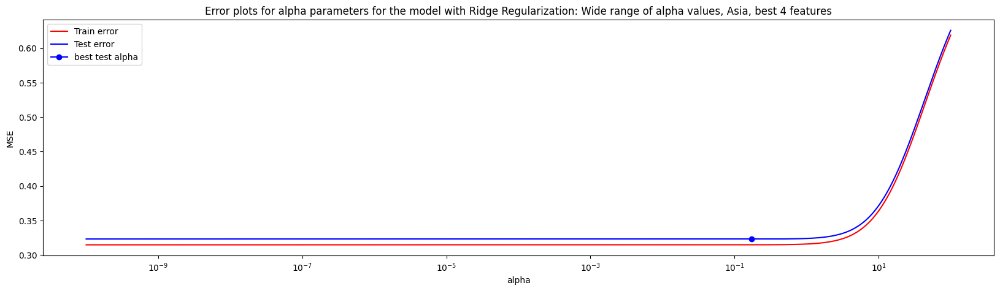

In [207]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_asia_train.loc[:, best_4_asia], y_asia_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Asia, best 4 features')

In [208]:
alpha_values = np.logspace(-1, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_asia_train.loc[:, best_4_asia], y_asia_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_asia_train.loc[:, best_4_asia], y_asia_train, X_asia_test.loc[:, best_4_asia], y_asia_test, additional_title=' Asia with Ridge Regularization, 4 best features:')

Best value of alpha: 0.16681005372000587
Feature weights:
Column 'Log GDP per capita': 2.1627
Column 'Social support': 1.2383
Column 'Generosity': 0.6614
Column 'Negative affect': -0.4665


Results on train set Asia with Ridge Regularization, 4 best features:
MSE: 0.31564
R2: 0.58767

Results on test set Asia with Ridge Regularization, 4 best features:
MSE: 0.26101
R2: 0.57473


In this case, **regularization slightly improved** the test set performance. Let's now examine how **L1 regularization** behaves.  

Best value of alpha: 1e-10


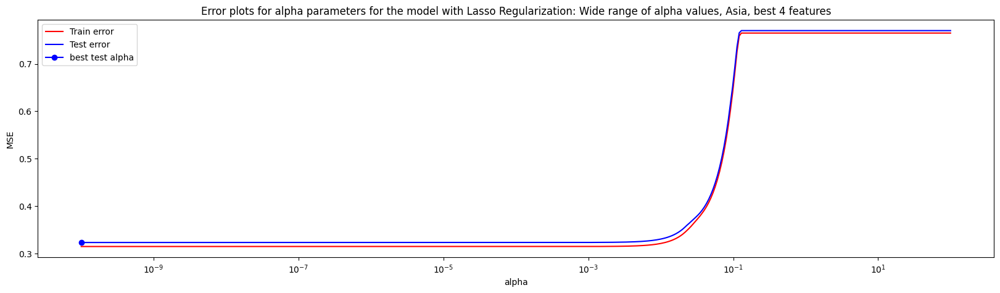

In [209]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_asia_train.loc[:, best_4_asia], y_asia_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Asia, best 4 features')

In [210]:
alpha_values = np.logspace(-10, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_asia_train.loc[:, best_4_asia], y_asia_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_asia_train.loc[:, best_4_asia], y_asia_train, X_asia_test.loc[:, best_4_asia], y_asia_test, additional_title=' Asia with Lasso Regularization for 5 best features:')

Best value of alpha: 1e-10
Feature weights:
Column 'Log GDP per capita': 2.1845
Column 'Social support': 1.2383
Column 'Generosity': 0.6701
Column 'Negative affect': -0.4684


Results on train set Asia with Lasso Regularization for 5 best features:
MSE: 0.31562
R2: 0.5877

Results on test set Asia with Lasso Regularization for 5 best features:
MSE: 0.26124
R2: 0.57436


Applying **L1 regularization** did not cause significant changes compared to the **4-feature model without regularization**—the **$R^{2}$** score remained the same.  
This is likely due to the fact that the optimal **alpha** value selected was the **lowest** one tested.  

Next, we will attempt to **select the best features** for the **Random Forest Regressor**.  


Best model for 1 features with MSE:  0.5568 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2601 is: ['Social support', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.2077 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE:  0.1754 is: ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Positive affect'].
Best model for 5 features with MSE:  0.1618 is: ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Generosity', 'Positive affect'].
Best model for 6 features with MSE:  0.1555 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect'].
Best model for 7 features with MSE:  0.1537 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect', 'Negative affect'].
B

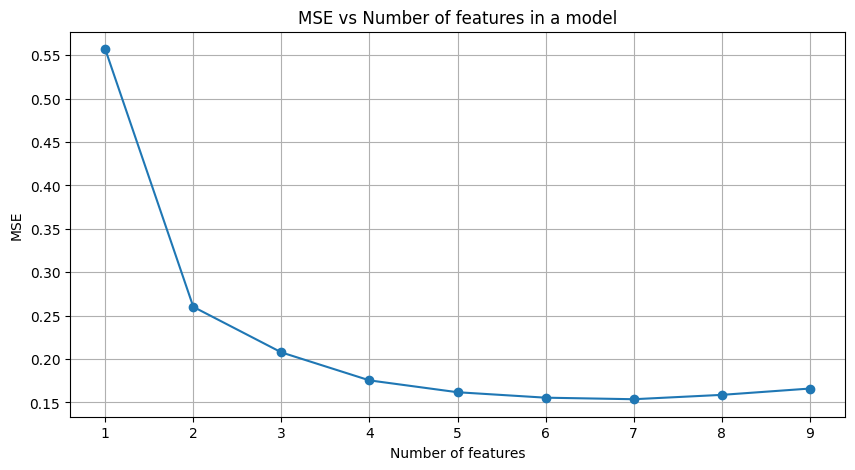

In [211]:
best_subset_par_asia_forest, errors_par_asia_forest = find_best_feature_subset_parallel(X_asia_train, y_asia_train, is_forest_reg=True)
elbow_plot(errors_par_asia_forest)

The algorithm minimizes the **mean squared error** with **7 features**, eliminating **year** and **Perceptions of corruption**.  
This finding aligns with previous conclusions suggesting that **corruption perception is not a highly significant factor in Asia**.  

As a compromise, after reviewing the plot, we will select **5 features**.  
The **subset closely resembles** the one from the **multiple regression model**, with one key difference:  
**Freedom to make life choices** is included **instead of Negative affect**.  

This is particularly interesting because, in the **multiple regression model**, **Negative affect** had a **higher weight** than **Positive affect**.  


In [212]:
best_5_asia_forest = ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Generosity', 'Positive affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_asia_train.loc[:, best_5_asia_forest], y_asia_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_asia_train.loc[:, best_5_asia_forest], y_asia_train, X_asia_test.loc[:, best_5_asia_forest], y_asia_test, additional_title=' Random Forest, Asia, Best 5 features', is_forest_reg=True)

Best value of max_depth: 12
Best value of min_samples_leaf: 2
Feature importances:
Column 'Log GDP per capita': 0.5222
Column 'Social support': 0.1839
Column 'Positive affect': 0.1532
Column 'Freedom to make life choices': 0.0762
Column 'Generosity': 0.0645

Mean depth of trees: 11.99


Results on train set Random Forest, Asia, Best 5 features
MSE: 0.03582
R2: 0.95321

Results on test set Random Forest, Asia, Best 5 features
MSE: 0.1443
R2: 0.76488


After removing **4 features**, we observe that the **$R^{2}$** value on the test set **dropped by 0.05**, but it **remains high**.  
The lower value is likely due to the complexity of the problem, which may be difficult to **capture with only 5 features**.  
Despite this, the **$R^{2}$** value is still **satisfactory** and **significantly better than the multiple regression model**.  

* The **most important feature** remains **Log GDP per capita**, with **52% importance**.  
* The **second most important feature** is **Social support**, which was also highly ranked in the full model, with **18% importance**.  
* **Positive affect** turned out to be a **crucial feature**, contributing **15%**.  
* **Freedom to make life choices** and **Generosity** have **7%** and **6% importance**, respectively.  
  - These features still play a role and **should not be ignored** in the model.  

Below, we will **compare the results with boosting**.  


Best model for 1 features with MSE:  0.4945 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2672 is: ['Social support', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.2104 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE:  0.1819 is: ['Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Positive affect'].
Best model for 5 features with MSE:  0.1627 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect'].
Best model for 6 features with MSE:  0.1576 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect'].
Best model for 7 features with MSE:  0.1569 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive 

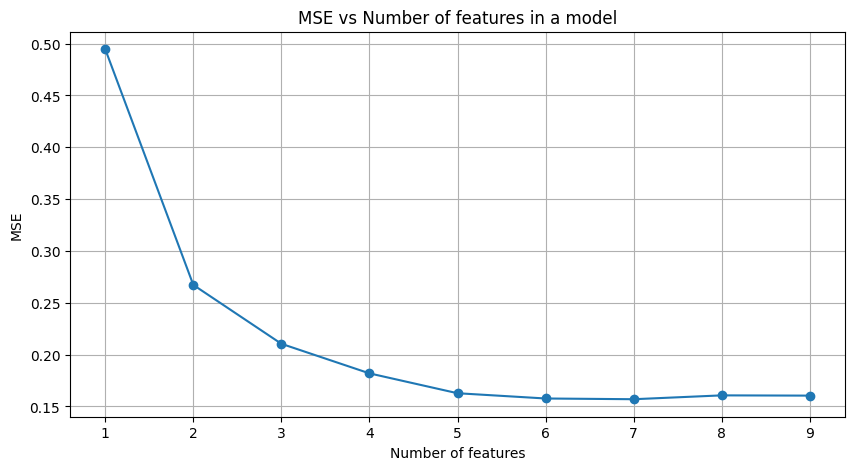

In [213]:
best_subset_par_asia_xgb, errors_par_asia_xgb = find_best_feature_subset_parallel(X_asia_train, y_asia_train, is_xgboost=True)
elbow_plot(errors_par_asia_xgb)

The algorithm returned a **similar subset** that minimizes the **mean squared error**, selecting **7 features**.  
Compared to **bagging**, the feature **Negative affect** was replaced by **year**.  

* **Log GDP per capita** is the **best single predictor**, yet the **best two-feature subset** consists of:
  - **['Social support', 'Healthy life expectancy at birth']**
* As before, we will **select a subset of 5 features** for further analysis.  
  - However, **this subset differs from the one chosen by bagging**.  
  - Instead of **Generosity**, the **boosting algorithm** prefers **Healthy life expectancy at birth**.


In [214]:
best_5_asia_xgb = ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_asia_train.loc[:, best_5_asia_xgb], y_asia_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_asia_train.loc[:, best_5_asia_xgb], y_asia_train, X_asia_test.loc[:, best_5_asia_xgb], y_asia_test, additional_title=' XGBoost, Asia best 5 features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.371
Column 'Positive affect': 0.2704
Column 'Social support': 0.1463
Column 'Healthy life expectancy at birth': 0.1213
Column 'Freedom to make life choices': 0.091


Results on train set XGBoost, Asia best 5 features
MSE: 0.00078
R2: 0.99898

Results on test set XGBoost, Asia best 5 features
MSE: 0.16028
R2: 0.73885


A similar decline is observed with the boosting method. Despite the low bias, generalization ability decreased by 0.04 compared to the model with the full set of features. When analyzing the results of the boosting method, we can observe the following findings:  
* **Log GDP per capita** remained the most important feature, but its impact significantly decreased to 37%.  
* The importance of **Positive affect** increased to 27%. Boosting seems to value this feature significantly more.  
* **Social support**, despite a slight decline, is still an important feature.  
* **Healthy life expectancy at birth** and **Freedom to make life choices** also appear to be significant in predicting happiness in Asia.  

Happiness in Asia is also a complex issue, but it is easier to describe using existing features compared to the problem of happiness in Africa.  
* As in every analyzed continent, **Log GDP per capita** is the most important feature in the dataset.  
* Regarding the second most important feature, models do not always agree; however, we can see that both **Social support** and **Positive affect** are highly significant in determining happiness in Asia.  
* Initially, we assumed that a low level of negative emotions was more important than a high level of positive emotions. However, bagging and boosting methods showed that this might not necessarily be the case. They assigned greater weight to **Positive affect**, and it was selected by feature selection methods.  
* The algorithms agree that **Perceptions of corruption** do not have a significant impact on happiness in Asia.  
* Bagging and boosting algorithms also indicated that there is a notable relationship between **Freedom to make life choices** and the target variable.  
* Looking at the results, we can also conclude that **Healthy life expectancy at birth** affects happiness in Asia. This makes sense, given that this feature exhibits a high degree of variability in this region of the world.  
* Although **Generosity** did not usually have high significance in the final, reduced models (being the least significant feature in the **Random Forest** model with five features), we still observe that its impact is higher in this region compared to others.  
* **year** and **Perceptions of corruption** are not significant features on the Asian continent.  

### Asia - Feature Engineering  
Similar to the previous continents, we will attempt to add the same features as before, hoping that they may gain significance in this part of the world.  


In [215]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_asia_new = df_asia.loc[:, x_number_columns]
y_asia_new = df_asia.loc[:, y_column]

mean_gdp_per_year_asia = df_asia_new.groupby('year')["Log GDP per capita"].transform('mean')
df_asia_new["GDP / mean GDP for year"] = df_asia_new["Log GDP per capita"] / mean_gdp_per_year_asia


df_asia_new['Freedom x (1-Corruption)'] = df_asia_new['Freedom to make life choices'] * (1 - df_asia_new['Perceptions of corruption'])
df_asia_new['Positive / Negative'] = df_asia_new['Positive affect'] / df_asia_new['Negative affect']
df_asia_new['Healthy square'] = np.pow(df_asia_new['Healthy life expectancy at birth'], 2)

df_asia_new['Generosity_shifted'] = df_asia_new['Generosity'] - df_asia_new['Generosity'].min()
df_asia_new['Generosity x Social support'] = df_asia_new['Generosity_shifted'] * df_asia_new['Social support']
df_asia_new = df_asia_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_asia_new = pd.DataFrame(scaler.fit_transform(df_asia_new), columns=df_asia_new.columns, index=df_asia_new.index)

df_asia_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
0,0.166667,0.025331,0.083177,0.000000,0.563853,0.587814,0.887798,0.161202,0.371554,0.085044,0.087666,0.139587,0.000000,0.297583
1,0.222222,0.062811,0.263235,0.012448,0.501371,0.617922,0.848765,0.281179,0.320869,0.123501,0.109900,0.201548,0.010080,0.383383
2,0.277778,0.087743,0.239793,0.024896,0.375874,0.527973,0.672081,0.344605,0.412691,0.139634,0.207777,0.179281,0.020219,0.319726
3,0.333333,0.080011,0.207958,0.037344,0.209820,0.582689,0.702101,0.278343,0.393119,0.121610,0.151514,0.167426,0.030419,0.341097
4,0.388889,0.098783,0.207131,0.049793,0.265636,0.678625,0.756993,0.517276,0.394907,0.135267,0.132758,0.239282,0.040678,0.396901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2323,0.666667,0.000000,0.683499,0.309129,0.368009,0.209791,0.813567,0.078642,0.460101,0.000000,0.115752,0.087649,0.267986,0.186075
2324,0.722222,0.047398,0.683264,0.299792,0.300354,0.210567,0.777918,0.152467,0.507671,0.049411,0.126834,0.095315,0.259353,0.186731
2325,0.777778,0.048440,0.826077,0.290456,0.457417,0.237386,0.784875,0.280646,0.263110,0.048138,0.148969,0.234688,0.250754,0.232013
2326,0.944444,0.111178,0.829745,0.262448,0.386486,0.280199,0.771712,0.242804,0.364242,0.091576,0.145662,0.168401,0.225158,0.274509


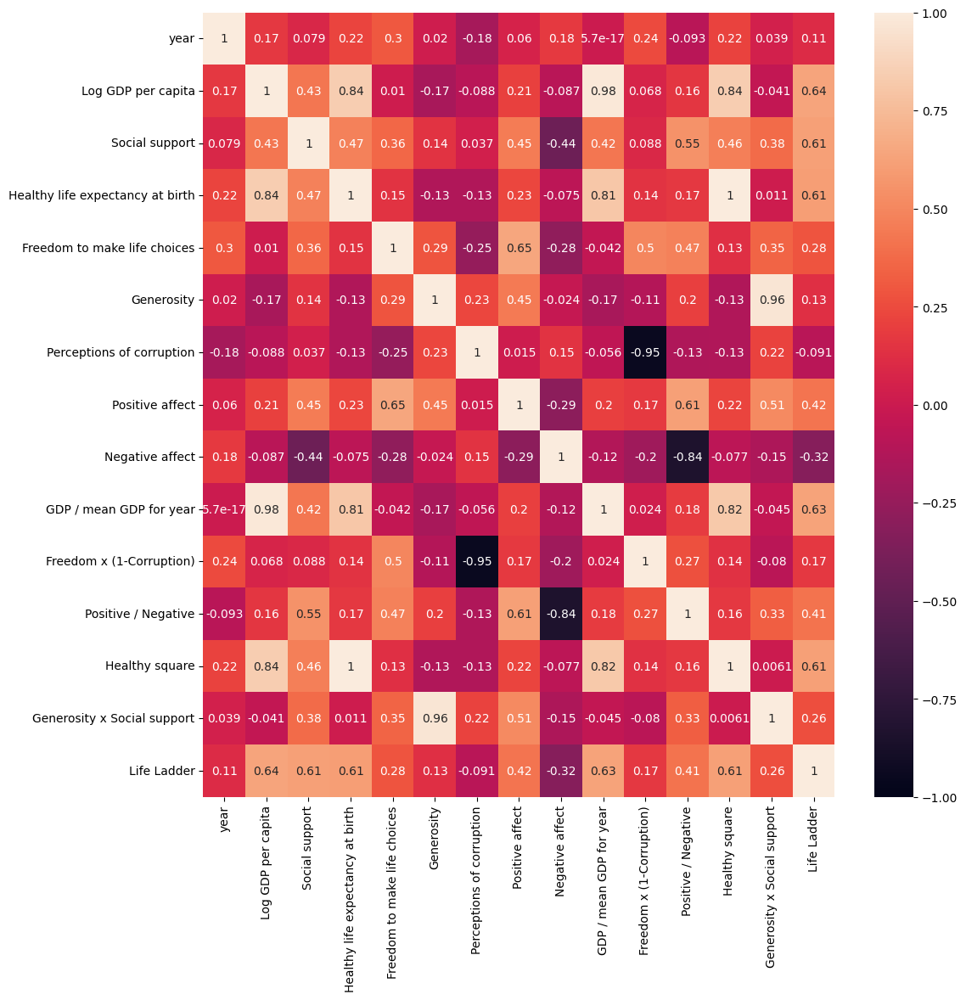

In [216]:
plt.figure(figsize=(12,12))
df_asia_new_with_y = pd.concat([df_asia_new, y_asia_new], axis=1)
sns.heatmap(df_asia_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

In the correlation of most features, we can draw the same conclusions as before. Once again, we observe that the correlation of the new features related to **GDP** and **Healthy life expectancy at birth** is high with the target variable.  

However, we notice a higher correlation in Asia compared to Africa between **Generosity x Social support** and **Social support**. Apart from this, this feature generally has lower correlations with the others, with many correlations hovering around zero.  

We can now test how the multiple regression model performs after adding the new features.  


In [217]:
X_asia_new_train, X_asia_new_test, y_asia_new_train, y_asia_new_test = train_test_split(df_asia_new, y_asia_new, test_size=0.2, random_state=3)

In [218]:
model = LinearRegression()
train_and_evaluate_model(model, X_asia_new_train.loc[:, :], y_asia_new_train, X_asia_new_test.loc[:, :], y_asia_new_test, additional_title=', Asia, new features')

Feature weights:
Column 'Healthy square': 10.1413
Column 'Healthy life expectancy at birth': -9.7562
Column 'Social support': 1.4795
Column 'Generosity': 1.4281
Column 'Log GDP per capita': 1.2891
Column 'Freedom x (1-Corruption)': 1.1084
Column 'Generosity x Social support': -1.0123
Column 'Perceptions of corruption': 0.6376
Column 'Negative affect': -0.5955
Column 'Positive / Negative': -0.5279
Column 'GDP / mean GDP for year': 0.3307
Column 'Positive affect': 0.324
Column 'Freedom to make life choices': 0.172
Column 'year': -0.0956


Results on train set, Asia, new features
MSE: 0.28847
R2: 0.62317

Results on test set, Asia, new features
MSE: 0.23355
R2: 0.61948


The $R^{2}$ score on the test set was able to increase by 0.03 after adding the new features. Once again, we observe that the most significant impact comes from **Healthy life expectancy at birth**, and, as before, the first-power feature has a negative sign.  

The key difference in this region is that both features related to **GDP** have a positive impact on the target variable. The newly added features are positioned somewhere in the middle in terms of importance.  

Let's see how regularization affects them.


In [219]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_asia_new_train.loc[:, :], y_asia_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_asia_new_train.loc[:, :], y_asia_new_train, X_asia_new_test.loc[:, :], y_asia_new_test, additional_title=' Asia, new features with Ridge Regularization:')

Best value of alpha: 0.1365007806546014
Feature weights:
Column 'Healthy square': 1.5936
Column 'Generosity': 1.4936
Column 'Social support': 1.3547
Column 'Log GDP per capita': 1.1282
Column 'Generosity x Social support': -1.0403
Column 'Healthy life expectancy at birth': -0.9816
Column 'Freedom x (1-Corruption)': 0.6995
Column 'Negative affect': -0.6865
Column 'Positive / Negative': -0.542
Column 'GDP / mean GDP for year': 0.5184
Column 'Positive affect': 0.4188
Column 'Perceptions of corruption': 0.2536
Column 'Freedom to make life choices': 0.0316
Column 'year': -0.0236


Results on train set Asia, new features with Ridge Regularization:
MSE: 0.29641
R2: 0.61279

Results on test set Asia, new features with Ridge Regularization:
MSE: 0.24837
R2: 0.59533


In [220]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_asia_new_train.loc[:, :], y_asia_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_asia_new_train.loc[:, :], y_asia_new_train, X_asia_new_test.loc[:, :], y_asia_new_test, additional_title=' Asia, new features with Lasso Regularization:')

Best value of alpha: 0.0006604193962330305
Feature weights:
Column 'Log GDP per capita': 1.6335
Column 'Social support': 1.2226
Column 'Generosity': 1.0443
Column 'Healthy square': 0.6276
Column 'Negative affect': -0.5705
Column 'Generosity x Social support': -0.537
Column 'Freedom x (1-Corruption)': 0.3889
Column 'Positive affect': 0.373
Column 'Positive / Negative': -0.3335
Column 'year': -0.0684
Column 'Freedom to make life choices': 0.0384
Column 'GDP / mean GDP for year': 0.0044
Column 'Healthy life expectancy at birth': -0.0
Column 'Perceptions of corruption': -0.0


Results on train set Asia, new features with Lasso Regularization:
MSE: 0.29995
R2: 0.60817

Results on test set Asia, new features with Lasso Regularization:
MSE: 0.25135
R2: 0.59048


Both regularization methods caused a significant decrease in the coefficients associated with **Healthy life expectancy at birth**, which, in turn, led to a drop in the test set metric. We also see that **Lasso** regularization completely excluded two features: **Perceptions of corruption** and **Healthy life expectancy at birth**.  

However, the results obtained from the two regularization techniques differ. In **Ridge** regularization, which retained **Healthy life expectancy at birth**, the **Healthy square** feature has the highest coefficient value. In contrast, in **Lasso** regularization, **Log GDP per capita** becomes the most influential feature.  

In both cases, **Generosity** and **Social support** continue to have a significant impact, similar to the model based on the original features.  

Let's see what results the forward stepwise algorithm provides.


Best model for 1 features with MSE: 0.4487 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.3474 is: ['Log GDP per capita', 'Social support'].
Best model for 3 features with MSE: 0.3301 is: ['Log GDP per capita', 'Social support', 'Positive affect'].
Best model for 4 features with MSE: 0.3251 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity'].
Best model for 5 features with MSE: 0.3202 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect'].
Best model for 6 features with MSE: 0.3178 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect', 'Freedom x (1-Corruption)'].
Best model for 7 features with MSE: 0.3167 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect', 'Freedom x (1-Corruption)', 'Healthy square'].
Best model for 8 features with MSE: 0.3136 is: ['Log GDP per capita', 'Social support', 'Positive affect', 'Gener

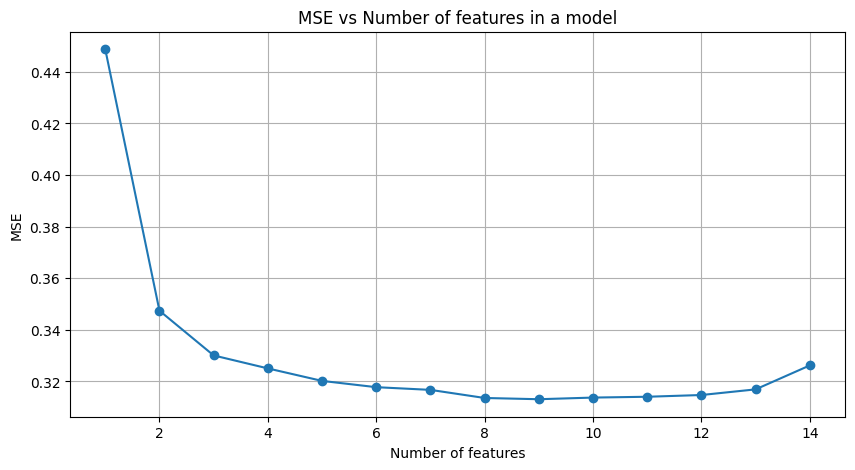

In [221]:
best_feature_subset_fs_asia_new, errors_fs_asia_new = find_best_subset_forward_stepwise_parallel(X_asia_new_train, y_asia_new_train)
elbow_plot(errors_fs_asia_new)

We can observe that for the **multiple regression model**, the feature selection algorithm chose the exact same five features as before. Adding more features does not significantly reduce the **MSE**.  

Since the sixth added feature is **Freedom x (1-Corruption)**, we will include it in further considerations, as re-evaluating the same feature subset would be pointless.  

Interestingly, although **Generosity** and **Social support** had a relatively strong impact in Asia, their interaction was one of the last features included in the model.


In [222]:
best_6_asia_new = ['Log GDP per capita', 'Social support', 'Positive affect', 'Generosity', 'Negative affect', 'Freedom x (1-Corruption)']
model = LinearRegression()
train_and_evaluate_model(model, X_asia_new_train.loc[:, best_6_asia_new], y_asia_new_train, X_asia_new_test.loc[:, best_6_asia_new], y_asia_new_test, additional_title=', Asia, new features, best 6')

Feature weights:
Column 'Log GDP per capita': 2.1096
Column 'Social support': 1.1629
Column 'Generosity': 0.5636
Column 'Freedom x (1-Corruption)': 0.4609
Column 'Negative affect': -0.3674
Column 'Positive affect': 0.3149


Results on train set, Asia, new features, best 6
MSE: 0.30784
R2: 0.59786

Results on test set, Asia, new features, best 6
MSE: 0.24642
R2: 0.5985


We can see that adding the feature **Freedom x (1-Corruption)** was able to improve **$R^{2}$** on the test set by more than **0.015**, and this feature achieved a higher coefficient than emotional levels.  

Although the **level of corruption** alone was not a significant feature for Asians, the **interaction between freedom and integrity** might hold some importance. However, we will assess this further using **bagging and boosting models**.


In [223]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_asia_new_train.loc[:, :], y_asia_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_asia_new_train.loc[:, :], y_asia_new_train, X_asia_new_test.loc[:, :], y_asia_new_test, additional_title=' Asia, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.3332
Column 'Social support': 0.1371
Column 'GDP / mean GDP for year': 0.1344
Column 'Positive affect': 0.1082
Column 'Healthy square': 0.0498
Column 'Positive / Negative': 0.044
Column 'Freedom to make life choices': 0.0419
Column 'Healthy life expectancy at birth': 0.0408
Column 'Generosity x Social support': 0.0381
Column 'year': 0.0182
Column 'Negative affect': 0.0168
Column 'Freedom x (1-Corruption)': 0.0134
Column 'Perceptions of corruption': 0.0129
Column 'Generosity': 0.0113

Mean depth of trees: 13.0


Results on train set Asia, Random Forest, new features
MSE: 0.02015
R2: 0.97368

Results on test set Asia, Random Forest, new features
MSE: 0.11092
R2: 0.81928


Compared to the model based on the original features, the **$R^{2}$** on the test set improved by only **0.007**, while the **average depth increased by 1 level**. The addition of 5 new features did not provide a significant benefit that would outweigh the increased complexity of the model.  

* The two most important features in this model remained **Log GDP per capita** and **Social support**. However, we can see that due to the addition of new features, the importance of **Log GDP per capita** decreased, as its influence had to be distributed among the newly added features.
* The third most important feature turned out to be the newly added **GDP / mean GDP per capita**. This suggests that after reducing the impact of the global growth of **GDP** over time, it still adds valuable information to the model.
* We can see that **Healthy square** achieved a higher score than **Healthy life expectancy at birth**. However, the total importance of this feature is similar to what **Healthy life expectancy at birth** obtained in the model without the newly introduced features.
* **Positive affect** remained an important feature for this model.

Let’s check the results of **forward stepwise selection**.


Best model for 1 features with MSE: 0.4857 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.244 is: ['GDP / mean GDP for year', 'Social support'].
Best model for 3 features with MSE: 0.1797 is: ['GDP / mean GDP for year', 'Social support', 'Healthy square'].
Best model for 4 features with MSE: 0.1633 is: ['GDP / mean GDP for year', 'Social support', 'Healthy square', 'Positive affect'].
Best model for 5 features with MSE: 0.1489 is: ['GDP / mean GDP for year', 'Social support', 'Healthy square', 'Positive affect', 'Freedom to make life choices'].
Best model for 6 features with MSE: 0.1463 is: ['GDP / mean GDP for year', 'Social support', 'Healthy square', 'Positive affect', 'Freedom to make life choices', 'Healthy life expectancy at birth'].
Best model for 7 features with MSE: 0.1475 is: ['GDP / mean GDP for year', 'Social support', 'Healthy square', 'Positive affect', 'Freedom to make life choices', 'Healthy life expectancy at birth', 'Log GDP per capita'].
Best 

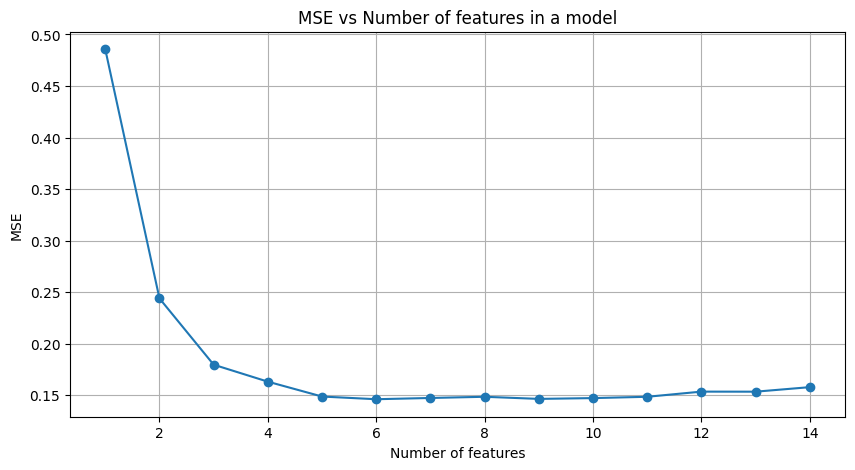

In [224]:
best_feature_subset_fs_asia_new_forest, errors_fs_asia_new_forest = find_best_subset_forward_stepwise_parallel(X_asia_new_train, y_asia_new_train, is_forest_reg=True)
elbow_plot(errors_fs_asia_new_forest)

Here, too, we observe a **significant drop in MSE** up to 5 features. Adding more features does not bring substantial improvement, and the model's performance fluctuates around the value achieved for 5 features.  

In this subset, we can see **two newly introduced features**: **GDP / mean GDP per year** and **Healthy square**. The first one replaced **Log GDP per capita**. This transformation might carry slightly more information, although the results obtained when both are included suggest that they can often be used almost interchangeably.  

On the other hand, **Healthy square** is a new feature in this model and replaced **Generosity**. It is possible that the squared relationship between health and happiness is more significant than the relationship with generosity. We will now evaluate the model using only these 5 features.


In [225]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_5_forest_asia_new =  ['GDP / mean GDP for year', 'Social support', 'Healthy square', 'Positive affect', 'Freedom to make life choices']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_asia_new_train.loc[:, best_5_forest_asia_new], y_asia_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_asia_new_train.loc[:, best_5_forest_asia_new], y_asia_new_train, X_asia_new_test.loc[:, best_5_forest_asia_new], y_asia_new_test, additional_title=' Asia, Random Forest, new features, best 5 features', is_forest_reg=True)

Best value of max_depth: 16
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.3702
Column 'Healthy square': 0.22
Column 'Social support': 0.2038
Column 'Positive affect': 0.1407
Column 'Freedom to make life choices': 0.0652

Mean depth of trees: 15.93


Results on train set Asia, Random Forest, new features, best 5 features
MSE: 0.01925
R2: 0.97485

Results on test set Asia, Random Forest, new features, best 5 features
MSE: 0.1399
R2: 0.77206


The model achieved an **increase of nearly 0.01 in $R^{2}$** on the test set compared to the previous one. However, it did so by using significantly deeper trees, averaging **4 levels deeper**.  

* The **GDP-related feature** remained at the top, but its influence **decreased significantly**, distributing itself among the other features.  
* Although the **Healthy-related feature** was not included in the limited model with the original features, here we can see that **Healthy square** achieved the **second-highest importance**. This could strongly suggest that a **nonlinear relationship between healthy life expectancy and happiness** exists in Asia.  
* The **remaining features** appear in the **same order** as in the **original limited model**.  

We can now compare these results with the **Boosting model**.

In [226]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_asia_new_train.loc[:, :], y_asia_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_asia_new_train.loc[:, :], y_asia_new_train, X_asia_new_test.loc[:, :], y_asia_new_test, additional_title=' Asia, XGBoost, new features', is_xgboost=True)

Best value of max_depth: 4
Best value of learning_rate: 0.2
Feature importances:
Column 'Log GDP per capita': 0.2857
Column 'GDP / mean GDP for year': 0.1712
Column 'Social support': 0.1213
Column 'Positive affect': 0.1036
Column 'Generosity x Social support': 0.074
Column 'Healthy life expectancy at birth': 0.0541
Column 'Freedom to make life choices': 0.0481
Column 'Positive / Negative': 0.0444
Column 'Freedom x (1-Corruption)': 0.0277
Column 'Negative affect': 0.0246
Column 'Generosity': 0.0238
Column 'Perceptions of corruption': 0.0128
Column 'year': 0.0087
Column 'Healthy square': 0.0


Results on train set Asia, XGBoost, new features
MSE: 0.00307
R2: 0.99598

Results on test set Asia, XGBoost, new features
MSE: 0.12814
R2: 0.79121


The **Boosting algorithm** improved its **$R^{2}$ score by approximately 0.01** after adding new features. However, achieving this required **increasing the maximum tree depth by one level**.  

* The **first and second most important features** are related to **GDP**, with **Log GDP per capita** having a **greater impact**. This is a **common trend** observed in our models that combine new and original features.  
* We can observe that **full Boosting models** continue to **ignore Healthy square**, as its importance was **once again 0**.  
* The **Boosting model** assigns **higher importance** to **Generosity x Social support** than the **Bagging model** does.  

Now, let's see which features **forward stepwise selection** suggests.

Best model for 1 features with MSE: 0.4394 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.2551 is: ['GDP / mean GDP for year', 'Social support'].
Best model for 3 features with MSE: 0.1793 is: ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth'].
Best model for 4 features with MSE: 0.1713 is: ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth', 'Positive affect'].
Best model for 5 features with MSE: 0.1594 is: ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Freedom to make life choices'].
Best model for 6 features with MSE: 0.1501 is: ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Freedom to make life choices', 'Log GDP per capita'].
Best model for 7 features with MSE: 0.1489 is: ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Freedom to make li

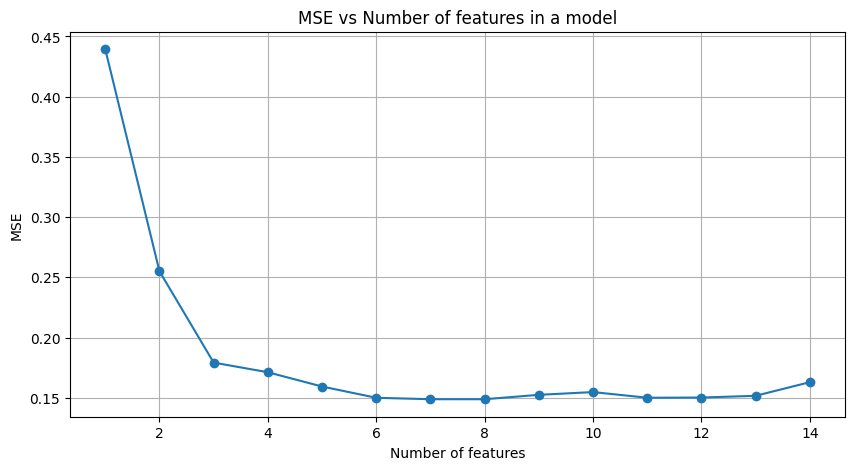

In [227]:
best_feature_subset_fs_xgboost_asia_new, errors_fs_xgboost_asia_new = find_best_subset_forward_stepwise_parallel(X_asia_new_train, y_asia_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_asia_new)

Here, **MSE decreases meaningfully** until the **sixth feature is added**, after which its value remains **relatively stable with some fluctuations**.  

* The **newly introduced features** mostly **did not achieve significant influence** and were **not selected**. Unfortunately, the feature **'Generosity x Social support'**, which had the **potential to be important** (due to the significance of its two composing features in this region), was **added to the model as the last feature**.  
* The **only newly added feature** that made it into the model was **'GDP / mean GDP for year'**. However, **Log GDP per capita** was also included as the **sixth feature**. We are therefore curious to see **which of them will have a higher importance** in the final model.  
* The **remaining selected features** were also **present in the original five-feature model**.  

Now, let's examine the results of an **XGBoost model with six features**.


In [228]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]
best_6_asia_new_xgboost = ['GDP / mean GDP for year', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Freedom to make life choices', 'Log GDP per capita']


best_depth, best_learning_rate = perform_cross_validation_xgboost(X_asia_new_train.loc[:, best_6_asia_new_xgboost], y_asia_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_asia_new_train.loc[:, best_6_asia_new_xgboost], y_asia_new_train, X_asia_new_test.loc[:, best_6_asia_new_xgboost], y_asia_new_test, additional_title=' Asia, XGBoost, new features, best 6 features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.6007
Column 'Positive affect': 0.1198
Column 'Healthy life expectancy at birth': 0.0982
Column 'Social support': 0.0864
Column 'Freedom to make life choices': 0.0533
Column 'GDP / mean GDP for year': 0.0417


Results on train set Asia, XGBoost, new features, best 6 features
MSE: 0.0008
R2: 0.99895

Results on test set Asia, XGBoost, new features, best 6 features
MSE: 0.13076
R2: 0.78695


We observe that **adding additional information** to the **boosting model** in the form of a **new feature** improved the **$R^{2}$ on the test set** by as much as **0.05** compared to the **model based on five original features**.  

* **Log GDP per capita** turned out to be a **much more important feature** than **GDP / mean GDP per capita**, despite the latter being **included in the model first**. It is possible that **GDP / mean GDP per capita** performs **slightly better on its own**, but when **combined with other features**, **Log GDP per capita provides greater information gain** or at least a **very similar one**, but it was **chosen much more frequently**.  
* However, we can see that **after adding the sixth feature**, the influence of **Log GDP per capita** **increased significantly**, reaching **60% importance**, primarily **at the expense of Positive affect** (which remains the **second most important variable**, but with a **significantly lower importance**).  
* **Healthy life expectancy at birth** had **only slightly more influence than Social support**.  

### Summary  
Many of the **added features did not have a significant impact** on **happiness in Asia**.  

* The **biggest impact** came from **GDP / mean GDP for year**, but we can see that **when considered alongside other features**, it carried **much less information than the original variable**.  
* We also observed a **possible greater influence** of **Healthy square** compared to the **previously used Healthy life expectancy at birth**. This might suggest a **nonlinear relationship between healthy life expectancy and happiness**, though these results **were not replicated in the boosting model**.  
* **Generosity x Social support**, despite being an **interaction between features that have a relatively large impact in this region**, **did not prove to be significant**.  
* The relationships **Positive / Negative** and **Freedom * (1 - Corruption)** **did not play a major role** in these models.  

## Oceania  
The next continent we will analyze is **Oceania**. However, due to the **small amount of data** available for this continent, the results **may not be the most representative**.  

Since there are **only two countries** in the dataset for this region, we **carefully selected** the **training and test set split** so that the **test set contains an equal number of observations from both countries**. However, with such a **small dataset**, we observe that the **initial data split** has a **significant impact on the metric values**.  

Nevertheless, we will **normalize the dataset**, **split it**, and evaluate how the **models perform** on this data.  


In [229]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_oceania_x = df_oceania.loc[:, x_number_columns]
y_oceania = df_oceania.loc[:, y_column]

scaler = MinMaxScaler()
df_oceania_x = pd.DataFrame(scaler.fit_transform(df_oceania_x), columns=df_oceania_x.columns, index=df_oceania_x.index)

X_oceania_train, X_oceania_test, y_oceania_train, y_oceania_test = train_test_split(df_oceania_x, y_oceania, test_size=0.2, random_state=2)

model = LinearRegression()
train_and_evaluate_model(model, X_oceania_train.loc[:, :], y_oceania_train, X_oceania_test.loc[:, :], y_oceania_test, additional_title=' for Oceania')

Feature weights:
Column 'year': -0.4321
Column 'Log GDP per capita': 0.3656
Column 'Positive affect': 0.3556
Column 'Social support': 0.2027
Column 'Perceptions of corruption': -0.1606
Column 'Healthy life expectancy at birth': 0.1165
Column 'Negative affect': -0.0524
Column 'Generosity': -0.0158
Column 'Freedom to make life choices': 0.0045


Results on train set for Oceania
MSE: 0.00509
R2: 0.7312

Results on test set for Oceania
MSE: 0.00334
R2: 0.73153


We observe that the **$R^{2}$ metric** has a **similar value** on both sets, reaching **0.73**.  

* Interestingly, the **most influential variable** (in terms of absolute weight) is **year**, which was **often eliminated** in previous datasets. This aligns with the **correlation matrix**, where **year** had the highest correlation with the target variable. Since the **target variable in Oceania has a small range of variability** and generally holds **some of the highest values**, we can assume that people in this region are **generally happy**, and **changes in other factors** present in the dataset are **not significant enough** to strongly affect happiness levels. Therefore, if we observe a **downward trend in happiness over time** without substantial shifts in other features, it turns out that **year itself plays the most significant role**.  
* The **year variable has a negative weight**, suggesting that **citizens of Oceania are becoming less happy each year**.  
* The **second and third most important features** for this model are **Log GDP per capita** and **Positive affect**, both of which are also **important on a global scale**.  
* The **least significant features** are **Freedom to make life choices** and **Generosity**, as they **do not strongly influence** happiness variations. Interestingly, **higher Generosity correlates with lower Life Ladder scores**.  

Next, we will apply **regularization methods** and observe whether they introduce significant changes.  


Best value of alpha: 0.7847599703514591


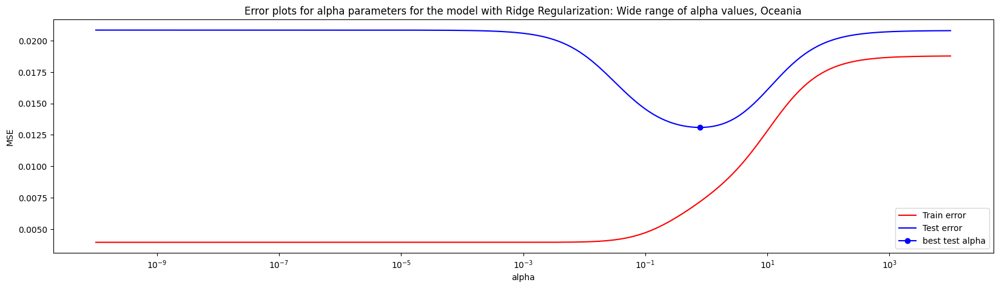

In [230]:
alpha_values = np.logspace(-10, 4, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_oceania_train.loc[:, :], y_oceania_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Oceania')

By applying **regularization** to the **Oceania dataset**, we observe a **much more pronounced U-shape** in the error curve compared to other datasets.  

* Initially, the **test set error remains relatively stable**, but after **alpha exceeds approximately $10^{-3}$**, we can see a **significant drop** in test set error and an **increase** in training set error.  
* When **alpha surpasses 6**, **errors on both sets start to rise**, and the **test set error stabilizes** at a level similar to the initial one.  
* Since this dataset contains **significantly fewer records**, there is a chance that **regularization will achieve better results** compared to other datasets.  

Now, let's **find the optimal alpha value** that **minimizes the mean squared error (MSE)** and test the model.  


In [231]:
alpha_values = np.logspace(-1, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_oceania_train.loc[:, :], y_oceania_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_oceania_train, y_oceania_train, X_oceania_test, y_oceania_test, additional_title=' Oceania with Ridge Regularization:')

Best value of alpha: 0.785045620020451
Feature weights:
Column 'year': -0.16
Column 'Positive affect': 0.1182
Column 'Freedom to make life choices': 0.0952
Column 'Social support': 0.0779
Column 'Generosity': 0.0442
Column 'Log GDP per capita': 0.0433
Column 'Negative affect': -0.0319
Column 'Healthy life expectancy at birth': -0.0118
Column 'Perceptions of corruption': 0.0087


Results on train set Oceania with Ridge Regularization:
MSE: 0.00746
R2: 0.60569

Results on test set Oceania with Ridge Regularization:
MSE: 0.00176
R2: 0.85862


At a considerable cost to the $R^{2}$ metric on the training set, the model's ability to generalize on the test set has improved. However, it is important to remember that with such a small number of records, the division into training and test sets has a significant impact on the results.
* The variable **year** remains the most significant. The overall level of happiness in Oceania decreases over time.
* **Positive affect** continues to be an important factor influencing happiness, but we observe that **Log GDP per capita** has lost its previous impact.
* An interesting observation is the increased importance of **Freedom to make life choices**, which was the least significant feature in the previous model. Comparing this with the correlation matrix, this variable appears to have a relatively strong influence on the target variable.
* Other features have a smaller impact on **Life Ladder**.
* For people living in Oceania, the influence of **Perceptions of corruption** on **Life Ladder** is very low. This may be due to the fact that in this part of the world, governments are not generally perceived as corrupt, so small changes in this indicator do not strongly affect the target variable. Moreover, the coefficient for this variable is positive, suggesting that the higher the perception of corruption, the slightly higher the level of happiness.
* **Healthy life expectancy** has a low impact on the target variable. Interestingly, its effect is negative, which aligns with the correlation matrix analysis, where this variable had a relatively strong negative correlation with the outcome. This would suggest that in Oceania, the longer the expected healthy lifespan, the lower the reported happiness. However, it is important to note that the variability of this feature is very low on this continent, so no far-reaching conclusions should be drawn from this observation.

We will now compare these results with L1 regularization.


Best value of alpha: 0.004356099030694599


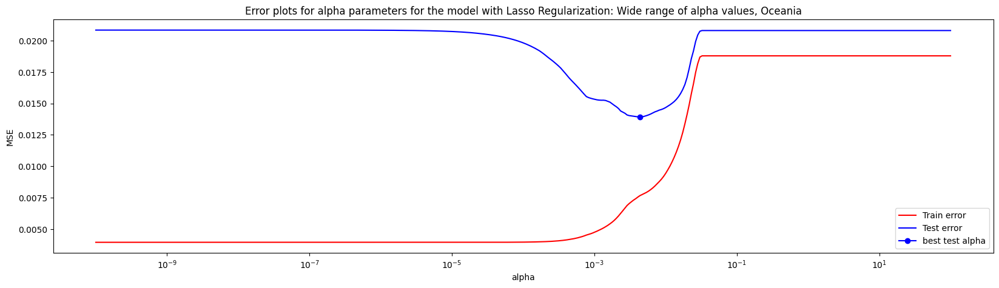

In [232]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_oceania_train.loc[:, :], y_oceania_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Oceania')

With Lasso regularization, we can also observe a more pronounced valley. Interestingly, as more parameters are eliminated, the error on the test set returns to the level it had without regularization.


In [233]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_oceania_train.loc[:, :], y_oceania_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_oceania_train.loc[:, :], y_oceania_train, X_oceania_test.loc[:, :], y_oceania_test, additional_title=' Oceania with Lasso Regularization:')

Best value of alpha: 0.004242556430717777
Feature weights:
Column 'year': -0.2291
Column 'Freedom to make life choices': 0.0916
Column 'Positive affect': 0.062
Column 'Log GDP per capita': 0.0
Column 'Social support': 0.0
Column 'Healthy life expectancy at birth': -0.0
Column 'Generosity': 0.0
Column 'Perceptions of corruption': -0.0
Column 'Negative affect': -0.0


Results on train set Oceania with Lasso Regularization:
MSE: 0.00814
R2: 0.56957

Results on test set Oceania with Lasso Regularization:
MSE: 0.0044
R2: 0.64573


L1 regularization eliminated a significant number of parameters. Out of the initial nine, only three remained: **year**, **Freedom to make life choices**, and **Positive affect**. However, we can observe that the metrics have deteriorated, which may be due to the way the dataset was split into training and test sets. Nevertheless, we can see that **year** remains the most important variable, and over time, the level of happiness in Oceania decreases. However, according to this model, the inhabitants of this region value **Freedom to make life choices** and **Positive affect**.

We can compare these results with a random forest regressor.


In [234]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_oceania_train, y_oceania_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_oceania_train, y_oceania_train, X_oceania_test, y_oceania_test, additional_title=' Random Forest, Oceania', is_forest_reg=True)

Best value of max_depth: 6
Best value of min_samples_leaf: 2
Feature importances:
Column 'year': 0.3111
Column 'Freedom to make life choices': 0.2531
Column 'Social support': 0.1113
Column 'Generosity': 0.0894
Column 'Healthy life expectancy at birth': 0.0719
Column 'Negative affect': 0.0617
Column 'Positive affect': 0.0594
Column 'Perceptions of corruption': 0.0291
Column 'Log GDP per capita': 0.0129

Mean depth of trees: 5.01


Results on train set Random Forest, Oceania
MSE: 0.00354
R2: 0.81303

Results on test set Random Forest, Oceania
MSE: 0.00119
R2: 0.90398


The random forest regressor was able to fit the input data very well while also achieving strong generalization ability. The model accomplished this with a low average tree depth. For the first time in this project, the cross-validation process led to an increase in the hyperparameter **min_samples_leaf** to two. However, this could be due to a favorable fit to the data split.

* The most important feature remained **year** – with 31% importance.
* The second most important variable turned out to be **Freedom to make life choices**, which was also highly ranked in the Ridge regression model and was not removed in the Lasso model. It has a similar importance level, reaching 30%. This is the first instance in this project where two variables have the highest influence.
* Interestingly, according to this model, **Positive affect** and **Log GDP per capita** rank at the bottom, even though **Positive affect** was the second most important feature in the Ridge model.
* In this model, **Generosity**, **Social Support**, and **Negative affect** gained relatively high importance.
* The low impact of **Perceptions of corruption** is consistent across models.

We can compare these results with the boosting method.


In [235]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_oceania_train, y_oceania_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_oceania_train, y_oceania_train, X_oceania_test, y_oceania_test, additional_title=' XGBoost, Oceania', is_xgboost=True)

Best value of max_depth: 3
Best value of learning_rate: 0.01
Feature importances:
Column 'year': 0.4366
Column 'Social support': 0.1453
Column 'Healthy life expectancy at birth': 0.1186
Column 'Freedom to make life choices': 0.0873
Column 'Log GDP per capita': 0.0603
Column 'Generosity': 0.0562
Column 'Perceptions of corruption': 0.0377
Column 'Positive affect': 0.0316
Column 'Negative affect': 0.0264


Results on train set XGBoost, Oceania
MSE: 0.00633
R2: 0.66552

Results on test set XGBoost, Oceania
MSE: 0.00733
R2: 0.41058


The boosting method performed significantly worse on this task compared to bagging. While the bias was slightly reduced, the model's variance increased, resulting in an **$R^{2}$** score of 0.41. Of course, this could have been influenced by an initial data split that was less favorable for this algorithm, which is likely given the small number of samples.

* The boosting algorithm also identified **year** as the most important variable, assigning it an influence of 43%.
* Boosting suggests the importance of **Social support**, which was also significant in the bagging model.
* The model indicates that **Healthy life expectancy at birth** is important, although it was slightly less influential in the bagging model.
* The least important features according to this model are the levels of experienced emotions and **Perceptions of corruption**. Corruption levels in Oceania are already low, so its impact on the target variable may indeed be minimal.
* Similar to the random forest model, **Log GDP per capita** does not have high importance in this model either.

Next, we will examine which features can be selected using feature selection algorithms.


In [236]:
lasso_feature_selection(X_oceania_train, y_oceania_train)

Alpha: 0.0005 - Excluded: Healthy life expectancy at birth
Alpha: 0.0005 - Excluded: Generosity
Alpha: 0.0012 - Excluded: Perceptions of corruption
Alpha: 0.0022 - Excluded: Negative affect
Alpha: 0.0028 - Excluded: Log GDP per capita
Alpha: 0.0034 - Excluded: Social support
Alpha: 0.0118 - Excluded: Freedom to make life choices
Alpha: 0.0135 - Excluded: Positive affect
Alpha: 0.0283 - Excluded: year

All features have been excluded.


The first feature to be eliminated was **Healthy life expectancy at birth**, followed by **Generosity**.  

Comparing these results with the coefficients from multiple regression, we can see that only the positions of **year** and **Social support** remain consistent. **Log GDP per capita** was quickly excluded.  

We can now compare this with forward stepwise selection.


In [237]:
best_subset_f_stepwise_oceania = find_best_subset_forward_stepwise(X_oceania_train, y_oceania_train)

Best model for 1 features with MSE:  0.012 is: ['year'].
Best model for 2 features with MSE:  0.0116 is: ['year', 'Positive affect'].
Best model for 3 features with MSE:  0.0109 is: ['year', 'Positive affect', 'Log GDP per capita'].
Best model for 4 features with MSE:  0.0097 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support'].
Best model for 5 features with MSE:  0.0094 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption'].
Best model for 6 features with MSE:  0.01 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Negative affect'].
Best model for 7 features with MSE:  0.0118 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Negative affect', 'Generosity'].
Best model for 8 features with MSE:  0.0153 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Negative affect'

Eliminating features using forward stepwise selection maintains a hierarchy similar to the weight values in multiple regression.  

The least significant features are **Freedom to make life choices**, **Generosity**, **Healthy life expectancy at birth**, and **Negative affect**, while the most important variables are **year**, **Positive affect**, **Log GDP per capita**, and **Social support**.


Best model for 1 features with MSE:  0.012 is: ['year'].
Best model for 2 features with MSE:  0.0116 is: ['year', 'Positive affect'].
Best model for 3 features with MSE:  0.0109 is: ['year', 'Log GDP per capita', 'Positive affect'].
Best model for 4 features with MSE:  0.0097 is: ['year', 'Log GDP per capita', 'Social support', 'Positive affect'].
Best model for 5 features with MSE:  0.0094 is: ['year', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect'].
Best model for 6 features with MSE:  0.01 is: ['year', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.0118 is: ['year', 'Log GDP per capita', 'Social support', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 8 features with MSE:  0.0153 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of

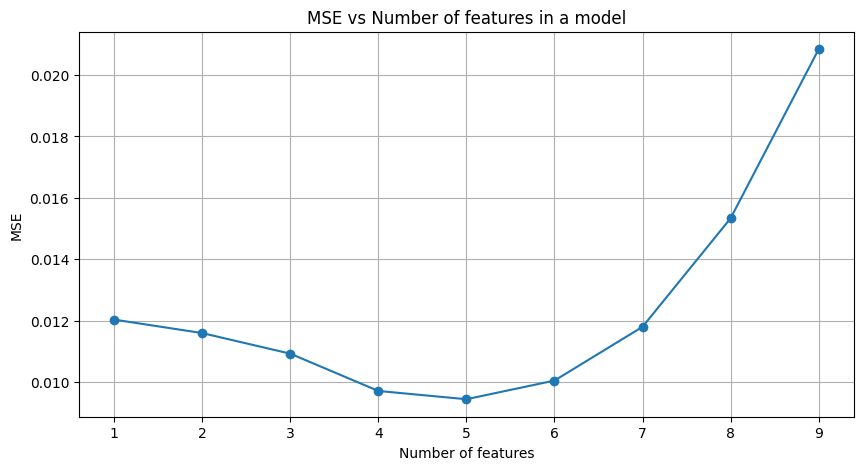

In [238]:
best_subset_par_oceania, errors_par_oceania = find_best_feature_subset_parallel(X_oceania_train, y_oceania_train)
elbow_plot(errors_par_oceania)

Both of the above algorithms arrived at the same result. Based on cross-validation, the model error is minimized using the following five features: **['year', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect']**.  

What might be surprising is the presence of **Perceptions of corruption**, which did not seem to have a significant impact in previous models. Since the decrease in error between 4 and 5 features is not substantial, we will proceed with further analysis using a model consisting of 4 features: **['year', 'Log GDP per capita', 'Social support', 'Positive affect']**.  

Interestingly, the plot shows that adding more features increases the MSE beyond that of the single-feature model.


In [239]:
best_4_oceania = ['year', 'Positive affect', 'Log GDP per capita', 'Social support']

model = LinearRegression()
train_and_evaluate_model(model, X_oceania_train.loc[:, best_4_oceania], y_oceania_train, X_oceania_test.loc[:, best_4_oceania], y_oceania_test, additional_title=' for Oceania, best 4 features')

Feature weights:
Column 'Positive affect': 0.4017
Column 'Log GDP per capita': 0.3478
Column 'year': -0.3007
Column 'Social support': 0.2427


Results on train set for Oceania, best 4 features
MSE: 0.00579
R2: 0.69372

Results on test set for Oceania, best 4 features
MSE: 0.00511
R2: 0.58885


Despite good results during cross-validation, the model performed worse on the test set, which may again be due to the initial data split.  

* The **year** variable is no longer the most important feature in this model. **Positive affect** and **Log GDP per capita** have greater significance.  

Let's check if we can improve these results using regularization.


Best value of alpha: 0.05647805074067546


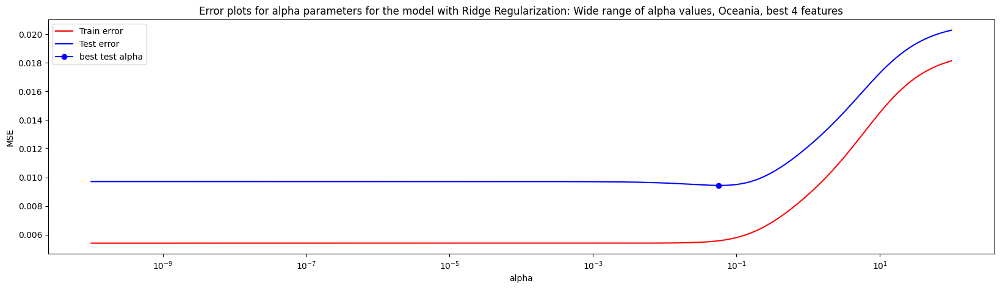

In [240]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_oceania_train.loc[:, best_4_oceania], y_oceania_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, Oceania, best 4 features')

In [241]:
alpha_values = np.logspace(-2, -1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_oceania_train.loc[:, best_4_oceania], y_oceania_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_oceania_train.loc[:, best_4_oceania], y_oceania_train, X_oceania_test.loc[:, best_4_oceania], y_oceania_test, additional_title=' Oceania with Ridge Regularization, 4 best features:')

Best value of alpha: 0.05817880074344935
Feature weights:
Column 'Positive affect': 0.3399
Column 'year': -0.2911
Column 'Log GDP per capita': 0.2808
Column 'Social support': 0.2035


Results on train set Oceania with Ridge Regularization, 4 best features:
MSE: 0.0059
R2: 0.68796

Results on test set Oceania with Ridge Regularization, 4 best features:
MSE: 0.00456
R2: 0.63328


The results have improved slightly, but the difference is not very significant.  

* The most important feature remains **Positive affect**.  
* The **year** variable has become the second most important feature, surpassing **Log GDP per capita**.  

We will compare these results with L1 regularization.

Best value of alpha: 0.00027295447924020015


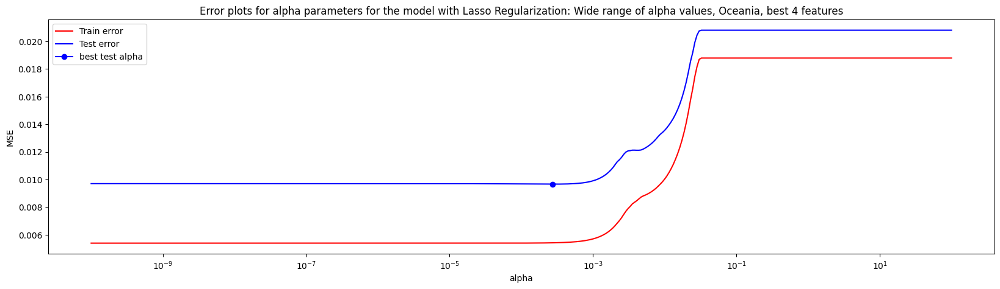

In [242]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_oceania_train.loc[:, best_4_oceania], y_oceania_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, Oceania, best 4 features')

In [243]:
alpha_values = np.logspace(-4, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_oceania_train.loc[:, best_4_oceania], y_oceania_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_oceania_train.loc[:, best_4_oceania], y_oceania_train, X_oceania_test.loc[:, best_4_oceania], y_oceania_test, additional_title=' Oceania with Lasso Regularization for 4 best features:')

Best value of alpha: 0.00027254325312810277
Feature weights:
Column 'Positive affect': 0.3753
Column 'Log GDP per capita': 0.3183
Column 'year': -0.2971
Column 'Social support': 0.222


Results on train set Oceania with Lasso Regularization for 4 best features:
MSE: 0.00582
R2: 0.69256

Results on test set Oceania with Lasso Regularization for 4 best features:
MSE: 0.00485
R2: 0.6095


L1 regularization slightly improved the results compared to the model without regularization, but the change is not significant. L2 regularization performed better. The feature hierarchy remains the same as in the model without regularization.  

We will compare the results with a random forest regressor, selecting the appropriate features for it.


Best model for 1 features with MSE:  0.0162 is: ['Generosity'].
Best model for 2 features with MSE:  0.0127 is: ['Generosity', 'Negative affect'].
Best model for 3 features with MSE:  0.0124 is: ['year', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 4 features with MSE:  0.0119 is: ['year', 'Social support', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 5 features with MSE:  0.0124 is: ['year', 'Healthy life expectancy at birth', 'Generosity', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.012 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.0126 is: ['year', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 8 features with MSE:  0.0136 is: ['year', 'Log GDP per capita', 'Social support', 'H

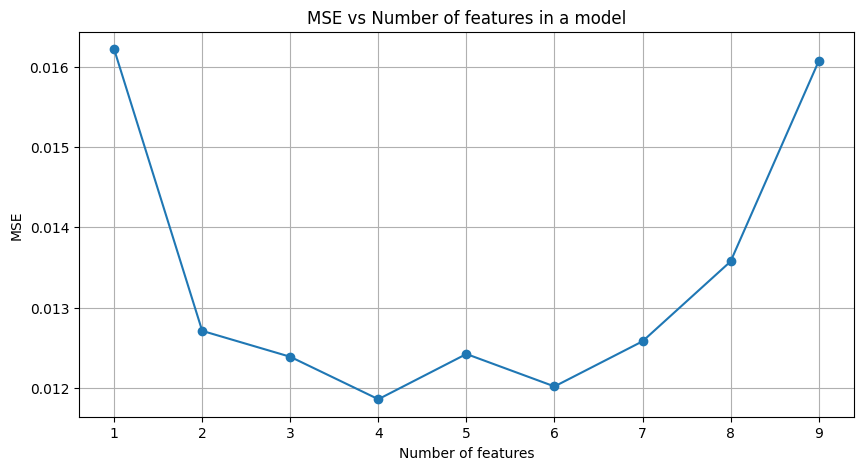

In [244]:
best_subset_par_oceania_forest, errors_par_oceania_forest = find_best_feature_subset_parallel(X_oceania_train, y_oceania_train, is_forest_reg=True)
elbow_plot(errors_par_oceania_forest)

The presented plot behaves much more chaotically than the previous ones. The MSE first decreases, then jumps up, decreases again, and rises once more to a level where the MSE for a single-variable set is close to that for nine variables. These fluctuations may be due to the small number of records in both datasets.

* The algorithm selected four features as the optimal number for minimizing the mean squared error. We will use this set of variables in the following analyses.
* Despite the previously observed significant influence of the **year** variable for Oceania, it was only the third feature added to the set. The single variable that minimized the MSE was **Generosity**, which, however, was not included in the final set of four variables.
* Even though **Freedom to make life choices** and **Generosity** were quite influential in the bagging algorithm when considering all features, this model did not include them in the selection of the best features.


In [245]:
best_4_oceania_forest = ['year', 'Social support', 'Healthy life expectancy at birth', 'Negative affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_oceania_train.loc[:, best_4_oceania_forest], y_oceania_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_oceania_train.loc[:, best_4_oceania_forest], y_oceania_train, X_oceania_test.loc[:, best_4_oceania_forest], y_oceania_test, additional_title=' Random Forest, Oceania, Best 4 features', is_forest_reg=True)

Best value of max_depth: 6
Best value of min_samples_leaf: 2
Feature importances:
Column 'year': 0.5921
Column 'Healthy life expectancy at birth': 0.1552
Column 'Social support': 0.1542
Column 'Negative affect': 0.0984

Mean depth of trees: 5.25


Results on train set Random Forest, Oceania, Best 4 features
MSE: 0.00331
R2: 0.8252

Results on test set Random Forest, Oceania, Best 4 features
MSE: 0.00312
R2: 0.74865


We can see that, despite the fact that the set of four features was supposedly minimizing the mean squared error, the $R^{2}$ on the test set dropped by approximately 0.15. This is a significant loss, indicating that to properly describe this problem, we should use a larger number of features in our model. Unfortunately, due to the small dataset size, the results are highly dependent on the specific data splits. Therefore, it is difficult to draw far-reaching conclusions from these findings.

* However, these results confirm the importance of the **year** variable in Oceania. For this model, it achieved 59% importance.
* **Healthy life expectancy at birth** and **Social support** have a similar impact on the target variable—approximately 15%.
* **Negative affect** reached an importance level of 10% within this feature set.

We will compare these results with the boosting method.


Best model for 1 features with MSE:  0.0202 is: ['year'].
Best model for 2 features with MSE:  0.0164 is: ['year', 'Social support'].
Best model for 3 features with MSE:  0.0154 is: ['Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 4 features with MSE:  0.0146 is: ['Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 5 features with MSE:  0.0147 is: ['year', 'Social support', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.0157 is: ['year', 'Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 7 features with MSE:  0.0161 is: ['year', 'Log GDP per capita', 'Social support', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 8 features with MSE:  0.0166 is: ['year', 'Log GDP per capita', 'Social support', 'Freedom to make life

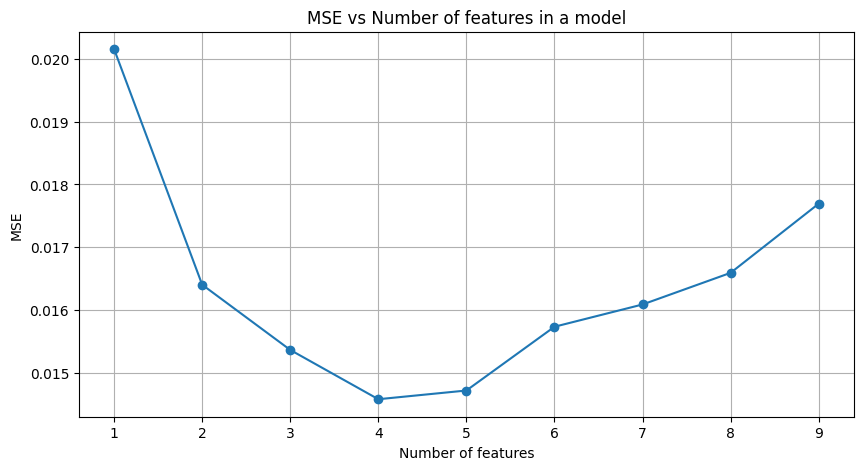

In [246]:
best_subset_par_oceania_xgb, errors_par_oceania_xgb = find_best_feature_subset_parallel(X_oceania_train, y_oceania_train, is_xgboost=True)
elbow_plot(errors_par_oceania_xgb)

Here, too, the best subset of features selected was a four-element subset: ['**Generosity**', '**Perceptions of corruption**', '**Positive affect**', '**Negative affect**']. Interestingly, this set is entirely different from the one selected for bagging, with only one common feature—**Negative affect**.

* Despite its significant impact in previous models, the **year** variable was not included here, which was surprising.


In [247]:
best_4_oceania_xgb = ['Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_oceania_train.loc[:, best_4_oceania_xgb], y_oceania_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_oceania_train.loc[:, best_4_oceania_xgb], y_oceania_train, X_oceania_test.loc[:, best_4_oceania_xgb], y_oceania_test, additional_title=' XGBoost, Oceania best 4 features', is_xgboost=True)

Best value of max_depth: 4
Best value of learning_rate: 0.5
Feature importances:
Column 'Generosity': 0.7112
Column 'Negative affect': 0.1755
Column 'Positive affect': 0.0595
Column 'Perceptions of corruption': 0.0538


Results on train set XGBoost, Oceania best 4 features
MSE: 0.0
R2: 0.99998

Results on test set XGBoost, Oceania best 4 features
MSE: 0.00714
R2: 0.42522


* We can see that the $R^{2}$ metric improved by approximately 0.01. Despite the algorithm reducing the training error to zero, the variance remains high, and this model could not be reliably used for prediction.
* The algorithm determined the importance of **Generosity** at 71%. This is a very high value, especially considering that it did not play the most significant role previously.
* **Negative affect** is the second most important feature for this algorithm, with 17% importance.
* **Positive affect** and **Perceptions of corruption** have a minor influence of 5%.

After analyzing the dataset from Oceania, it can be concluded that there is too little data in this region to reliably assess happiness. The results heavily depend on the split between the training and test sets, and feature importance rankings vary significantly depending on the algorithm, often yielding different results. Some potential conclusions:

* Due to the generally high level of happiness in Oceania, changes in individual factors may have little impact on overall happiness, which could be relatively stable in this region. Because of this, the most influential variable on happiness in Oceania appears to be simply the passage of time. This suggests that as time progresses, people in Oceania are becoming slightly less happy. Of course, this could also be due to events or processes in this part of the world that are unknown and not accounted for in this dataset.
* Based on the **random forest model**, we can assume that **Freedom to make life choices** also has a significant impact on **Life Ladder**, indicating that people in Oceania value their ability to make decisions. For example, in Australia, people might highly value the ability to decide on relocating. Such decisions can be associated with significant pressure due to the vast distances in the country.
* Some models also suggest a relatively high influence of **Social support** and **Generosity**. However, the importance of these features varied considerably depending on the model.
* **Perceptions of corruption** was one of the less important features. Since corruption perception in Oceania is relatively stable, minor changes in this metric may not significantly affect happiness levels. Changes in other factors seem to have a greater impact on happiness.

### Oceania - Feature Engineering
By creating new features, we will examine whether they influence happiness in Oceania. The same additional features as before will be included.


In [248]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_oceania_new = df_oceania.loc[:, x_number_columns]
y_oceania_new = df_oceania.loc[:, y_column]

mean_gdp_per_year_oceania = df_oceania_new.groupby('year')["Log GDP per capita"].transform('mean')
df_oceania_new["GDP / mean GDP for year"] = df_oceania_new["Log GDP per capita"] / mean_gdp_per_year_oceania


df_oceania_new['Freedom x (1-Corruption)'] = df_oceania_new['Freedom to make life choices'] * (1 - df_oceania_new['Perceptions of corruption'])
df_oceania_new['Positive / Negative'] = df_oceania_new['Positive affect'] / df_oceania_new['Negative affect']
df_oceania_new['Healthy square'] = np.pow(df_oceania_new['Healthy life expectancy at birth'], 2)

df_oceania_new['Generosity_shifted'] = df_oceania_new['Generosity'] - df_oceania_new['Generosity'].min()
df_oceania_new['Generosity x Social support'] = df_oceania_new['Generosity_shifted'] * df_oceania_new['Social support']
df_oceania_new = df_oceania_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_oceania_new = pd.DataFrame(scaler.fit_transform(df_oceania_new), columns=df_oceania_new.columns, index=df_oceania_new.index)

df_oceania_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
81,0.000000,0.410550,0.785975,0.054055,0.879223,0.616028,0.569193,0.537293,0.895100,0.500000,0.480035,0.143957,0.053518,0.616577
82,0.111111,0.514057,0.757191,0.162161,0.505842,0.910863,0.909168,0.474402,0.660912,0.867743,0.121169,0.281375,0.160734,0.909212
83,0.166667,0.562083,0.552082,0.216217,0.717028,0.744466,0.681610,0.193813,0.692707,0.966960,0.351296,0.190396,0.214437,0.728766
84,0.277778,0.575486,0.638835,0.324322,0.854651,0.789957,0.501599,0.469446,0.709716,1.000000,0.535161,0.246023,0.322021,0.779738
85,0.333333,0.606616,0.776480,0.378378,0.960263,1.000000,0.545137,0.152877,0.453949,0.986641,0.517096,0.356688,0.375908,1.000000
86,0.388889,0.673176,0.529678,0.432433,0.880681,0.618163,0.507511,0.186233,0.651056,0.996374,0.535084,0.216715,0.429856,0.603824
87,0.444444,0.699549,0.349295,0.486489,0.865784,0.598813,0.683638,0.540467,0.266058,0.964357,0.376040,0.644540,0.483865,0.574772
88,0.500000,0.733270,0.300810,0.540539,0.777715,0.797259,0.712810,0.284977,0.970459,0.935387,0.334783,0.045834,0.537931,0.761618
89,0.555556,0.755350,0.609589,0.594594,0.768769,0.850598,0.474958,0.366584,0.601865,0.908935,0.541417,0.297299,0.592063,0.837257
90,0.611111,0.791541,0.504758,0.645273,0.772518,0.478272,0.591817,0.251960,0.875193,0.898704,0.439834,0.091313,0.642869,0.466058


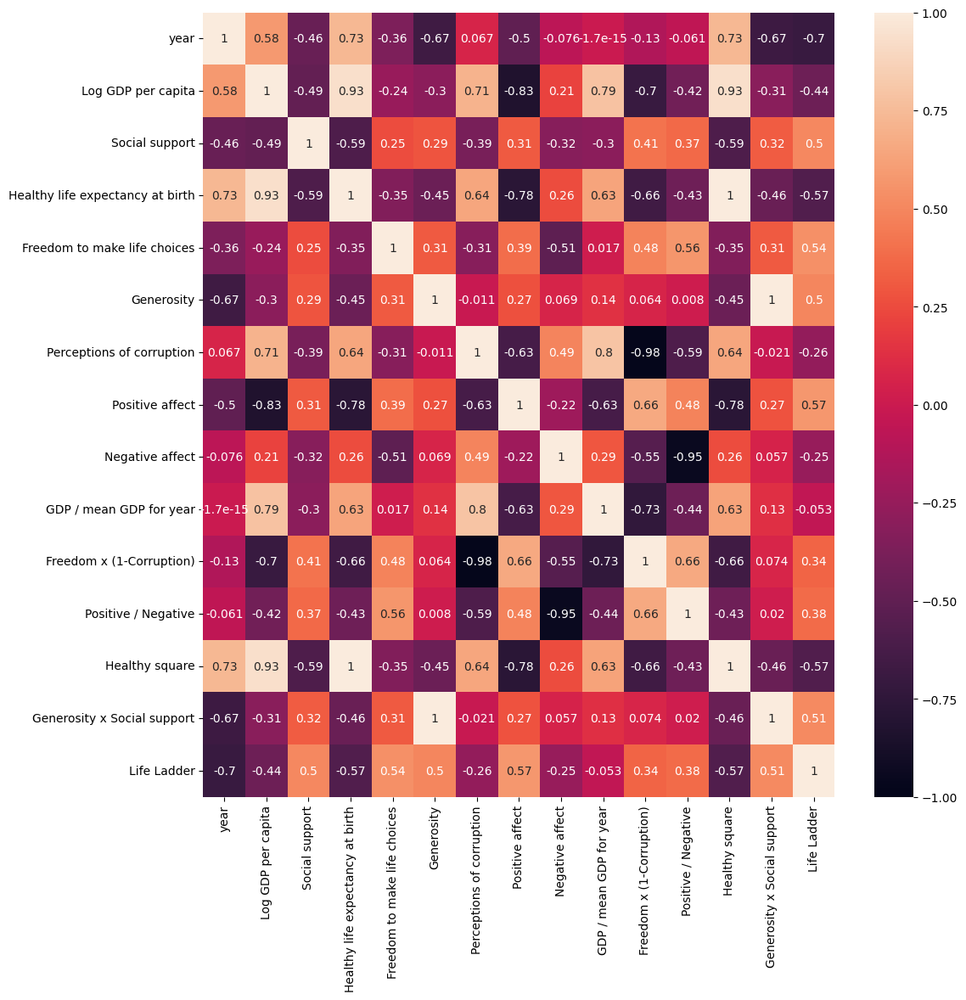

In [249]:
plt.figure(figsize=(12,12))
df_oceania_new_with_y = pd.concat([df_oceania_new, y_oceania_new], axis=1)
sns.heatmap(df_oceania_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* We can see that **GDP / mean GDP for year** now has almost zero correlation with the output. The yearly average was calculated from only two records. Although this may not have been the most representative approach, we will still examine this relationship just in case.
* The other created features exhibit similar relationships as before.

We will now test how the models perform with the new features.


In [250]:
X_oceania_new_train, X_oceania_new_test, y_oceania_new_train, y_oceania_new_test = train_test_split(df_oceania_new, y_oceania_new, test_size=0.2, random_state=2)

In [251]:
model = LinearRegression()
train_and_evaluate_model(model, X_oceania_new_train.loc[:, :], y_oceania_new_train, X_oceania_new_test.loc[:, :], y_oceania_new_test, additional_title=', Oceania new features')

Feature weights:
Column 'Healthy life expectancy at birth': 24.1958
Column 'Healthy square': -23.681
Column 'Freedom x (1-Corruption)': -2.6999
Column 'Perceptions of corruption': -2.544
Column 'year': -1.2415
Column 'Log GDP per capita': 1.2049
Column 'Generosity': -0.9583
Column 'Generosity x Social support': 0.9551
Column 'GDP / mean GDP for year': -0.6504
Column 'Freedom to make life choices': 0.6476
Column 'Positive / Negative': 0.4219
Column 'Negative affect': 0.3508
Column 'Positive affect': 0.3248
Column 'Social support': 0.1626


Results on train set, Oceania new features
MSE: 0.00284
R2: 0.84969

Results on test set, Oceania new features
MSE: 0.0265
R2: -1.1319


We observe that the **full model** has a negative $R^{2}$ value on the test set, meaning its predictions are worse than those of a hyperplane independent of these variables. Selecting appropriate **multiple regression coefficients** on the training set is not an easy task, especially when the number of observations is small relative to the number of features. 

Regularization methods might help us in this case, so we will test them below.


In [252]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_oceania_new_train.loc[:, :], y_oceania_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_oceania_new_train.loc[:, :], y_oceania_new_train, X_oceania_new_test.loc[:, :], y_oceania_new_test, additional_title=' Oceania, new features with Ridge Regularization:')

Best value of alpha: 1.3369837418249453
Feature weights:
Column 'year': -0.1056
Column 'Positive affect': 0.0954
Column 'GDP / mean GDP for year': 0.0648
Column 'Freedom to make life choices': 0.0626
Column 'Social support': 0.0561
Column 'Positive / Negative': 0.0387
Column 'Healthy square': -0.0275
Column 'Healthy life expectancy at birth': -0.0274
Column 'Generosity x Social support': 0.0256
Column 'Generosity': 0.0237
Column 'Negative affect': -0.0153
Column 'Freedom x (1-Corruption)': 0.0145
Column 'Log GDP per capita': -0.0043
Column 'Perceptions of corruption': -0.0041


Results on train set Oceania, new features with Ridge Regularization:
MSE: 0.00777
R2: 0.58905

Results on test set Oceania, new features with Ridge Regularization:
MSE: 0.00153
R2: 0.87699


Applying **L2 regularization** worked remarkably well in a scenario where we have a large number of features but few observations. Despite a significant decline in performance on the training set, we observe **very strong generalization ability**. Without regularization, we were unable to build a model with good generalization capacity. Compared to the previous model, after applying regularization, adding **five features** resulted in an increase of approximately **0.02 in $R^{2}$**.

* Once again, we can see that in Oceania, **year** is the most important variable.
* The third most significant feature for this model turned out to be **GDP / mean GDP for year**, achieving a much higher weight than **Log GDP per capita**.
* The other newly added features did not gain higher significance.

Next, we will evaluate the results of **L1 regularization**.


In [253]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_oceania_new_train.loc[:, :], y_oceania_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_oceania_new_train.loc[:, :], y_oceania_new_train, X_oceania_new_test.loc[:, :], y_oceania_new_test, additional_title=' Oceania, new features with Lasso Regularization:')

Best value of alpha: 0.004641588833612782
Feature weights:
Column 'year': -0.2268
Column 'Freedom to make life choices': 0.0863
Column 'Positive affect': 0.0601
Column 'GDP / mean GDP for year': 0.0006
Column 'Log GDP per capita': 0.0
Column 'Social support': 0.0
Column 'Healthy life expectancy at birth': -0.0
Column 'Generosity': 0.0
Column 'Perceptions of corruption': -0.0
Column 'Negative affect': -0.0
Column 'Freedom x (1-Corruption)': 0.0
Column 'Positive / Negative': 0.0
Column 'Healthy square': -0.0
Column 'Generosity x Social support': 0.0


Results on train set Oceania, new features with Lasso Regularization:
MSE: 0.00822
R2: 0.56544

Results on test set Oceania, new features with Lasso Regularization:
MSE: 0.00451
R2: 0.63722


L1 regularization achieved much lower $R^{2}$ values than **L2**, but it was still able to drastically improve generalization ability. However, we can see that this method eliminated most of the **features**, similar to when we considered only the original **features**. Back then, the algorithm retained only 3 **features**; now we can see that **'GDP / mean GDP for year'** has also been included. It is possible that it carries some important information. Below, we will check which **features** will be suggested by forward stepwise.


Best model for 1 features with MSE: 0.012 is: ['year'].
Best model for 2 features with MSE: 0.0116 is: ['year', 'Positive affect'].
Best model for 3 features with MSE: 0.0109 is: ['year', 'Positive affect', 'Log GDP per capita'].
Best model for 4 features with MSE: 0.0097 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support'].
Best model for 5 features with MSE: 0.0094 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption'].
Best model for 6 features with MSE: 0.0095 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'GDP / mean GDP for year'].
Best model for 7 features with MSE: 0.0102 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption', 'GDP / mean GDP for year', 'Positive / Negative'].
Best model for 8 features with MSE: 0.0107 is: ['year', 'Positive affect', 'Log GDP per capita', 'Social support', 'Perceptions of corruption'

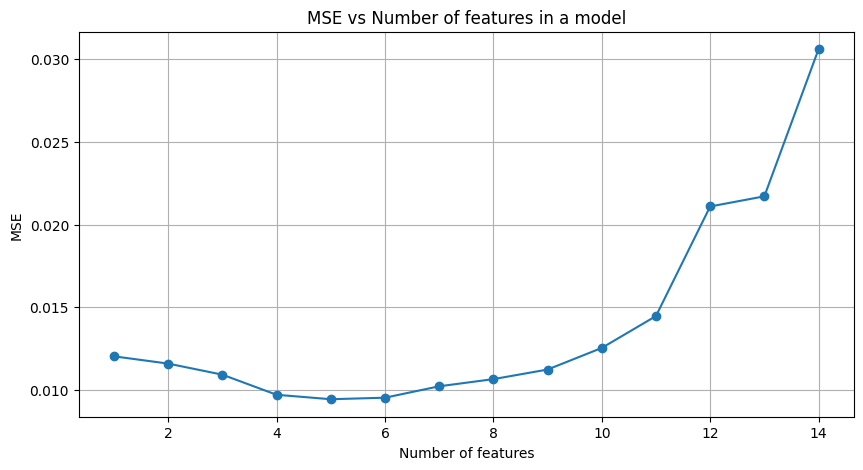

In [254]:
best_feature_subset_fs_oceania_new, errors_fs_oceania_new = find_best_subset_forward_stepwise_parallel(X_oceania_new_train, y_oceania_new_train)
elbow_plot(errors_fs_oceania_new)

Previously, we selected only 4 **features**, and this plot would also suggest such an approach. Additionally, we can see that none of the newly added **features** were even among the first 5 selected **features**—**'GDP / mean GDP for year'** was included only as the sixth. Adding the 5th and 6th **features** does not reduce **MSE**, so we will immediately proceed to evaluating the performance of the **random forest** model.  


In [255]:
depths = list(range(6,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_oceania_new_train.loc[:, :], y_oceania_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_oceania_new_train.loc[:, :], y_oceania_new_train, X_oceania_new_test.loc[:, :], y_oceania_new_test, additional_title=' Oceania, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 8
Best value of min_samples_leaf: 1
Feature importances:
Column 'Freedom to make life choices': 0.2937
Column 'year': 0.2773
Column 'Negative affect': 0.0633
Column 'Social support': 0.0621
Column 'Positive / Negative': 0.0514
Column 'Generosity x Social support': 0.0499
Column 'Healthy square': 0.0377
Column 'Generosity': 0.0368
Column 'GDP / mean GDP for year': 0.0363
Column 'Positive affect': 0.0315
Column 'Healthy life expectancy at birth': 0.0281
Column 'Log GDP per capita': 0.0132
Column 'Freedom x (1-Corruption)': 0.0094
Column 'Perceptions of corruption': 0.0094

Mean depth of trees: 7.45


Results on train set Oceania, Random Forest, new features
MSE: 0.00207
R2: 0.89075

Results on test set Oceania, Random Forest, new features
MSE: 0.00224
R2: 0.81963


Thanks to the new **features** and a higher average tree depth (by more than 2.5 levels), the algorithm was able to better fit the training set and achieved an **$R^{2}$** higher by 0.08 on it. At the same time, the metric value on the test set dropped by roughly the same amount. This suggests that the model is overfitting to the training set.  

* Compared to the model based on the original **features**, we can see that **Freedom to make life choices** achieved higher importance than the **year** variable. This strengthens the hypothesis about the significance of this **feature** in **Oceania**.  
* The newly added **features** are mostly ranked in the middle, with the highest being the ratio of **positive to negative emotions**. The lowest-ranked **feature** is **'Freedom x (1 - Corruption)'**.  

We will now check how the **feature selection algorithm** behaves and what subset it suggests.  


Best model for 1 features with MSE: 0.0162 is: ['Generosity'].
Best model for 2 features with MSE: 0.0127 is: ['Generosity', 'Negative affect'].
Best model for 3 features with MSE: 0.0121 is: ['Generosity', 'Negative affect', 'Generosity x Social support'].
Best model for 4 features with MSE: 0.013 is: ['Generosity', 'Negative affect', 'Generosity x Social support', 'year'].
Best model for 5 features with MSE: 0.0121 is: ['Generosity', 'Negative affect', 'Generosity x Social support', 'year', 'Healthy life expectancy at birth'].
Best model for 6 features with MSE: 0.0113 is: ['Generosity', 'Negative affect', 'Generosity x Social support', 'year', 'Healthy life expectancy at birth', 'Positive / Negative'].
Best model for 7 features with MSE: 0.013 is: ['Generosity', 'Negative affect', 'Generosity x Social support', 'year', 'Healthy life expectancy at birth', 'Positive / Negative', 'Healthy square'].
Best model for 8 features with MSE: 0.013 is: ['Generosity', 'Negative affect', 'Generos

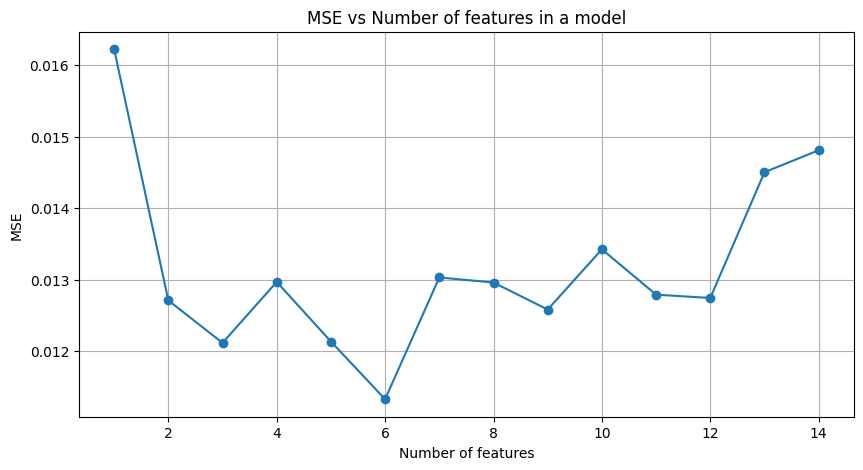

In [256]:
best_feature_subset_fs_oceania_new_forest, errors_fs_oceania_new_forest = find_best_subset_forward_stepwise_parallel(X_oceania_new_train, y_oceania_new_train, is_forest_reg=True)
elbow_plot(errors_fs_oceania_new_forest)

We can see that it is difficult to find a good **feature** subset for this dataset—adding new **features** sometimes decreases the error, while other times it increases it. It is possible that the **forward stepwise** algorithm did not yield the best results due to its greedy nature. However, using an algorithm that explores all possible subsets (even in a parallelized version) took a very long time.  

For testing purposes, we will evaluate the results for a dataframe composed of the 6 **features** selected here, mainly because it includes two **features** that we added: **'Generosity x Social support'** and **'Positive / Negative'**.  


In [257]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_6_forest_oceania_new = ['Generosity', 'Negative affect', 'Generosity x Social support', 'year', 'Healthy life expectancy at birth', 'Positive / Negative']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_oceania_new_train.loc[:, best_6_forest_oceania_new], y_oceania_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_oceania_new_train.loc[:, best_6_forest_oceania_new], y_oceania_new_train, X_oceania_new_test.loc[:, best_6_forest_oceania_new], y_oceania_new_test, additional_title=' Oceania Random Forest, new features, best 6 features', is_forest_reg=True)

Best value of max_depth: 5
Best value of min_samples_leaf: 1
Feature importances:
Column 'year': 0.5328
Column 'Negative affect': 0.1107
Column 'Positive / Negative': 0.1027
Column 'Healthy life expectancy at birth': 0.1008
Column 'Generosity x Social support': 0.0825
Column 'Generosity': 0.0704

Mean depth of trees: 5.0


Results on train set Oceania Random Forest, new features, best 6 features
MSE: 0.00161
R2: 0.91476

Results on test set Oceania Random Forest, new features, best 6 features
MSE: 0.00432
R2: 0.65226


The **random forest** algorithm, despite increasing the number of **features** by 2, achieved worse results on the test set, even though it performed better on the training set. This may suggest overfitting to the training data.  

* The most important **feature** in this algorithm remains **year**, with an importance of 53%.  
* We can see that **Social support** does not appear in this model. Instead, we observe the interaction **Generosity x Social support** and **Generosity** itself, which likely appears because it was selected first by the greedy algorithm and could not be replaced. However, these two **features** have the lowest impact.  
* There is a significant influence of **negative emotions** and the ratio of **positive to negative emotions**.  

It is difficult to draw far-reaching conclusions from this model. It has more **features** than before, yet its generalization ability is weaker. We will compare the results with **boosting**, which, however, may lead to even greater overfitting.  


In [258]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_oceania_new_train.loc[:, :], y_oceania_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_oceania_new_train.loc[:, :], y_oceania_new_train, X_oceania_new_test.loc[:, :], y_oceania_new_test, additional_title=' XGBoost, new features', is_xgboost=True)

Best value of max_depth: 3
Best value of learning_rate: 0.01
Feature importances:
Column 'year': 0.3948
Column 'Social support': 0.1359
Column 'Healthy life expectancy at birth': 0.1085
Column 'Freedom to make life choices': 0.0792
Column 'GDP / mean GDP for year': 0.0787
Column 'Generosity x Social support': 0.0755
Column 'Generosity': 0.0477
Column 'Positive affect': 0.0304
Column 'Positive / Negative': 0.0251
Column 'Negative affect': 0.0243
Column 'Log GDP per capita': 0.0
Column 'Perceptions of corruption': 0.0
Column 'Freedom x (1-Corruption)': 0.0
Column 'Healthy square': 0.0


Results on train set XGBoost, new features
MSE: 0.00618
R2: 0.6734

Results on test set XGBoost, new features
MSE: 0.00744
R2: 0.4013


Adding new **features** did not significantly change the metrics. **$R^{2}$** increased by 0.01 on the training set and decreased by 0.01 on the test set.  

However, we can see that the 4 most important **features** remained unchanged. The **features** we added were ranked only 5th and 6th in the **feature** importance hierarchy, yet they still have a relatively high importance of 7%.  

Additionally, we can observe that 4 **features** were considered largely insignificant by the model: **Log GDP per capita**, **Perceptions of corruption**, **Freedom x (1 - Corruption)**, and **Healthy square**.  

Below, we can see which **feature** subset will be suggested by **forward stepwise**.  


Best model for 1 features with MSE: 0.0188 is: ['Generosity x Social support'].
Best model for 2 features with MSE: 0.0144 is: ['Generosity x Social support', 'Positive affect'].
Best model for 3 features with MSE: 0.0133 is: ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption'].
Best model for 4 features with MSE: 0.0131 is: ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect'].
Best model for 5 features with MSE: 0.0131 is: ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect', 'Generosity'].
Best model for 6 features with MSE: 0.0134 is: ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect', 'Generosity', 'GDP / mean GDP for year'].
Best model for 7 features with MSE: 0.014 is: ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect', 'Generosity', 'GDP / mean GDP for year', 'Log GDP pe

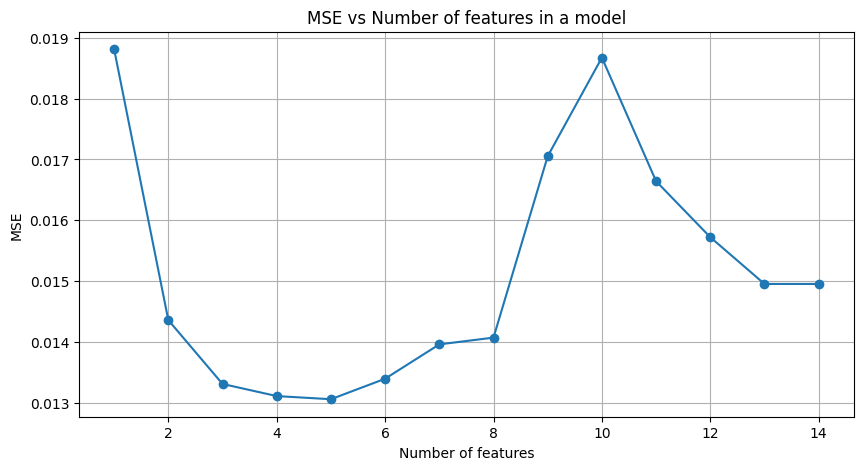

In [259]:
best_feature_subset_fs_xgboost_oceania_new, errors_fs_xgboost_oceania_new = find_best_subset_forward_stepwise_parallel(X_oceania_new_train, y_oceania_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_oceania_new)

We can see that after exceeding 5 **features**, **MSE** begins to increase. Considering the scale of the **y-axis** and the results listed above, we observe that the error difference between 4 and 5 **features** is minimal. Therefore, for further analysis, we can use a set of 4 **features**:  

**['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect']**.  

Three out of these four **features** were also present in the **XGBoost** model based on the four original **features**. **Generosity** is missing from this selection but has been replaced by its interaction with **Social support**.  

Below, we will evaluate how the **XGBoost** model performs with a limited number of **features**.  


In [260]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_4_oceania_new_xgb = ['Generosity x Social support', 'Positive affect', 'Perceptions of corruption', 'Negative affect']

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_oceania_new_train.loc[:, best_4_oceania_new_xgb], y_oceania_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_oceania_new_train.loc[:, best_4_oceania_new_xgb], y_oceania_new_train, X_oceania_new_test.loc[:, best_4_oceania_new_xgb], y_oceania_new_test, additional_title=' XGBoost, new features, best 4 features', is_xgboost=True)

Best value of max_depth: 8
Best value of learning_rate: 0.3
Feature importances:
Column 'Generosity x Social support': 0.5318
Column 'Negative affect': 0.2607
Column 'Positive affect': 0.152
Column 'Perceptions of corruption': 0.0555


Results on train set XGBoost, new features, best 4 features
MSE: 0.0
R2: 0.99998

Results on test set XGBoost, new features, best 4 features
MSE: 0.0105
R2: 0.15562


We can see that the metric results on the test set are very poor. Although **Generosity x Social support** may have achieved the lowest **MSE** in cross-validation individually, there were better subsets of 4 **features** that the greedy algorithm could no longer select (e.g., the previously considered subset including **Generosity**). Aside from this change, the **feature** hierarchy remained the same.  

### Summary  
The small number of records and the high dependence on the training-test split made it difficult to draw far-reaching conclusions about the new **features** for **Oceania**. In most cases, they increased model complexity, leading to overfitting to the training set at the cost of generalization.  

The most important takeaway from this experiment for this part of the world was observing the very strong **positive impact of regularization** on datasets with a **high number of features** and a **small number of observations**.  


## South America  
The next continent for which we will attempt to draw conclusions about the perception of **happiness** is **South America**.  

In [261]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_south_america_x = df_south_america.loc[:, x_number_columns]
y_south_america = df_south_america.loc[:, y_column]

scaler = MinMaxScaler()
df_south_america_x = pd.DataFrame(scaler.fit_transform(df_south_america_x), columns=df_south_america_x.columns, index=df_south_america_x.index)

X_south_america_train, X_south_america_test, y_south_america_train, y_south_america_test = train_test_split(df_south_america_x, y_south_america, test_size=0.2, random_state=3)

model = LinearRegression()
train_and_evaluate_model(model, X_south_america_train.loc[:, :], y_south_america_train, X_south_america_test.loc[:, :], y_south_america_test, additional_title=' for South America')

Feature weights:
Column 'Log GDP per capita': 2.3725
Column 'Healthy life expectancy at birth': -1.1081
Column 'Negative affect': -0.3337
Column 'Positive affect': 0.2559
Column 'Freedom to make life choices': 0.1974
Column 'Perceptions of corruption': -0.1415
Column 'Generosity': -0.1246
Column 'Social support': -0.0857
Column 'year': 0.0137


Results on train set for South America
MSE: 0.12244
R2: 0.54272

Results on test set for South America
MSE: 0.15338
R2: 0.3148



The **multiple regression** model did not perform well on this task, achieving an **$R^{2}$** of **0.31**, which is a very poor result.  

### Features influencing this model:  
* The most **influential feature** is **Log GDP per capita**, which is not surprising given the trends in other parts of the world. Its coefficient is relatively high compared to previous cases.  
* The second most **influential feature** is **Healthy life expectancy at birth**. Interestingly, its effect on the target variable is **negative**, suggesting that the longer the healthy lifespan, the lower the happiness level. However, since this model does not perform well, we will test other models before drawing such conclusions.  
* The remaining **features** have significantly lower coefficients. **Generosity** and **Social support** are negative, which may also be surprising.  

We will now check whether **regularization** can improve these results.  


Best value of alpha: 0.05455594781168514


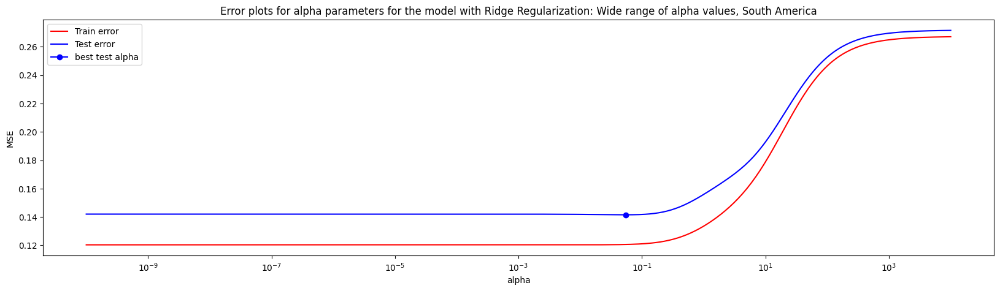

In [262]:
alpha_values = np.logspace(-10, 4, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_south_america_train.loc[:, :], y_south_america_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, South America')

In [263]:
alpha_values = np.logspace(-2, -1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_south_america_train.loc[:, :], y_south_america_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_south_america_train, y_south_america_train, X_south_america_test, y_south_america_test, additional_title=' South America with Ridge Regularization:')

Best value of alpha: 0.05366976945540476
Feature weights:
Column 'Log GDP per capita': 2.2505
Column 'Healthy life expectancy at birth': -1.0067
Column 'Negative affect': -0.3645
Column 'Positive affect': 0.2242
Column 'Freedom to make life choices': 0.2239
Column 'Perceptions of corruption': -0.1437
Column 'Generosity': -0.1201
Column 'Social support': -0.0564
Column 'year': 0.0005


Results on train set South America with Ridge Regularization:
MSE: 0.12258
R2: 0.54219

Results on test set South America with Ridge Regularization:
MSE: 0.14831
R2: 0.33746


Using **regularization**, we were able to improve the result on the test set by 0.02, but it is still not satisfactory. The coefficient values decreased slightly, but the **features** did not change their order. We will now compare these results with **L1 regularization**.  

Best value of alpha: 0.0011686088553466496


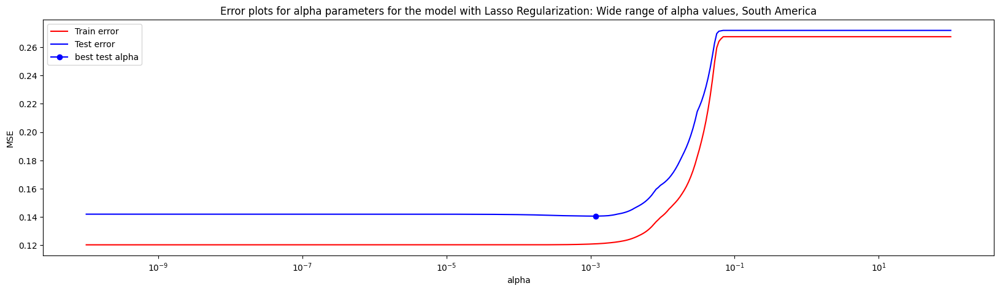

In [264]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_south_america_train.loc[:, :], y_south_america_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, South America')

In [265]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_south_america_train.loc[:, :], y_south_america_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_south_america_train.loc[:, :], y_south_america_train, X_south_america_test.loc[:, :], y_south_america_test, additional_title=' South America with Lasso Regularization:')

Best value of alpha: 0.0011483124145435111
Feature weights:
Column 'Log GDP per capita': 2.2034
Column 'Healthy life expectancy at birth': -0.9327
Column 'Negative affect': -0.3247
Column 'Freedom to make life choices': 0.1966
Column 'Positive affect': 0.1919
Column 'Perceptions of corruption': -0.1273
Column 'Generosity': -0.0833
Column 'year': -0.0
Column 'Social support': -0.0


Results on train set South America with Lasso Regularization:
MSE: 0.12298
R2: 0.54069

Results on test set South America with Lasso Regularization:
MSE: 0.14629
R2: 0.34648



**L1 regularization** improved the result on the test set by an additional 0.01. We can observe that it **eliminated** two **features**: **year** and **Social support**, which may not significantly influence happiness in **South America**. The remaining coefficients decreased a bit more. **Freedom to make life choices** gained minimal importance at the expense of **Positive affect**.  

We will now compare these results with the **random forest regressor**.  


In [266]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_south_america_train, y_south_america_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_south_america_train, y_south_america_train, X_south_america_test, y_south_america_test, additional_title=' Random Forest, South America', is_forest_reg=True)

d:\1. Studia\5. Semestr\Metody Eksploracji Danych\lab\mexLab\Lib\site-packages\numpy\ma\core.py:2881: RuntimeWarning:

invalid value encountered in cast



Best value of max_depth: 14
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.4414
Column 'Healthy life expectancy at birth': 0.0887
Column 'year': 0.0873
Column 'Social support': 0.0837
Column 'Positive affect': 0.0722
Column 'Freedom to make life choices': 0.0698
Column 'Perceptions of corruption': 0.0666
Column 'Negative affect': 0.0551
Column 'Generosity': 0.0353

Mean depth of trees: 12.85


Results on train set Random Forest, South America
MSE: 0.01353
R2: 0.94949

Results on test set Random Forest, South America
MSE: 0.10475
R2: 0.53203


**Bagging** was able to improve the results on the test set by about 0.2. Despite good fitting to the training set, the generalization ability is not at its best.  

* The most **important feature** in **South America** is, as in most cases, **Log GDP per capita** with 44% importance.  
* We can see that several **features** achieved similar levels of importance. Six **features** have an importance ranging from 6.5% to 9%. This may suggest that the happiness problem in **South America** is a complex one, and it will be difficult to define a model that performs well with a smaller number of **features** (especially considering that the full model does not perform very well).  
* According to the returned results, the second most **important feature** is **Healthy life expectancy at birth**. However, remember that in the **multiple regression** model, it had a negative coefficient.  
* The **year** variable ranked very high in the **feature** hierarchy, in 3rd place with almost 9% importance.  
* The **feature** with the least influence on the target variable is **Generosity**.  

We will now check whether **boosting** can return better results.  


In [267]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_south_america_train, y_south_america_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_south_america_train, y_south_america_train, X_south_america_test, y_south_america_test, additional_title=' XGBoost, South America', is_xgboost=True)

Best value of max_depth: 5
Best value of learning_rate: 0.3
Feature importances:
Column 'Log GDP per capita': 0.4757
Column 'Healthy life expectancy at birth': 0.1506
Column 'Freedom to make life choices': 0.0992
Column 'year': 0.0592
Column 'Perceptions of corruption': 0.0546
Column 'Positive affect': 0.0514
Column 'Negative affect': 0.0475
Column 'Social support': 0.034
Column 'Generosity': 0.0279


Results on train set XGBoost, South America
MSE: 0.0
R2: 1.0

Results on test set XGBoost, South America
MSE: 0.13205
R2: 0.41009


Unfortunately, the **boosting algorithm**, despite perfectly replicating the training set, was not able to significantly improve its generalization ability. Although the results are better than those of the **multiple regression** model, they are about 0.12 worse than the **bagging model** in terms of the **$R^{2}$** metric.  

### Key points:  
* As with previous models, the most **important feature** is **Log GDP per capita**.  
* Similarly to **bagging**, **Healthy life expectancy at birth** is the second most **important feature** in the model.  
* The third most **important feature** is **Freedom to make life choices**.  
* The remaining **features** have lower levels of importance. However, it turns out that **year** has greater importance than the other 5 **features**.  

We will now check the results from **feature selection algorithms**. We will start by eliminating **features** using **Lasso regularization**.  


In [268]:
lasso_feature_selection(X_south_america_train, y_south_america_train)

Alpha: 0.0003 - Excluded: year
Alpha: 0.0008 - Excluded: Social support
Alpha: 0.0041 - Excluded: Generosity
Alpha: 0.0049 - Excluded: Positive affect
Alpha: 0.0098 - Excluded: Healthy life expectancy at birth
Alpha: 0.0118 - Excluded: Freedom to make life choices
Alpha: 0.0225 - Excluded: Perceptions of corruption
Alpha: 0.0297 - Excluded: Negative affect
Alpha: 0.0542 - Excluded: Log GDP per capita

All features have been excluded.


Based on the **multiple regression model** and **feature selection** using **L1 regularization**, we can see that the first **excluded feature** is **year**, and the second is **Social support**. This aligns with previous results from the **multiple regression model**, where these two **features** were excluded. The exclusion of the **year** variable contradicts the results of the **bagging** and **boosting** methods, which considered **year** to be one of the more important **features**. Additionally, the rapid exclusion of **Social support** also contradicts the **bagging model**.  

The other quickly excluded **features** are **Generosity** and **Positive affect**. According to this method, the most **important features** are **Log GDP per capita** and **Negative affect**. We can compare this with other **feature selection** methods for the **linear model**.  


In [269]:
best_subset_f_stepwise_south_america, errors_fs_south_america = find_best_subset_forward_stepwise(X_south_america_train, y_south_america_train)

Best model for 1 features with MSE:  0.1574 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1381 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.1333 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 4 features with MSE:  0.1327 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect', 'Positive affect'].
Best model for 5 features with MSE:  0.1322 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect', 'Positive affect', 'Perceptions of corruption'].
Best model for 6 features with MSE:  0.1336 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect', 'Positive affect', 'Perceptions of corruption', 'Freedom to make life choices'].
Best model for 7 features with MSE:  0.1355 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect', 'Positive affect', 'Perceptions of corr

The **feature selection** method chose 5 **features** as the optimal number for minimizing the mean squared error.

* The most **important features** according to this method are **Log GDP per capita** and **Healthy life expectancy at birth**. This also aligns with the **bagging** and **boosting** methods.  
* **Emotion levels** also appear to be important.  
* As mentioned above, the **year**, **Generosity**, and **Social support** features were quickly excluded.  

We can compare this with the **feature subset** obtained by comparing all possible solutions.  


Best model for 1 features with MSE:  0.1574 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1381 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.1333 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 4 features with MSE:  0.1318 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect'].
Best model for 5 features with MSE:  0.1322 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.1336 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.1355 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices'

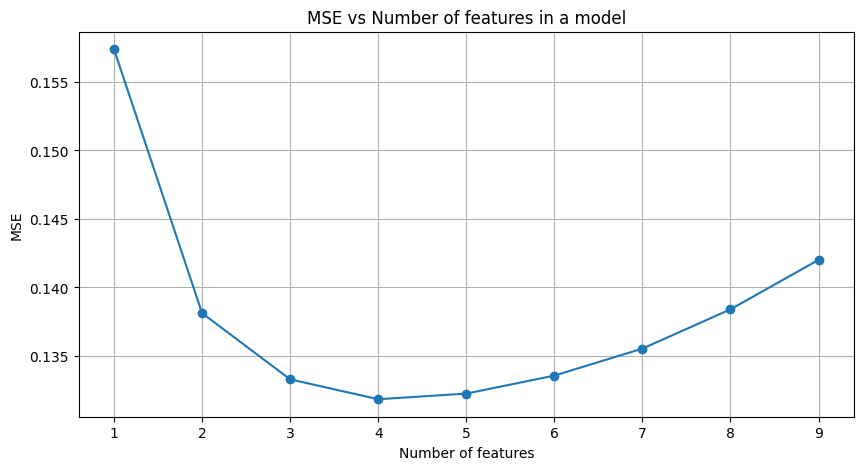

In [270]:
best_subset_par_south_america, errors_par_south_america = find_best_feature_subset_parallel(X_south_america_train, y_south_america_train)
elbow_plot(errors_par_south_america)

This algorithm came to a slightly different conclusion, selecting 4 **features** as the best subset. This happened because the **greedy algorithm** chose the **Negative affect** feature in the third step, just like the previous algorithm, but the second one changed it in the fourth step, and **forward stepwise** had to stick with this choice. According to the algorithm, the best subset is: ['**Log GDP per capita**', '**Healthy life expectancy at birth**', '**Perceptions of corruption**', '**Positive affect**']. Adding more **features** increases the **MSE**.


In [271]:
best_4_south_america = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect']

model = LinearRegression()
train_and_evaluate_model(model, X_south_america_train.loc[:, best_4_south_america], y_south_america_train, X_south_america_test.loc[:, best_4_south_america], y_south_america_test, additional_title=' for South America, best 4 features')

Feature weights:
Column 'Log GDP per capita': 2.5353
Column 'Healthy life expectancy at birth': -1.1794
Column 'Positive affect': 0.3931
Column 'Perceptions of corruption': -0.2148


Results on train set for South America, best 4 features
MSE: 0.12465
R2: 0.53447

Results on test set for South America, best 4 features
MSE: 0.16153
R2: 0.27838


Despite showing better results on the test set during cross-validation, the algorithm performed worse with the limited number of **features**. This is likely related to the initial dataset split and/or the fact that the happiness problem in **South America** might be more complex, and describing it using just a few **features** may not be sufficient.  

* **Log GDP per capita** was once again identified as the most **important feature**.  
* **Healthy life expectancy at birth** is the second most **important feature**, and interestingly, its influence on the target variable is still negative.  
* **Less important features** are **Positive affect** and **Perceptions of corruption**.  

We will check how **regularization methods** affect the model.  


Best value of alpha: 0.06052779976193355


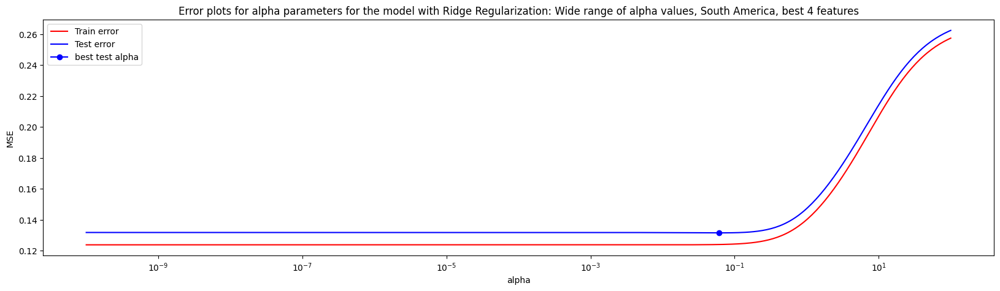

In [272]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_south_america_train.loc[:, best_4_south_america], y_south_america_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, South America, best 4 features')

In [273]:
alpha_values = np.logspace(-2, -1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_south_america_train.loc[:, best_4_south_america], y_south_america_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_south_america_train.loc[:, best_4_south_america], y_south_america_train, X_south_america_test.loc[:, best_4_south_america], y_south_america_test, additional_title=' South America with Ridge Regularization, 4 best features:')

Best value of alpha: 0.059261518124755524
Feature weights:
Column 'Log GDP per capita': 2.4505
Column 'Healthy life expectancy at birth': -1.1087
Column 'Positive affect': 0.3899
Column 'Perceptions of corruption': -0.2364


Results on train set South America with Ridge Regularization, 4 best features:
MSE: 0.12477
R2: 0.53402

Results on test set South America with Ridge Regularization, 4 best features:
MSE: 0.15904
R2: 0.28951


The result increased by 0.01, but **regularization** was not able to significantly improve the metric value. The **feature hierarchy** remained unchanged. Let's check how **L1 regularization** performs.


Best value of alpha: 0.0006715334791115135


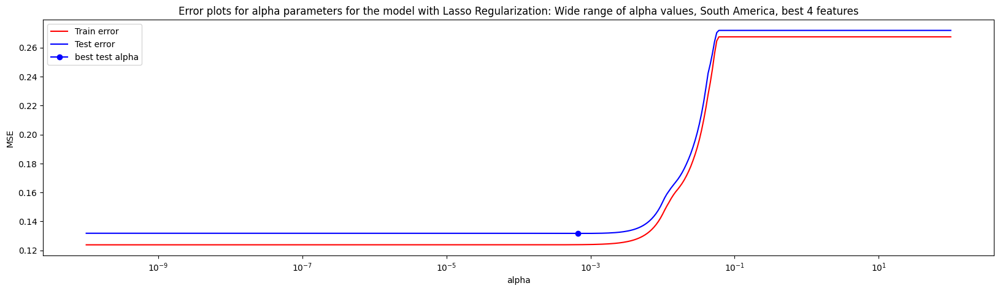

In [274]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_south_america_train.loc[:, best_4_south_america], y_south_america_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, South America, best 4 features')

In [275]:
alpha_values = np.logspace(-4, -3, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_south_america_train.loc[:, best_4_south_america], y_south_america_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_south_america_train.loc[:, best_4_south_america], y_south_america_train, X_south_america_test.loc[:, best_4_south_america], y_south_america_test, additional_title=' South America with Lasso Regularization for 4 best features:')

Best value of alpha: 0.0006836516004510238
Feature weights:
Column 'Log GDP per capita': 2.4784
Column 'Healthy life expectancy at birth': -1.1133
Column 'Positive affect': 0.3744
Column 'Perceptions of corruption': -0.2142


Results on train set South America with Lasso Regularization for 4 best features:
MSE: 0.12475
R2: 0.53411

Results on test set South America with Lasso Regularization for 4 best features:
MSE: 0.15985
R2: 0.28587


Similar to **L2 regularization**, **L1 regularization** did not change the **feature hierarchy** and only slightly improved the **$R^{2}$ metric**. It achieved a slightly worse result than **L2**. Next, we will compare **feature selection** to the **Random Forest model**.

Best model for 1 features with MSE:  0.2325 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1195 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE:  0.1023 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Negative affect'].
Best model for 4 features with MSE:  0.0986 is: ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Positive affect'].
Best model for 5 features with MSE:  0.0949 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Positive affect'].
Best model for 6 features with MSE:  0.0943 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect'].
Best model for 7 features with MSE:  0.0955 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Positive affect', 'Negative affect'].
Best model for

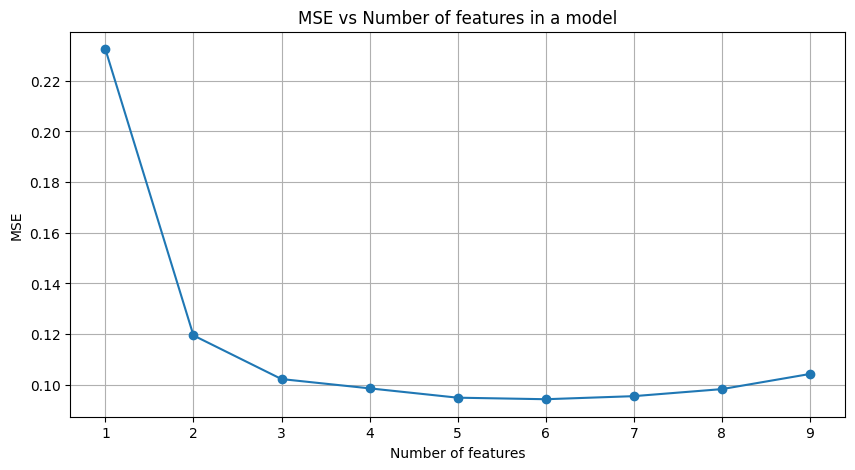

In [276]:
best_subset_par_south_america_forest, errors_par_south_america_forest = find_best_feature_subset_parallel(X_south_america_train, y_south_america_train, is_forest_reg=True)
elbow_plot(errors_par_south_america_forest)

After applying **bagging**, the best **feature subset** consists of 6 **features**. Beyond this number, there is an increase in **MSE**, although it is not significant. However, we can see that the error does not change much between 3 and 4, or between 4 and 5 **features**. Interestingly, in the subset of 4 **features**, the variable **year** is present, but we do not see **Healthy life expectancy at birth**, which had a significant impact on the other models, including **multiple regression**, where it had a negative effect. This is an interesting change compared to the other models, and we will test it.  

Theoretically, the two most **important features** were **Log GDP per capita** and **Healthy life expectancy at birth**, and these were selected first. However, we can see that the second one was omitted in the subset of 4 **features**.


In [277]:
best_4_south_america_forest = ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Positive affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_south_america_train.loc[:, best_4_south_america_forest], y_south_america_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_south_america_train.loc[:, best_4_south_america_forest], y_south_america_train, X_south_america_test.loc[:, best_4_south_america_forest], y_south_america_test, additional_title=' Random Forest, South America, Best 4 features', is_forest_reg=True)

Best value of max_depth: 12
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.5047
Column 'year': 0.2219
Column 'Positive affect': 0.1487
Column 'Freedom to make life choices': 0.1247

Mean depth of trees: 11.86


Results on train set Random Forest, South America, Best 4 features
MSE: 0.01283
R2: 0.95208

Results on test set Random Forest, South America, Best 4 features
MSE: 0.11153
R2: 0.50174


After removing 5 **features**, the **$R^{2}$ metric** dropped by 0.03 on the test set.  
* The most important feature remains **Log GDP per capita** with 50% **importance**.
* Each of the remaining **features** also has a significant influence, with the highest being the **year** variable, which has 22% **importance**. It is possible that in the absence of stronger dependencies in other **features**, the algorithm favors this one.
* **Positive affect** and **Freedom to make life choices** have similar impacts, 12% and 14%, respectively.  

We will compare these results with **boosting**.


Best model for 1 features with MSE:  0.2583 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1262 is: ['year', 'Log GDP per capita'].
Best model for 3 features with MSE:  0.0947 is: ['year', 'Log GDP per capita', 'Positive affect'].
Best model for 4 features with MSE:  0.0899 is: ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Positive affect'].
Best model for 5 features with MSE:  0.0895 is: ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Generosity', 'Positive affect'].
Best model for 6 features with MSE:  0.0927 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect'].
Best model for 7 features with MSE:  0.0918 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect'].
Best model for 8 features with MSE:  0.0943 is: ['year', 'Log GDP per capita', 'Social support'

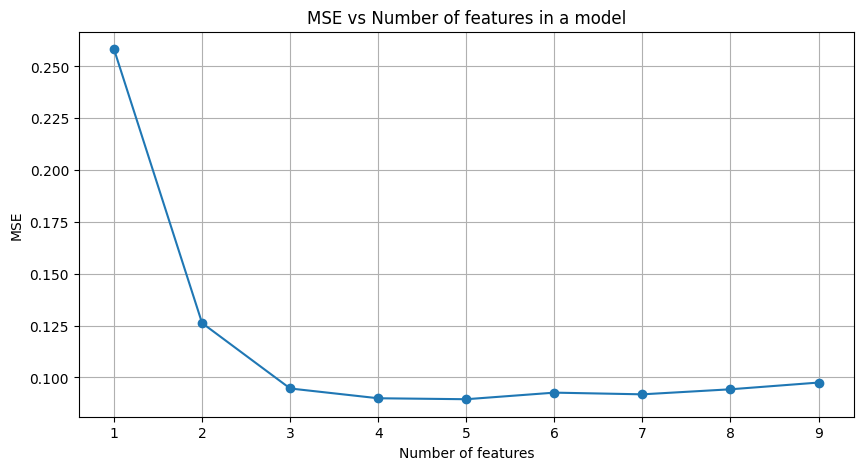

In [278]:
best_subset_par_south_america_xgb, errors_par_south_america_xgb = find_best_feature_subset_parallel(X_south_america_train, y_south_america_train, is_xgboost=True)
elbow_plot(errors_par_south_america_xgb)

For the **XGBoost** algorithm, the best selected subset is a set of 5 **features**: ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Generosity', 'Positive affect']. Once again, the **MSE** does not change significantly when reduced to 5 **features**. The error also does not decrease significantly between 3 and 4 **features**. However, we will take the subset of 4 **features** for further analysis due to the possibility of comparing it with the others.  
* According to the **feature selection**, once again, the most important **feature** is **Log GDP per capita**.  
* Once again, we can see the **year** variable high in this hierarchy.  
* Even though **Freedom to make life choices** was added as the fourth **feature** to the model, it was also eliminated when we considered the model consisting of 8 **features**.

The selected subset is the same as the subset for **RandomForest**.


In [279]:
best_4_south_america_xgb = ['year', 'Log GDP per capita', 'Freedom to make life choices', 'Positive affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_south_america_train.loc[:, best_4_south_america_xgb], y_south_america_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_south_america_train.loc[:, best_4_south_america_xgb], y_south_america_train, X_south_america_test.loc[:, best_4_south_america_xgb], y_south_america_test, additional_title=' XGBoost, South America best 4 features', is_xgboost=True)

Best value of max_depth: 9
Best value of learning_rate: 0.3
Feature importances:
Column 'Log GDP per capita': 0.515
Column 'year': 0.2244
Column 'Positive affect': 0.1384
Column 'Freedom to make life choices': 0.1222


Results on train set XGBoost, South America best 4 features
MSE: 0.0
R2: 1.0

Results on test set XGBoost, South America best 4 features
MSE: 0.17228
R2: 0.23036


Removing 5 **features** had a very negative impact on the model, making it perform even worse than the multiple regression model with a limited number of **features**. The **feature** hierarchy also remained unchanged compared to the **Random Forest** model.

In conclusion, the analysis of this dataset reveals that the happiness problem in South America is as complex as the happiness problem in Africa. It appears that happiness in South America is difficult to describe using the features presented in the dataset. Combined with the lower amount of data compared to, for example, Europe, the models created did not perform well for this task. It might be valuable to obtain information about other features that may influence happiness in this part of the world. For example, indicators such as the Gini Index, political stability, or the crime rate in a given country could play a role. From the analysis above, we can hypothesize that:
* Similar to the rest of the world, the key factor influencing happiness is **Log GDP per capita**. When this value is higher, people generally have better living conditions and their lives improve overall.
* Based on the "best" performing model, it can be suggested that **Healthy life expectancy at birth** is an important **feature** in this part of the world. Additionally, from the linear model, we know that this **feature** has a negative effect on happiness. This seems quite controversial, so to make such a statement with high confidence, a model that can better replicate these data would be necessary. For comparison, it's worth recalling that the correlation of this **feature** with the outcome was close to zero.
* The best performing models suggested that the **year** variable was an important **feature**. This may suggest that happiness levels have been gradually increasing over the years in South America, possibly due to the global development trend.
* Many models also suggested the importance of **Positive affect** and **Freedom to make life choices**. However, we cannot state this with certainty due to the accuracy of these models.
* Most models agree that **Generosity** and **Perceptions of corruption** are of low importance in this part of the world. It seems that people in this region may be facing more pressing issues than a corrupt government.
* Most models also suggest a low impact of **Negative affect**. People in this part of the world likely place more value on having a high level of positive emotions.

### South America - Feature Engineering
Below, we will repeat the feature engineering experiment for South America. The same **features** will be added as those considered for previous continents.


In [280]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_south_america_new = df_south_america.loc[:, x_number_columns]
y_south_america_new = df_south_america.loc[:, y_column]

mean_gdp_per_year_south_america = df_south_america_new.groupby('year')["Log GDP per capita"].transform('mean')
df_south_america_new["GDP / mean GDP for year"] = df_south_america_new["Log GDP per capita"] / mean_gdp_per_year_south_america


df_south_america_new['Freedom x (1-Corruption)'] = df_south_america_new['Freedom to make life choices'] * (1 - df_south_america_new['Perceptions of corruption'])
df_south_america_new['Positive / Negative'] = df_south_america_new['Positive affect'] / df_south_america_new['Negative affect']
df_south_america_new['Healthy square'] = np.pow(df_south_america_new['Healthy life expectancy at birth'], 2)

df_south_america_new['Generosity_shifted'] = df_south_america_new['Generosity'] - df_south_america_new['Generosity'].min()
df_south_america_new['Generosity x Social support'] = df_south_america_new['Generosity_shifted'] * df_south_america_new['Social support']
df_south_america_new = df_south_america_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_south_america_new = pd.DataFrame(scaler.fit_transform(df_south_america_new), columns=df_south_america_new.columns, index=df_south_america_new.index)

df_south_america_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
46,0.055556,0.912242,0.901186,0.667131,0.593310,0.154089,0.828331,0.426446,0.564370,0.959226,0.154027,0.153222,0.641990,0.173007
47,0.111111,0.942013,0.538680,0.675488,0.420594,0.187792,0.892038,0.433373,0.424454,0.983003,0.079864,0.234371,0.650671,0.193714
48,0.166667,0.953677,0.681239,0.683844,0.475292,0.207391,0.857066,0.299451,0.535923,0.950965,0.113168,0.149800,0.659367,0.221373
49,0.222222,0.925873,0.807207,0.692201,0.385724,0.211274,0.900060,0.486189,0.304765,0.931967,0.069641,0.339325,0.668079,0.232215
50,0.277778,0.962564,0.845737,0.700557,0.587395,0.219062,0.834637,0.503657,0.231069,0.939980,0.147991,0.421624,0.676808,0.242899
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2284,0.388889,0.883169,0.868703,0.625348,0.746494,0.071384,0.592247,0.854257,0.132525,0.820333,0.387950,0.651774,0.598824,0.079564
2285,0.444444,0.859506,0.700761,0.622563,0.397182,0.010053,0.796759,0.713163,0.306776,0.795944,0.144013,0.379766,0.595960,0.010780
2286,0.500000,0.689052,0.737149,0.619777,0.242063,0.093234,0.773320,0.643922,0.323816,0.636878,0.130657,0.350425,0.593098,0.100831
2287,0.555556,0.363328,0.771048,0.616992,0.117536,0.309643,0.744060,0.825066,0.264212,0.337741,0.123130,0.447802,0.590238,0.337516


Below, we will analyze the correlation of the new **features** in the dataset.

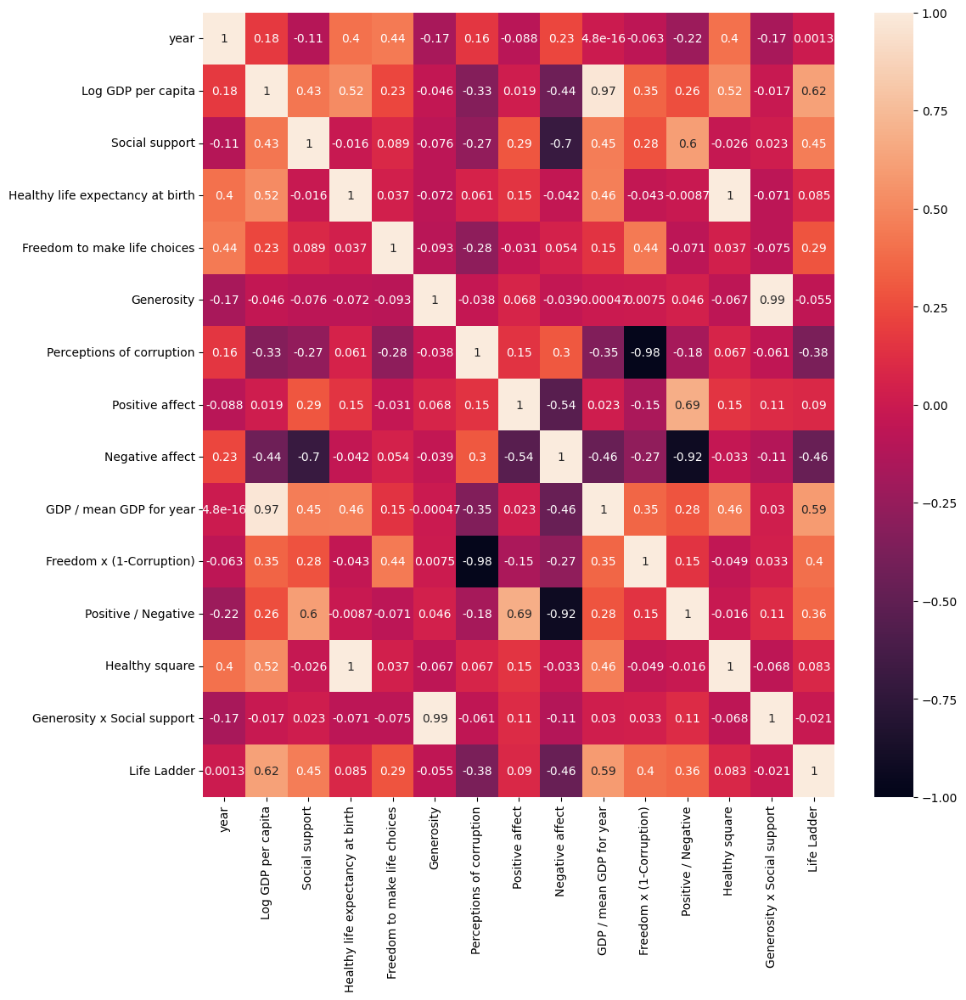

In [281]:
plt.figure(figsize=(12,12))
df_south_america_new_with_y = pd.concat([df_south_america_new, y_south_america_new], axis=1)
sns.heatmap(df_south_america_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* **GDP / mean GDP for year** has the highest correlation with the outcome among the newly added **features**, but still lower than the original variable.
* The **features** **Healthy square** and **Generosity x Social support** have practically zero correlation with **Life Ladder**.
* The **feature** **Positive / Negative** has a relatively strong correlation with **Social support**: 0.6.
* The **feature** **Generosity x Social support** has correlations close to zero with each **feature** except **Generosity**, including **Social support**.
* Apart from this, the general conclusions regarding the correlation of these **features** are similar.

We will now check how the multiple regression model performs.


In [282]:
X_south_america_new_train, X_south_america_new_test, y_south_america_new_train, y_south_america_new_test = train_test_split(df_south_america_new, y_south_america_new, test_size=0.2, random_state=3)

In [283]:
model = LinearRegression()
train_and_evaluate_model(model, X_south_america_new_train.loc[:, :], y_south_america_new_train, X_south_america_new_test.loc[:, :], y_south_america_new_test, additional_title=', South America new features')

Feature weights:
Column 'Healthy life expectancy at birth': -30.8595
Column 'Healthy square': 28.9053
Column 'Generosity': 6.3125
Column 'Generosity x Social support': -6.2204
Column 'Log GDP per capita': 5.542
Column 'GDP / mean GDP for year': -3.5664
Column 'Perceptions of corruption': -1.5843
Column 'Freedom x (1-Corruption)': -1.5568
Column 'Social support': 0.6722
Column 'Freedom to make life choices': 0.592
Column 'Positive / Negative': 0.4729
Column 'year': -0.3478
Column 'Negative affect': -0.1389
Column 'Positive affect': 0.0776


Results on train set, South America new features
MSE: 0.10423
R2: 0.61074

Results on test set, South America new features
MSE: 0.22008
R2: 0.0168


We can see that for the multiple regression model, adding new **features** significantly worsened the predictions, and the model performs very poorly, despite better fitting to the training set.
* The **Healthy** features obtained very high coefficients, and interestingly, the feature in the first power has a lower coefficient than in the second power.
* A similar situation occurs with **Generosity** and **Generosity x Social support**, as well as **GDP** features.
* The remaining **features** have lower weights.

Let's check if applying regularization methods can improve the results.


In [284]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_south_america_new_train.loc[:, :], y_south_america_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_south_america_new_train.loc[:, :], y_south_america_new_train, X_south_america_new_test.loc[:, :], y_south_america_new_test, additional_title=' South America, new features with Ridge Regularization:')

Best value of alpha: 0.00010642092440647246
Feature weights:
Column 'Healthy life expectancy at birth': -24.9118
Column 'Healthy square': 23.1874
Column 'Generosity': 6.2585
Column 'Generosity x Social support': -6.1573
Column 'Log GDP per capita': 5.5467
Column 'GDP / mean GDP for year': -3.5613
Column 'Perceptions of corruption': -1.6428
Column 'Freedom x (1-Corruption)': -1.6249
Column 'Social support': 0.6538
Column 'Freedom to make life choices': 0.6084
Column 'Positive / Negative': 0.4992
Column 'year': -0.3434
Column 'Positive affect': 0.0822
Column 'Negative affect': -0.0757


Results on train set South America, new features with Ridge Regularization:
MSE: 0.10444
R2: 0.60993

Results on test set South America, new features with Ridge Regularization:
MSE: 0.19525
R2: 0.12773


Despite cross-validation, the selected value for the hyperparameter **alpha** was very low, which did not cause a significant decrease in the coefficients, and the model still has poor generalization ability. Let's see what results **Lasso regularization** will bring.


In [285]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_south_america_new_train.loc[:, :], y_south_america_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_south_america_new_train.loc[:, :], y_south_america_new_train, X_south_america_new_test.loc[:, :], y_south_america_new_test, additional_title=' South America, new features with Lasso Regularization:')

Best value of alpha: 0.0005366976945540476
Feature weights:
Column 'Log GDP per capita': 4.0015
Column 'GDP / mean GDP for year': -1.7327
Column 'Healthy life expectancy at birth': -0.9582
Column 'Positive / Negative': 0.4545
Column 'Freedom to make life choices': 0.1979
Column 'year': -0.1621
Column 'Perceptions of corruption': -0.1332
Column 'Positive affect': 0.1078
Column 'Generosity x Social support': -0.0857
Column 'Social support': -0.0
Column 'Generosity': -0.0
Column 'Negative affect': 0.0
Column 'Freedom x (1-Corruption)': -0.0
Column 'Healthy square': -0.0


Results on train set South America, new features with Lasso Regularization:
MSE: 0.1158
R2: 0.56753

Results on test set South America, new features with Lasso Regularization:
MSE: 0.14943
R2: 0.33243


We can observe that the model performed better, but it is still unsatisfactory. The results are similar to the Lasso regularized model before adding new features, though they are slightly worse. We also notice that the highest absolute value is higher than before.

* Now, the most important features for the model turned out to be the **GDP** features.
* **Healthy life expectancy at birth** became the third most important feature. Interestingly, it is negative, which would suggest that an increase in life expectancy results in a decrease in happiness.
* Many features were zeroed out. Regularization zeroed out 2 features from the original set (**Generosity** and **Social support**) as well as 2 features created by us (**Healthy square** and **Freedom x (1-Corruption)**).

Below, we will find a satisfactory subset for the multiple regression.


Best model for 1 features with MSE: 0.1574 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.1381 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE: 0.1317 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative'].
Best model for 4 features with MSE: 0.1264 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'GDP / mean GDP for year'].
Best model for 5 features with MSE: 0.1231 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'GDP / mean GDP for year', 'Healthy square'].
Best model for 6 features with MSE: 0.1213 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption'].
Best model for 7 features with MSE: 0.1203 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'GDP / mean GDP for year', 

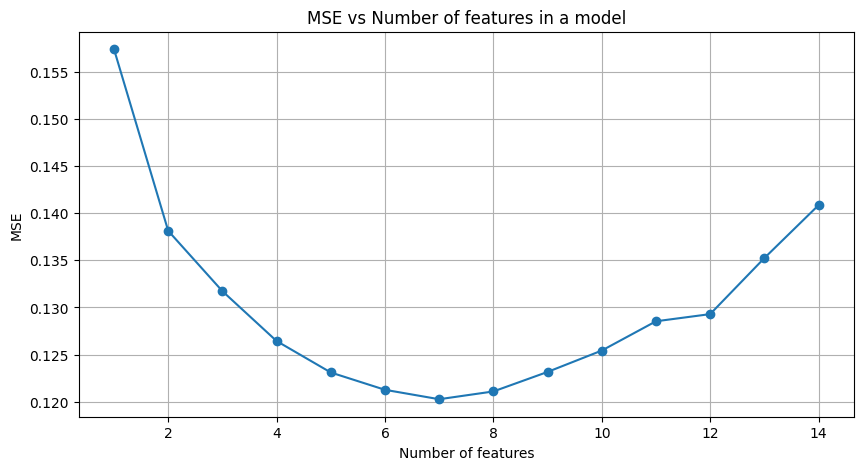

In [286]:
best_feature_subset_fs_south_america_new, errors_fs_south_america_new = find_best_subset_forward_stepwise_parallel(X_south_america_new_train, y_south_america_new_train)
elbow_plot(errors_fs_south_america_new)

In the plot, we can see a valley with a minimum at 7 features. However, if we pay attention to the scale of the plot or the errors listed above, we can see that the drop is not significant.

* 'Generosity x Social support' and 'Freedom x (1-Corruption)' were added later to the model and caused an increase in MSE.
* Due to the minimal drop in the error and the fact that previous tests were conducted with 4 features, we will proceed with a subset of 4 features for further analysis. This subset includes two features added by us: **Positive / Negative** and **GDP / mean GDP for year**. The first one replaced the **Positive affect**, and the second one replaced **Perceptions of corruption**.

Below, we will check if these features can positively impact the model.


In [287]:
best_4_south_america_new = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'GDP / mean GDP for year']
model = LinearRegression()
train_and_evaluate_model(model, X_south_america_new_train.loc[:, best_4_south_america_new], y_south_america_new_train, X_south_america_new_test.loc[:, best_4_south_america_new], y_south_america_new_test, additional_title=', South America, new features, best 4 features')

Feature weights:
Column 'Log GDP per capita': 4.5681
Column 'GDP / mean GDP for year': -2.1444
Column 'Healthy life expectancy at birth': -1.1867
Column 'Positive / Negative': 0.6031


Results on train set, South America, new features, best 4 features
MSE: 0.11873
R2: 0.55658

Results on test set, South America, new features, best 4 features
MSE: 0.16959
R2: 0.24239


The new features were unable to improve the model's generalization ability, which remains at a very low level. Better results came from the combination chosen by the algorithms when analyzing only the original features. It is likely that the **Positive / Negative** feature minimized the MSE slightly better, and in the greedy algorithm, it couldn't be modified any further.

* The feature with the highest coefficient remains **Log GDP per capita**, though it is somewhat balanced by the second variable related to this factor.
* **Healthy life expectancy at birth** remained an important feature, once again with a negative weight.
* **Positive / Negative** became the least significant feature in the model with 4 features.

We will compare these results with those from the Random Forest regressor.


In [288]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_south_america_new_train.loc[:, :], y_south_america_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_south_america_new_train.loc[:, :], y_south_america_new_train, X_south_america_new_test.loc[:, :], y_south_america_new_test, additional_title=' South America, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.3331
Column 'Log GDP per capita': 0.1435
Column 'Freedom x (1-Corruption)': 0.1238
Column 'year': 0.0645
Column 'Social support': 0.0573
Column 'Healthy life expectancy at birth': 0.0501
Column 'Positive affect': 0.0451
Column 'Healthy square': 0.0411
Column 'Positive / Negative': 0.0346
Column 'Negative affect': 0.026
Column 'Freedom to make life choices': 0.0241
Column 'Perceptions of corruption': 0.0218
Column 'Generosity x Social support': 0.019
Column 'Generosity': 0.0161

Mean depth of trees: 12.36


Results on train set South America, Random Forest, new features
MSE: 0.01169
R2: 0.95633

Results on test set South America, Random Forest, new features
MSE: 0.14966
R2: 0.3314


The added features worsened the model's generalization ability, resulting in a much lower performance on the test set.

* Once again, the most important features were those related to GDP, with **GDP / mean GDP for year** taking the lead this time.
* **Freedom x (1-Corruption)** emerged as a highly significant feature.
* **Healthy life expectancy at birth** turned out to be less significant than **year** and **Social support** this time, in contrast to previous findings.
* Features related to **Generosity** obtained the lowest importance.

Below, we will check which features are suggested by the feature selection algorithm.


Best model for 1 features with MSE: 0.2301 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.1148 is: ['GDP / mean GDP for year', 'year'].
Best model for 3 features with MSE: 0.1029 is: ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)'].
Best model for 4 features with MSE: 0.0986 is: ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita'].
Best model for 5 features with MSE: 0.0977 is: ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Positive affect'].
Best model for 6 features with MSE: 0.0944 is: ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth'].
Best model for 7 features with MSE: 0.0897 is: ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Positive / Negative'].
Best model for 8 features with MSE: 0.08

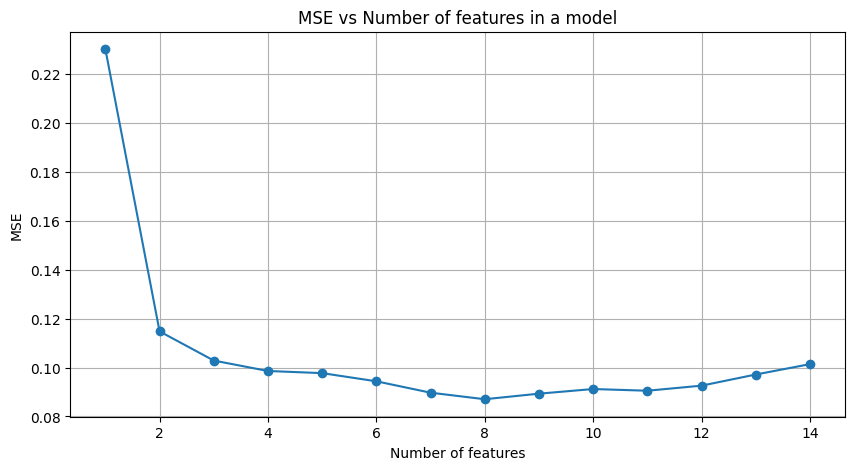

In [289]:
best_feature_subset_fs_south_america_new_forest, errors_fs_south_america_new_forest = find_best_subset_forward_stepwise_parallel(X_south_america_new_train, y_south_america_new_train, is_forest_reg=True)
elbow_plot(errors_fs_south_america_new_forest)

MSE decreased until reaching 8 features, after which it began to rise.

* We can see that the biggest gain came from adding the second feature, which was **year**. This could support the theory that in South America, happiness is partly influenced by the general trend of global development.
* The last 5 features included in the model are original features, which may suggest they were less valuable than some of the added ones.

Below, we will check the results for two subsets: the subset of 4 features, since adding the fifth did not cause a significant decrease in MSE, and the subset of 8 features, as it minimized the Mean Squared Error.
* In the subset of 4 features, the two features we added, **GDP / mean GDP for year** and **Freedom x (1-Corruption)**, were included.
* In the subset of 8 features, 2 more were added: **Positive / Negative** and **Generosity x Social support**.


In [290]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_4_forest_south_america_new = ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_south_america_new_train.loc[:, best_4_forest_south_america_new], y_south_america_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_south_america_new_train.loc[:, best_4_forest_south_america_new], y_south_america_new_train, X_south_america_new_test.loc[:, best_4_forest_south_america_new], y_south_america_new_test, additional_title=' South America, Random Forest, new features, best 4 features', is_forest_reg=True)

Best value of max_depth: 13
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.4122
Column 'year': 0.1985
Column 'Log GDP per capita': 0.198
Column 'Freedom x (1-Corruption)': 0.1913

Mean depth of trees: 12.51


Results on train set South America, Random Forest, new features, best 4 features
MSE: 0.0125
R2: 0.95332

Results on test set South America, Random Forest, new features, best 4 features
MSE: 0.14445
R2: 0.3547


Compared to the previous model, this one performs surprisingly poorly. The double inclusion of GDP and the exclusion of **Positive affect** contributed to a decrease in the $R^{2}$ metric.

* The position of **year** in the hierarchy remained unchanged, but its influence decreased, and now the last 3 features all have an influence level of 19%.
* The feature related to **Freedom** is also the least important feature in this model.
* **GDP / mean GDP for year** turned out to be more important than **Log GDP per capita**, although it is likely that they can be used interchangeably.

Below, we will check the model composed of 8 features.


In [291]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_8_forest_south_america_new = ['GDP / mean GDP for year', 'year', 'Freedom x (1-Corruption)', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Positive / Negative', 'Generosity x Social support']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_south_america_new_train.loc[:, best_8_forest_south_america_new], y_south_america_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_south_america_new_train.loc[:, best_8_forest_south_america_new], y_south_america_new_train, X_south_america_new_test.loc[:, best_8_forest_south_america_new], y_south_america_new_test, additional_title=' South America, Random Forest, new features, best 8 features', is_forest_reg=True)

Best value of max_depth: 19
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.3423
Column 'Log GDP per capita': 0.1636
Column 'Freedom x (1-Corruption)': 0.1473
Column 'Healthy life expectancy at birth': 0.0939
Column 'year': 0.0827
Column 'Positive affect': 0.0672
Column 'Positive / Negative': 0.0658
Column 'Generosity x Social support': 0.0372

Mean depth of trees: 13.65


Results on train set South America, Random Forest, new features, best 8 features
MSE: 0.01194
R2: 0.9554

Results on test set South America, Random Forest, new features, best 8 features
MSE: 0.16278
R2: 0.27281


Once again, we observe a drop in the metric. The two features added by the algorithm as the last ones are indeed the least important in the hierarchy. However, the algorithm suggests that **GDP / mean GDP for year** and **Freedom x (1-Corruption)** have a significant impact on this model. We can see, however, that despite good results on the training set, the model's generalization ability remains low. Let's see how the boosting algorithm performs.


In [292]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_south_america_new_train.loc[:, :], y_south_america_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_south_america_new_train.loc[:, :], y_south_america_new_train, X_south_america_new_test.loc[:, :], y_south_america_new_test, additional_title=' South America, XGBoost, new features', is_xgboost=True)

Best value of max_depth: 9
Best value of learning_rate: 0.2
Feature importances:
Column 'GDP / mean GDP for year': 0.3556
Column 'Freedom x (1-Corruption)': 0.3016
Column 'Generosity x Social support': 0.1098
Column 'Healthy life expectancy at birth': 0.0745
Column 'Positive affect': 0.0391
Column 'Freedom to make life choices': 0.0183
Column 'Perceptions of corruption': 0.0174
Column 'Negative affect': 0.0171
Column 'Social support': 0.0167
Column 'Log GDP per capita': 0.016
Column 'Generosity': 0.0145
Column 'Positive / Negative': 0.0102
Column 'year': 0.0092
Column 'Healthy square': 0.0


Results on train set South America, XGBoost, new features
MSE: 0.0
R2: 1.0

Results on test set South America, XGBoost, new features
MSE: 0.17418
R2: 0.22187


Once again, we can observe perfect fitting to the training set with boosting, but very low generalization ability.  
* Again, the model suggests the highest importance for **GDP / mean GDP for year** and almost equally high importance for the feature **Freedom x (1-Corruption)**.  
* Unlike before, the model also suggests high importance for **Generosity x Social support**. However, we cannot fully trust this result.  
* Once again, we can see that boosting models tend to eliminate the feature **Healthy square**.  

Below, we will try applying the feature selection algorithm.


Best model for 1 features with MSE: 0.2583 is: ['Log GDP per capita'].
Best model for 2 features with MSE: 0.1313 is: ['Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE: 0.1083 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative'].
Best model for 4 features with MSE: 0.097 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect'].
Best model for 5 features with MSE: 0.0961 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect', 'Freedom x (1-Corruption)'].
Best model for 6 features with MSE: 0.0917 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect', 'Freedom x (1-Corruption)', 'Generosity'].
Best model for 7 features with MSE: 0.0886 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect', 'Freedom x (1-Corruption)', 

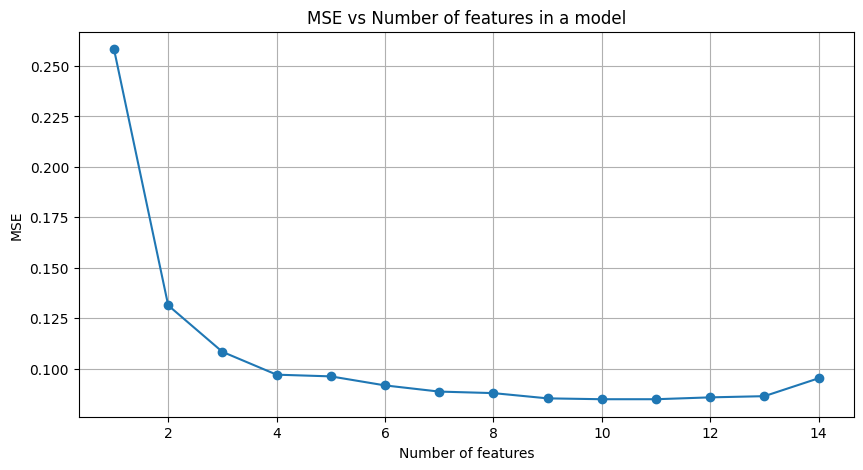

In [293]:
best_feature_subset_fs_xgboost_south_america_new, errors_fs_xgboost_south_america_new = find_best_subset_forward_stepwise_parallel(X_south_america_new_train, y_south_america_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_south_america_new)

The MSE graph similarly flattens out quickly. After reaching 4 features, we can already observe a small drop. This, along with the need for comparison, especially since we previously tested 4-feature subsets, leads us to choose the same subset this time as well: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect'].

* This subset contains one feature we added, **Positive / Negative**.
* Despite the inclusion of this feature, we also see **Positive affect** here. Perhaps their combination provides a broader view of the information.
* The subset also includes **Healthy life expectancy at birth**, which we hadn’t seen previously.
* **Freedom to make life choices** and **year** are not present in this subset, although the latter might have been an important factor in South America.
* For this model, the other added features were included as some of the last ones.


In [294]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_4_south_america_xgb = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Positive / Negative', 'Positive affect']

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_south_america_new_train.loc[:, best_4_south_america_xgb], y_south_america_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_south_america_new_train.loc[:, best_4_south_america_xgb], y_south_america_new_train, X_south_america_new_test.loc[:, best_4_south_america_xgb], y_south_america_new_test, additional_title=' South America, XGBoost, new features, best 4 features', is_xgboost=True)

Best value of max_depth: 6
Best value of learning_rate: 0.3
Feature importances:
Column 'Log GDP per capita': 0.4873
Column 'Healthy life expectancy at birth': 0.2337
Column 'Positive / Negative': 0.1951
Column 'Positive affect': 0.0839


Results on train set South America, XGBoost, new features, best 4 features
MSE: 0.0
R2: 0.99999

Results on test set South America, XGBoost, new features, best 4 features
MSE: 0.15529
R2: 0.30626


The use of this 4-feature subset was able to increase the performance on the test set by 0.07 in terms of the $R^{2}$ metric. This was achieved for trees with a maximum depth reduced by 3 levels. However, it still does not represent a satisfactory result.
* **Log GDP per capita** remained the most significant feature for this algorithm.
* **Healthy life expectancy at birth** provided similar information as the previous variable **year**.
* The impact of **Positive affect** decreased in favor of **Positive / Negative**.

In conclusion, the added features did not significantly improve prediction results in this part of the world. The improvement was typically observed for models that performed the worst, and the best **RandomForest** model, after focusing on the newly added features, worsened its performance.
* Among the newly added features, models seem to favor **GDP / mean GDP for year**. However, we could likely use it interchangeably with **Log GDP per capita** with similar effectiveness. Although **GDP / mean GDP for year** typically performs better on its own, providing better results, in combination with other features, **Log GDP per capita** contributes more information.
* The **Random Forest** algorithm also suggested the importance of the variable **Freedom x (1-Corruption)**, often selecting it. Unfortunately, the performance level of these models cannot guarantee the correctness of this theory.
* Including **Positive / Negative affect** was a component of improving generalization in the limited **XGBoost** model, but these results are also not reliable enough to fully trust.
* The remaining added features did not play a significant role in the experiment.


## North America
After analyzing South America, it's time to analyze the situation in North America. We will try to select models and features that describe this dataset effectively.


In [295]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_north_america_x = df_north_america.loc[:, x_number_columns]
y_north_america = df_north_america.loc[:, y_column]

scaler = MinMaxScaler()
df_north_america_x = pd.DataFrame(scaler.fit_transform(df_north_america_x), columns=df_north_america_x.columns, index=df_north_america_x.index)

X_north_america_train, X_north_america_test, y_north_america_train, y_north_america_test = train_test_split(df_north_america_x, y_north_america, test_size=0.2, random_state=3)

model = LinearRegression()
train_and_evaluate_model(model, X_north_america_train.loc[:, :], y_north_america_train, X_north_america_test.loc[:, :], y_north_america_test, additional_title=' for North America')

Feature weights:
Column 'Positive affect': 1.776
Column 'Log GDP per capita': 1.0771
Column 'Perceptions of corruption': -0.807
Column 'Negative affect': -0.7445
Column 'Healthy life expectancy at birth': 0.5984
Column 'Social support': 0.4583
Column 'Freedom to make life choices': 0.2383
Column 'Generosity': 0.214
Column 'year': 0.0726


Results on train set for North America
MSE: 0.21126
R2: 0.68311

Results on test set for North America
MSE: 0.21672
R2: 0.74929


North America seems to be better described than South America by the variables in this dataset. The $R^{2}$ metric on the test set is almost 0.75. Interestingly, this metric is lower on the training set, at 0.68. 
* The most important feature in North America seems to be **Positive affect**, which even surpasses **Log GDP per capita**.
* It also appears that a low value for two negative features - the level of negative emotions and perceptions of corruption - is significant for the people of North America.
* The variable **year** has the lowest impact. **Generosity** and **Freedom to make life choices** also have low influence.

Let's check if regularization can improve the metrics.


Best value of alpha: 0.9223851039358457


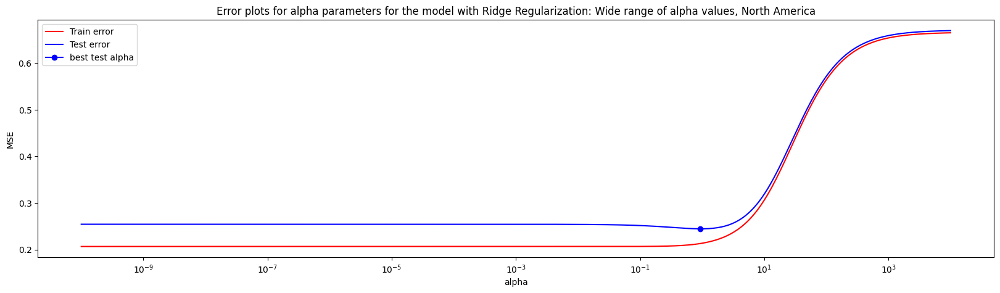

In [296]:
alpha_values = np.logspace(-10, 4, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_north_america_train.loc[:, :], y_north_america_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, North America')

In [297]:
alpha_values = np.logspace(-1, 1, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_north_america_train.loc[:, :], y_north_america_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_north_america_train, y_north_america_train, X_north_america_test, y_north_america_test, additional_title=' North America with Ridge Regularization:')

Best value of alpha: 0.9527500472427293
Feature weights:
Column 'Positive affect': 1.3506
Column 'Log GDP per capita': 1.027
Column 'Perceptions of corruption': -0.663
Column 'Negative affect': -0.6369
Column 'Healthy life expectancy at birth': 0.6321
Column 'Social support': 0.5114
Column 'Freedom to make life choices': 0.3692
Column 'Generosity': 0.1639
Column 'year': 0.026


Results on train set North America with Ridge Regularization:
MSE: 0.21552
R2: 0.67672

Results on test set North America with Ridge Regularization:
MSE: 0.22802
R2: 0.73621


L2 regularization did not change the hierarchy of features, but there was a significant decrease in the coefficient for **Positive affect**. Despite this, the hyperplane determined by the model generalizes worse on the test set. Let's compare this with L1 regularization.


Best value of alpha: 0.005361956770568816


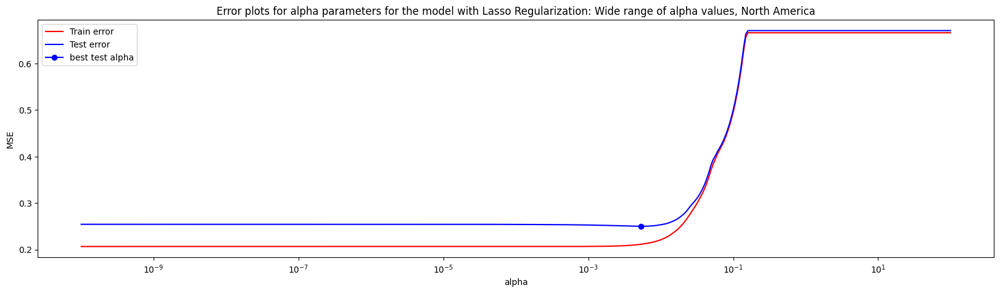

In [298]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_north_america_train.loc[:, :], y_north_america_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, North America')

In [299]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_north_america_train.loc[:, :], y_north_america_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_north_america_train.loc[:, :], y_north_america_train, X_north_america_test.loc[:, :], y_north_america_test, additional_title=' North America with Lasso Regularization:')

Best value of alpha: 0.005404216420705915
Feature weights:
Column 'Positive affect': 1.6232
Column 'Log GDP per capita': 1.241
Column 'Perceptions of corruption': -0.6948
Column 'Negative affect': -0.4637
Column 'Social support': 0.417
Column 'Healthy life expectancy at birth': 0.4004
Column 'Freedom to make life choices': 0.1583
Column 'Generosity': 0.0464
Column 'year': -0.0


Results on train set North America with Lasso Regularization:
MSE: 0.21594
R2: 0.67609

Results on test set North America with Lasso Regularization:
MSE: 0.22046
R2: 0.74496


L1 regularization also caused a slight decrease in generalization ability. However, it is even smaller than for L2. The hierarchy of features changed minimally. After applying L1 regularization, **Social support** became slightly more important than **Healthy life expectancy at birth**. Regularization excluded the **year** feature as being less important for the model. We can compare these results with random forest.


In [300]:
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_north_america_train, y_north_america_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_north_america_train, y_north_america_train, X_north_america_test, y_north_america_test, additional_title=' Random Forest, North America', is_forest_reg=True)

Best value of max_depth: 10
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.4048
Column 'Healthy life expectancy at birth': 0.2229
Column 'Social support': 0.1126
Column 'Positive affect': 0.0771
Column 'Perceptions of corruption': 0.046
Column 'Freedom to make life choices': 0.0435
Column 'Generosity': 0.0363
Column 'Negative affect': 0.0332
Column 'year': 0.0236

Mean depth of trees: 10.0


Results on train set Random Forest, North America
MSE: 0.02367
R2: 0.9645

Results on test set Random Forest, North America
MSE: 0.14038
R2: 0.83759


Random Forest was able to significantly improve the results, with an increase of 0.09 in the $R^{2}$ score on the test set. The error on the training set also decreased significantly. However, we observe a reshuffling of the feature hierarchy.
* **Positive affect** lost its status as the most influential feature and dropped to fourth place, now contributing 7% of the importance. Once again, the most informative feature is **Log GDP per capita**, with 40% importance. This suggests that happiness in North America is a more complex issue than in Europe, where the importance of this variable was around 80%.
* **Healthy life expectancy at birth** proved to be an important factor in happiness. In countries like the USA, where healthcare can be expensive, not needing to use it may have a significant impact on happiness.
* **Social support** also turns out to provide significant information.
* The **year** variable has the least impact, which was expected. However, it is surprising that the importance of **Negative affect** and **Perceptions of corruption** dropped, as they were very significant in the multiple regression model.

We will compare the bagging results with the boosting results.


In [301]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_north_america_train, y_north_america_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_north_america_train, y_north_america_train, X_north_america_test, y_north_america_test, additional_title=' XGBoost, North America', is_xgboost=True)

Best value of max_depth: 4
Best value of learning_rate: 0.1
Feature importances:
Column 'Log GDP per capita': 0.4355
Column 'Healthy life expectancy at birth': 0.2205
Column 'Social support': 0.089
Column 'Positive affect': 0.0539
Column 'Generosity': 0.053
Column 'Perceptions of corruption': 0.0465
Column 'Negative affect': 0.041
Column 'Freedom to make life choices': 0.0399
Column 'year': 0.0209


Results on train set XGBoost, North America
MSE: 0.00188
R2: 0.99718

Results on test set XGBoost, North America
MSE: 0.17365
R2: 0.7991


They are also higher than for the multiple regression model but lower than for Random Forest. The $R^{2}$ score reached almost 0.8.
* The order of the first 4 features and the last one remained unchanged. The model still values **Log GDP per capita**, **Healthy life expectancy at birth**, **Social support**, and **Positive affect** the most, while not giving much weight to **year**.
* Compared to Random Forest, the importance of **Freedom to make life choices** and **Perceptions of corruption** decreased. However, the influence of **Negative affect** and **Generosity** increased. All of these features have similar importance.

Below, we will perform feature selection on the multiple regression model.


In [302]:
lasso_feature_selection(X_north_america_train, y_north_america_train)

Alpha: 0.0021 - Excluded: year
Alpha: 0.0074 - Excluded: Generosity
Alpha: 0.0141 - Excluded: Freedom to make life choices
Alpha: 0.0163 - Excluded: Negative affect
Alpha: 0.0225 - Excluded: Healthy life expectancy at birth
Alpha: 0.0283 - Excluded: Social support
Alpha: 0.0283 - Excluded: Perceptions of corruption
Alpha: 0.0567 - Excluded: Positive affect
Alpha: 0.1499 - Excluded: Log GDP per capita

All features have been excluded.


* The multiple regression model first excluded **year**, **Generosity**, and **Freedom to make life choices**. This matches the hierarchy in the full model.
* The last excluded feature turned out to be **Log GDP per capita**, in contrast to the initially chosen **Positive affect**.
* However, **Perceptions of corruption** is still important for this model.
* **Social support** was excluded later than **Negative affect** and **Healthy life expectancy at birth**.

Let's compare this with the feature set selected by forward stepwise.


In [303]:
best_subset_f_stepwise_north_america, errors_fs_north_america = find_best_subset_forward_stepwise(X_north_america_train, y_north_america_train)

Best model for 1 features with MSE:  0.3623 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2757 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.2557 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption'].
Best model for 4 features with MSE:  0.2468 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support'].
Best model for 5 features with MSE:  0.2415 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Negative affect'].
Best model for 6 features with MSE:  0.244 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Negative affect', 'Healthy life expectancy at birth'].
Best model for 7 features with MSE:  0.2459 is: ['Log GDP per capita', 'Positive affect', 'Perceptions of corruption', 'Social support', 'Negative affect', 'Healthy life expectancy at birth', 'Generosity'].
Best model for 8 featur

The algorithm selected a subset of 5 features as the one that minimizes MSE.
* Similarly, this algorithm selected **year**, **Freedom to make life choices**, and **Generosity** as the 3 least important features.
* Just like before, **Log GDP per capita**, **Positive affect**, and **Perceptions of corruption** had the greatest impact.

Let's compare this with the best subset after searching through all possibilities.


Best model for 1 features with MSE:  0.3623 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2757 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.2557 is: ['Log GDP per capita', 'Perceptions of corruption', 'Positive affect'].
Best model for 4 features with MSE:  0.2468 is: ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect'].
Best model for 5 features with MSE:  0.2415 is: ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 6 features with MSE:  0.244 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 7 features with MSE:  0.2459 is: ['Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
Best model for 8 featur

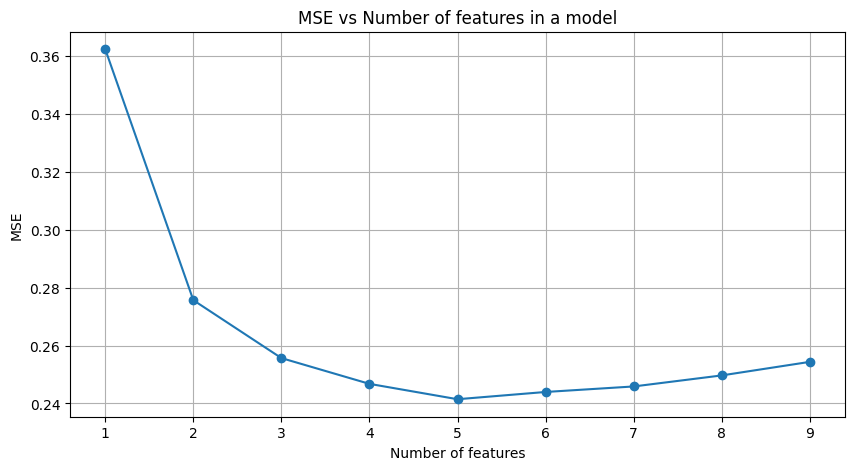

In [304]:
best_subset_par_north_america, errors_par_north_america = find_best_feature_subset_parallel(X_north_america_train, y_north_america_train)
elbow_plot(errors_par_north_america)

The algorithm reached the same conclusion as the previous one. The best subset turned out to be ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect', 'Negative affect'].
* This algorithm also confirms the minimal impact of **year**, **Generosity**, and **Freedom to make life choices**.
* Even though **Social support** was of medium importance, it made it into this subset.

For further analysis, we will select the above subset of 5 features.


In [305]:
best_5_north_america = ['Log GDP per capita', 'Social support', 'Perceptions of corruption', 'Positive affect', 'Negative affect']

model = LinearRegression()
train_and_evaluate_model(model, X_north_america_train.loc[:, best_5_north_america], y_north_america_train, X_north_america_test.loc[:, best_5_north_america], y_north_america_test, additional_title=' for North America, best 5 features')

Feature weights:
Column 'Positive affect': 1.94
Column 'Log GDP per capita': 1.2245
Column 'Perceptions of corruption': -0.9847
Column 'Social support': 0.7547
Column 'Negative affect': -0.6193


Results on train set for North America, best 5 features
MSE: 0.21578
R2: 0.67633

Results on test set for North America, best 5 features
MSE: 0.22736
R2: 0.73698


Removing 4 features did not cause a significant drop in the metric, and the reduced complexity of the model may be beneficial for certain applications.
* **Positive affect** remained the most important feature for the multiple regression model, with **Log GDP per capita** being the second most important feature.
* Other important features include a low perception of **corruption**.
* **Social support** and **Negative affect** also have some impact.

We will check how the results change after applying regularization.


Best value of alpha: 0.5948892077934331


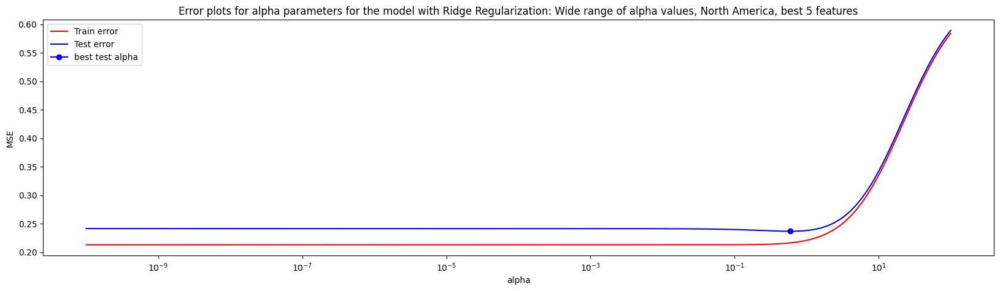

In [306]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_ridge = perform_cross_validation_regularization(X_north_america_train.loc[:, best_5_north_america], y_north_america_train, alpha_values, is_ridge=True, additional_title=': Wide range of alpha values, North America, best 5 features')

In [307]:
alpha_values = np.logspace(-1, 0, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_north_america_train.loc[:, best_5_north_america], y_north_america_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)

train_and_evaluate_model(ridge_best, X_north_america_train.loc[:, best_5_north_america], y_north_america_train, X_north_america_test.loc[:, best_5_north_america], y_north_america_test, additional_title=' North America with Ridge Regularization, 5 best features:')

Best value of alpha: 0.5871766390733255
Feature weights:
Column 'Positive affect': 1.6749
Column 'Log GDP per capita': 1.2067
Column 'Perceptions of corruption': -0.8725
Column 'Social support': 0.7901
Column 'Negative affect': -0.5722


Results on train set North America with Ridge Regularization, 5 best features:
MSE: 0.21788
R2: 0.67318

Results on test set North America with Ridge Regularization, 5 best features:
MSE: 0.23027
R2: 0.73361


L2 regularization still did not improve the result, but it did not significantly worsen it either. The hierarchy of features also remained the same. Let's compare these results with L1 regularization.


Best value of alpha: 0.002335721469090121


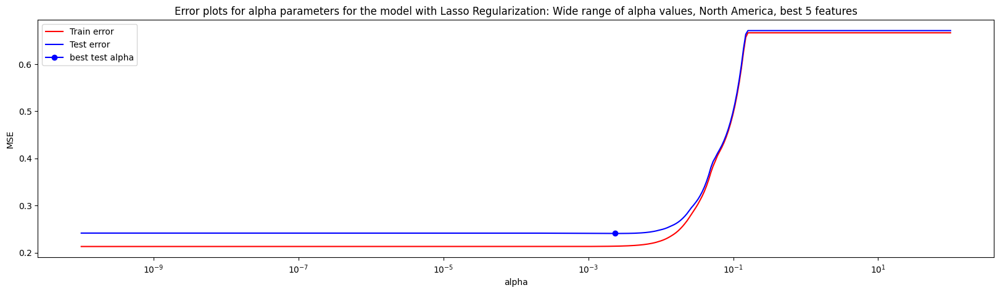

In [308]:
alpha_values = np.logspace(-10, 2, 400)
best_alpha_lasso = perform_cross_validation_regularization(X_north_america_train.loc[:, best_5_north_america], y_north_america_train, alpha_values, is_ridge=False, additional_title=': Wide range of alpha values, North America, best 5 features')

In [309]:
alpha_values = np.logspace(-3, -2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_north_america_train.loc[:, best_5_north_america], y_north_america_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_north_america_train.loc[:, best_5_north_america], y_north_america_train, X_north_america_test.loc[:, best_5_north_america], y_north_america_test, additional_title=' North America with Lasso Regularization for 5 best features:')

Best value of alpha: 0.0024009348768606518
Feature weights:
Column 'Positive affect': 1.8625
Column 'Log GDP per capita': 1.2665
Column 'Perceptions of corruption': -0.891
Column 'Social support': 0.6966
Column 'Negative affect': -0.5241


Results on train set North America with Lasso Regularization for 5 best features:
MSE: 0.21646
R2: 0.67531

Results on test set North America with Lasso Regularization for 5 best features:
MSE: 0.22439
R2: 0.74041


L1 regularization was able to improve the test set result compared to the model without regularization. The hierarchy of features also remained unchanged. Below, we will see how limiting the number of features affected the random forest model.


Best model for 1 features with MSE:  0.3447 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.1603 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.1506 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.1507 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Negative affect'].
Best model for 5 features with MSE:  0.1449 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect'].
Best model for 6 features with MSE:  0.1436 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect'].
Best model for 7 features with MSE:  0.1443 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life ch

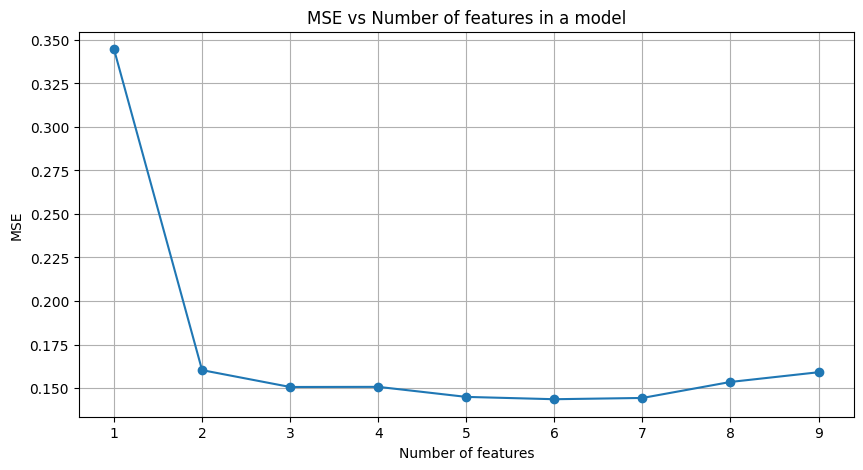

In [310]:
best_subset_par_north_america_forest, errors_par_north_america_forest = find_best_feature_subset_parallel(X_north_america_train, y_north_america_train, is_forest_reg=True)
elbow_plot(errors_par_north_america_forest)

The number of features minimizing MSE according to forward stepwise is 6, and interestingly, this set also includes the variable year, which usually had no effect on the models.  
The error on the 5-feature subset is similar to that on the 6-feature subset, but it is lower than the error on the 4-feature subset. Interestingly, the value of this error is still slightly higher than on the 3-feature subset.
* The most important feature is **Log GDP per capita**.
* The last included feature was **Generosity**.

For further analysis, we will choose the 5-feature subset. It is the most similar to the 5 most important features in the full model. The only difference is the presence of **Freedom to make life choices** instead of **Social support**.


In [311]:
best_5_north_america_forest = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Positive affect']
depths = list(range(5,26))
depths.append(None)
min_samples_leaf = list(range(1, 10))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_north_america_train.loc[:, best_5_north_america_forest], y_north_america_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_north_america_train.loc[:, best_5_north_america_forest], y_north_america_train, X_north_america_test.loc[:, best_5_north_america_forest], y_north_america_test, additional_title=' Random Forest, North America, Best 5 features', is_forest_reg=True)

Best value of max_depth: 16
Best value of min_samples_leaf: 1
Feature importances:
Column 'Log GDP per capita': 0.4599
Column 'Healthy life expectancy at birth': 0.2957
Column 'Positive affect': 0.099
Column 'Freedom to make life choices': 0.0755
Column 'Perceptions of corruption': 0.0699

Mean depth of trees: 13.67


Results on train set Random Forest, North America, Best 5 features
MSE: 0.02138
R2: 0.96792

Results on test set Random Forest, North America, Best 5 features
MSE: 0.12609
R2: 0.85413


As it turns out, when considering North America, reducing the complexity of the RandomForest model increases its generalization ability compared to the model based on the full feature set. $R^{2}$ on the test set increased by 0.02.
* The two most important features remained **Log GDP per capita** (46%) and **Healthy life expectancy at birth** (29%). In few models have we can seen two features with such a large impact.
* **Positive affect** gained an importance of 9%. The level of positive emotions is also influential in North America.
* **Freedom to make life choices** and **Perceptions of corruption** are at a similar level of importance. Nevertheless, they are still important features describing happiness in North America.

Let’s see what effects applying XGBoost will bring.


Best model for 1 features with MSE:  0.3963 is: ['Log GDP per capita'].
Best model for 2 features with MSE:  0.2133 is: ['Log GDP per capita', 'Positive affect'].
Best model for 3 features with MSE:  0.1691 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices'].
Best model for 4 features with MSE:  0.1653 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption'].
Best model for 5 features with MSE:  0.1668 is: ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect'].
Best model for 6 features with MSE:  0.1554 is: ['year', 'Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect'].
Best model for 7 features with MSE:  0.1627 is: ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Perception

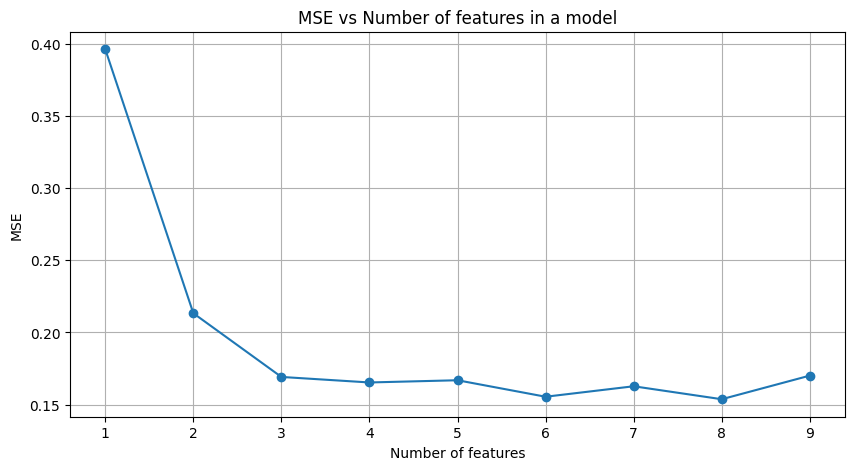

In [312]:
best_subset_par_north_america_xgb, errors_par_north_america_xgb = find_best_feature_subset_parallel(X_north_america_train, y_north_america_train, is_xgboost=True)
elbow_plot(errors_par_north_america_xgb)

The feature set minimizing MSE for boosting consists of 8 features, and the MSE value in this case does not differ significantly from the error for 6 features.
* Once again, the least important feature turned out to be **Generosity**.
* The boosting algorithm assigns more importance to **Negative affect** than **Positive affect** when there is a larger number of features. Interestingly, **Positive affect** was included as the second feature, but then was excluded and re-included as the seventh feature.
* The 5-feature subset differs from the previous 5-feature subset for Random Forest only by the variable **Negative affect**, which replaced **Positive affect**.

We also see that MSE is higher for 5 features than it is for 4. Despite this, for comparison purposes, we will test both subsets.


In [313]:
best_4_north_america_xgb = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_north_america_train.loc[:, best_4_north_america_xgb], y_north_america_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_north_america_train.loc[:, best_4_north_america_xgb], y_north_america_train, X_north_america_test.loc[:, best_4_north_america_xgb], y_north_america_test, additional_title=' XGBoost, North America best 4 features', is_xgboost=True)

Best value of max_depth: 7
Best value of learning_rate: 0.2
Feature importances:
Column 'Log GDP per capita': 0.4222
Column 'Healthy life expectancy at birth': 0.4005
Column 'Freedom to make life choices': 0.0944
Column 'Perceptions of corruption': 0.0828


Results on train set XGBoost, North America best 4 features
MSE: 0.0
R2: 1.0

Results on test set XGBoost, North America best 4 features
MSE: 0.17992
R2: 0.79186


Removing 5 features for the Boosting method caused a slight decrease in the $R^{2}$ metric on the test set. However, we can see that now, in this method, **Log GDP per capita** and **Healthy life expectancy at birth** have very similar importance, 42% and 40% respectively. **Freedom to make life choices** and **Perceptions of corruption** also turned out to be significant, each with nearly 10% importance. Below, we can compare this with the 5-feature subset.


In [314]:
best_5_north_america_xgb = ['Log GDP per capita', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Perceptions of corruption', 'Negative affect']
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_north_america_train.loc[:, best_5_north_america_xgb], y_north_america_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_north_america_train.loc[:, best_5_north_america_xgb], y_north_america_train, X_north_america_test.loc[:, best_5_north_america_xgb], y_north_america_test, additional_title=' XGBoost, North America best 5 features', is_xgboost=True)

Best value of max_depth: 9
Best value of learning_rate: 0.3
Feature importances:
Column 'Healthy life expectancy at birth': 0.4055
Column 'Log GDP per capita': 0.3916
Column 'Perceptions of corruption': 0.0839
Column 'Freedom to make life choices': 0.0686
Column 'Negative affect': 0.0503


Results on train set XGBoost, North America best 5 features
MSE: 0.0
R2: 1.0

Results on test set XGBoost, North America best 5 features
MSE: 0.16518
R2: 0.80891


Adding one more feature (Negative affect) to the previous subset, we observe an increase in the $R^{2}$ metric on the test set.
* **Healthy life expectancy at birth** even gained more importance in determining happiness than **Log GDP per capita** (40% and 39% respectively). This shows the significance of this indicator in North America.
* This time, **Perceptions of corruption** has a slightly higher importance than **Freedom to make life choices**.
* **Negative affect**, as the last added feature, achieved the lowest importance.

The level of happiness in North America is much easier to describe with the features in this dataset than in South America. Thanks to this, we were able to draw the following conclusions:
* **Log GDP per capita** is still the most significant feature in this dataset and provides the most information about the target variable. Despite the similarity to Europe, the situation is quite different here. Happiness in Europe was dominated by the value of this indicator, and other features only provided additional information. In North America, however, there are two features with the greatest impact, the second being **Healthy life expectancy at birth**. The importance of this feature may be related to many factors, including the possible harder access to medical care and prevention in Central American countries or the medical care costs in the United States.
* Many of the tested models also concluded that in this part of the world, **Perceptions of corruption** and **Freedom to make life choices** are significant features. This could also be influenced by the distinctive data collected from Canada, which is significantly less corrupt, and people feel a higher level of freedom in making decisions, resulting in a higher happiness level in that country.
* Most models agreed that in North America, people value high levels of positive emotions more than low levels of negative emotions.
* Although **Social support** was the third most significant feature in both the bagging and boosting models, we can see that it was not chosen among the best features. Perhaps with a limited number of features, other features can provide broader information.
* Algorithms agreed that **Generosity** and **year** are less significant features in this part of the world.
* Moreover, we can see that in North America, models perform better when we limit the number of features to five compared to full models. These models are less complex and have greater generalization ability.

### North America - Feature Engineering
Below, we will test how the engineered features affect the models in North America. Features added in the analysis of the previous continents will be included.


In [315]:
x_number_columns = ['year', 'Log GDP per capita', 'Social support', 'Healthy life expectancy at birth', 'Freedom to make life choices', 'Generosity', 'Perceptions of corruption', 'Positive affect', 'Negative affect']
y_column = 'Life Ladder'
df_north_america_new = df_north_america.loc[:, x_number_columns]
y_north_america_new = df_north_america.loc[:, y_column]

mean_gdp_per_year_north_america = df_north_america_new.groupby('year')["Log GDP per capita"].transform('mean')
df_north_america_new["GDP / mean GDP for year"] = df_north_america_new["Log GDP per capita"] / mean_gdp_per_year_north_america


df_north_america_new['Freedom x (1-Corruption)'] = df_north_america_new['Freedom to make life choices'] * (1 - df_north_america_new['Perceptions of corruption'])
df_north_america_new['Positive / Negative'] = df_north_america_new['Positive affect'] / df_north_america_new['Negative affect']
df_north_america_new['Healthy square'] = np.pow(df_north_america_new['Healthy life expectancy at birth'], 2)

df_north_america_new['Generosity_shifted'] = df_north_america_new['Generosity'] - df_north_america_new['Generosity'].min()
df_north_america_new['Generosity x Social support'] = df_north_america_new['Generosity_shifted'] * df_north_america_new['Social support']
df_north_america_new = df_north_america_new.drop(columns="Generosity_shifted")

scaler = MinMaxScaler()
df_north_america_new = pd.DataFrame(scaler.fit_transform(df_north_america_new), columns=df_north_america_new.columns, index=df_north_america_new.index)

df_north_america_new

,year,Log GDP per capita,Social support,Healthy life expectancy at birth,Freedom to make life choices,Generosity,Perceptions of corruption,Positive affect,Negative affect,GDP / mean GDP for year,Freedom x (1-Corruption),Positive / Negative,Healthy square,Generosity x Social support
191,0.111111,0.377108,0.783624,0.738562,0.549203,0.367824,0.681894,0.613173,0.424799,0.390597,0.225923,0.286292,0.692506,0.384842
192,0.500000,0.358578,0.513265,0.763980,0.850205,0.355143,0.703880,0.623691,0.537863,0.386491,0.274140,0.218336,0.720970,0.322443
349,0.000000,0.874611,0.992922,0.963689,1.000000,0.780939,0.235671,0.769292,0.361656,0.624241,0.776795,0.382727,0.955343,0.900706
350,0.111111,0.883373,0.964365,0.968047,0.951763,0.776774,0.073014,0.854587,0.447458,0.893156,0.912073,0.339287,0.960668,0.884551
351,0.166667,0.883099,0.939370,0.970225,0.944560,0.797581,0.012657,0.826374,0.248248,0.851990,0.966559,0.516891,0.963335,0.898044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2238,0.777778,0.984626,0.887761,0.803922,0.783247,0.595336,0.577555,0.684208,0.400143,0.919273,0.370682,0.325329,0.766323,0.654603
2239,0.833333,0.972247,0.936235,0.799383,0.808843,0.405379,0.529647,0.584365,0.588525,0.888652,0.420838,0.181649,0.761131,0.455791
2240,0.888889,0.990691,0.895538,0.794844,0.746746,0.681662,0.543835,0.637732,0.521774,0.905837,0.389033,0.231164,0.755948,0.752236
2241,0.944444,0.996150,0.849249,0.790305,0.603467,0.682682,0.568192,0.553016,0.485734,0.920518,0.326063,0.229757,0.750776,0.737191


Below, we will analyze the correlations of the new features in North America.


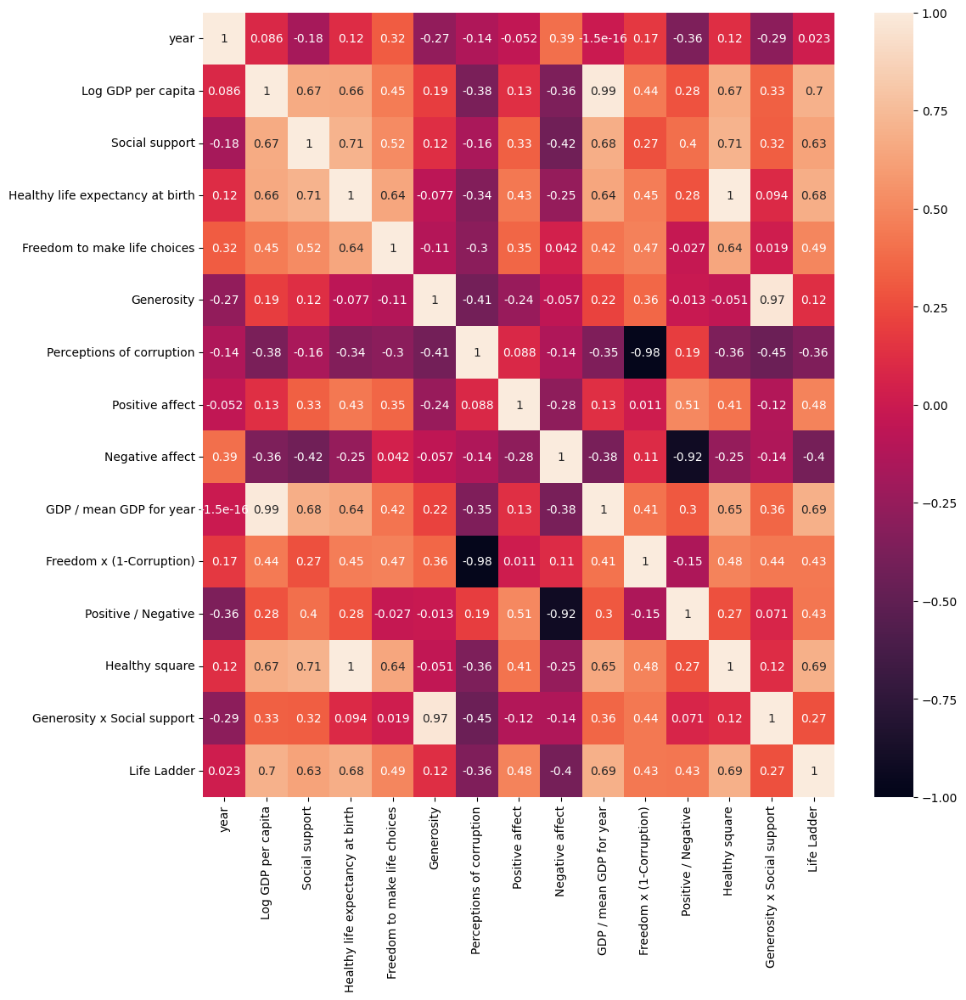

In [316]:
plt.figure(figsize=(12,12))
df_north_america_new_with_y = pd.concat([df_north_america_new, y_north_america_new], axis=1)
sns.heatmap(df_north_america_new_with_y.corr(), annot=True, vmin=-1, vmax=1)
plt.show()

* The features **GDP / mean GDP for year** and **Healthy square** achieved a correlation with the target variable of 0.69. This is the second highest correlation value with the target variable on this continent.
* **Positive / Negative**, besides the correlation with the variables from which it was created, has relatively low correlation values.
* **Healthy square**, like **Healthy life expectancy at birth**, has the highest correlation with **Social support**.
* Other correlation insights generally align with the overall findings about them.

Below, we will analyze how the new features have impacted the multiple regression model in this part of the world.

In [317]:
X_north_america_new_train, X_north_america_new_test, y_north_america_new_train, y_north_america_new_test = train_test_split(df_north_america_new, y_north_america_new, test_size=0.2, random_state=3)

In [318]:
model = LinearRegression()
train_and_evaluate_model(model, X_north_america_new_train.loc[:, :], y_north_america_new_train, X_north_america_new_test.loc[:, :], y_north_america_new_test, additional_title=', North America, new features')

Feature weights:
Column 'Healthy square': 9.9815
Column 'Healthy life expectancy at birth': -9.8752
Column 'Freedom x (1-Corruption)': -8.6914
Column 'Perceptions of corruption': -8.4546
Column 'Generosity x Social support': 4.7921
Column 'Generosity': -4.5623
Column 'Freedom to make life choices': 2.2076
Column 'Positive affect': 1.4736
Column 'Positive / Negative': 1.1135
Column 'Log GDP per capita': 1.0423
Column 'Social support': -0.3924
Column 'GDP / mean GDP for year': -0.3098
Column 'Negative affect': -0.1164
Column 'year': 0.1109


Results on train set, North America, new features
MSE: 0.1881
R2: 0.71785

Results on test set, North America, new features
MSE: 0.19112
R2: 0.77889


We can see that, at the cost of model complexity, we were able to achieve not only a better fit to the training data but also better generalization ability of the model. However, we can also observe that the absolute values of the coefficients are much higher, as the model needs to fit data in more dimensions.
* The highest coefficient values were obtained by the features related to health. This situation has been observed before.
* High coefficient values are also seen for the interaction between **freedom of decision-making** and **government fairness** as well as **perception of corruption**. Interestingly, both of them have negative values, which may suggest that as this interaction increases, the level of happiness decreases.
* '**Generosity x Social support**' also has a high weight, which is, however, balanced by the negative value of the Generosity weight.
* Interestingly, the GDP-related features achieved low weight values.

Below, we will see how regularization will affect these models.


In [319]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_ridge = perform_cross_validation_regularization(X_north_america_new_train.loc[:, :], y_north_america_new_train, alpha_values, is_ridge=True, display_plot=False)

ridge_best = Ridge(alpha=best_alpha_ridge)
train_and_evaluate_model(ridge_best, X_north_america_new_train.loc[:, :], y_north_america_new_train, X_north_america_new_test.loc[:, :], y_north_america_new_test, additional_title=' North America, new features with Ridge Regularization:')

Best value of alpha: 0.002154434690031882
Feature weights:
Column 'Freedom x (1-Corruption)': -7.4573
Column 'Perceptions of corruption': -7.3934
Column 'Healthy square': 7.3042
Column 'Healthy life expectancy at birth': -7.012
Column 'Generosity x Social support': 3.8179
Column 'Generosity': -3.5785
Column 'Freedom to make life choices': 1.943
Column 'Positive affect': 1.479
Column 'Positive / Negative': 1.0648
Column 'Log GDP per capita': 1.0355
Column 'GDP / mean GDP for year': -0.2405
Column 'Social support': -0.2157
Column 'Negative affect': -0.1239
Column 'year': 0.1011


Results on train set North America, new features with Ridge Regularization:
MSE: 0.18899
R2: 0.71652

Results on test set North America, new features with Ridge Regularization:
MSE: 0.1932
R2: 0.77649


After applying Ridge regularization, the coefficient values decreased slightly, but it was not a significant drop. The alpha parameter value selected by cross-validation was also not high. Regularization was not able to significantly improve the model's generalization ability.
* We can see that now the highest weight values were gained by features related to corruption, followed by features related to **healthy life expectancy** and **generosity**.
* The first 6 features with the highest coefficients alternate between the features we created and the original ones.
* Features related to **GDP** still have lower coefficient values.


In [320]:
alpha_values = np.logspace(-7, 2, 1000)
best_alpha_lasso = perform_cross_validation_regularization(X_north_america_new_train.loc[:, :], y_north_america_new_train, alpha_values, is_ridge=False, display_plot=False)

lasso_best = Lasso(alpha=best_alpha_lasso, max_iter=100000)
train_and_evaluate_model(lasso_best, X_north_america_new_train.loc[:, :], y_north_america_new_train, X_north_america_new_test.loc[:, :], y_north_america_new_test, additional_title=' North America, new features with Lasso Regularization:')

Best value of alpha: 4.641588833612772e-05
Feature weights:
Column 'Healthy square': 8.5801
Column 'Healthy life expectancy at birth': -8.3773
Column 'Freedom x (1-Corruption)': -8.0072
Column 'Perceptions of corruption': -7.8726
Column 'Generosity x Social support': 4.1531
Column 'Generosity': -3.921
Column 'Freedom to make life choices': 2.057
Column 'Positive affect': 1.4851
Column 'Positive / Negative': 1.0797
Column 'Log GDP per capita': 0.9768
Column 'Social support': -0.261
Column 'GDP / mean GDP for year': -0.2094
Column 'Negative affect': -0.1223
Column 'year': 0.1084


Results on train set North America, new features with Lasso Regularization:
MSE: 0.18838
R2: 0.71743

Results on test set North America, new features with Lasso Regularization:
MSE: 0.19209
R2: 0.77778


Similar conclusions can be drawn for Lasso regularization. The selected alpha is small, the coefficient values did not drop drastically, and the generalization ability practically did not change. The order of features remained roughly the same, with the most important change compared to Ridge being that now the features with the highest coefficient values are the **Healthy** features.

Below, we will make a selection of a satisfactory subset of features.


Best model for 1 features with MSE: 0.3562 is: ['Healthy square'].
Best model for 2 features with MSE: 0.298 is: ['Healthy square', 'Log GDP per capita'].
Best model for 3 features with MSE: 0.2644 is: ['Healthy square', 'Log GDP per capita', 'Positive affect'].
Best model for 4 features with MSE: 0.2458 is: ['Healthy square', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth'].
Best model for 5 features with MSE: 0.2406 is: ['Healthy square', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Generosity x Social support'].
Best model for 6 features with MSE: 0.2344 is: ['Healthy square', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Generosity x Social support', 'Generosity'].
Best model for 7 features with MSE: 0.233 is: ['Healthy square', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Generosity x Social support', 'Generosity', 'Perceptions of corruption'].
Best model f

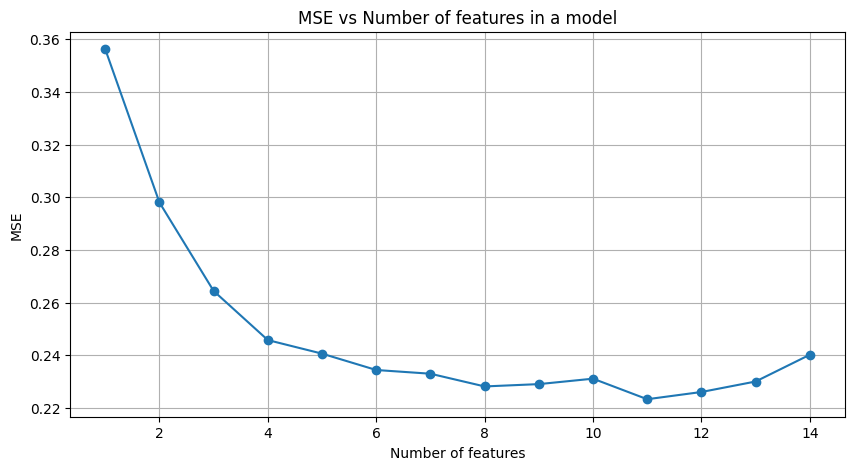

In [321]:
best_feature_subset_fs_north_america_new, errors_fs_north_america_new = find_best_subset_forward_stepwise_parallel(X_north_america_new_train, y_north_america_new_train)
elbow_plot(errors_fs_north_america_new)

Once again, we can see that adding the last features results in an increase in the MSE value.
* The first feature added was **Healthy square**, which individually minimized the mean squared error the most.
* Another feature created by us was added only as the fifth one. This was **Generosity x Social support**.
* The feature '**Freedom x (1-Corruption)**', which had a high coefficient value, was added to the model very late.
* For further analysis, we will take a subset of 5 features. We selected the same number previously, and now we will be able to test the impact of the two features we created.


In [322]:
best_5_north_america_new = ['Healthy square', 'Log GDP per capita', 'Positive affect', 'Healthy life expectancy at birth', 'Generosity x Social support']
model = LinearRegression()
train_and_evaluate_model(model, X_north_america_new_train.loc[:, best_5_north_america_new], y_north_america_new_train, X_north_america_new_test.loc[:, best_5_north_america_new], y_north_america_new_test, additional_title=', North America new features, best 5')

Feature weights:
Column 'Healthy square': 9.9115
Column 'Healthy life expectancy at birth': -9.4101
Column 'Positive affect': 1.9814
Column 'Log GDP per capita': 1.3211
Column 'Generosity x Social support': 0.3978


Results on train set, North America new features, best 5
MSE: 0.22117
R2: 0.66824

Results on test set, North America new features, best 5
MSE: 0.2002
R2: 0.7684


We can observe that using this subset of features allowed for better results on the test set.
* In the 5-feature subset, **Negative affect**, **Social support**, and **Perceptions of corruption** were not included. They were replaced by **Healthy square**, **Healthy life expectancy at birth**, and **Generosity x Social support**.
* We can see that the highest coefficient values were gained by features related to **Healthy life expectancy at birth**. This may suggest that happiness is better described by the second-degree polynomial of this variable than before when this feature was not included in the subset at all.
* **Generosity x Social support** received the lowest coefficient from this subset, but we can see that there may be a significant relationship between this variable and the outcome.

We can compare these findings with the RandomForest model.


In [323]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_north_america_new_train.loc[:, :], y_north_america_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_north_america_new_train.loc[:, :], y_north_america_new_train, X_north_america_new_test.loc[:, :], y_north_america_new_test, additional_title=' North America, Random Forest, new features', is_forest_reg=True)

Best value of max_depth: 11
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.4186
Column 'Log GDP per capita': 0.1948
Column 'Positive affect': 0.0624
Column 'Social support': 0.0604
Column 'Healthy life expectancy at birth': 0.0472
Column 'Freedom to make life choices': 0.037
Column 'Perceptions of corruption': 0.0293
Column 'Healthy square': 0.0291
Column 'Freedom x (1-Corruption)': 0.0249
Column 'Positive / Negative': 0.0244
Column 'Generosity': 0.0209
Column 'year': 0.0201
Column 'Generosity x Social support': 0.0164
Column 'Negative affect': 0.0147

Mean depth of trees: 10.99


Results on train set North America, Random Forest, new features
MSE: 0.02166
R2: 0.96751

Results on test set North America, Random Forest, new features
MSE: 0.12716
R2: 0.85289


The addition of new features in North America allowed for an increase in generalization ability when using the Random Forest model. The $R^{2}$ on the test set increased by almost 0.02.  
* The most significant features are related to GDP. Previously, **Log GDP per capita** accounted for about 40% of the importance in this model, but now we can see that both of these features together account for about 60% of the importance in the model.
* This has happened partly at the expense of **Healthy life expectancy at birth**. Features related to this indicator have lost significance in this model.
* Compared to the multiple regression model, we can see that **Generosity x Social support** now has a significantly lower impact.
* **Positive affect** and **Social support** have maintained a high position in the hierarchy, but their importance percentage has dropped, particularly **Social support**.

We will now try to select a satisfactory subset of features that reduces the model's complexity while still maintaining high metrics.


Best model for 1 features with MSE: 0.2941 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.1939 is: ['GDP / mean GDP for year', 'Healthy square'].
Best model for 3 features with MSE: 0.1666 is: ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption'].
Best model for 4 features with MSE: 0.1597 is: ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption', 'Positive / Negative'].
Best model for 5 features with MSE: 0.147 is: ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption', 'Positive / Negative', 'Log GDP per capita'].
Best model for 6 features with MSE: 0.1462 is: ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption', 'Positive / Negative', 'Log GDP per capita', 'Healthy life expectancy at birth'].
Best model for 7 features with MSE: 0.1441 is: ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption', 'Positive / Negative', 'Log GDP per capita', 'Healthy life expectanc

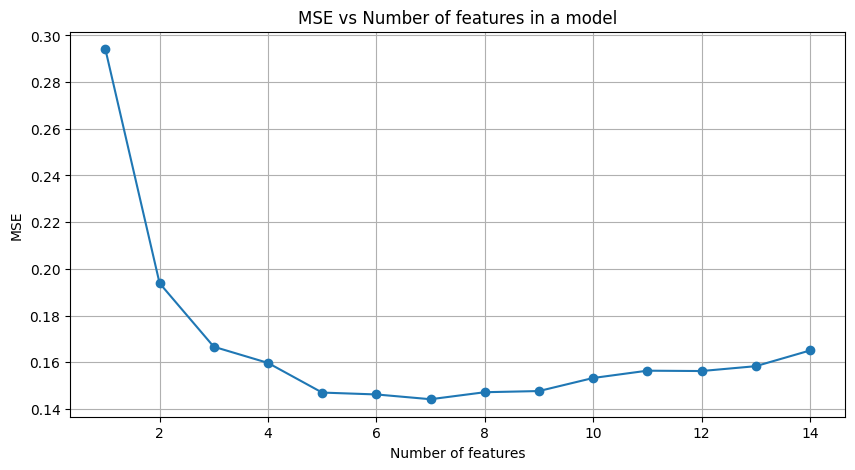

In [324]:
best_feature_subset_fs_north_america_new_forest, errors_fs_north_america_new_forest = find_best_subset_forward_stepwise_parallel(X_north_america_new_train, y_north_america_new_train, is_forest_reg=True)
elbow_plot(errors_fs_north_america_new_forest)

* The first feature selected by the algorithm was '**GDP / mean GDP for year**'. On its own, it most effectively minimizes the mean squared error.
* The next feature was also one of our created features, '**Healthy Square**'.
* The subset of 5 features also included the '**Positive / Negative**' feature, which wasn't frequently selected on the previous continents.
* We can see that taking a five-element subset will be reasonable here, as it strikes a balance between performance and model complexity.
* Adding the remaining features generally increased the MSE.

Below, we will test the selected model.


In [325]:
depths = list(range(10,26))
depths.append(None)
min_samples_leaf = list(range(1,6))
best_5_forest_north_america_new = ['GDP / mean GDP for year', 'Healthy square', 'Perceptions of corruption', 'Positive / Negative', 'Log GDP per capita']
best_depth, best_min_samples_leaf = perform_cross_validation_forest(X_north_america_new_train.loc[:, best_5_forest_north_america_new], y_north_america_new_train, depths, min_samples_leaf)

rf_model = RandomForestRegressor(n_estimators=100, random_state=3, max_depth=best_depth, min_samples_leaf=best_min_samples_leaf)
train_and_evaluate_model(rf_model, X_north_america_new_train.loc[:, best_5_forest_north_america_new], y_north_america_new_train, X_north_america_new_test.loc[:, best_5_forest_north_america_new], y_north_america_new_test, additional_title=' North America, Random Forest, new features, best 5 features', is_forest_reg=True)

Best value of max_depth: 12
Best value of min_samples_leaf: 1
Feature importances:
Column 'GDP / mean GDP for year': 0.4701
Column 'Log GDP per capita': 0.2427
Column 'Healthy square': 0.1261
Column 'Perceptions of corruption': 0.0815
Column 'Positive / Negative': 0.0796

Mean depth of trees: 11.91


Results on train set North America, Random Forest, new features, best 5 features
MSE: 0.02006
R2: 0.96992

Results on test set North America, Random Forest, new features, best 5 features
MSE: 0.1046
R2: 0.879


By reducing the model complexity, we were able to achieve better generalization. $R^{2}$ on the test set increased by 0.025 compared to the model based on all features. The model also achieved similarly higher results compared to the model based on the 5 features from the original set.
* The most important feature was '**GDP / mean GDP for year**' – Limiting the impact of the global GDP growth trend helped extract more information for this continent.
* Despite this, '**Log GDP per capita**' also gained high importance. In North America, it turns out that the impact of the global GDP growth trend is also significant. Although these two features dominated the hierarchy of importance in this model, even when their importances are summed, it is still less than in Europe. Happiness in North America depends more on other factors as well, although it is still mainly influenced by GDP.
* '**Healthy square**' was the 3rd most important feature. We can see that the quadratic relationship between healthy life expectancy and happiness may better describe this second feature. It was chosen at the cost of the linear version of the variable.
* **Perceptions of corruption** remained an important feature, and after introducing the new variables, its importance even increased.
* Introducing the ratio of Positive to Negative affect replaced the **Positive affect** variable. Apparently, this ratio better describes the collected data than the regular Positive affect.

Below, we will test the boosting method.


In [326]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_north_america_new_train.loc[:, :], y_north_america_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_north_america_new_train.loc[:, :], y_north_america_new_train, X_north_america_new_test.loc[:, :], y_north_america_new_test, additional_title=' North America, XGBoost, new features', is_xgboost=True)

Best value of max_depth: 3
Best value of learning_rate: 0.2
Feature importances:
Column 'GDP / mean GDP for year': 0.5836
Column 'Log GDP per capita': 0.1124
Column 'Healthy life expectancy at birth': 0.0857
Column 'Positive / Negative': 0.0509
Column 'Social support': 0.0329
Column 'Positive affect': 0.027
Column 'Generosity': 0.0269
Column 'Perceptions of corruption': 0.0246
Column 'Negative affect': 0.0209
Column 'Freedom to make life choices': 0.0164
Column 'year': 0.0115
Column 'Freedom x (1-Corruption)': 0.0044
Column 'Generosity x Social support': 0.0027
Column 'Healthy square': 0.0


Results on train set North America, XGBoost, new features
MSE: 0.00108
R2: 0.99837

Results on test set North America, XGBoost, new features
MSE: 0.15181
R2: 0.82438


Adding new features also had a positive effect on the boosting model, and its $R^{2}$ on the test set increased by 0.025. The model was able to achieve these results with a lower maximum tree depth by one level.
* Similar to the model based on the original features, we still see that the most important features are those related to GDP. In that model, it accounted for 43% of the influence, whereas here, it is a combined 69%. This shows how strongly happiness is dependent on GDP.
* **Healthy life expectancy at birth** remained the third most important feature.
* We can see that the ratio of positive to negative affect gained relatively high importance.
* The remaining 3 added features were not considered important by the model. The importance of **Healthy square**, as is usually the case for boosting models, was set to zero.

Below, we will analyze which features the feature selection algorithm suggests.


Best model for 1 features with MSE: 0.3301 is: ['GDP / mean GDP for year'].
Best model for 2 features with MSE: 0.2353 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth'].
Best model for 3 features with MSE: 0.1955 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perceptions of corruption'].
Best model for 4 features with MSE: 0.1754 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Log GDP per capita'].
Best model for 5 features with MSE: 0.1586 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Log GDP per capita', 'Negative affect'].
Best model for 6 features with MSE: 0.1571 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Log GDP per capita', 'Negative affect', 'Freedom x (1-Corruption)'].
Best model for 7 features with MSE: 0.1531 is: ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perc

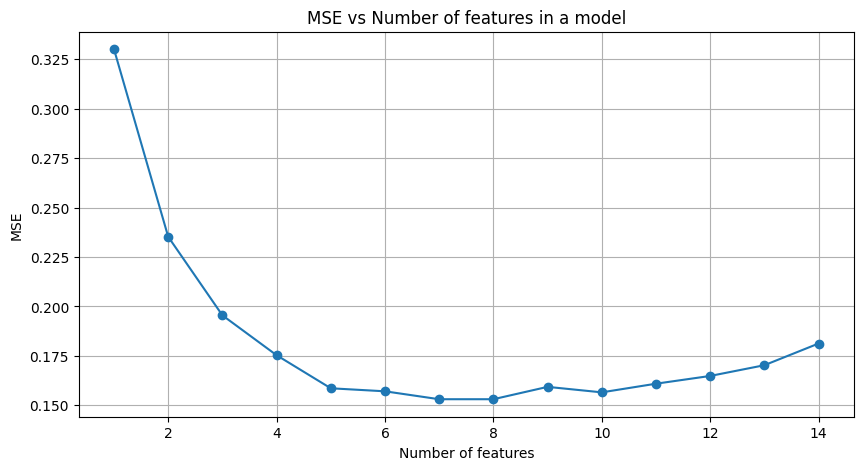

In [327]:
best_feature_subset_fs_xgboost_north_america_new, errors_fs_xgboost_north_america_new = find_best_subset_forward_stepwise_parallel(X_north_america_new_train, y_north_america_new_train, is_xgboost=True)
elbow_plot(errors_fs_xgboost_north_america_new)

As before, the plot suggests selecting a subset of 5 features. However, this time, only one feature added by us is included in the subset: '**GDP / mean GDP for year**'. The other features also appeared in the boosting model based on the 5 original features.
* Unlike the bagging model and the model based on all features, **Positive / Negative** was added to the model as one of the last features.
* **Healthy square** was similarly added late.
* The feature '**Freedom x (1-Corruption)**' was close to being included, but it did not significantly reduce the mean squared error.

Below, we will test the selected subset.


In [328]:
depths = list(range(3, 10))
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3, 0.5]

best_5_xgb_north_america = ['GDP / mean GDP for year', 'Healthy life expectancy at birth', 'Perceptions of corruption', 'Log GDP per capita', 'Negative affect']

best_depth, best_learning_rate = perform_cross_validation_xgboost(X_north_america_new_train.loc[:, best_5_xgb_north_america], y_north_america_new_train, depths, learning_rates)

xgb_model = XGBRegressor(max_depth=best_depth, learning_rate=best_learning_rate, n_estimators=100, random_state=3)

train_and_evaluate_model(xgb_model, X_north_america_new_train.loc[:, best_5_xgb_north_america], y_north_america_new_train, X_north_america_new_test.loc[:, best_5_xgb_north_america], y_north_america_new_test, additional_title=' North America, XGBoost, new features, best 5 features', is_xgboost=True)

Best value of max_depth: 4
Best value of learning_rate: 0.05
Feature importances:
Column 'GDP / mean GDP for year': 0.4935
Column 'Log GDP per capita': 0.2803
Column 'Negative affect': 0.0808
Column 'Healthy life expectancy at birth': 0.0733
Column 'Perceptions of corruption': 0.072


Results on train set North America, XGBoost, new features, best 5 features
MSE: 0.01621
R2: 0.97569

Results on test set North America, XGBoost, new features, best 5 features
MSE: 0.11019
R2: 0.87252


We observe a significant increase in the model's performance after reducing the number of features to the top 5 most important ones. For a tree with a maximum depth of 4 (5 levels fewer than for the subset with the original features), the algorithm achieved a 0.07 better score on the test set.
* Similar to bagging, the two most important features are based on **GDP**, and their combined importance is 77%.
* After including the two **GDP**-based features, the importance of **Healthy life expectancy at birth** drastically decreased. Although it is still an important feature, the drop from 40% importance to 7% was very significant.
* **Perceptions of corruption** remained at a similar level of importance, while the importance of **Negative affect** increased relatively strongly.

In summary, in North America, we were able to define happiness more accurately by adding new features. The models' ability to generalize improved.
* The models mostly agreed that the most important added feature turned out to be '**GDP / mean GDP for year**'. On this continent, we can better describe the relationship between **GDP** and **Life Ladder** by dividing the **Log GDP per capita** by the average for that year. This way, we can reduce the impact of yearly GDP growth and better describe happiness.
* It is also possible that there is a non-linear dependency between **healthy life expectancy** and happiness on this continent. This could be influenced by factors like inequalities in the values of these features between Canada and the rest of the continent. Nevertheless, the feature in its first power is still useful and preferred in boosting models.
* **Perceptions of corruption** remained an important feature on this continent. People living there value low levels of this indicator.
* The **Positive / Negative affect** ratio may also have a positive impact on describing happiness, but this hypothesis was mainly supported by the bagging model.

## Summary
To summarize our findings during this project, we can confirm the validity of the hypothesis: happiness in different regions of the world indeed depends on different factors. The hierarchy of the most important features, when considering a specific continent, differs from the hierarchy obtained for the full dataset of the entire world. Nevertheless, in most areas of the world, the key factor for happiness turned out to be the **Log GDP per capita**, and it is this **GDP** that defines happiness to the greatest extent. This is understandable since this feature also indicates the level of a country's development, and a developed, wealthy country is often able to provide its citizens with better living conditions, more job opportunities, better infrastructure, amenities, or education. Such features were not included in the dataset, so perhaps their influence was indirectly accounted for in the form of **GDP**.

Other features, however, had varying levels of importance depending on the region considered. Below is a brief summary of the collected results.

### The Entire World
Despite the large cultural diversity, the results from the dataset containing data from the entire world can be considered reliable, and the issue of happiness globally is well-described by the features in the dataset. The tested models achieved a high ability to generalize, and ensemble learning methods were able to achieve even better results. The best model was **XGBRegressor** ($R^{2}$ of 0.87 on the test set), followed by **Random Forest** (0.86). We also noticed that with minimal performance cost, we were able to reduce the model's complexity. By removing 4 features, the models maintained high generalization ability (**XGBoost** achieved an $R^{2}$ of 0.85 on the test set, and **Random Forest** 0.84). Moreover, these algorithms were consistent in choosing features.
* **Log GDP per capita**: The most important feature globally is **Log GDP per capita**, and people living in wealthier countries are often happier. As mentioned earlier, this could be related to the fact that a high **GDP** increases the chances of a higher level and availability of amenities. However, this is not always linear, as countries must also know how to utilize a high **GDP** to provide citizens with additional incentives to achieve a high level of happiness. Additionally, it is worth mentioning that this feature has a significant advantage over the others in determining happiness, with its importance usually exceeding 60%.
* **Positive affect**: The level of positive emotions turned out to be the second most important feature globally, and people with a high level of this feature are happier. The general trend suggests that, when considering the entire world, a high level of positive emotions is more important than a low level of negative emotions, and happy people value the former more than the latter.
* **Healthy life expectancy at birth**: Due to the significant variation in this feature globally, it is also very important. Countries that are able to ensure a longer expected **healthy life expectancy** generally have happier citizens. People who are healthy for longer can focus on pursuing happiness and also feel more satisfaction from high values of other factors.
* **Social support**: Receiving social support or even just being aware of the possibility of receiving it in times of need can provide psychological comfort that positively impacts happiness.
* **Negative affect**: Despite having significantly less influence than **Positive affect**, it turns out that globally, experiencing a low level of negative emotions is also an important factor. The absence of major problems can make it easier to achieve life happiness.

The added features did not contribute much more information to the dataset. Adding them improved the metric values, but it may not have been worth increasing the model's complexity. The most suggested added feature was the one that included the relationship between freedom in making life decisions and government honesty. At high values of this, people were likely happier. Freedom in decision-making and perceiving the government as honest gives the impression of control over one's fate, which certainly has a better impact on happiness than a sense of lack of influence and dishonesty. However, this feature had an influence similar to **Negative affect**.

### Europe
Despite the significant variation in happiness across the Old Continent (with very happy Scandinavia and less happy Eastern Europe and the Balkans), this issue is very well described by the features included in the dataset. It is even easier to describe than global happiness. On the full feature set, both RandomForest and XGBoost achieved $R^{2}$ of 0.89 on the test set. When limiting the number of features to five, the results for RandomForest barely changed (only a 0.004 decrease). XGBoost's performance dropped a little more, to 0.865, but this is still a very good generalization ability. In Europe, like in the rest of the world, the algorithms were mostly consistent in selecting the features. 
* **Log GDP per capita**: Despite being one of the wealthiest regions, GDP is the most important factor for happiness in Europe, and wealthier regions in Europe are happier. It is worth noting that compared to the entire world, this feature is significantly more important. Models indicated the importance of this feature at around 80%. This conclusion is able to define how Europeans perceive happiness. The other features mainly complement the information provided by **Log GDP per capita**.
* **Freedom to make life choices**: Europeans value the freedom to make life decisions. The awareness of the freedom to choose one's life path, travel, and decide for oneself positively influences happiness levels and is important for Europeans.
* **Perceptions of corruption**: Europeans pay significant attention to low corruption levels, and this feature has more importance than in the world dataset. Due to the easy access to meeting basic needs, society tends to value factors of happiness that are at higher levels of abstraction.
* **Negative affect**: Although **Positive affect** was typically higher when considering the full model, **Negative affect** was selected much more consistently for satisfactory subsets of features aimed at reducing model complexity while maintaining good performance. Europeans value peace and low negative emotions more than high positive ones.
* **Healthy life expectancy at birth**: Despite significantly lower variability in this feature than, for example, in Africa, it is still quite important. However, it is much less significant than in other parts of the world. The ability to remain healthy for a long time is important for Europeans. Being healthy allows them to enjoy the benefits of life longer.

Happiness in Europe is very well described by the features in the dataset, and adding new ones did not significantly affect model performance. The only suggestion could be the possible importance of the **Positive / Negative** feature, but the original features were chosen much more frequently by the algorithms.

Comparing Europe to the entire world, we can see that in Europe, factors of happiness at higher levels of abstraction, such as **Perceptions of corruption** and **Freedom to make life choices**, gained more importance, while the importance of features like **Positive affect** and **Healthy life expectancy at birth** decreased. The influence of **GDP** on happiness levels is also much higher.

### Africa

The data concerning happiness in Africa was much harder to describe by the features in the dataset than on other continents. Initial multiple regression models performed poorly. Ensemble learning methods significantly improved the results, but they did not reach a satisfactory level. The best model was XGBoost on the full feature set ($R^{2}$ of 0.51 on the test set), and RandomForest performed a bit worse, with results around 0.47. As it turned out, limiting the number of features in the model in Africa led to a significant deterioration of metrics. The top 5 features resulted in scores of 0.42 and 0.39, respectively, for the XGBRegressor and RandomForestRegressor models. Despite the features in the dataset not being able to fully accurately describe happiness in Africa, most of them had some impact on the model, as removing them caused a noticeable decline in metrics. To create the best possible model, we should use most of the features, and even consider adding new ones that bring entirely different information. Nevertheless, based on the results, we can suggest the following conclusions:
* **Log GDP per capita**: As in most parts of the world, **Log GDP per capita** turned out to be the most important feature. Wealthier countries are often able to provide better healthcare, opportunities, and amenities, which can positively influence happiness. However, we saw that the importance of this feature is significantly lower than in Europe or globally, fluctuating around 40%. Describing happiness in this part of the world requires other factors as well.
* **Healthy life expectancy at birth**: This is an important feature on this continent, mainly due to the high variability of this feature in Africa. When a country provides good conditions and a high level of healthcare, and the expected healthy life expectancy is longer, people are usually happier.
* **Positive affect** and **Negative affect**: These features were often chosen by models and suggest that the levels of emotions significantly impact happiness in Africa. It is difficult to determine which one has a higher impact.
* The remaining features, despite having a slightly lower impact, can also prove to be more or less important for the models. The feature **Perceptions of corruption** was less frequently selected and has a significantly lower impact on happiness than, for example, in Europe.

The features we added appeared more often in models based on feature subsets, but the new features did not significantly improve regression results. Due to the low performance of the regressors, the following conclusions can only be suggested:
* **GDP / mean GDP for year**: The feature that reduces the influence of global trends gave better results for a model consisting of only this feature. However, when the original feature appeared in the feature set, it usually prevailed. Regardless, whichever feature we chose, it remained the most important in the model.
* Based on the results of some regressors, there may be a nonlinear dependency between healthy life expectancy and happiness, but we cannot state this with certainty, as the chosen "Healthy" feature varied depending on the model.
* Introducing the **Positive / Negative** ratio on this continent may allow for a reduction in model size or the introduction of more other information while maintaining the same number of variables. The bagging model replaced **Positive affect** and **Negative affect** with their ratio.

Comparing the hierarchy of features, we can see that the most important features selected in Africa are similar to those selected for the entire world. The most important are the levels of **GDP**, healthy life expectancy, and emotional levels.

The collected information shows that the issue of happiness in Africa is definitely more complex than in other parts of the world. In this region, important happiness factors may be more basic ones, which people from developed regions would not pay attention to (until they were lacking). The easiest example is free access to drinking water. It would also be valuable to add information about social inequalities through the Gini index or about the occurrence of armed conflicts in the region.

### Asia

The research suggests that it is definitely easier to describe happiness in Asia than in Africa, but more difficult than in Europe. The best ensemble learning models achieved $R^{2}$ results on the test set of 0.81 (Bagging) and 0.78 (Boosting). Limiting the feature set to five caused a drop in this metric by about 0.04-0.05. However, the algorithms still maintained satisfactory generalization capabilities.
* **Log GDP per capita**: As in most continents, this feature proved to be the most significant. However, its importance was lower than on a global scale, ranging between 40-50%.
* **Social support**: The second most important feature in most cases was Social support. Asians seem to rely heavily on this feature and base their happiness on it. Receiving help in difficult situations supports a high level of perceived happiness. Even the awareness that one will not be left alone in a tough situation can be a psychological cushion that contributes to a higher level of happiness.
* **Positive affect**: A high level of positive emotions appears to be more important in Asia than a low level of negative emotions.
* As for the other features, the algorithms were not always consistent. However, looking at them in general, it can be concluded that **Healthy life expectancy at birth** and **Freedom to make life choices** might also be significant factors. However, they are definitely less important than the three features mentioned above.
* Despite their relatively small impact, it is worth noting that Asia was the only continent where **Generosity** had slightly higher significance. In contrast, **Perceptions of corruption** was not very significant in this part of the world.

Similar to previous findings, most of the added features did not have much significance. Creating a limited RandomForest model based on 5 features, which included the feature _GDP / mean GDP for year_ instead of _Log GDP per capita_ and _Healthy square_ instead of _Generosity_, allowed for slightly better results on the test set. It may turn out that such modifications to the variables would improve model performance on Asian data.

When compared to other continents, it is evident that **Social support** has a significantly greater impact in Asia than in the rest of the world. Compared to Europe, it is clear that Asians place much more importance on a high level of positive emotions than a low level of negative ones.

### Oceania

Due to the small amount of data in this part of the world, the results may not fully reflect reality and may have been significantly affected by the initial split into training and test sets. This could also explain the disparity in results between ensemble learning methods. Random Forest achieved an $R^{2}$ of 0.90 on the test set, while XGBoost only achieved 0.41. A standard multiple regression with Ridge regularization performed better than boosting, achieving $R^{2}$ of 0.85 on the test set. Additionally, the models seem to prefer different feature sets. Therefore, we focus on those with greater generalization capabilities. Models based on 4 features performed worse, e.g., 0.75 for Random Forest.
* **year**: Interestingly, the most important feature in Oceania turned out to be the **year** variable. Happiness in this part of the world generally tends to be high. Adding to this the low variability of some features, it appears that their changes may not significantly affect changes in life satisfaction. Therefore, the factor influencing the change in happiness level is the passage of time. From the correlation matrix and multiple regression, it can be concluded that this variable actually has a negative impact on happiness levels. This means that as time passes, happiness levels in this part of the world decrease. Of course, external processes and events, which are not included in the dataset, could also play a role.
* **Freedom to make life choices** and **Social support**: The models tested seem to suggest the importance of these two variables in this continent. However, we are unable to determine exactly which one is more significant. The former had higher importance in full models, while the latter was selected for limited models. It makes sense that people in this part of the world value the freedom to make life decisions; for example, in Australia, people may value the ability to decide on changing their place of residence. Such decisions may carry significant pressure due to the vast distances in the country.
* Some results also suggest the importance of **Healthy life expectancy at birth** and **Generosity**. However, these results were not fully consistent. Interestingly, the first of these features has a negative weight in the multiple regression, which may suggest that as this feature increases, **Life Ladder** decreases. With such a small sample of data, it is difficult to conclusively confirm the presence of such a phenomenon on a larger scale.

Regarding the added features, they only increased model complexity, leading to overfitting to the training data and thus reducing generalization. Therefore, we cannot draw any far-reaching conclusions from this.

Compared to other continents, it is evident that the feature preferred by the rest of the world did not bring much information for Oceania. GDP is relatively stable at a high level there, suggesting that other factors may influence happiness levels more. Similarly to Europe, Oceanians seem to attach great importance to the freedom to make life choices. On the other hand, we might suggest a similarity to Asia, where **Social support** is important.

### South America
South America turned out to be a similarly complex continent to describe using the given features as Africa. Although the models performed slightly better than on the African continent, the results still cannot be considered satisfactory. Random Forest achieved an $R^{2}$ of 0.53 on the test set, while XGBoost performed significantly worse with 0.41. Reducing the number of dimensions did not impact the Random Forest model as much as expected—after removing five features, the model achieved an $R^{2}$ of 0.51. While still unsatisfactory, this result indicates that the remaining variables contributed significantly less information to the model than the top four features. Key features suggested by the models:
* **Log GDP per capita**: Similar to most regions of the world, this was the most important feature for South America as well. Its importance is comparable to Asia, at around 40-50%.
* **year**: Choosing the second most important feature is not as obvious. However, since it was selected through feature selection, we can suggest that the **year** variable plays a role. Its interpretation differs from Oceania, as in South America, Life Ladder increases over time. This may be due to global development trends or a gradual improvement in the region's situation.
* **Healthy life expectancy at birth**: Full models suggested a high importance for this feature, yet it was not selected among the top four features. Multiple regression analysis showed that this feature had a negative coefficient, suggesting that as it increases, Life Ladder decreases. Since this is a rather unexpected observation, to confirm this with high confidence, a model capable of better generalization would be necessary. For comparison, this feature had a near-zero correlation with the output.
* **Positive affect**: This feature was selected as one of the top four. It turns out that a high level of positive emotions is important in South America and is more significant than a low level of negative emotions.
* **Freedom to make life choices**: Similar to the previous feature, this one was also suggested by the models as it was included in the top four selected features. It appears that freedom of choice is also an important factor on this continent.

The additional features introduced to the dataset did not improve regression results. Instead, they added complexity to the model, reducing its ability to generalize. The only notable finding is that **GDP / mean GDP for year** proved to be a relatively important feature in the reduced model. However, it is possible that GDP-related features could ultimately be used interchangeably with similar effectiveness.

Compared to other continents, South America shows similarities to Oceania, where the **year** variable plays a significant role, though it is not the most important one. GDP remains the most critical feature, as in all regions except Oceania. Similar to most of the world, positive emotions matter more than the absence of negative emotions. Additionally, **freedom to make life choices** could be an important factor, much like in Oceania and Europe.

### North America
North America, like Europe, exhibited significant happiness variability. This continent includes the less happy countries of Central America and the highly happy Canada. The regression results were excellent, with metric values better than those for the global dataset. The features included in the dataset represent happiness in North America very well. The Random Forest model achieved an $R^{2}$ of 0.83 on the test set, while XGBoost scored 0.79. Furthermore, when we reduced the number of features to the top five, we were able to achieve an $R^{2}$ of 0.85 on the test set using Random Forest. By reducing the number of model features, we improved its performance. The best features for this continent, as selected by the model:
* **Log GDP per capita**: As in most parts of the world, the most important feature here was related to GDP. Wealthier countries can provide more amenities, better living conditions, and development opportunities, all of which contribute to happiness. Compared to European happiness, the importance of this feature is notably lower at around 40-50%.
* **Healthy life expectancy at birth**: This is the second most significant feature in the dataset, with an importance of around 30% depending on the model. This was the only case where importance was distributed primarily between two features. The significance of this feature could be influenced by factors such as access to healthcare, preventive care, and the cost of medical services in the United States.
* **Positive affect**: Most models agreed that in North America, the importance of high positive emotions outweighs the importance of low negative emotions.
* **Perceptions of corruption and Freedom to make life choices**: People in this part of the world value freedom in making life choices and low corruption levels. The high importance of these features may be influenced by data from Canada, which has low corruption and where people experience a higher sense of freedom in life decisions, contributing to high happiness levels.

The additional features we introduced improved the models' ability to generalize. Random Forest achieved an $R^{2}$ of 0.85 on the test set, while XGBoost reached 0.82. After limiting models to five features, Random Forest obtained a score of 0.879, while XGBoost reached 0.872.
* **GDP / mean GDP for year**: Using this feature allowed us to better describe the relationship between GDP and Life Ladder by reducing the impact of overall GDP trends. Interestingly, despite using this feature, the original GDP feature was also included in the model, and together, they accounted for about 70% importance.
* **Healthy square**: The selection of this feature through bagging suggests that it may capture a nonlinear relationship between **Healthy life expectancy at birth** and **Life Ladder**.
* **Positive / Negative**: The ratio of positive to negative emotions can also help describe happiness on this continent.

North America resembles Europe in its perception of happiness, with high importance placed on **GDP**, **Freedom to make life choices**, and **Perceptions of corruption**. However, North Americans value **Healthy life expectancy at birth** and **Positive affect** much more.

## Future Development Opportunities
We can see potential for further development in this project. In the future, we would like to expand the dataset with features that better describe the situation in specific world regions. This includes metrics such as the **Gini Index** or information on **armed conflicts** in a region. We could also focus on even smaller regions, such as analyzing Europe by dividing it into Scandinavia, Western Europe, etc. This might reveal internal differences within continents. Additionally, we could develop a **neural network** and compare its results with those obtained from regressors. Another interesting approach would be to analyze the data from a **time series** perspective and investigate autoregressive methods.
